### setup and data loading phase of the MLP-from-scratch implementation.
##### Imports visualization and numerical tools,
##### Sets visual styles,
##### Loads the Iris dataset using scikit-learn.

In [4]:
import random
import seaborn
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm

seaborn.set(style='whitegrid'); seaborn.set_context('talk')
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

from sklearn.datasets import load_iris
iris_data = load_iris()

### Analysis about the Iris Dataset
##### description of the Iris dataset

In [5]:
print(iris_data['DESCR'])

.. _iris_dataset:

Iris plants dataset
--------------------

**Data Set Characteristics:**

:Number of Instances: 150 (50 in each of three classes)
:Number of Attributes: 4 numeric, predictive attributes and the class
:Attribute Information:
    - sepal length in cm
    - sepal width in cm
    - petal length in cm
    - petal width in cm
    - class:
            - Iris-Setosa
            - Iris-Versicolour
            - Iris-Virginica

:Summary Statistics:

============== ==== ==== ======= ===== ====================
                Min  Max   Mean    SD   Class Correlation
============== ==== ==== ======= ===== ====================
sepal length:   4.3  7.9   5.84   0.83    0.7826
sepal width:    2.0  4.4   3.05   0.43   -0.4194
petal length:   1.0  6.9   3.76   1.76    0.9490  (high!)
petal width:    0.1  2.5   1.20   0.76    0.9565  (high!)
============== ==== ==== ======= ===== ====================

:Missing Attribute Values: None
:Class Distribution: 33.3% for each of 3 classes.
:Cr

### Exploratory data visualization of the Iris dataset
##### Plots a scatterplot of Sepal Length vs. Sepal Width
##### Plots a scatterplot of Petal Length vs. Petal Width

Number of samples: 150
Number of features: 4 



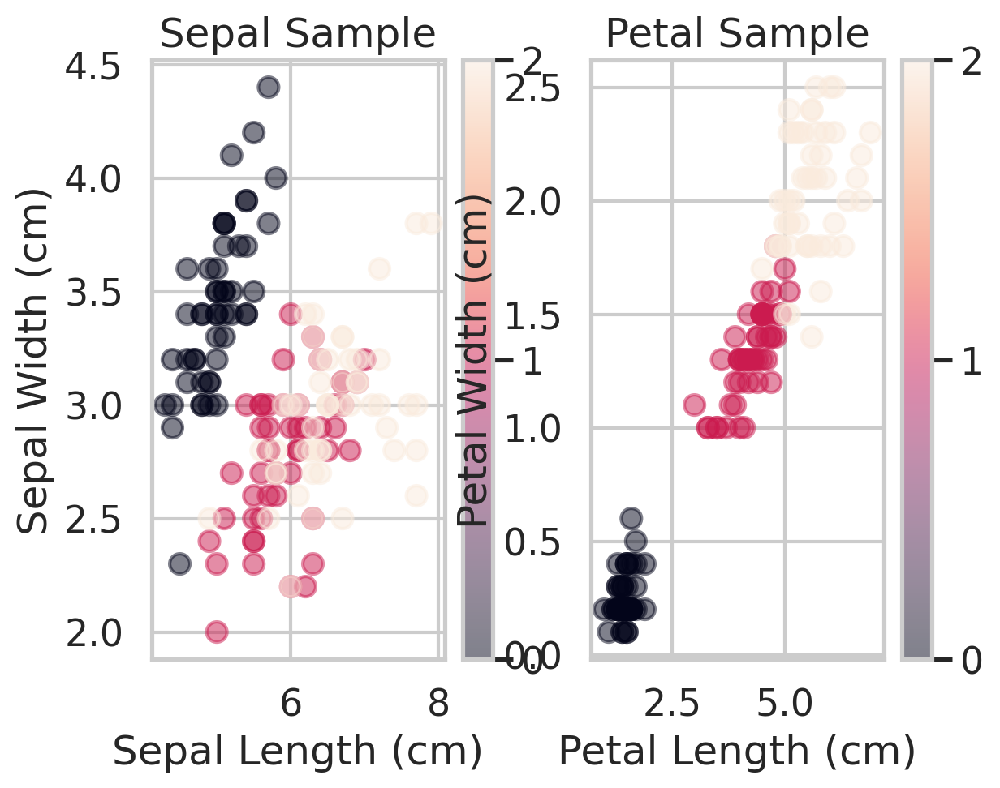

In [6]:
n_samples, n_features = iris_data.data.shape

print(f"Number of samples: {n_samples}")
print(f"Number of features: {n_features} \n")

plt.subplot(1, 2, 1)
scatter_plot = plt.scatter(iris_data.data[:,0], iris_data.data[:,1], alpha=0.5,
                           c=iris_data.target)
plt.xlabel("Sepal Length (cm)")
plt.ylabel("Sepal Width (cm)")

plt.colorbar(ticks=([0, 1, 2]))
plt.title('Sepal Sample');

plt.subplot(1, 2, 2)
scatter_plot_2 = plt.scatter(iris_data.data[:,2], iris_data.data[:,3], alpha=0.5,
                           c=iris_data.target)
plt.xlabel("Petal Length (cm)")
plt.ylabel("Petal Width (cm)")

plt.colorbar(ticks=([0, 1, 2]))
plt.title('Petal Sample');

##### A scatter matrix visualization of the entire Iris dataset, giving a more complete view of how the features relate to each other.

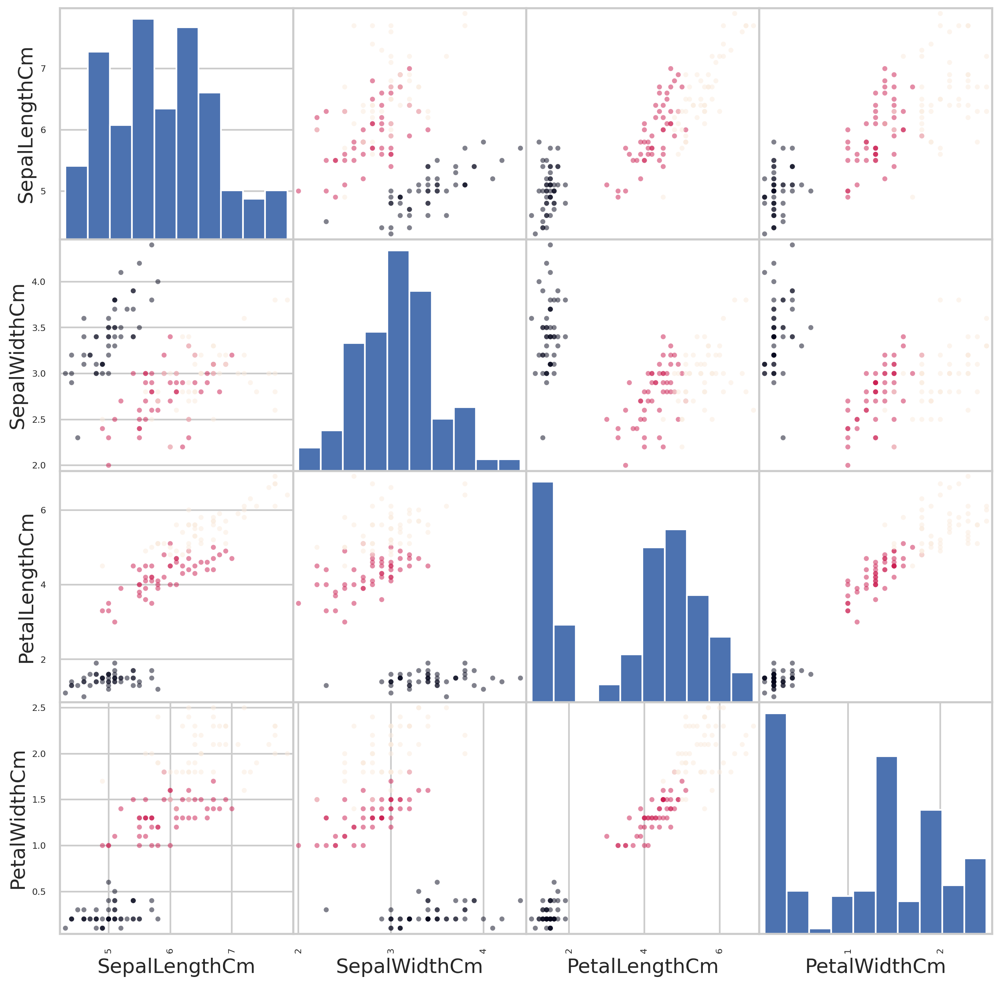

In [7]:
import pandas as pd
from pandas.plotting import scatter_matrix


dataset = pd.read_csv('Dataset/Iris.csv')
dataset = dataset.drop("Id", axis=1)
#scatter_matrix(dataset, alpha=0.5, figsize=(20, 20))
scatter_matrix(dataset.iloc[:, :-1], alpha=0.5, figsize=(15, 15), diagonal='hist', c=dataset['Species'].astype('category').cat.codes)
plt.show()

##### continue with the exploratory data analysis (EDA) phase by giving further insight into the Iris dataset's structure and feature distributions.
##### Creates a histogram for each numerical feature (sepal length, sepal width, petal length, petal width).

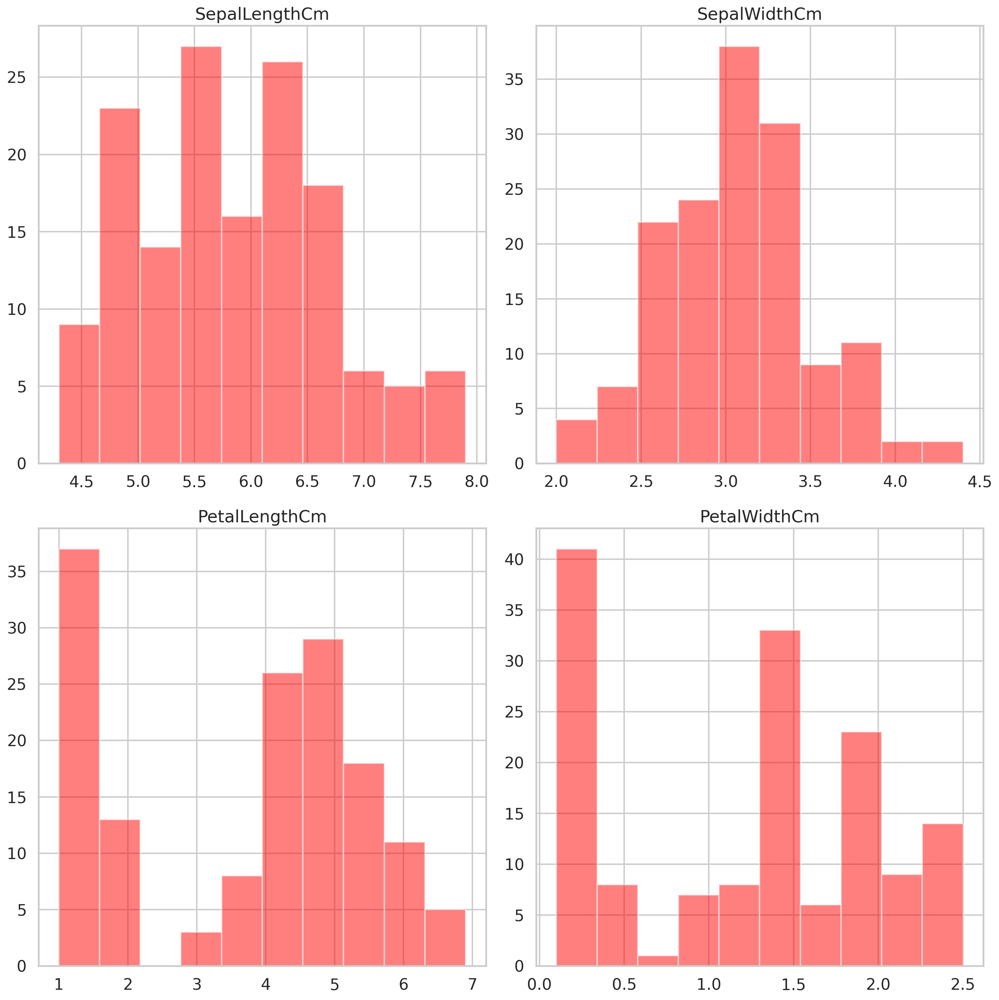

In [8]:
dataset.hist(alpha=0.5, figsize=(15, 15), color='red')
plt.tight_layout()
plt.show()

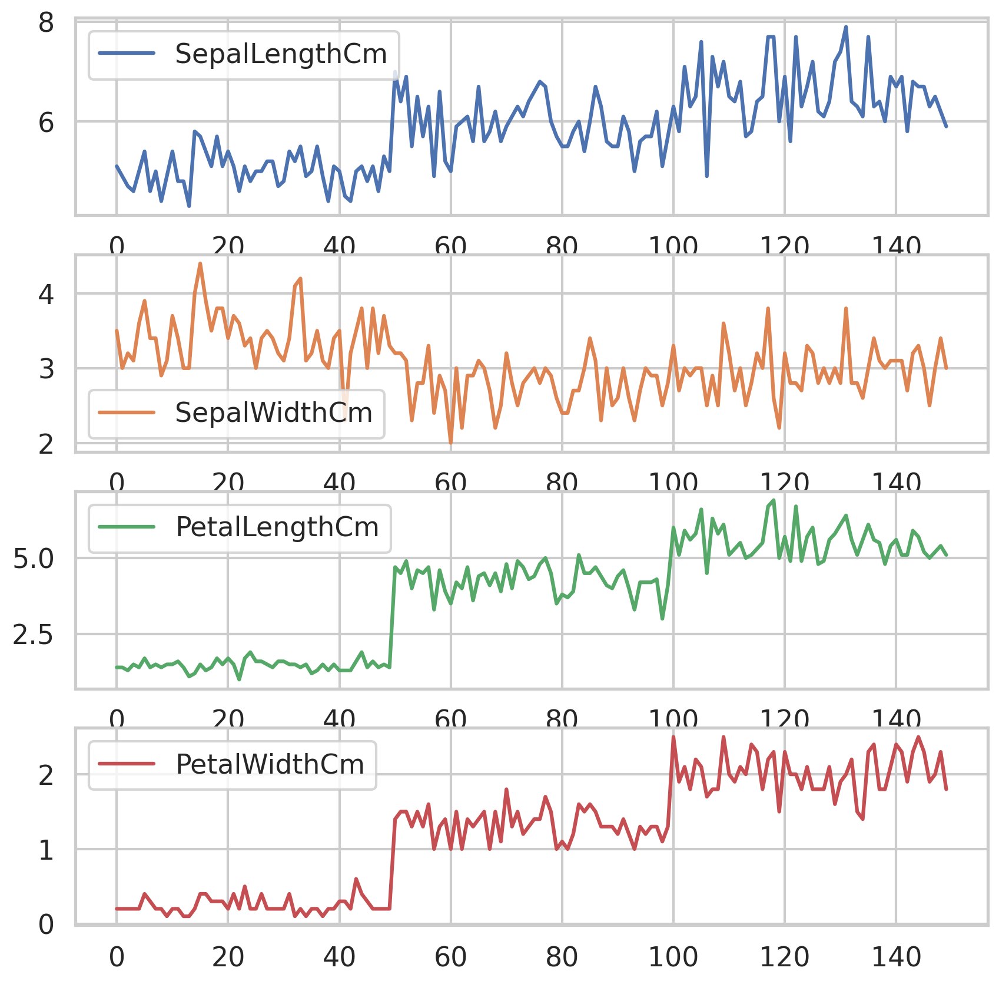

In [9]:
dataset.plot(subplots=True, figsize=(10, 10), sharex=False, sharey=False)
plt.show()

### This section of your project handles data preprocessing and splitting, an essential step before training your MLP.

In [10]:
import numpy as np
import random
from sklearn.model_selection import train_test_split
from sklearn.datasets import load_iris

# Load the Iris dataset
iris_data = load_iris()

# Join features and labels into a single array
iris_dataset = np.column_stack((iris_data.data, iris_data.target.T))  # shape (150, 5)

# Shuffle the dataset (optional: for reproducibility)
random.seed(123)
random.shuffle(iris_dataset)

# Split features (X) and labels (y)
X = iris_dataset[:, :4]
y = iris_dataset[:, 4]


# Use train_test_split to divide into 80% train, 20% test
train_X, test_X, train_y, test_y = train_test_split(
    X, y,
    test_size=0.2,
    random_state=11,  # set for reproducibility
    stratify=y        # keep label proportions balanced
)

# Now you have train_X, train_y, test_X, test_y ready

print(test_y)

[0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 2. 0. 0. 1. 0.
 0. 1. 0. 0. 0. 0.]


##### these next two parts visualize the training and test data splits, which is helpful to understand feature distributions and class separability. 

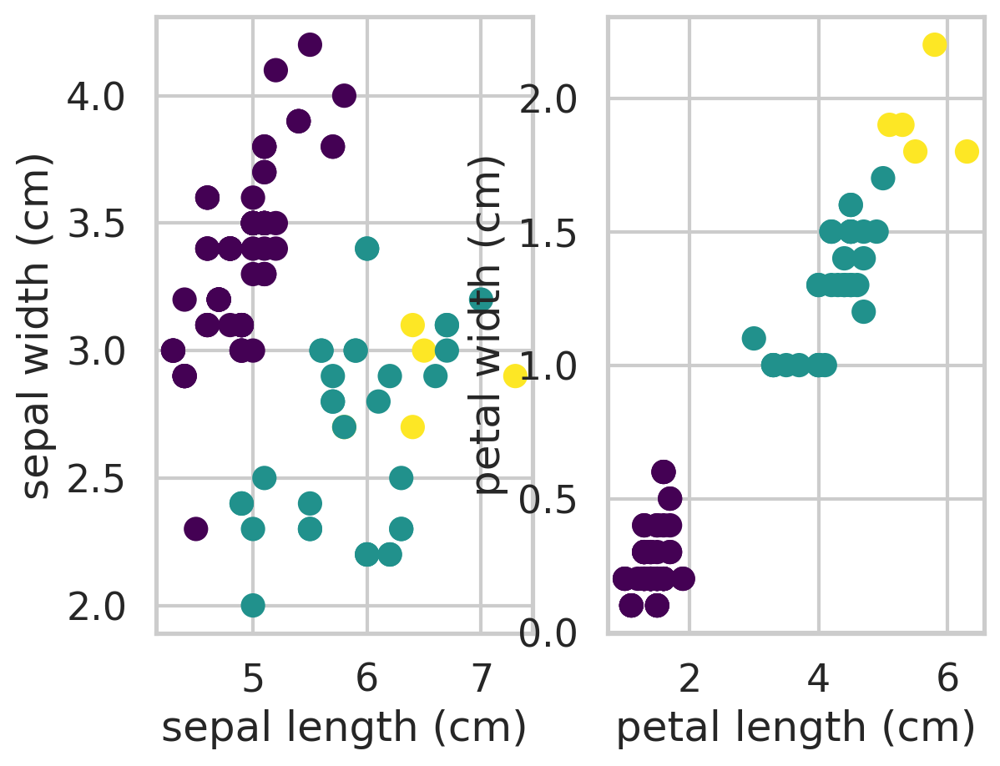

In [11]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm

# Plot training Samples

plt.subplot(1, 2, 1)
plt.scatter(train_X[:,0],train_X[:,1],c=train_y,cmap=cm.viridis)
plt.xlabel(iris_data.feature_names[0])
plt.ylabel(iris_data.feature_names[1])

plt.subplot(1, 2, 2)
plt.scatter(train_X[:,2],train_X[:,3],c=train_y,cmap=cm.viridis)
plt.xlabel(iris_data.feature_names[2])
plt.ylabel(iris_data.feature_names[3]);

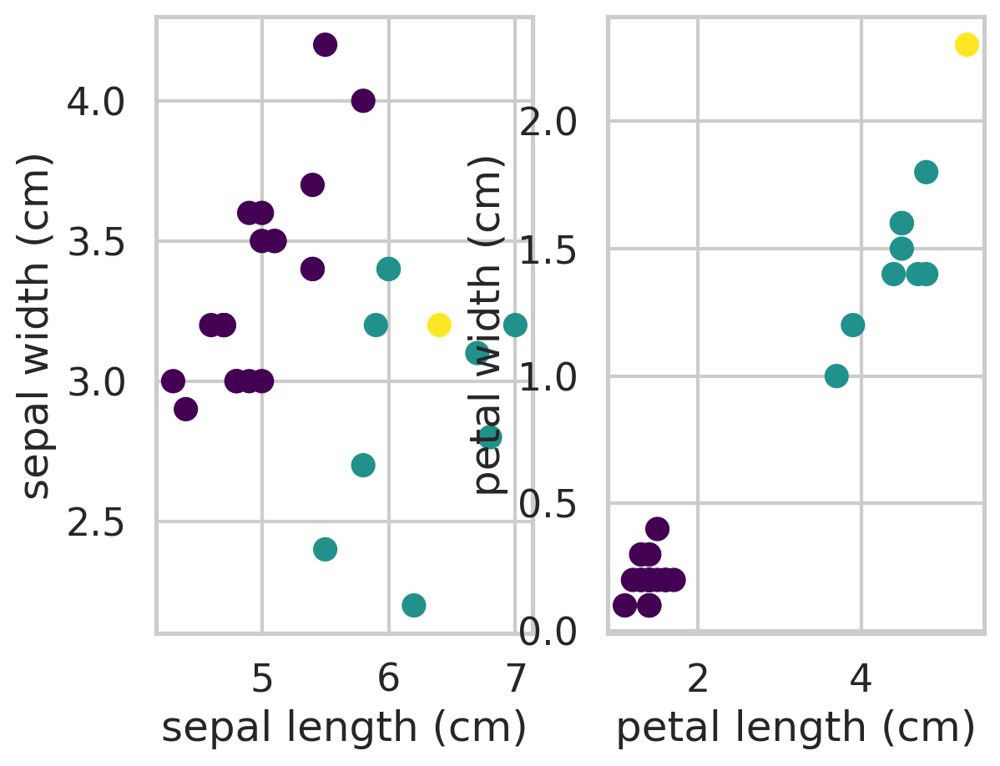

In [12]:
# Plot test samples
plt.subplot(1, 2, 1)
plt.scatter(test_X[:,0],test_X[:,1],c=test_y,cmap=cm.viridis)
plt.xlabel(iris_data.feature_names[0])
plt.ylabel(iris_data.feature_names[1])

plt.subplot(1, 2, 2)
plt.scatter(test_X[:,2],test_X[:,3],c=test_y,cmap=cm.viridis)
plt.xlabel(iris_data.feature_names[2])
plt.ylabel(iris_data.feature_names[3]);

In [17]:
# Implementation the Multilayer Perceptron in Python
from sklearn.base import BaseEstimator, ClassifierMixin, RegressorMixin
import random
import numpy as np
import matplotlib.pyplot as plt

class MultiLayerPerceptron(BaseEstimator, ClassifierMixin):

    def __init__(self, params=None):
        # Store the params argument to satisfy BaseEstimator requirements
        self.params = params

        if (params == None):
            self.inputLayer = 4                        # Input Layer
            self.hiddenLayer = 5                       # Hidden Layer
            self.outputLayer = 3                       # Outpuy Layer
            self.learningRate = 0.005                  # Learning rate
            self.max_epochs = 600                      # Epochs
            self.BiasHiddenValue = -1                   # Bias HiddenLayer
            self.BiasOutputValue = -1                  # Bias OutputLayer
            self.activation = self.ativacao['sigmoid'] # Activation function
            self.deriv = self.derivada['sigmoid']
        else:
            self.inputLayer = params['InputLayer']
            self.hiddenLayer = params['HiddenLayer']
            self.outputLayer = params['OutputLayer']
            self.learningRate = params['LearningRate']
            self.max_epochs = params['Epocas']
            self.BiasHiddenValue = params['BiasHiddenValue']
            self.BiasOutputValue = params['BiasOutputValue']
            self.activation = self.ativacao[params['ActivationFunction']]
            self.deriv = self.derivada[params['ActivationFunction']]

        # Starting Bias and Weights
        # assign ramdom values [-1 .. +1] in order to start with some weights
        # not so symmetric
        # Weight initialization: passing correct arguments to starting_weights
        self.WEIGHT_hidden = self.starting_weights(self.inputLayer, self.hiddenLayer)
        self.WEIGHT_output = self.starting_weights(self.hiddenLayer, self.outputLayer)

        self.BIAS_hidden = np.array([self.BiasHiddenValue for i in range(self.hiddenLayer)])
        self.BIAS_output = np.array([self.BiasOutputValue for i in range(self.outputLayer)]) # Corrected attribute name
        self.classes_number = 3

    pass

    # This function creates a 2D matrix of random values between -1 and +1
    # Shape: rows x columns
    def starting_weights(self, rows, columns):
        #return [[2  * random.random() - 1 for _ in range(columns)] for _ in range(rows)]
        return np.array([[2 * random.random() - 1 for _ in range(columns)] for _ in range(rows)])


    ativacao = {
         'sigmoid': (lambda x: 1/(1 + np.exp(-x))),
            'tanh': (lambda x: np.tanh(x)),
            'Relu': (lambda x: x*(x > 0)),
               }
    derivada = {
         'sigmoid': (lambda x: x*(1-x)),
            'tanh': (lambda x: 1-x**2),
            'Relu': (lambda x: 1 * (x>0))
               }

    # This calculates the error at the output layer and then propagates it
    # backward through the network to update the weights in each layer
    def Backpropagation_Algorithm(self, x):
        DELTA_output = []
        # Stage 1 - Error: OutputLayer (target - predicted)
        ERROR_output = self.output - self.OUTPUT_L2
        DELTA_output = ((-1)*(ERROR_output) * self.deriv(self.OUTPUT_L2))

        arrayStore = []
        # Stage 2 - Update weights OutputLayer and HiddenLayer
        for i in range(self.hiddenLayer):
            for j in range(self.outputLayer): # Corrected attribute name
                self.WEIGHT_output[i][j] -= (self.learningRate * (DELTA_output[j] * self.OUTPUT_L1[i]))
                self.BIAS_output[j] -= (self.learningRate * DELTA_output[j])

        # Stage 3 - Error: HiddenLayer
        delta_hidden = np.matmul(self.WEIGHT_output, DELTA_output)* self.deriv(self.OUTPUT_L1)

        # Stage 4 - Update weights HiddenLayer and InputLayer(x)
        for i in range(self.inputLayer):
            for j in range(self.hiddenLayer):
                self.WEIGHT_hidden[i][j] -= (self.learningRate * (delta_hidden[j] * x[i]))
                self.BIAS_hidden[j] -= (self.learningRate * delta_hidden[j])



    def show_err_graphic(self,v_erro,v_epoca):
        plt.figure(figsize=(9,4))
        plt.plot(v_epoca, v_erro, color="b", marker=11)
        plt.xlabel("Number of Epochs")
        plt.ylabel("Squared error (MSE) ");
        plt.title("Error Minimization")
        plt.show()


    def predict(self, X, y):
        'Returns the predictions for every element of X'
        my_predictions = []
        'Forward Propagation'
        forward = np.matmul(X,self.WEIGHT_hidden) + self.BIAS_hidden
        forward = np.matmul(forward, self.WEIGHT_output) + self.BIAS_output
        for i in forward:
            my_predictions.append(max(enumerate(i), key=lambda x:x[1])[0])

        array_score = []
        for i in range(len(my_predictions)):
            if my_predictions[i] == 0:
                array_score.append([i, 'Iris-setosa', my_predictions[i], y[i]])
            elif my_predictions[i] == 1:
                 array_score.append([i, 'Iris-versicolour', my_predictions[i], y[i]])
            elif my_predictions[i] == 2:
                 array_score.append([i, 'Iris-virginica', my_predictions[i], y[i]])

        dataframe = pd.DataFrame(array_score, columns=['_id', 'class', 'output', 'hoped_output'])
        return my_predictions, dataframe

    def fit(self, X, y):
        count_epoch = 1
        total_error = 0
        n = len(X);
        epoch_array = []
        error_array = []
        # Initialize lists to store specific weight values for plotting
        weight_over_epochs_W0_plot = []
        weight_over_epochs_W1_plot = []


        while(count_epoch <= self.max_epochs):
            for idx,inputs in enumerate(X):
                self.output = np.zeros(self.classes_number)
                'Stage 1 - (Forward Propagation)'
                self.OUTPUT_L1 = self.activation((np.dot(inputs, self.WEIGHT_hidden) + self.BIAS_hidden))
                self.OUTPUT_L2 = self.activation((np.dot(self.OUTPUT_L1, self.WEIGHT_output) + self.BIAS_output))
                'Stage 2 - One-Hot-Encoding'
                if(y[idx] == 0):
                    self.output = np.array([1,0,0]) #Class1 {1,0,0}
                elif(y[idx] == 1):
                    self.output = np.array([0,1,0]) #Class2 {0,1,0}
                elif(y[idx] == 2):
                    self.output = np.array([0,0,1]) #Class3 {0,0,1}

                square_error = np.mean((self.output - self.OUTPUT_L2)**2)
                total_error += square_error
                '''
                square_error = 0
                for i in range(self.outputLayer):
                    erro = (self.output[i] - self.OUTPUT_L2[i])**2
                    square_error = (square_error + (0.05 * erro))
                    total_error = total_error + square_error
                        '''
                'Backpropagation : Update Weights'
                self.Backpropagation_Algorithm(inputs)

            # The original code calculates total_error per batch, then divides by n (number of samples).
            # It's more standard to calculate the mean squared error per epoch by summing errors over
            # all samples in the epoch and then dividing by the number of output neurons.
            # Keeping the original logic for total_error calculation, but this is not
            # a standard MSE calculation.
            total_error = (total_error / n)
            if((count_epoch % 50 == 0)or(count_epoch == 1)):
                print("Epoch ", count_epoch, "- Total Error: ",total_error)
                error_array.append(total_error)
                epoch_array.append(count_epoch)
                # Append the specific weight values only when we are recording the epoch
                weight_over_epochs_W0_plot.append(self.WEIGHT_hidden[0][0])
                weight_over_epochs_W1_plot.append(self.WEIGHT_output[0][0])


            # Reset total_error for the next epoch
            total_error = 0

            count_epoch += 1
        self.show_err_graphic(error_array,epoch_array)

        # Plot the change of a *single* weight over the epochs that were recorded
        plt.figure(figsize=(8, 4))
        # Use the new lists which have the same length as epoch_array
        plt.plot(epoch_array, weight_over_epochs_W0_plot, label='Weight[0][0]')
        plt.title('Change of a Sample Weight (Input 0 to Hidden 0) over Epochs')
        plt.xlabel('Number of Epochs')
        plt.ylabel('Weight Value')
        plt.legend()
        plt.show()

        plt.figure(figsize=(8, 4))
        # Use the new lists which have the same length as epoch_array
        plt.plot(epoch_array, weight_over_epochs_W1_plot, label='Weight[0][0]')
        plt.title('Change of a Sample Weight (Hidden 0 to Output 0) over Epochs')
        plt.xlabel('Number of Epochs')
        plt.ylabel('Weight Value')
        plt.legend()
        plt.show()


        return self

In [20]:
def run_experiment(train_X, train_y, test_X, test_y,
                   n_input=4, n_hidden=5, n_output=3,
                   learning_rate=0.005, epochs=3000,
                   activation='sigmoid', show_plot=True):

    # Step 1: Setup MLP config
    config = {
        'InputLayer': n_input,
        'HiddenLayer': n_hidden,
        'OutputLayer': n_output,
        'Epocas': epochs,
        'LearningRate': learning_rate,
        'BiasHiddenValue': -1,
        'BiasOutputValue': -1,
        'ActivationFunction': activation
    }

    mlp = MultiLayerPerceptron(config)
    mlp.fit(train_X, train_y)

    # Step 2: Predict on test and train sets
    pred_test, _ = mlp.predict(test_X, test_y)
    pred_train, _ = mlp.predict(train_X, train_y)

    # === Test evaluation ===
    def evaluate(y_true, y_pred, dataset_name="Test"):
        total = len(y_true)
        hits = 0
        per_class_hits = [0, 0, 0]
        per_class_total = [0, 0, 0]

        for i, label in enumerate(y_true):
            label = int(label)
            pred = int(y_pred[i])
            if label == pred:
                hits += 1
                per_class_hits[label] += 1
            per_class_total[label] += 1

        acc_total = (hits / total) * 100 if total else 0
        acc_per_class = [(per_class_hits[i] / per_class_total[i]) * 100 if per_class_total[i] else 0 for i in range(3)]

        print(f"Overall accuracy: {acc_total:.2f}%")
        for i, name in enumerate(['Setosa', 'Versicolour', 'Virginica']):  
            print(f" - Accuracy {name}: {acc_per_class[i]:.2f}%")

        # Print result summary
        print(f"\n=== {dataset_name} Results ===")
        print("Porcents :", f"{acc_total:.2f}% hits and {100 - acc_total:.2f}% faults")
        print("Total samples of", dataset_name.lower(), total)
        class_names = ["Iris-Setosa", "Iris-Versicolour", "Iris-Virginica"]
        for i, name in enumerate(class_names):
            print(f"* {name}: {per_class_total[i]} samples, {per_class_hits[i]} hits")
        
        return acc_total, acc_per_class

    acc_test_total, acc_test_class = evaluate(test_y, pred_test, "Test")
    acc_train_total, acc_train_class = evaluate(train_y, pred_train, "Train")

    # Optional plot
    if show_plot:
        import matplotlib.pyplot as plt
        names = ["Setosa", "Versicolour", "Virginica"]
        x1 = [2.0, 4.0, 6.0]
        plt.figure()
        plt.bar(x1[0] - 0.4, acc_test_class[0], color='orange', label='Test - Setosa', width=0.4)
        plt.bar(x1[0], acc_train_class[0], color='orange', alpha=0.4, label='Train - Setosa', width=0.4)

        plt.bar(x1[1] - 0.4, acc_test_class[1], color='green', label='Test - Versicolour', width=0.4)
        plt.bar(x1[1], acc_train_class[1], color='green', alpha=0.4, label='Train - Versicolour', width=0.4)

        plt.bar(x1[2] - 0.4, acc_test_class[2], color='purple', label='Test - Virginica', width=0.4)
        plt.bar(x1[2], acc_train_class[2], color='purple', alpha=0.4, label='Train - Virginica', width=0.4)

        plt.ylabel('Accuracy (%)')
        plt.xticks(x1, names)
        plt.title(f'Accuracy by Class\nNeurons: {n_hidden}, LR: {learning_rate}, Epochs: {epochs}')
        plt.ylim(0, 110)
        plt.legend()
        plt.show()

    # Return results for logging if needed
    return {
        'neurons': n_hidden,
        'epochs': epochs,
        'learning_rate': learning_rate,
        'activation': activation,
        'accuracy_test_total': acc_test_total,
        'accuracy_test_per_class': acc_test_class,
        'accuracy_train_total': acc_train_total,
        'accuracy_train_per_class': acc_train_class,
    }



 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.001
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2559661734083644
Epoch  50 - Total Error:  0.20682956905806535
Epoch  100 - Total Error:  0.18067013911776525
Epoch  150 - Total Error:  0.1683650564262867
Epoch  200 - Total Error:  0.16168575655026599
Epoch  250 - Total Error:  0.1566206571147319
Epoch  300 - Total Error:  0.1403554363969395
Epoch  350 - Total Error:  0.11640202331849599
Epoch  400 - Total Error:  0.10045867205930802
Epoch  450 - Total Error:  0.08836301666622606
Epoch  500 - Total Error:  0.07863432113705196


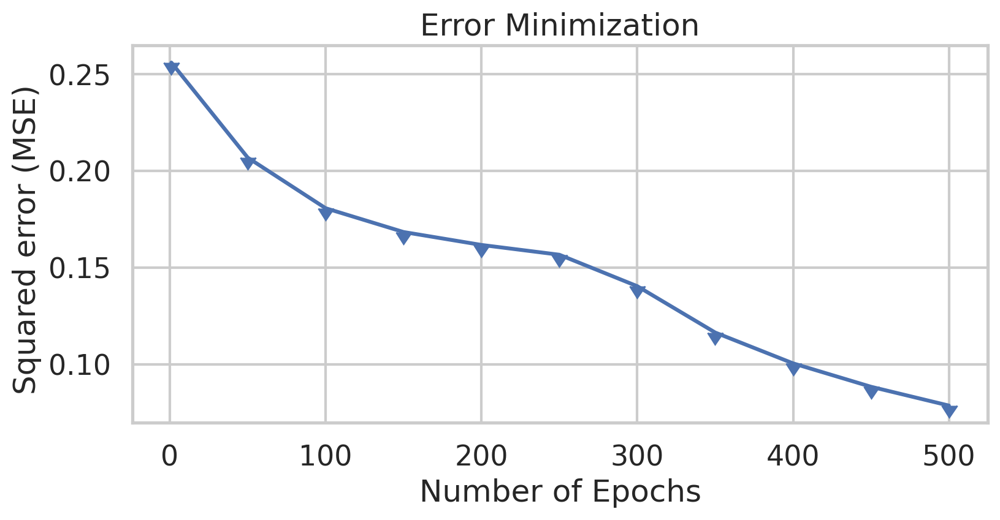

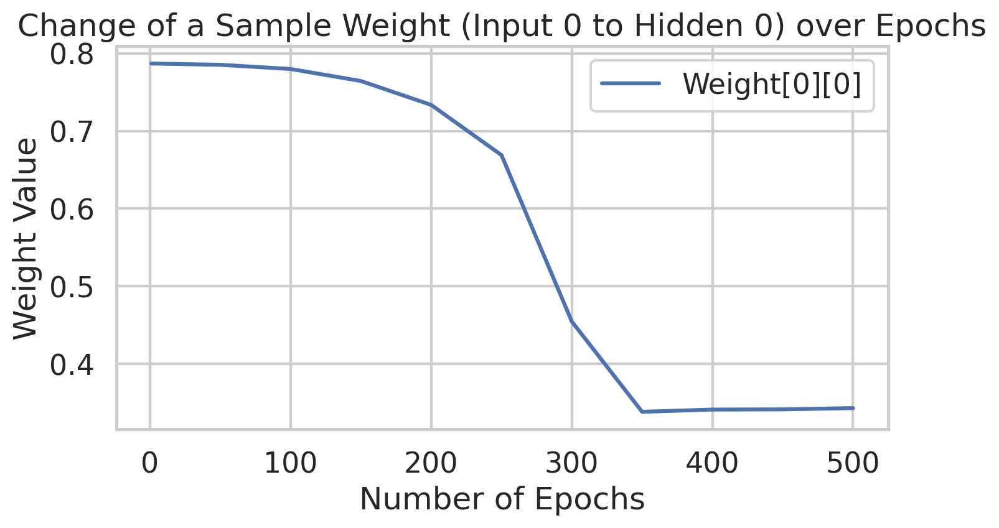

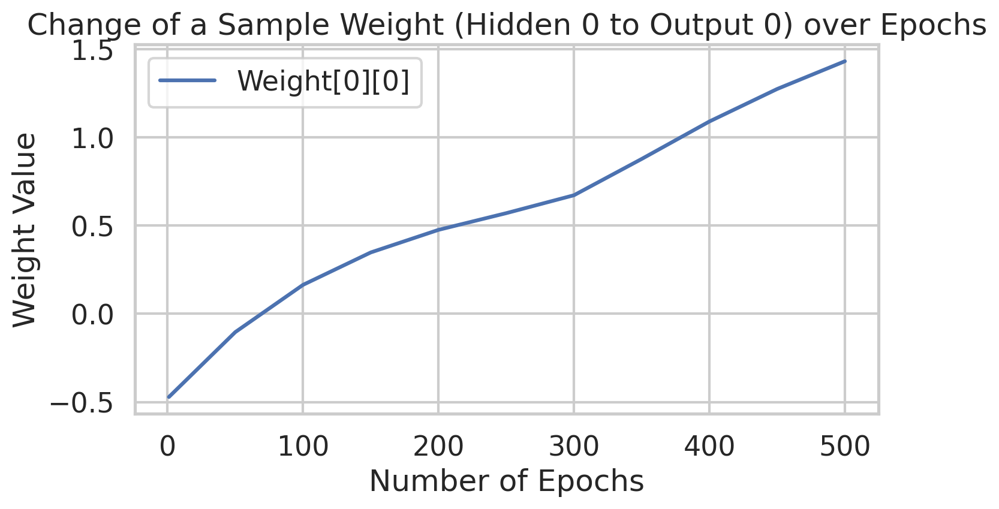

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.001
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.23562396846756506
Epoch  50 - Total Error:  0.17269003513665734
Epoch  100 - Total Error:  0.1595068747055693
Epoch  150 - Total Error:  0.15591925663550046
Epoch  200 - Total Error:  0.15449270576457183
Epoch  250 - Total Error:  0.1537565

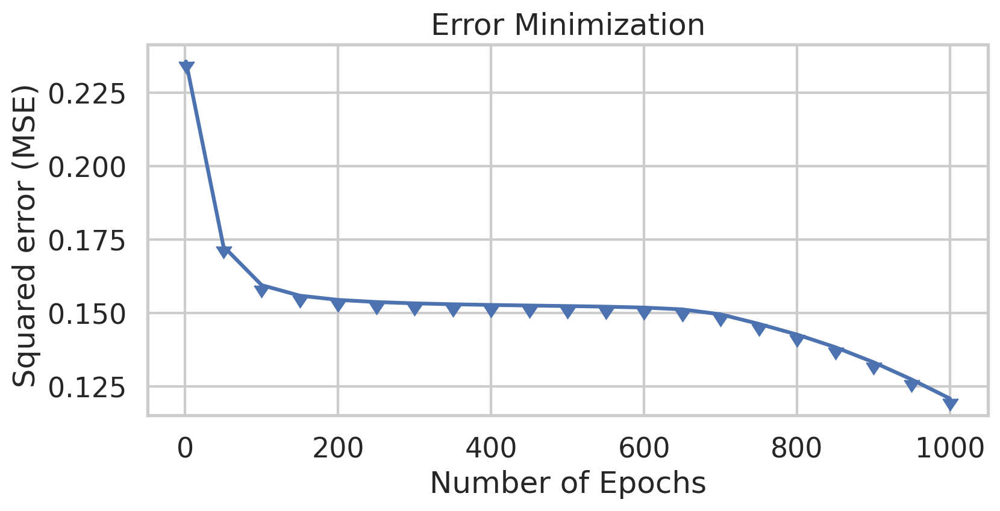

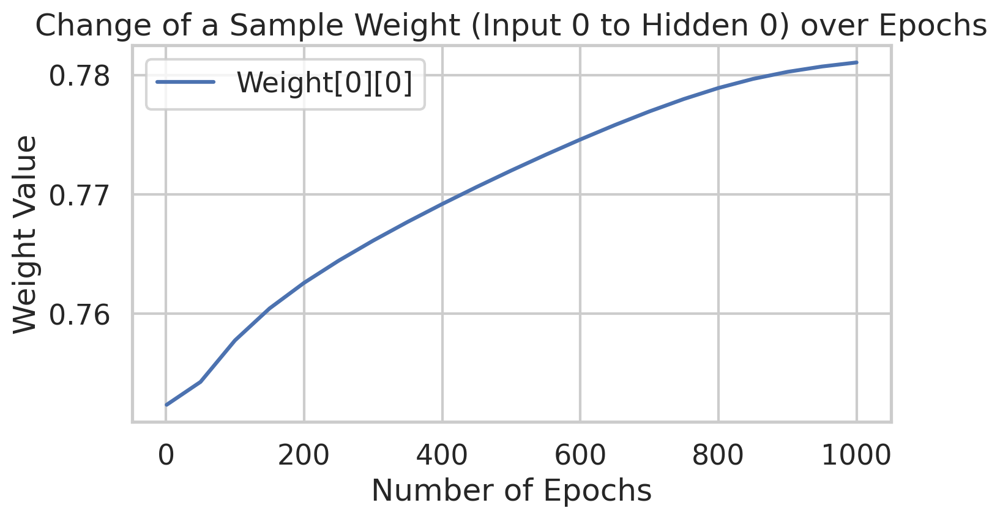

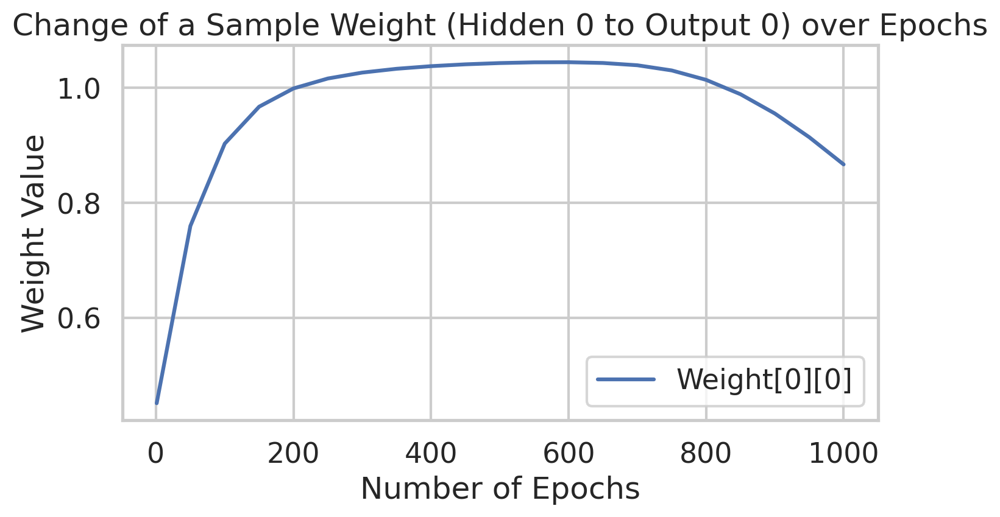

Overall accuracy: 70.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 11.11%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 70.00% hits and 30.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 1 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 70.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 6.06%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 70.00% hits and 30.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 2 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.001
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.23464883183099458
Epoch  50 - Total Error:  0.18171765456209268
Epoch  100 - Total Error:  0.1586616640192224
Epoch  150 - Total Error:  0.15425534799449198
Epoch  200 - Total Error:  0.14970185394317598
Epoch  250 - Total Error:  0.141178579

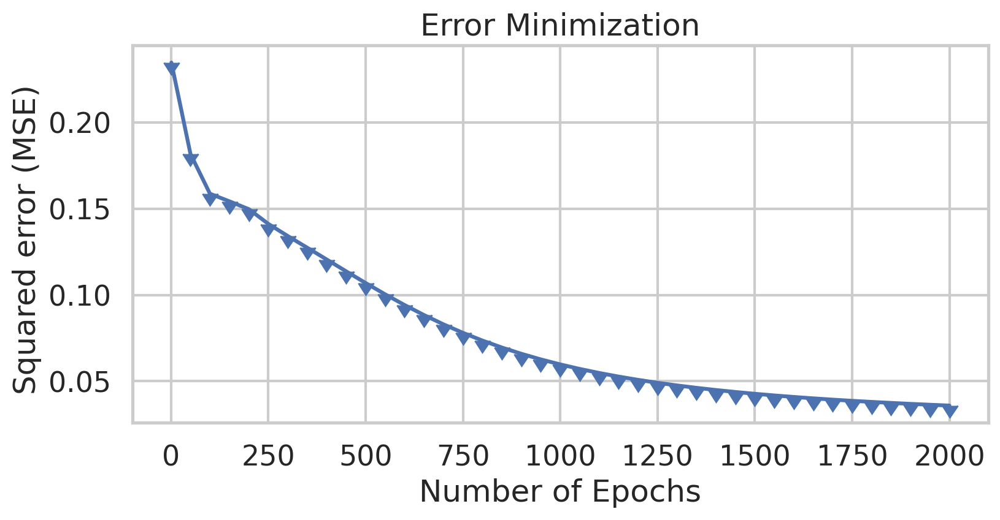

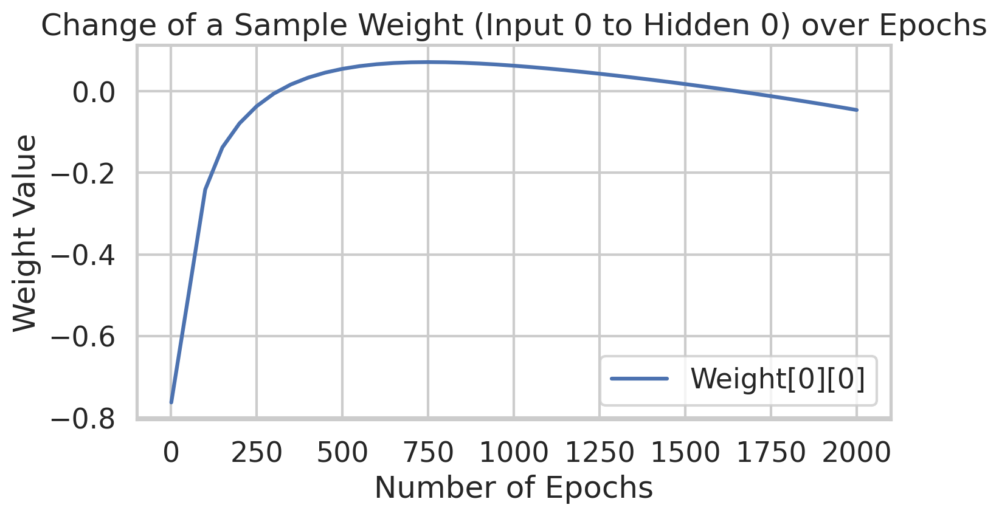

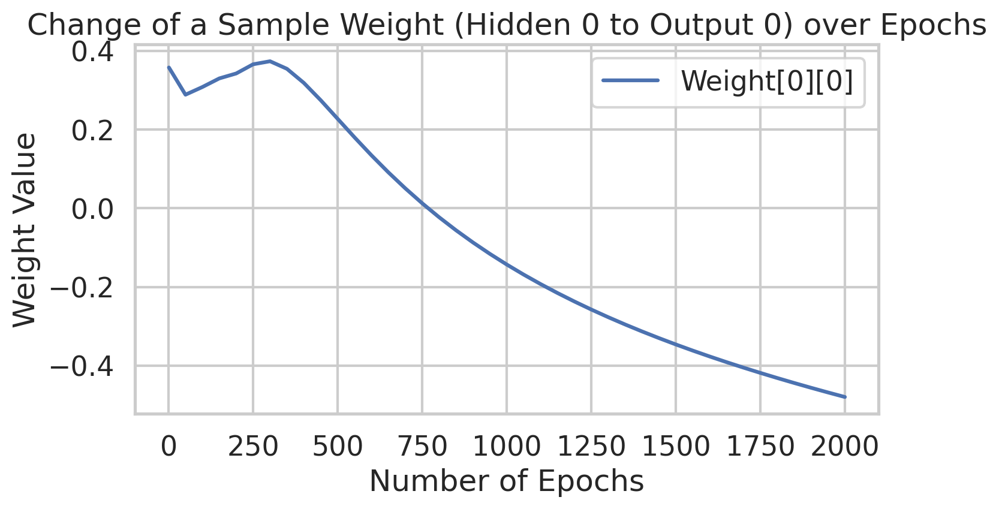

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.001
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.25207129604837214
Epoch  50 - Total Error:  0.188208029376836
Epoch  100 - Total Error:  0.1677611320826406
Epoch  150 - Total Error:  0.16042311676342122
Epoch  200 - Total Error:  0.15721560488636815
Epoch  250 - Total Error:  0.155571394

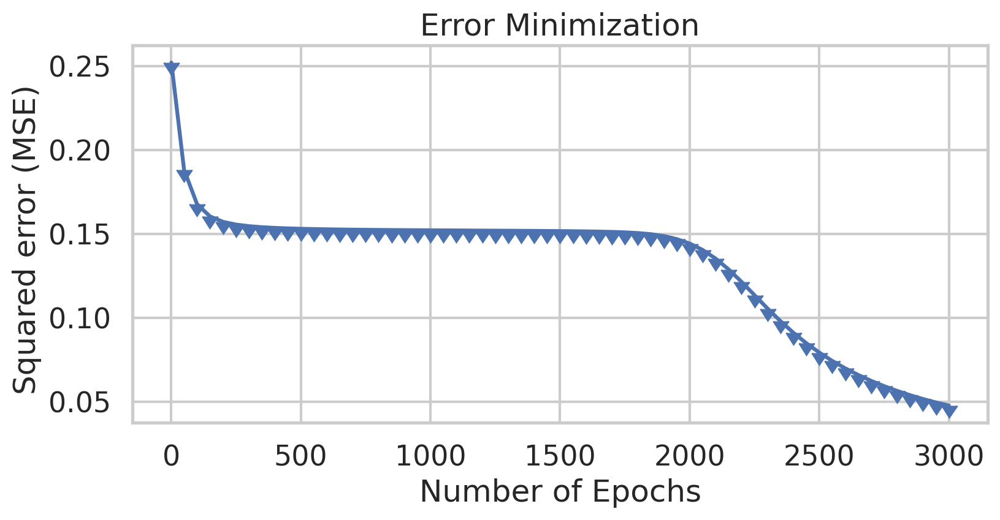

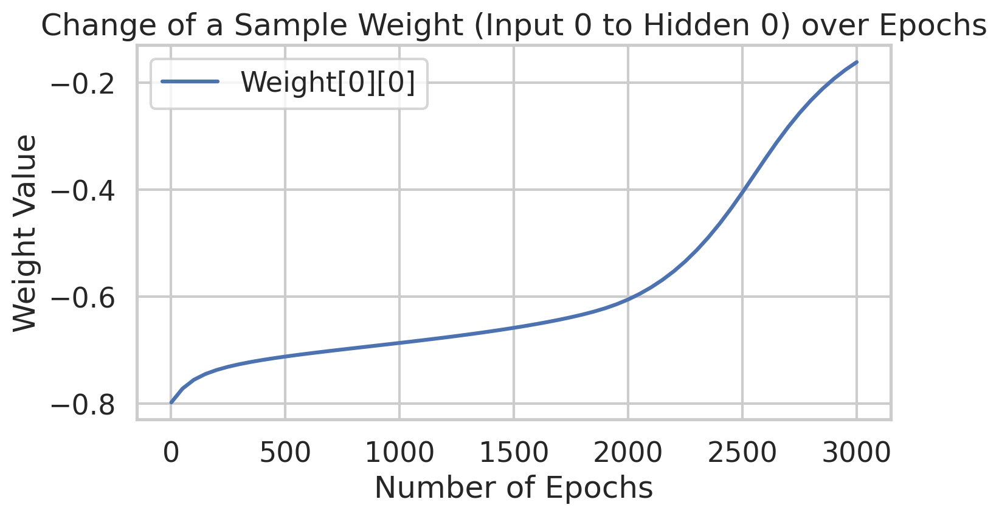

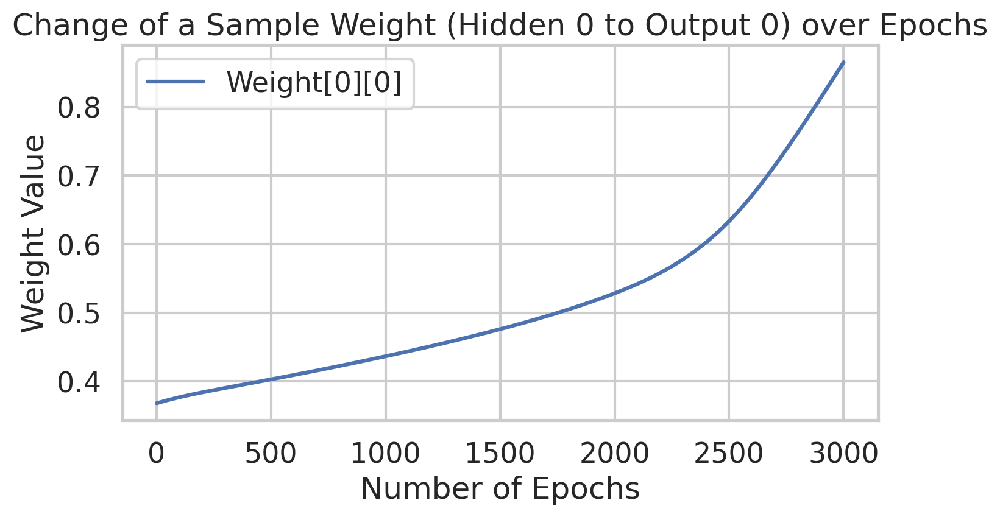

Overall accuracy: 70.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 11.11%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 70.00% hits and 30.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 1 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 70.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 9.09%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 70.83% hits and 29.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 3 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.001
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.31056206361462835
Epoch  50 - Total Error:  0.17923988375498298
Epoch  100 - Total Error:  0.13218381788596922
Epoch  150 - Total Error:  0.11496661898793754
Epoch  200 - Total Error:  0.10438977523432823
Epoch  250 - Total Error:  0.09593812

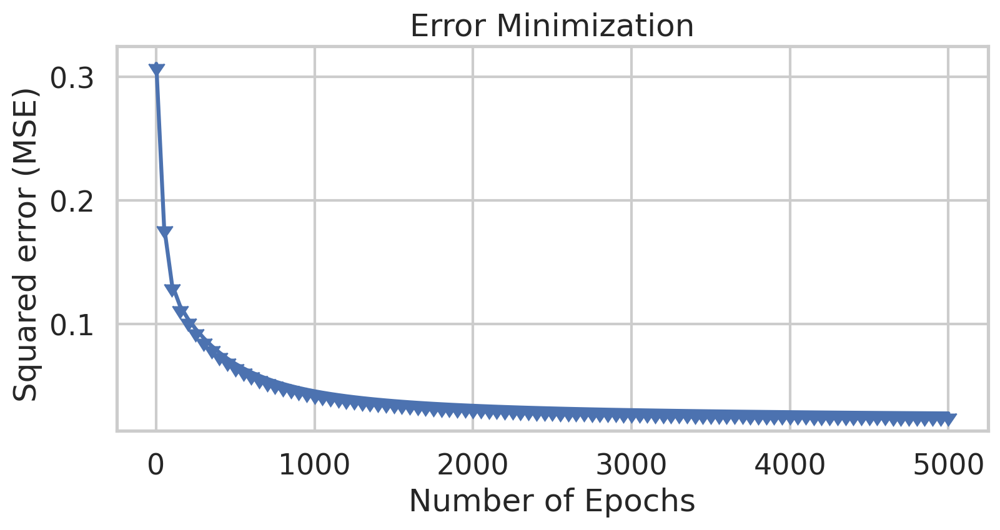

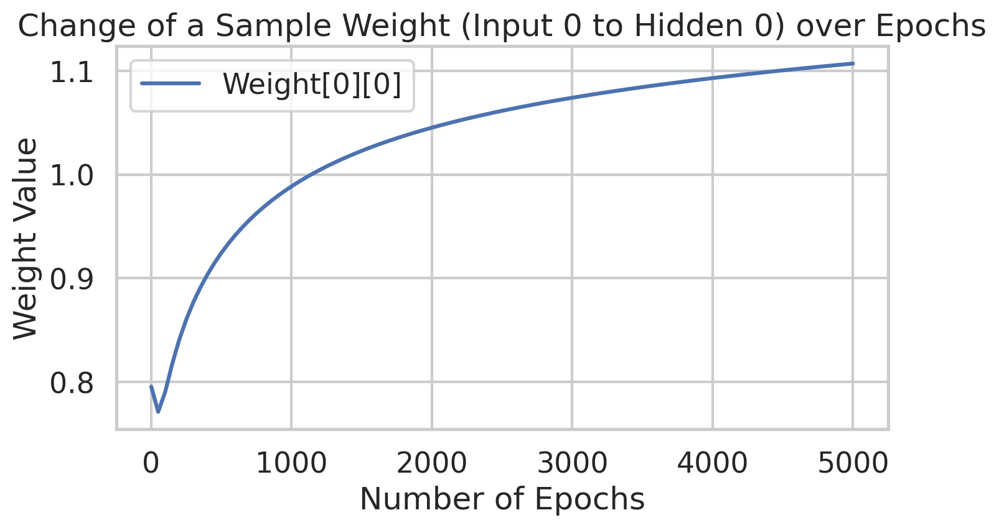

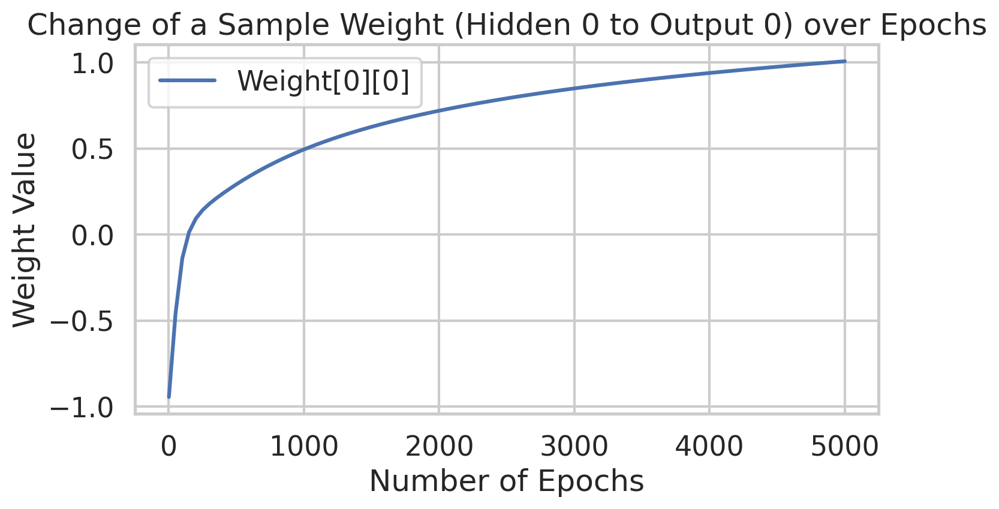

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 96.97%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 32 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.005
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.21301278140857788
Epoch  50 - Total Error:  0.09583117978966721
Epoch  100 - Total Error:  0.07035848140555322
Epoch  150 - Total Error:  0.05607402122925021
Epoch  200 - Total Error:  0.047516448395469674
Epoch  250 - Total Error:  0.0420856

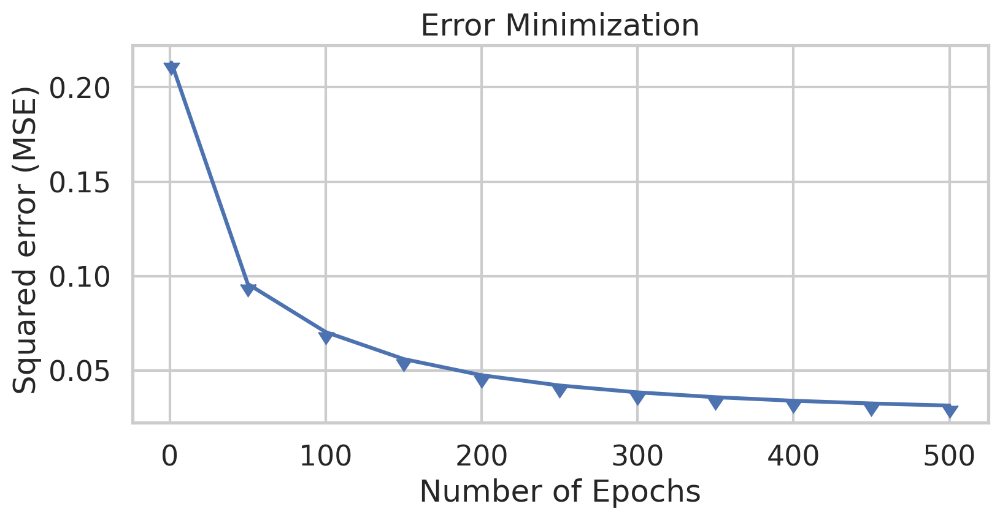

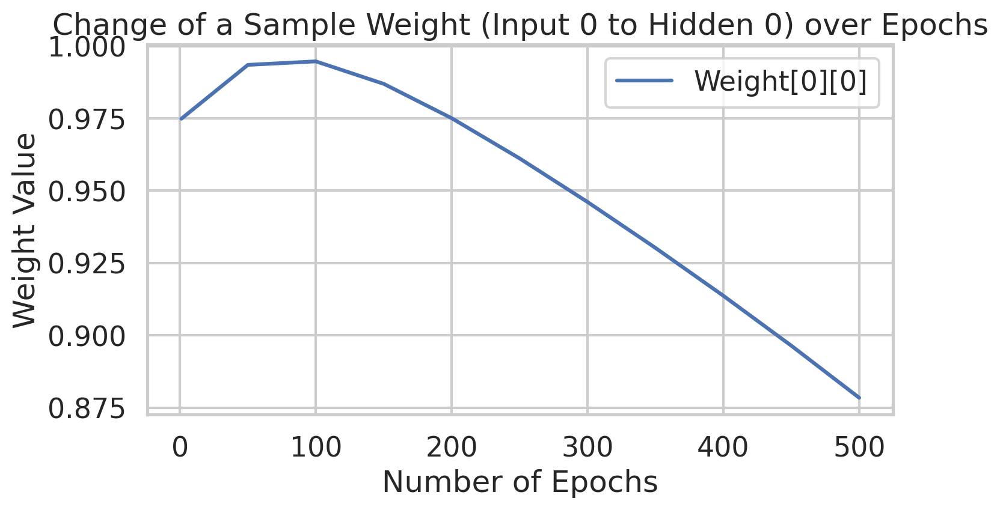

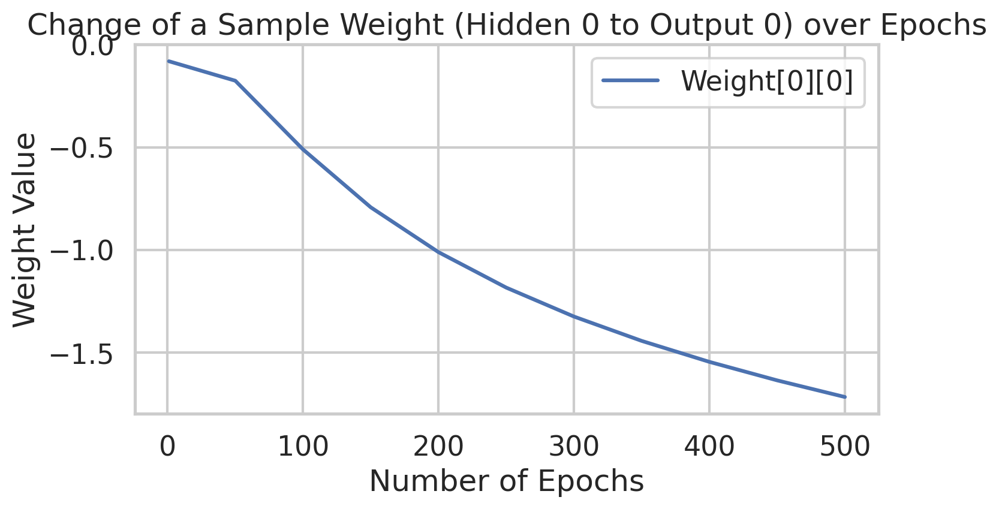

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.005
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2931708291498553
Epoch  50 - Total Error:  0.1599676284681518
Epoch  100 - Total Error:  0.12233077432148501
Epoch  150 - Total Error:  0.09975757880297624
Epoch  200 - Total Error:  0.091563984257864
Epoch  250 - Total Error:  0.0868580392

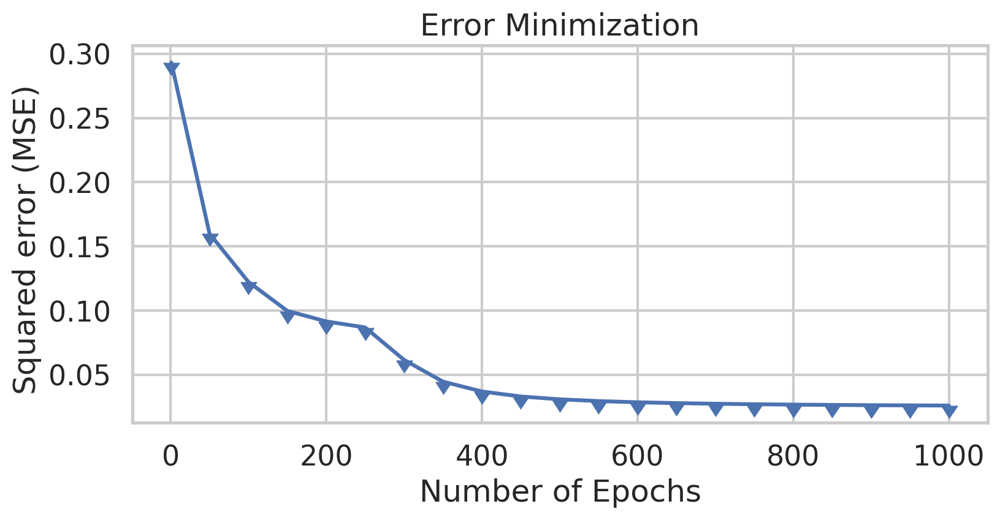

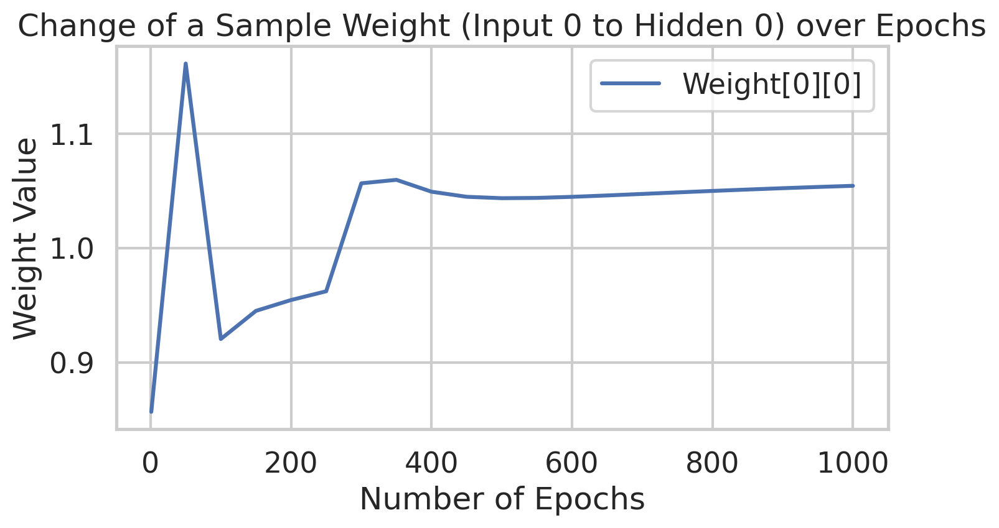

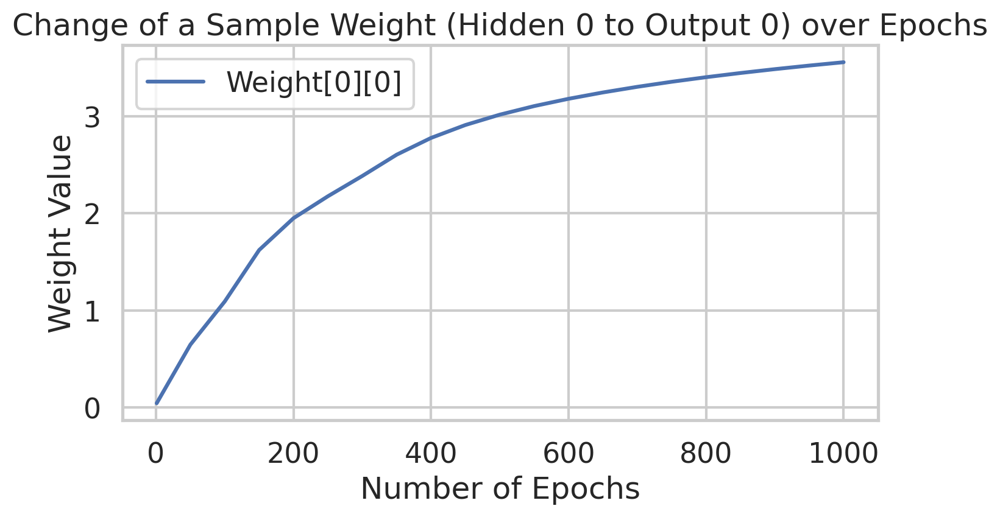

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.005
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.1813693100327004
Epoch  50 - Total Error:  0.1546305100150863
Epoch  100 - Total Error:  0.15307283503299024
Epoch  150 - Total Error:  0.15262315759408565
Epoch  200 - Total Error:  0.1524180762434994
Epoch  250 - Total Error:  0.152304230

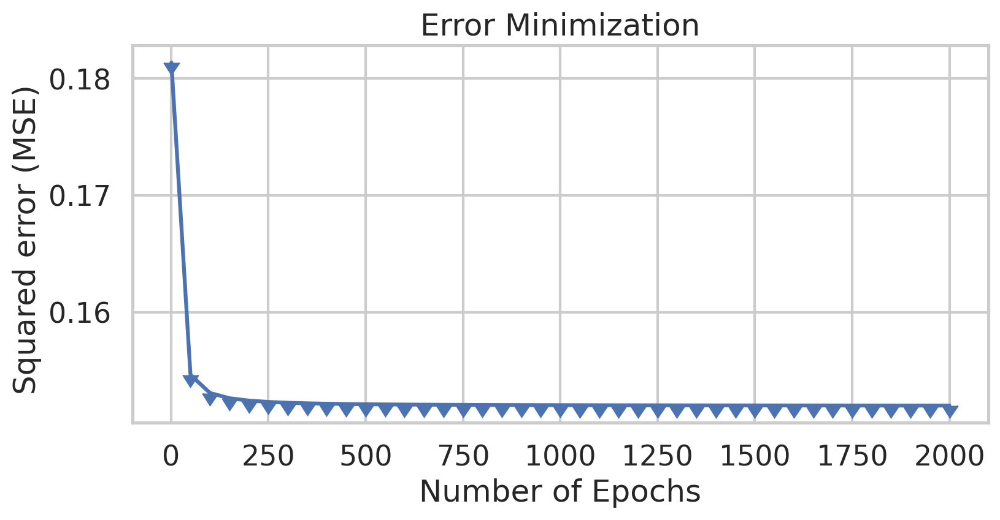

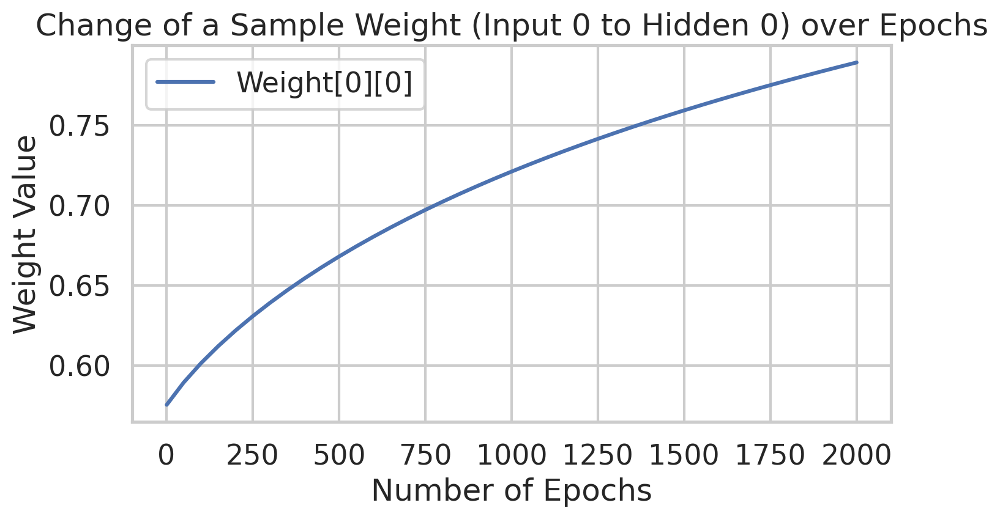

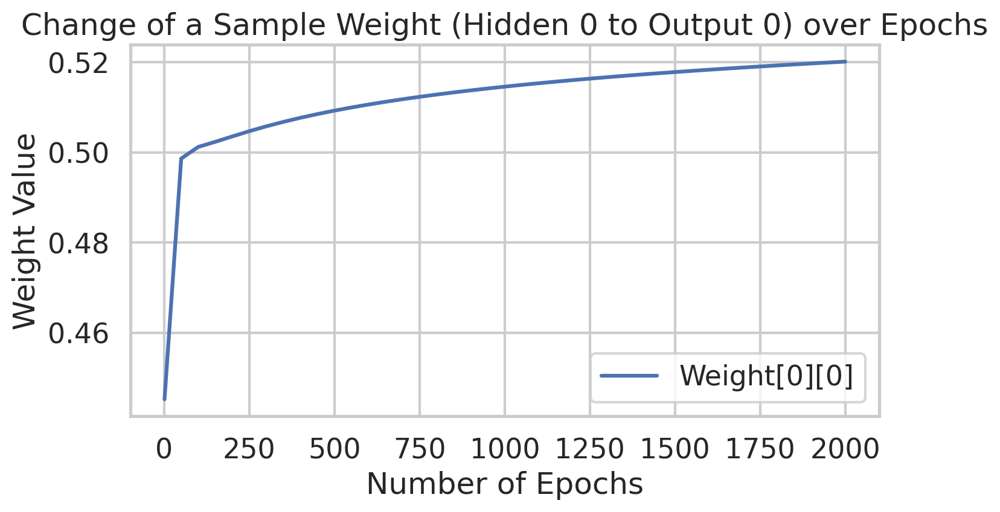

Overall accuracy: 66.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 0.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 66.67% hits and 33.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 0 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 68.33%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 0.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 68.33% hits and 31.67% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 0 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.005
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3248365560468552
Epoch  50 - Total Error:  0.15633295104028333
Epoch  100 - Total Error:  0.14075992589130024
Epoch  150 - Total Error:  0.1115436265417377
Epoch  200 - Total Error:  0.08402884900281053
Epoch  250 - Total Error:  0.06470872250

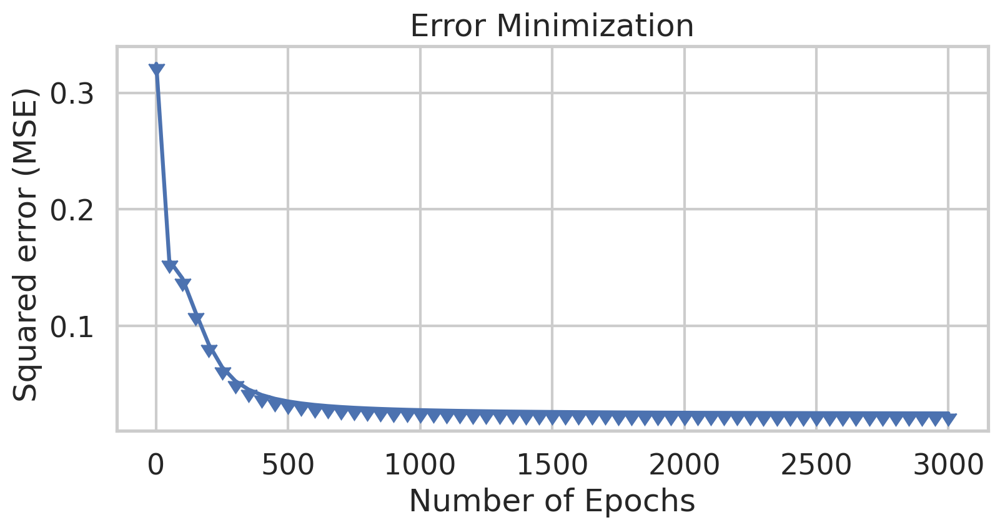

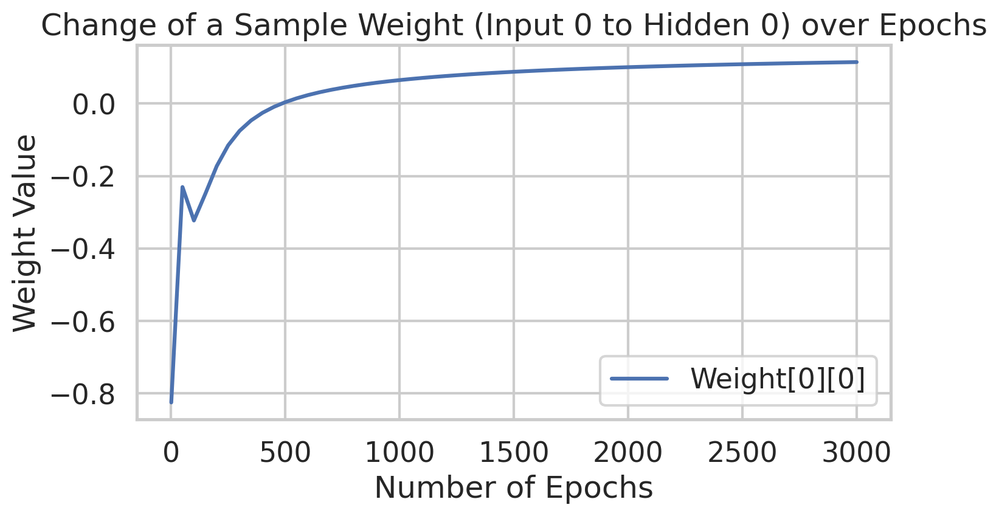

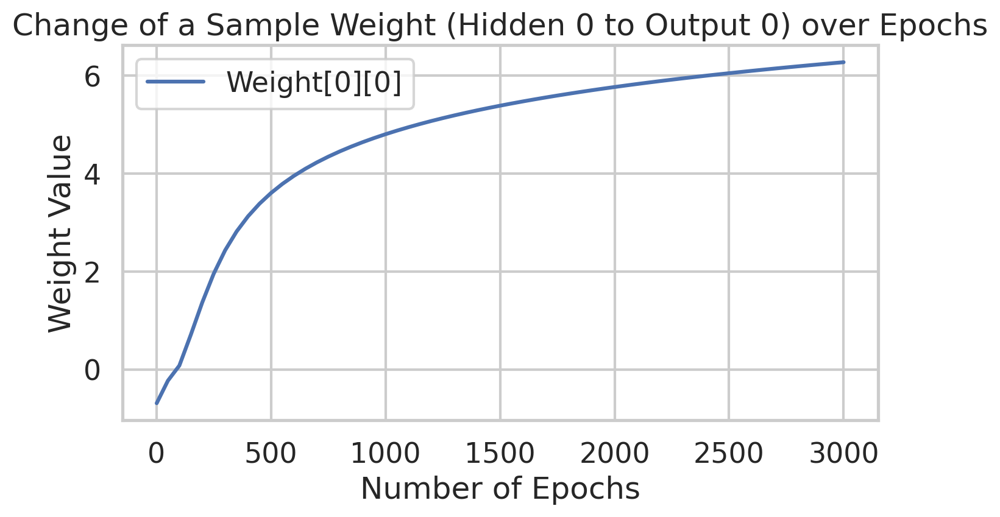

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.005
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.4683254745776554
Epoch  50 - Total Error:  0.15770002374532696
Epoch  100 - Total Error:  0.15369269766737065
Epoch  150 - Total Error:  0.15289991720689233
Epoch  200 - Total Error:  0.15257719872385095
Epoch  250 - Total Error:  0.1524072

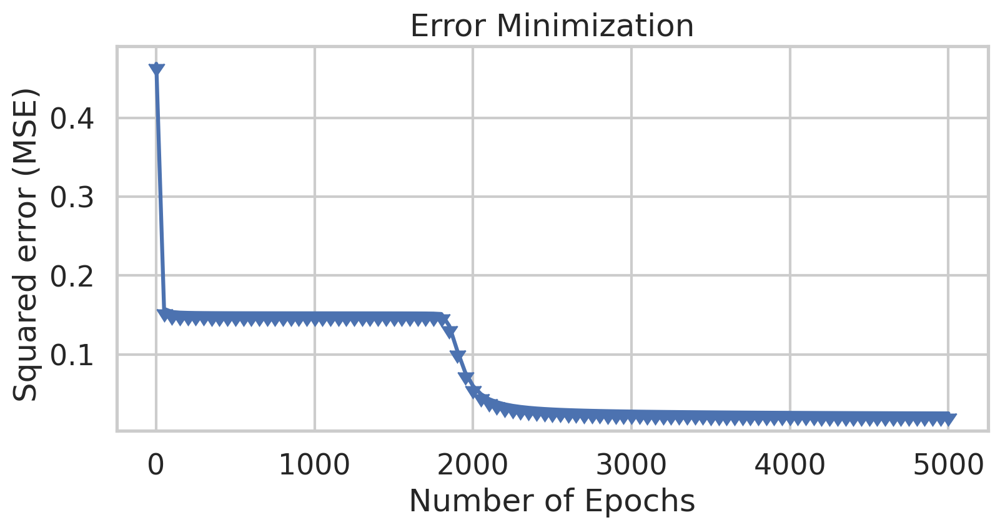

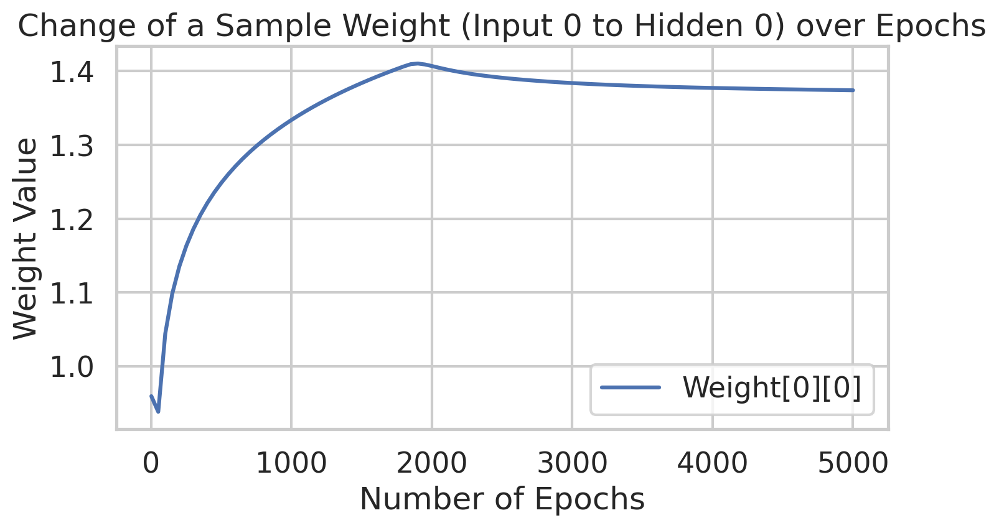

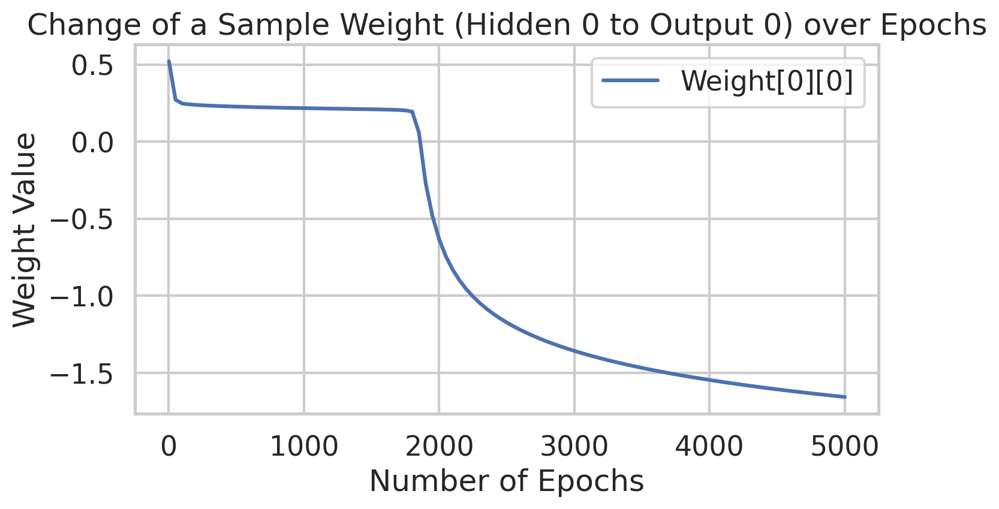

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.00%
 - Accuracy Setosa: 98.78%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 81 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.01
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.17788803005565948
Epoch  50 - Total Error:  0.08065720522832673
Epoch  100 - Total Error:  0.051545061645716775
Epoch  150 - Total Error:  0.040227068317403705
Epoch  200 - Total Error:  0.03492752945707649
Epoch  250 - Total Error:  0.0320117

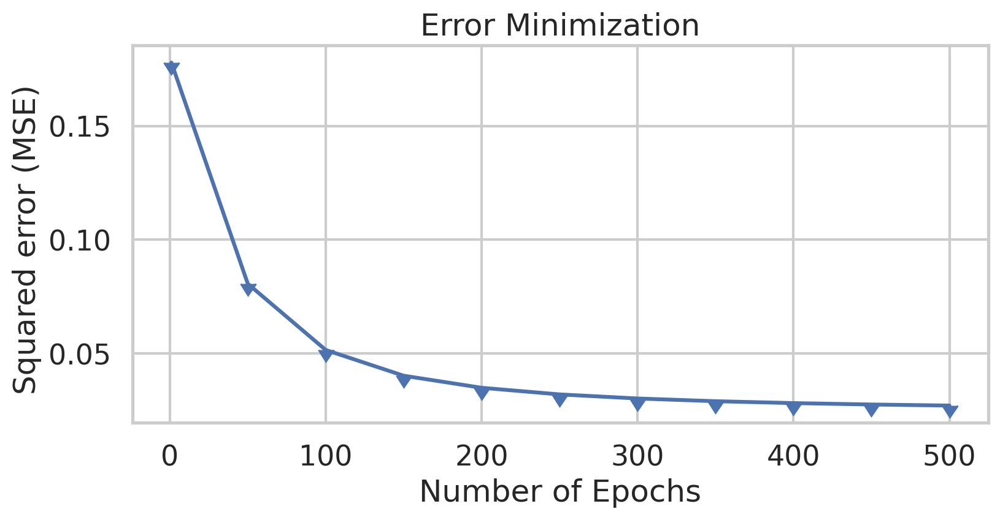

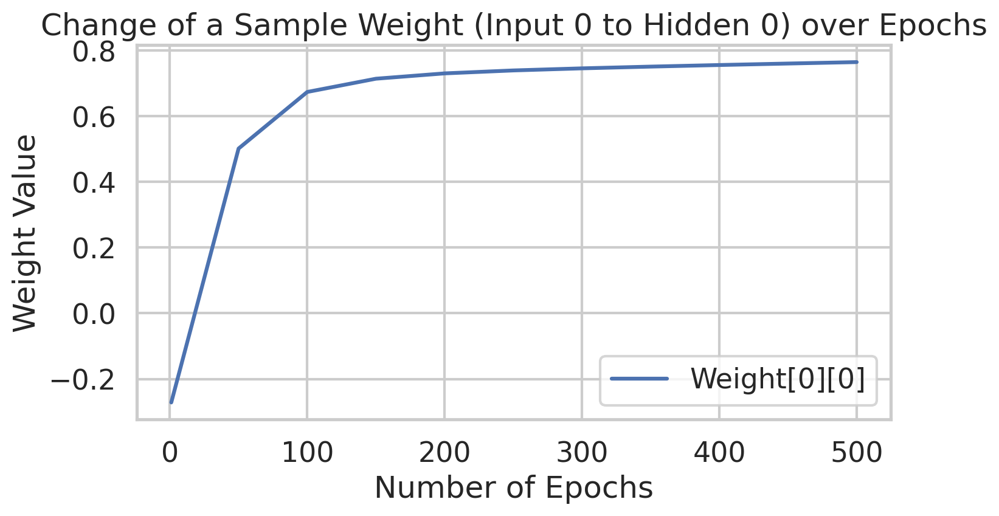

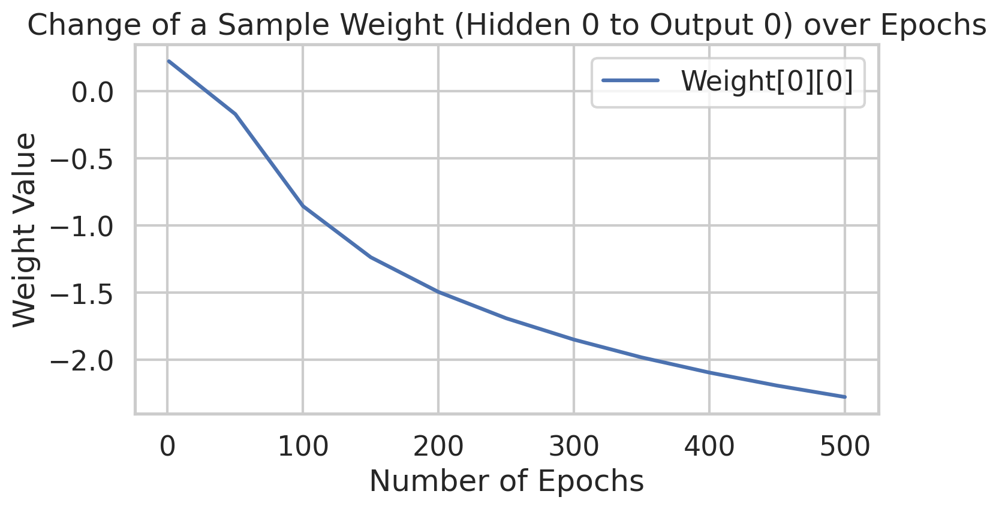

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.01
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.31466310282525867
Epoch  50 - Total Error:  0.129488204954366
Epoch  100 - Total Error:  0.05904519145838628
Epoch  150 - Total Error:  0.037837054899940444
Epoch  200 - Total Error:  0.03184495021665385
Epoch  250 - Total Error:  0.02936110

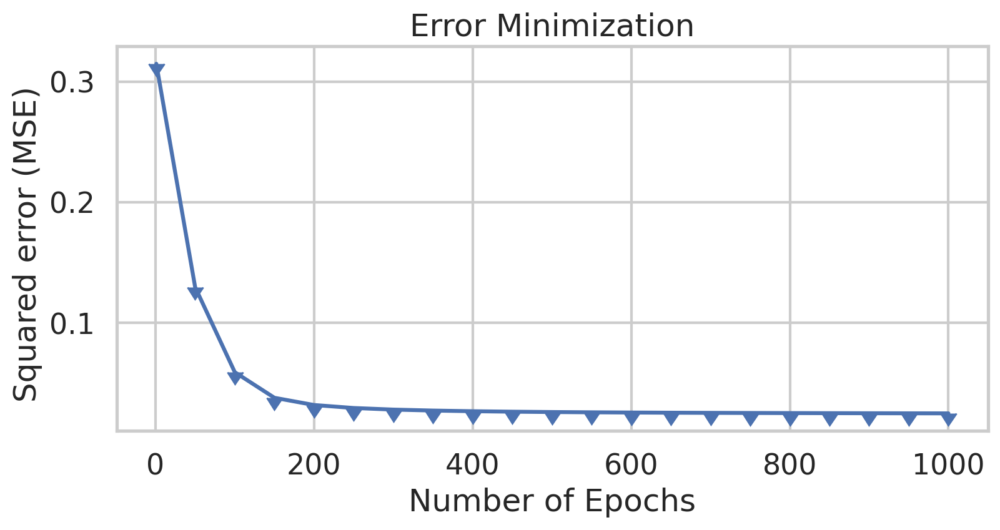

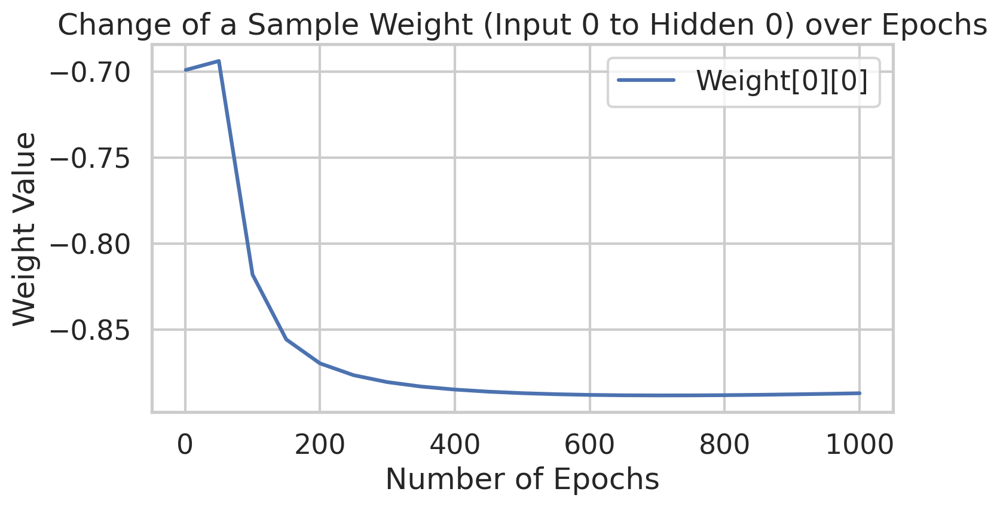

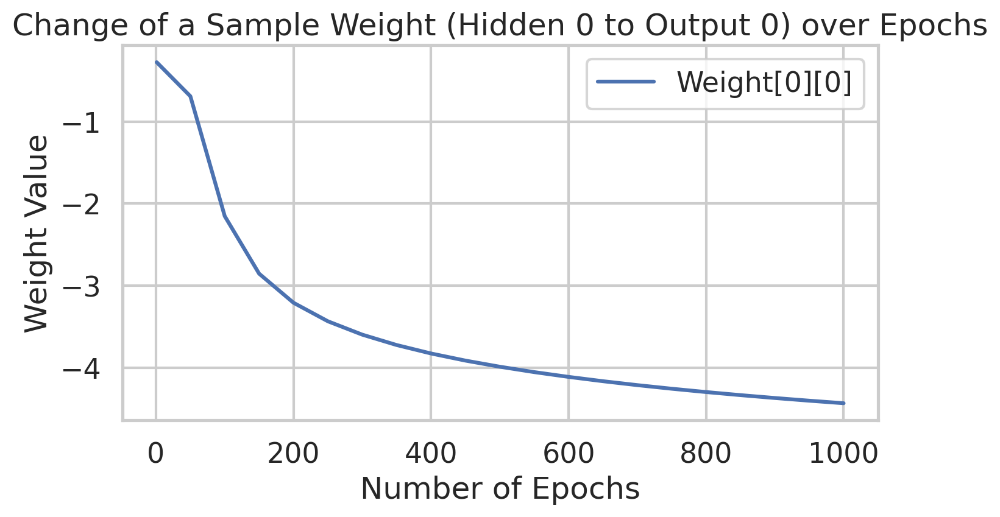

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.01
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2811031954047058
Epoch  50 - Total Error:  0.10399314666500305
Epoch  100 - Total Error:  0.08896079393227
Epoch  150 - Total Error:  0.08500841575126962
Epoch  200 - Total Error:  0.08327775337755892
Epoch  250 - Total Error:  0.08232169065

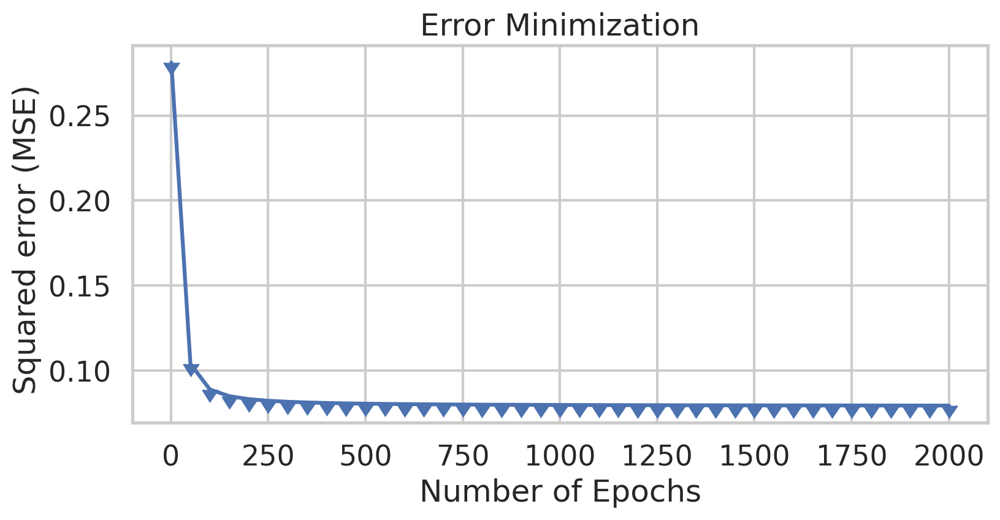

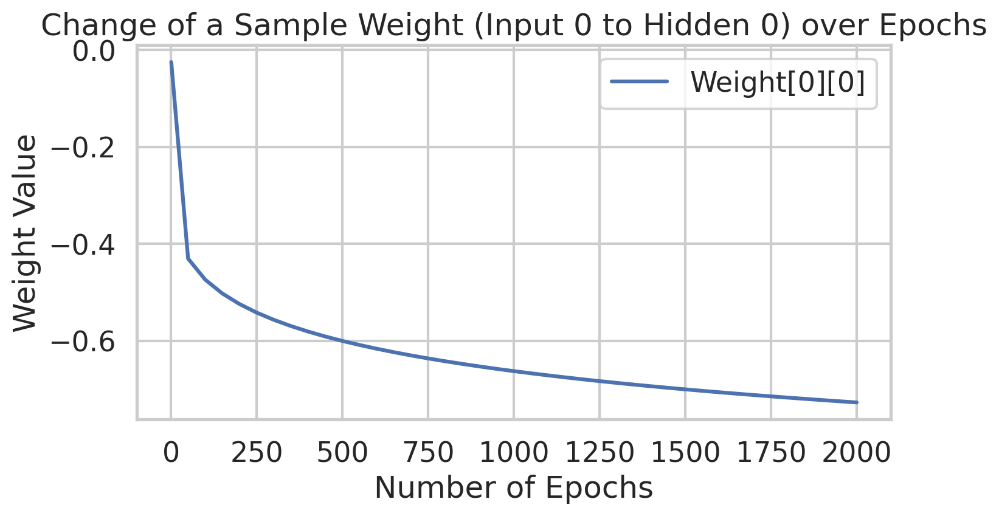

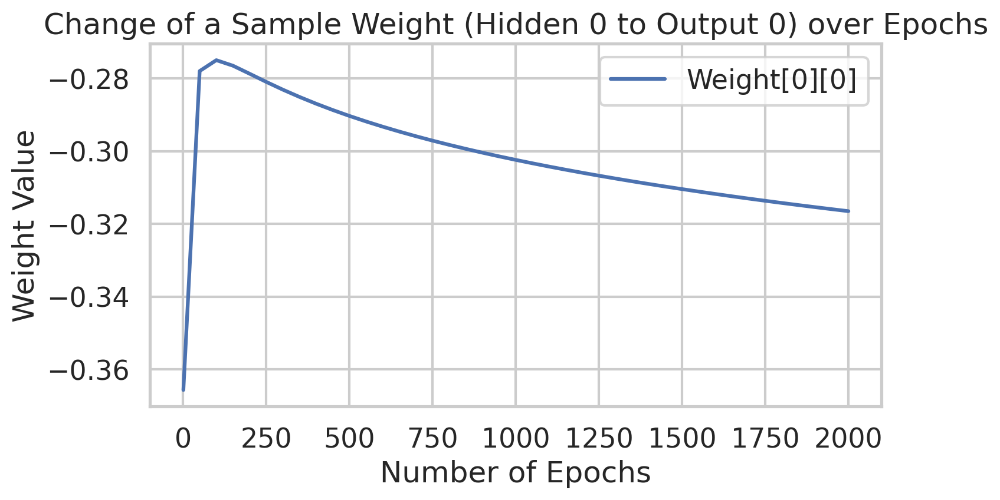

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.01
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2721333318423606
Epoch  50 - Total Error:  0.15502376716494443
Epoch  100 - Total Error:  0.15231137481629328
Epoch  150 - Total Error:  0.09610599301015191
Epoch  200 - Total Error:  0.05546255701814642
Epoch  250 - Total Error:  0.04199351

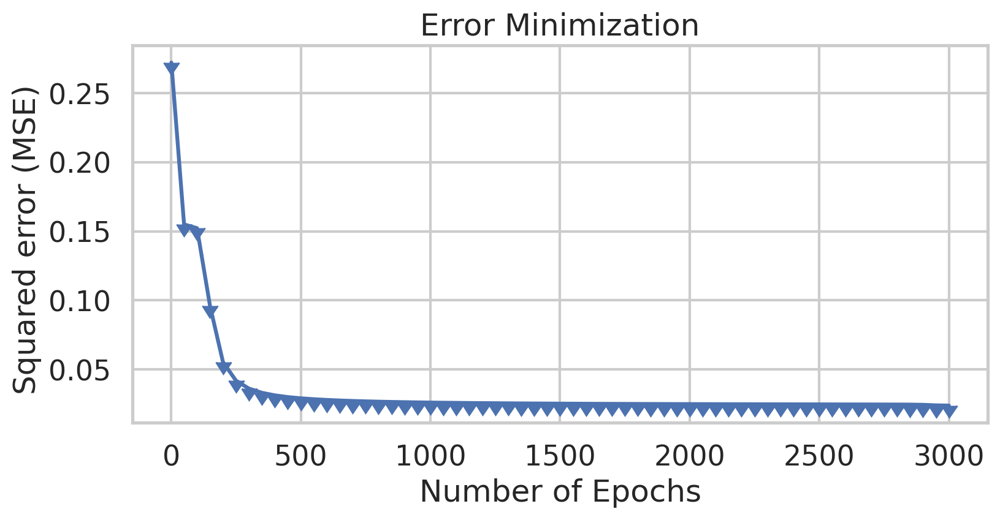

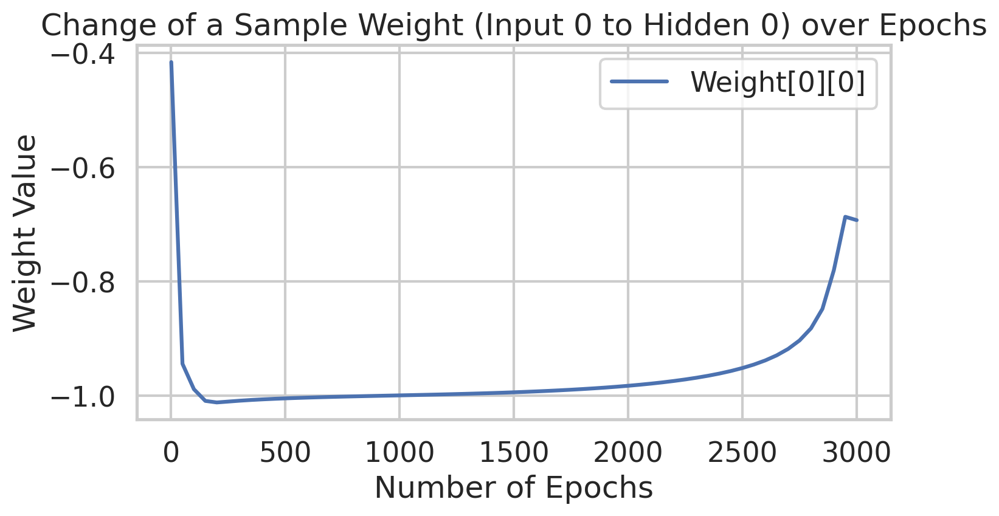

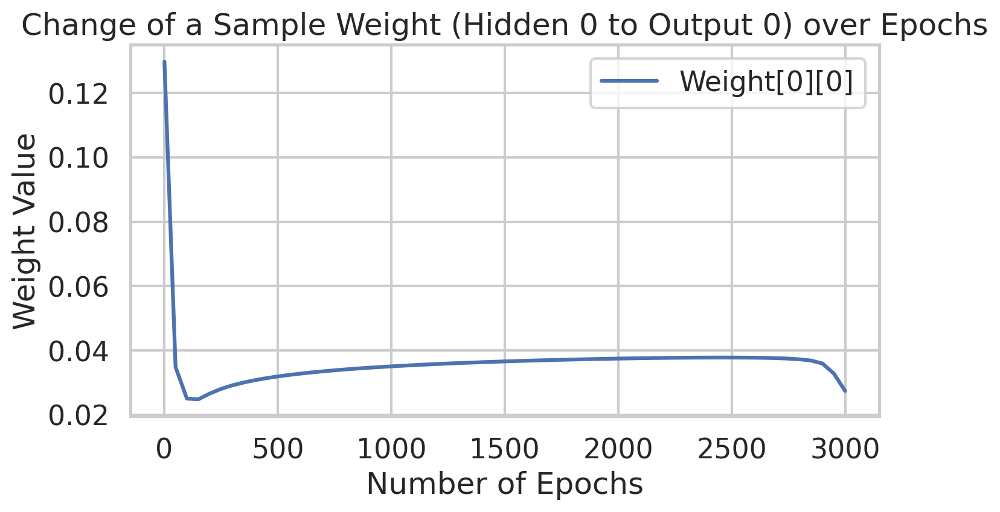

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 96.97%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 32 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.01
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2022969595347714
Epoch  50 - Total Error:  0.09922052659281119
Epoch  100 - Total Error:  0.0484303136107403
Epoch  150 - Total Error:  0.03386754133221442
Epoch  200 - Total Error:  0.0294995938454111
Epoch  250 - Total Error:  0.02769936329

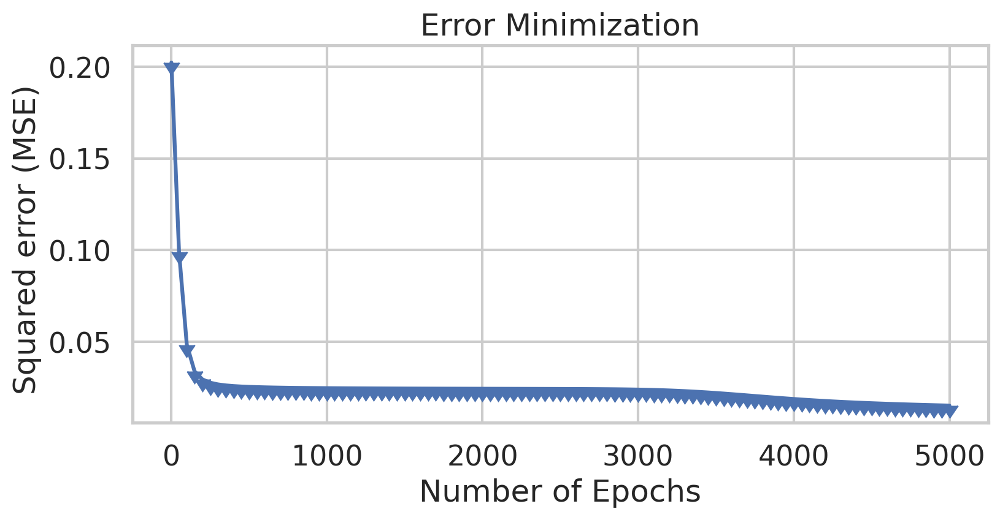

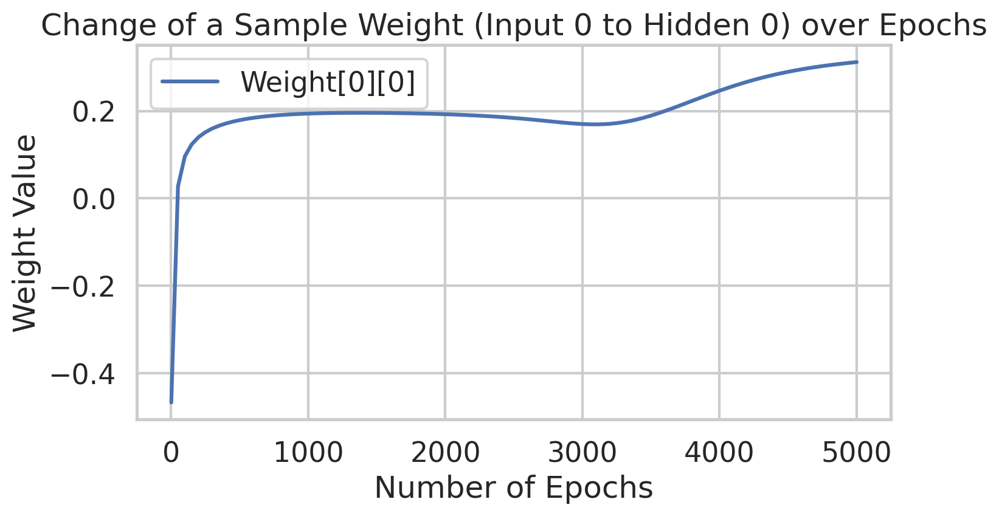

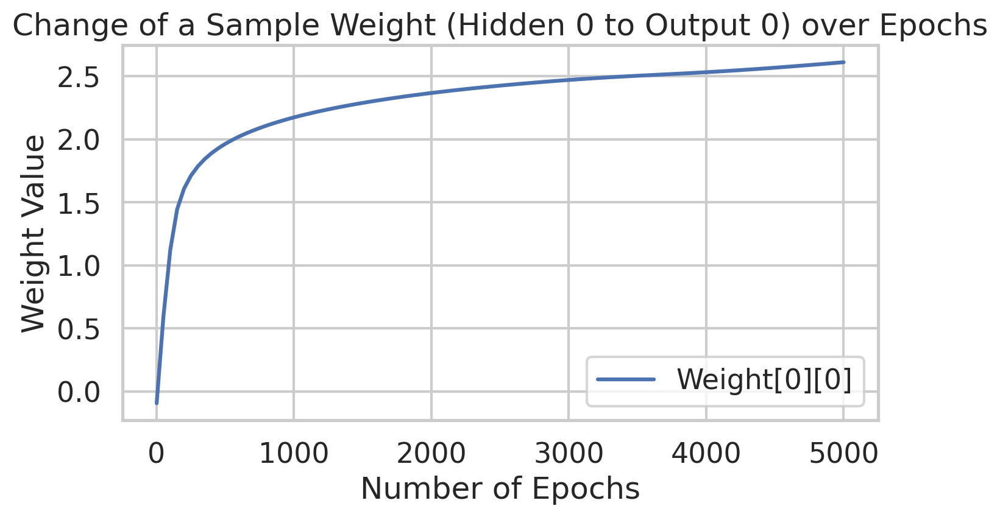

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.05
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.24859417199764267
Epoch  50 - Total Error:  0.19821534262038568
Epoch  100 - Total Error:  0.19647979569207857
Epoch  150 - Total Error:  0.19596399483768462
Epoch  200 - Total Error:  0.19571142719331475
Epoch  250 - Total Error:  0.19556134

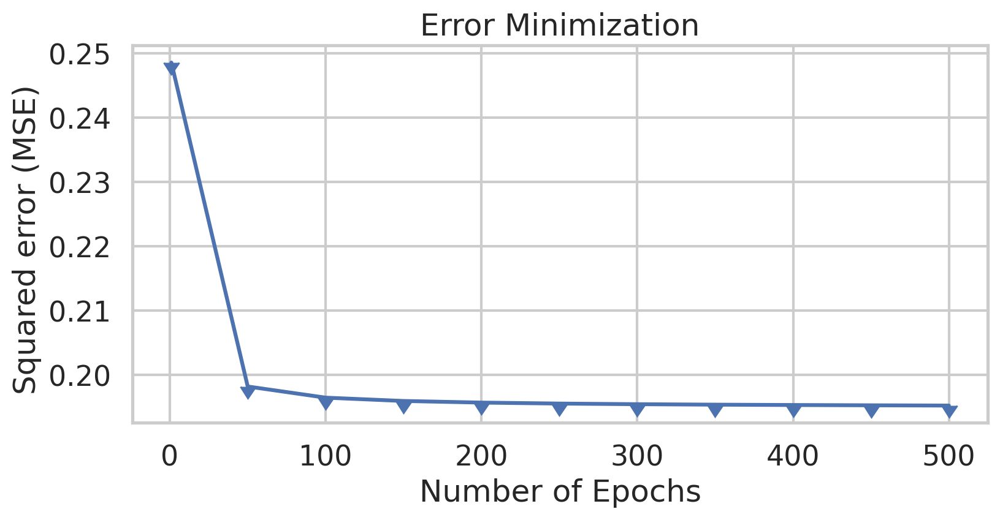

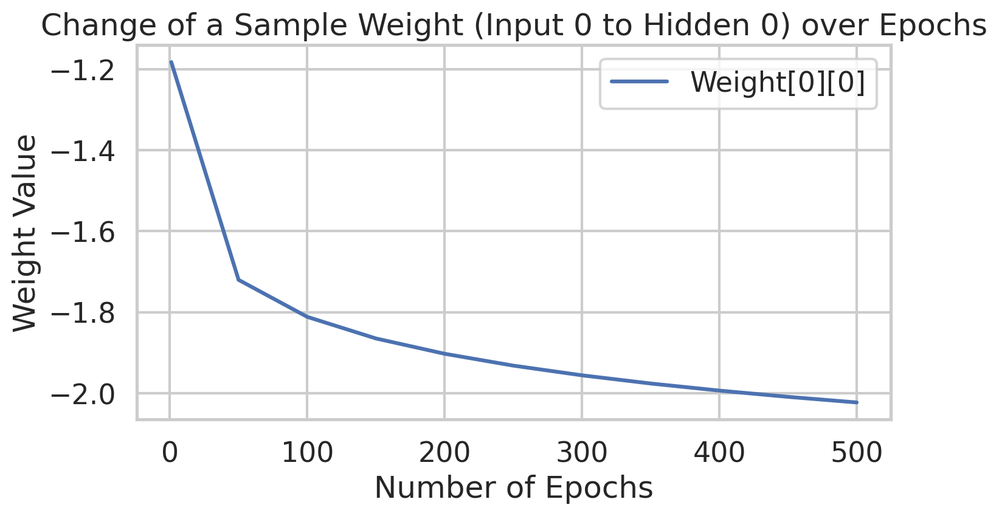

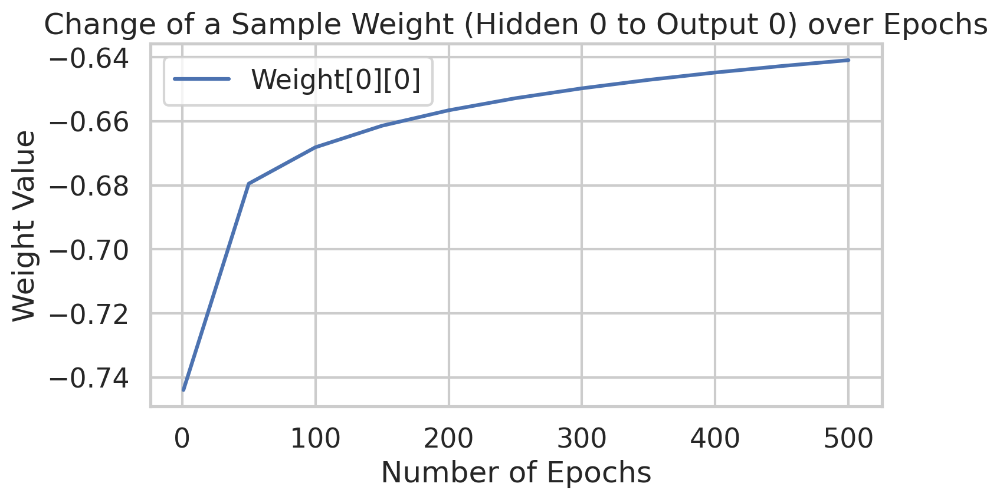

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.05
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.24468616479367233
Epoch  50 - Total Error:  0.03346004815970181
Epoch  100 - Total Error:  0.02661883758375462
Epoch  150 - Total Error:  0.025587243250927018
Epoch  200 - Total Error:  0.025161492839970667
Epoch  250 - Total Error:  0.02492

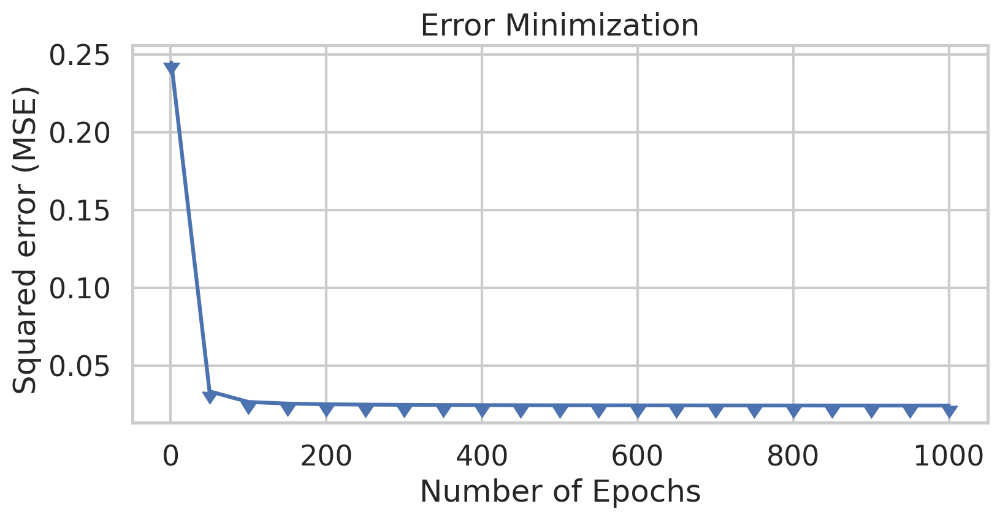

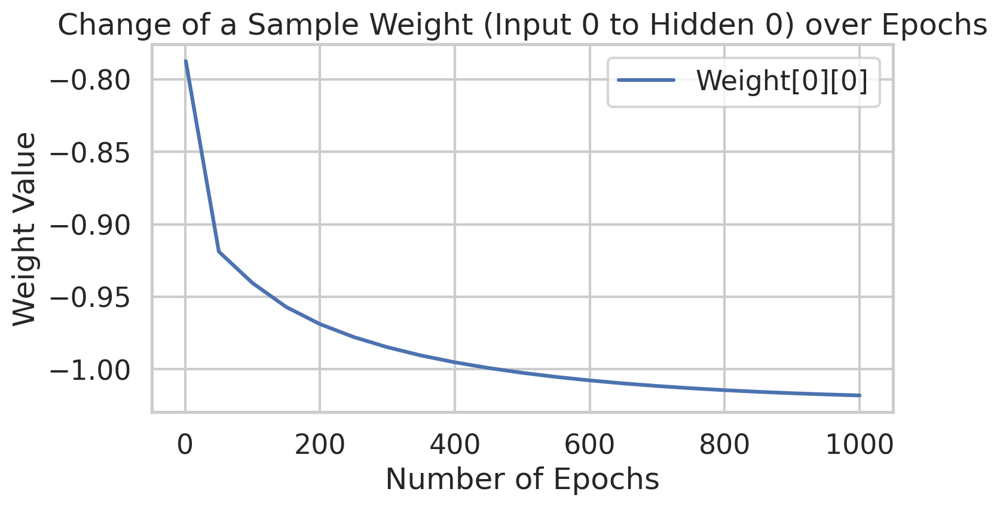

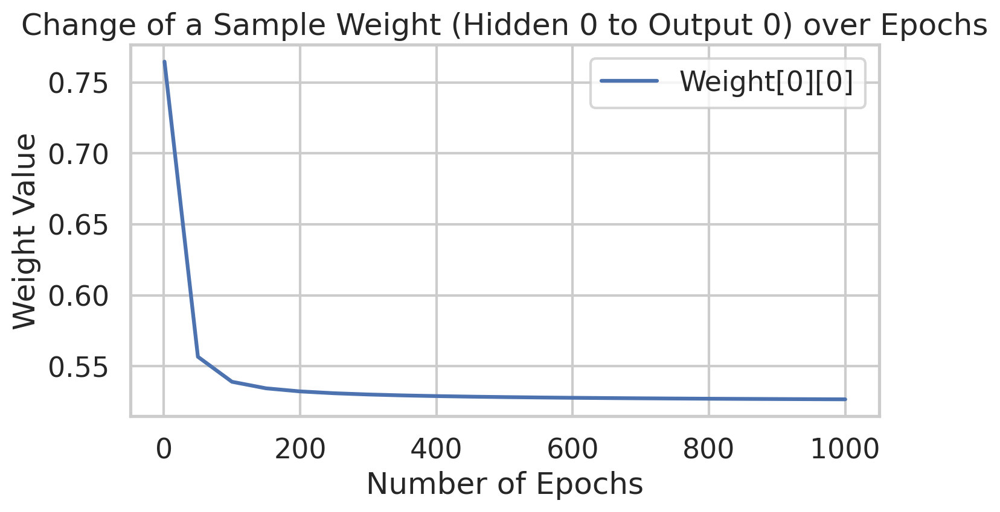

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.05
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.19668570546208136
Epoch  50 - Total Error:  0.07750968748792286
Epoch  100 - Total Error:  0.02628244484070872
Epoch  150 - Total Error:  0.018974755244016386
Epoch  200 - Total Error:  0.016207951728551055
Epoch  250 - Total Error:  0.01481

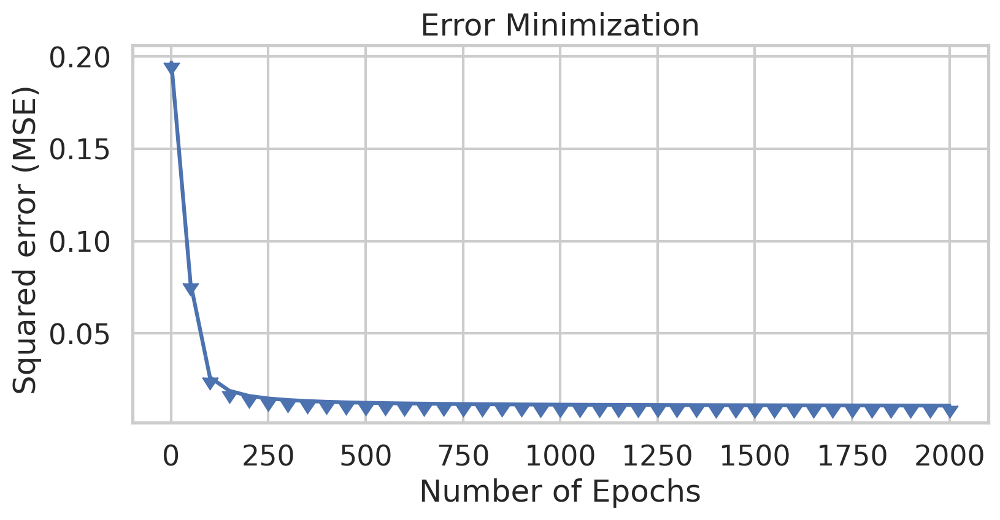

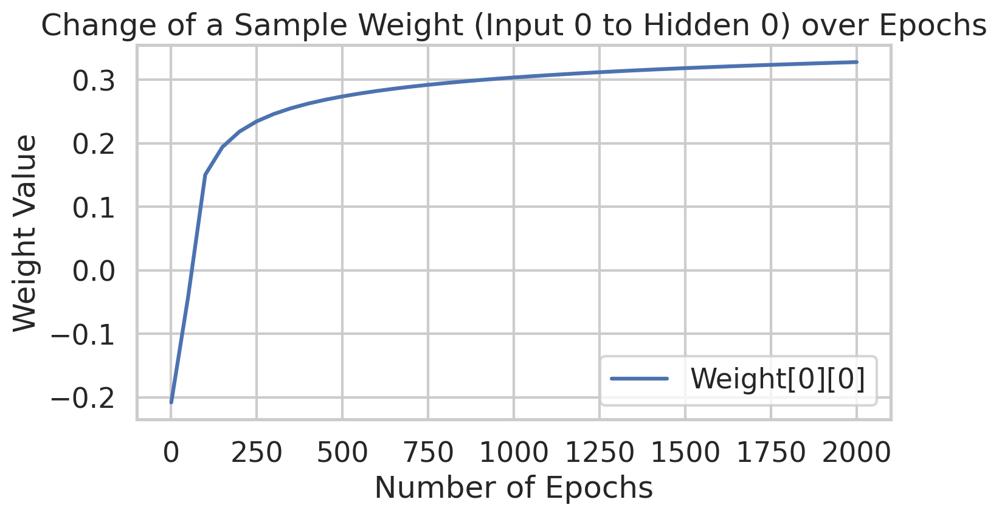

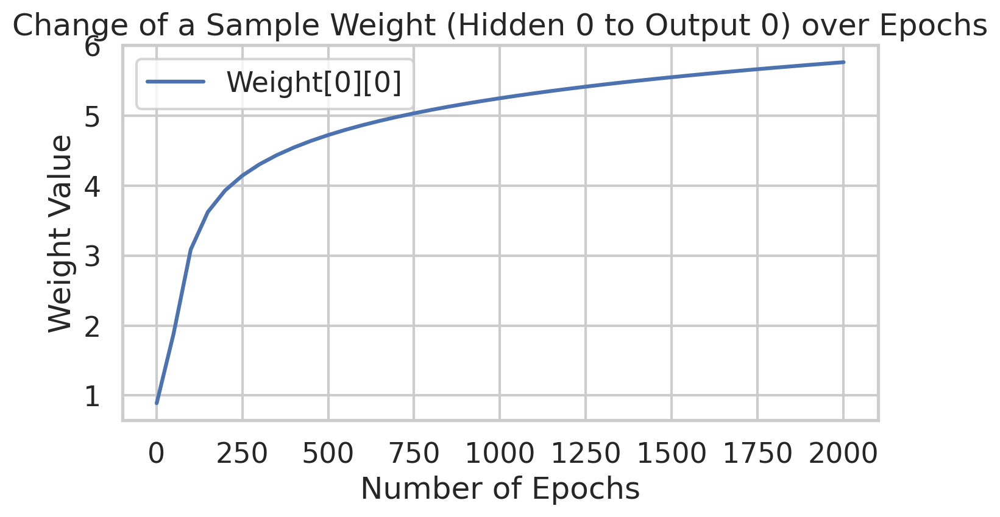

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 27.50%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 27.50% hits and 72.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.05
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.1846908349114097
Epoch  50 - Total Error:  0.036191911856300794
Epoch  100 - Total Error:  0.027723940100702404
Epoch  150 - Total Error:  0.026148852680154974
Epoch  200 - Total Error:  0.02552413896493239
Epoch  250 - Total Error:  0.025194274

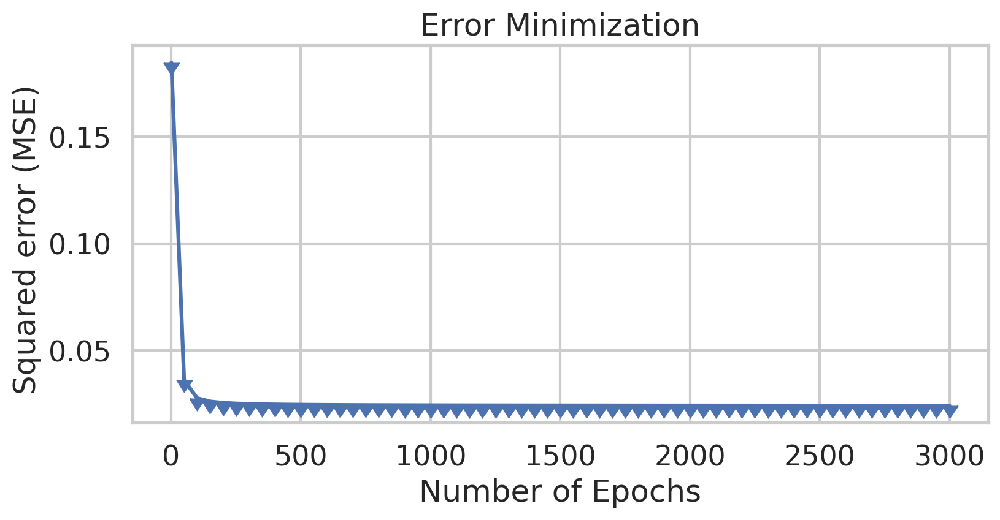

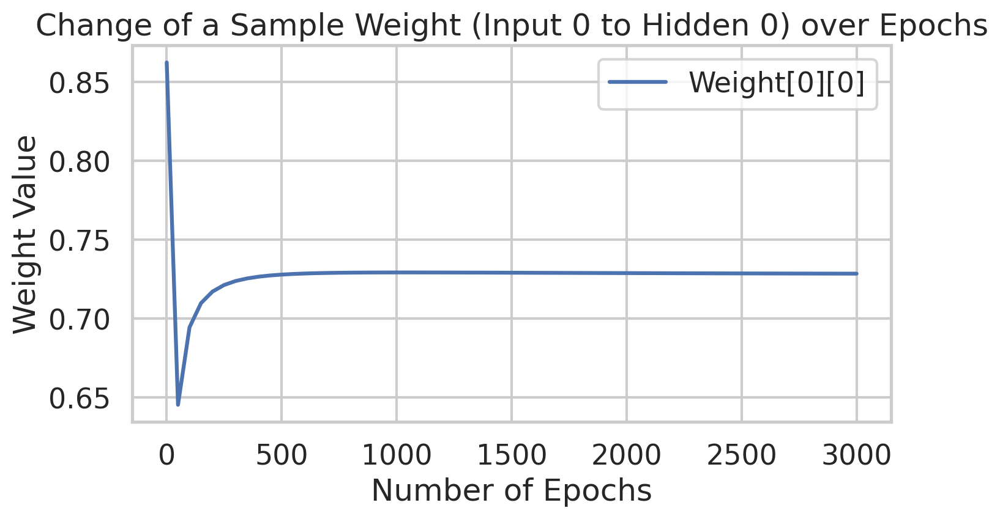

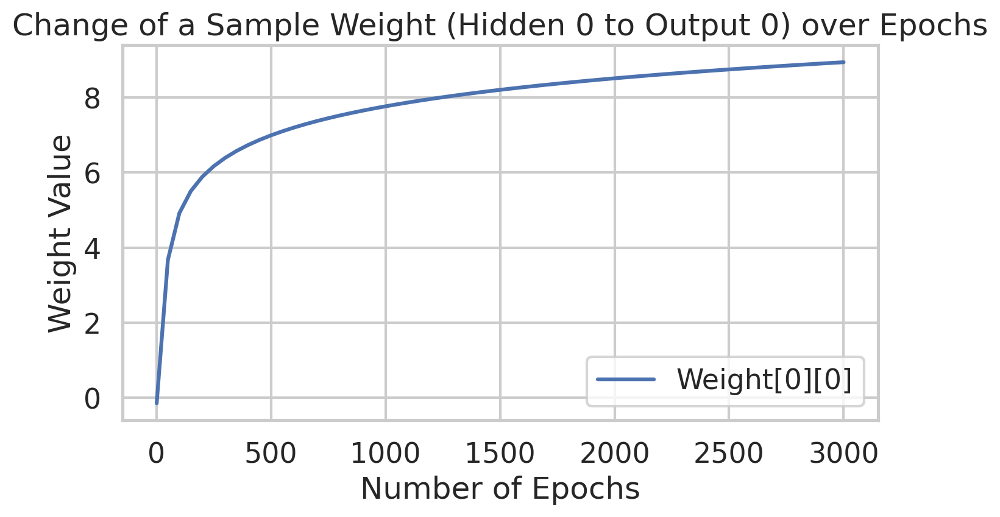

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.05
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2489400733816908
Epoch  50 - Total Error:  0.03472482458305967
Epoch  100 - Total Error:  0.027849450083304528
Epoch  150 - Total Error:  0.02630334463984039
Epoch  200 - Total Error:  0.025648940442097555
Epoch  250 - Total Error:  0.025292

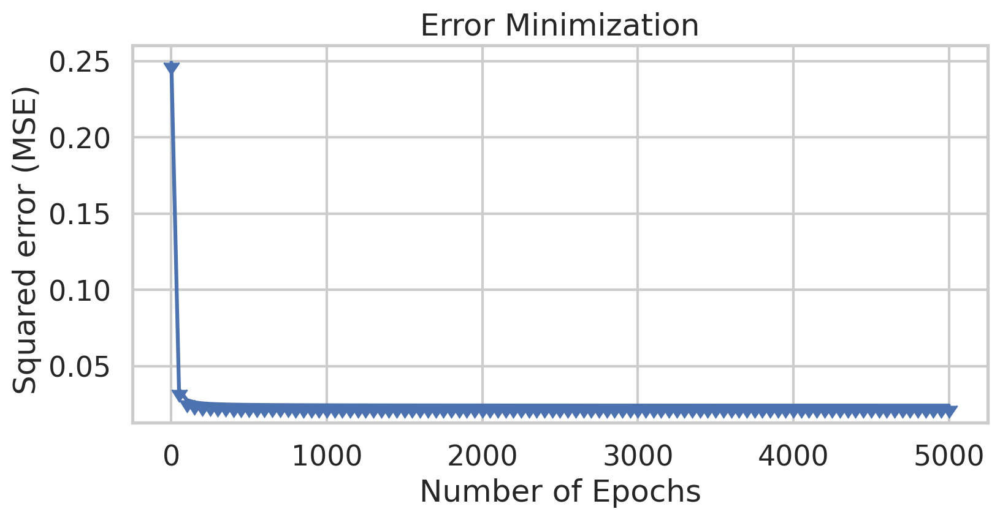

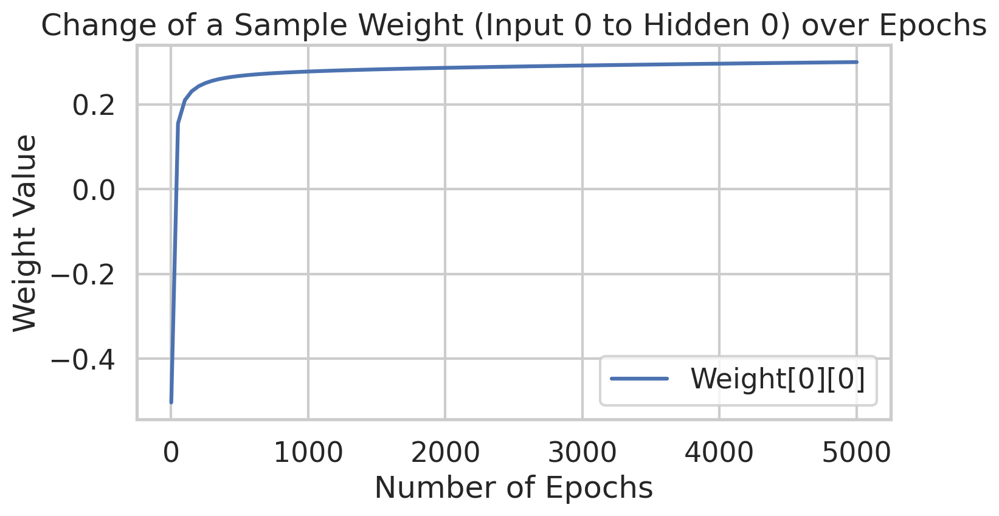

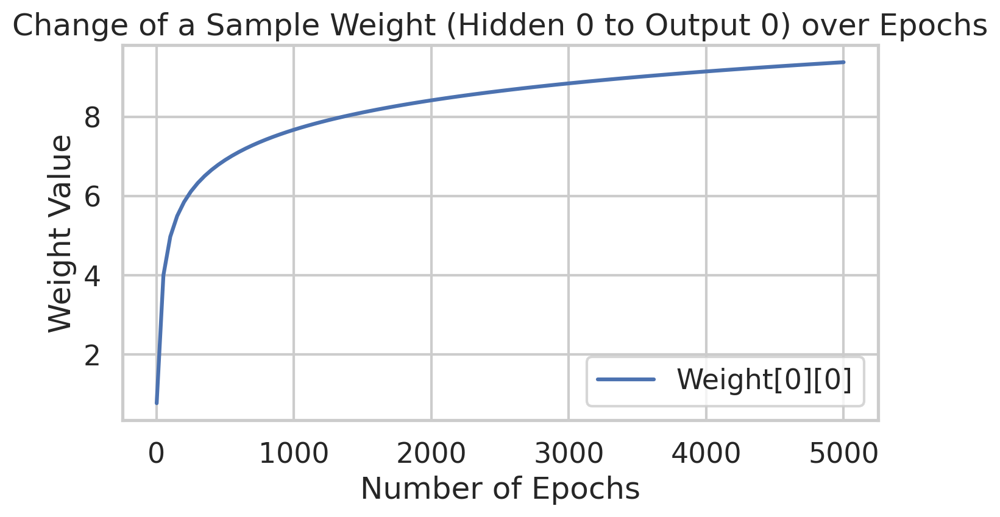

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.00%
 - Accuracy Setosa: 98.78%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 81 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.1
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.16676489477038103
Epoch  50 - Total Error:  0.02754407635239666
Epoch  100 - Total Error:  0.02557695014536098
Epoch  150 - Total Error:  0.025042356072522132
Epoch  200 - Total Error:  0.02479783612460873
Epoch  250 - Total Error:  0.024658358

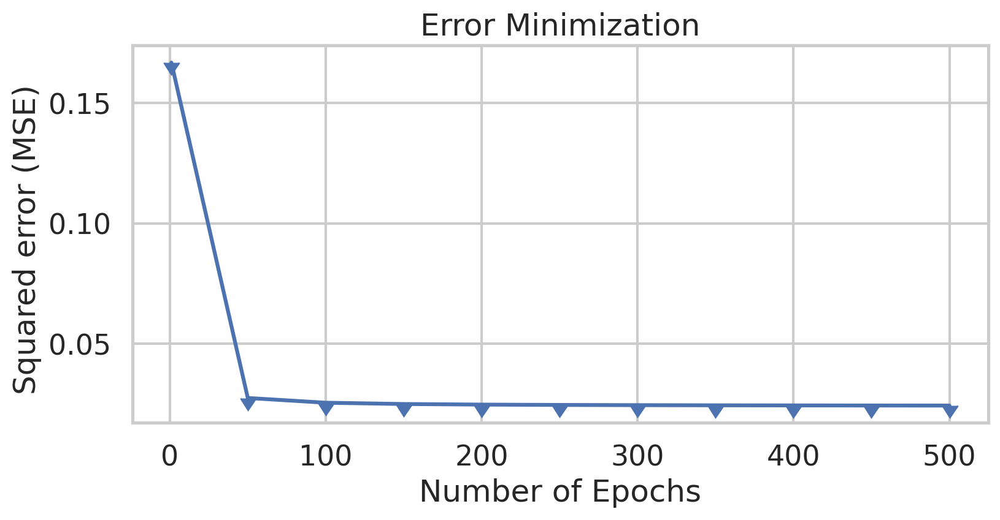

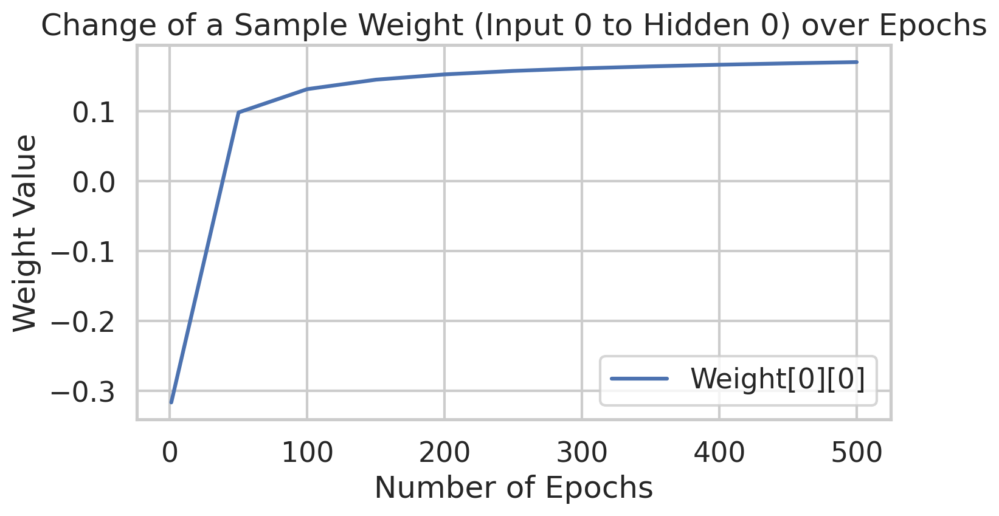

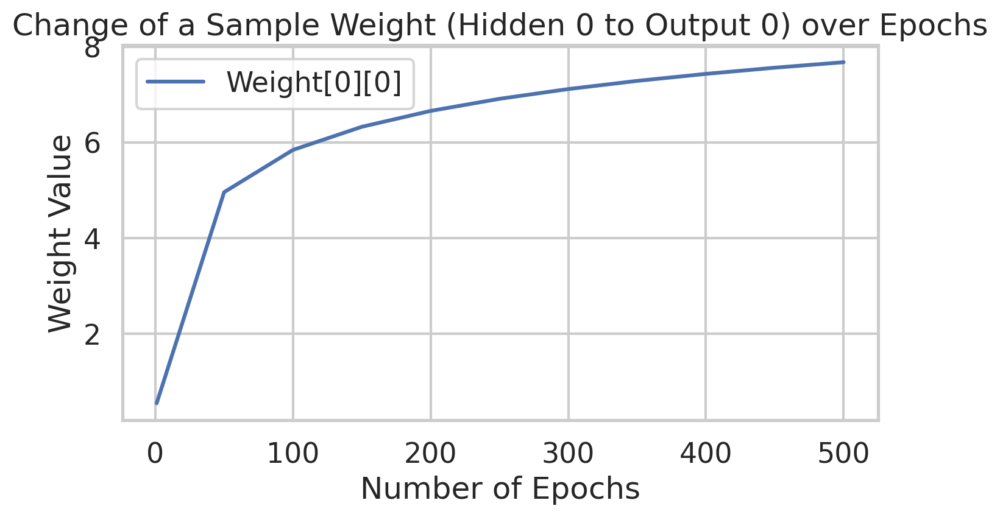

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 93.33%
 - Accuracy Setosa: 96.34%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 93.33% hits and 6.67% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 79 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.1
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.1766138392283209
Epoch  50 - Total Error:  0.08058268817176933
Epoch  100 - Total Error:  0.07983364070495455
Epoch  150 - Total Error:  0.07959592864209107
Epoch  200 - Total Error:  0.07946673069234132
Epoch  250 - Total Error:  0.0283346102

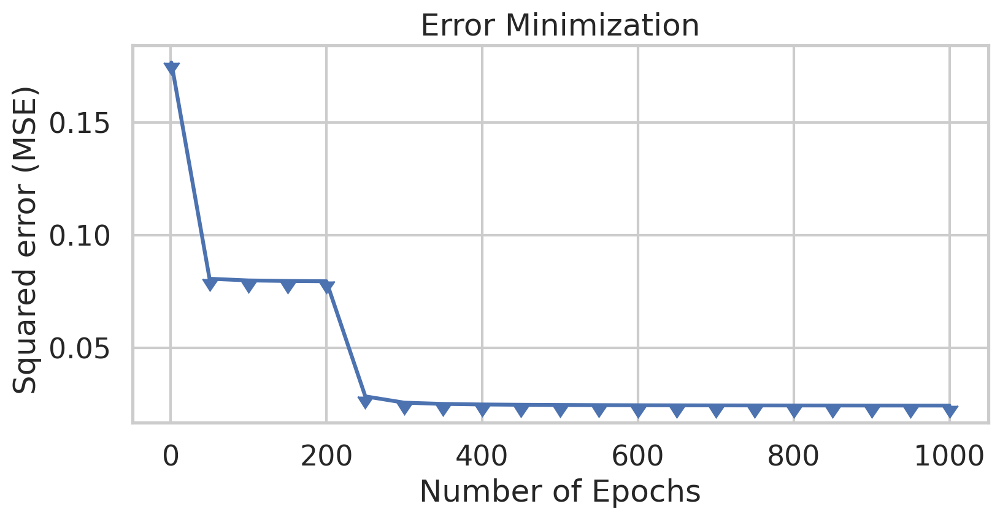

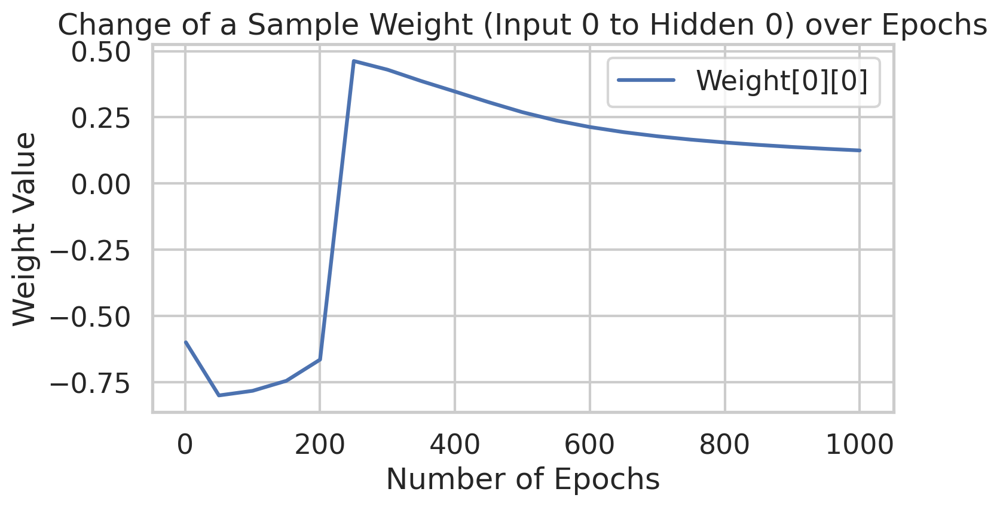

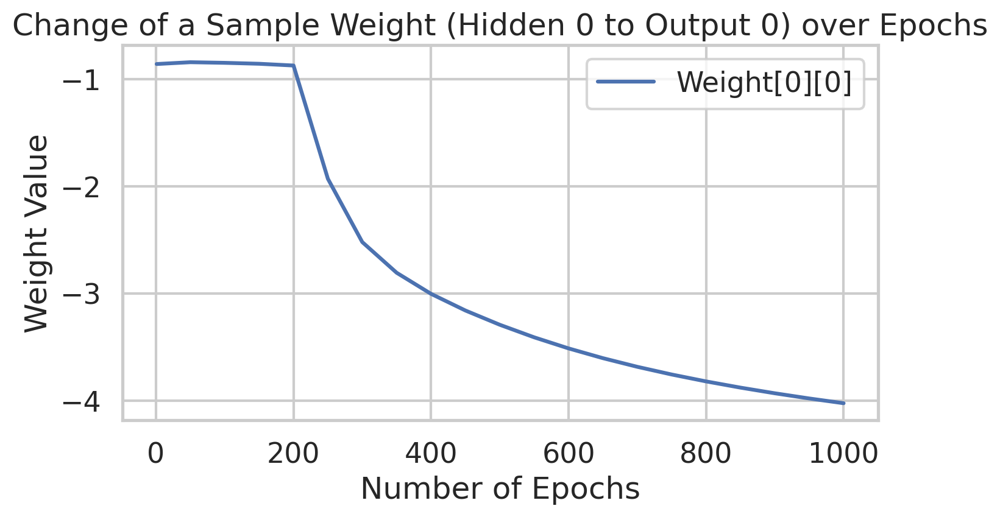

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.1
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.16331086904993822
Epoch  50 - Total Error:  0.026138845222133316
Epoch  100 - Total Error:  0.024982676507435853
Epoch  150 - Total Error:  0.024681247159962415
Epoch  200 - Total Error:  0.024543048461647485
Epoch  250 - Total Error:  0.0244

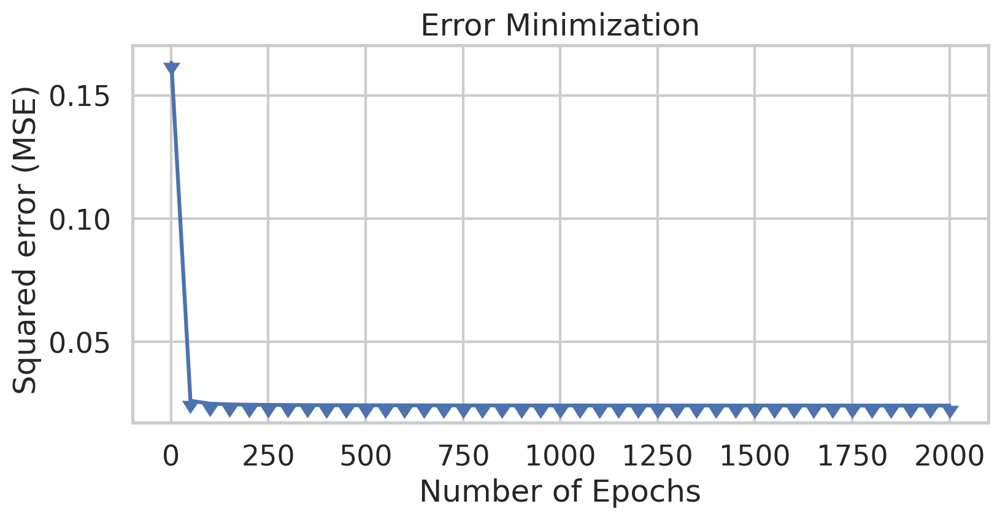

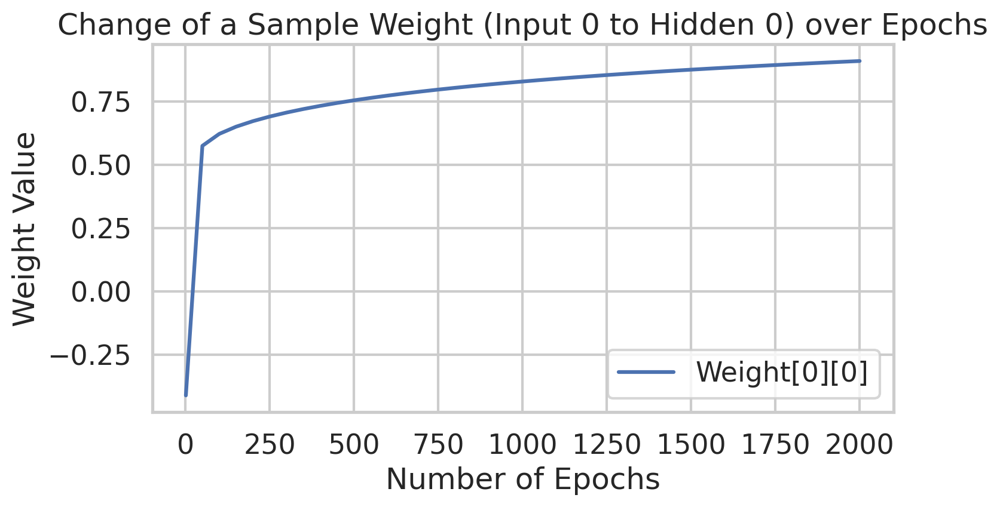

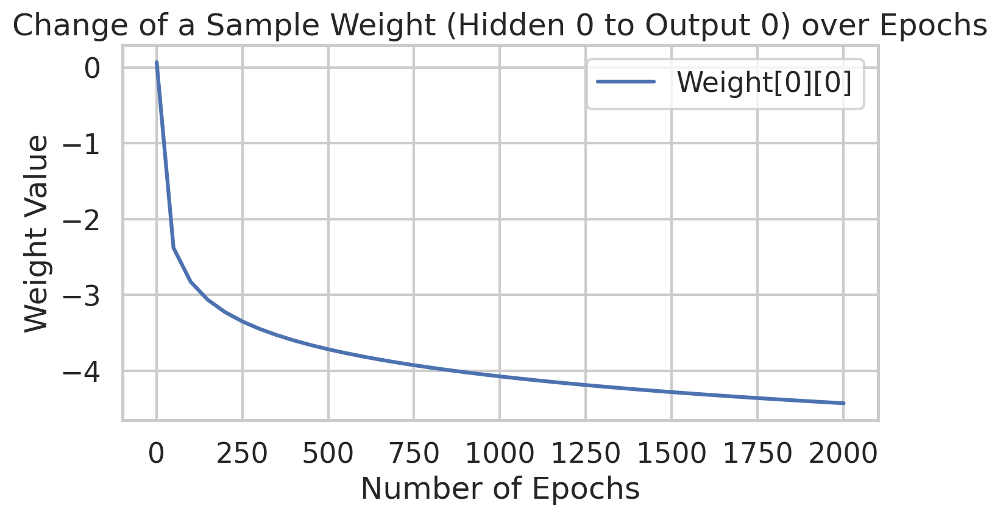

Overall accuracy: 76.67%
 - Accuracy Setosa: 70.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 76.67% hits and 23.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 14 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 71.67%
 - Accuracy Setosa: 64.63%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 71.67% hits and 28.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 53 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.1
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.24621301002264356
Epoch  50 - Total Error:  0.2500819346809407
Epoch  100 - Total Error:  0.2500426332980962
Epoch  150 - Total Error:  0.25002883790552416
Epoch  200 - Total Error:  0.2500217827796147
Epoch  250 - Total Error:  0.25001749551

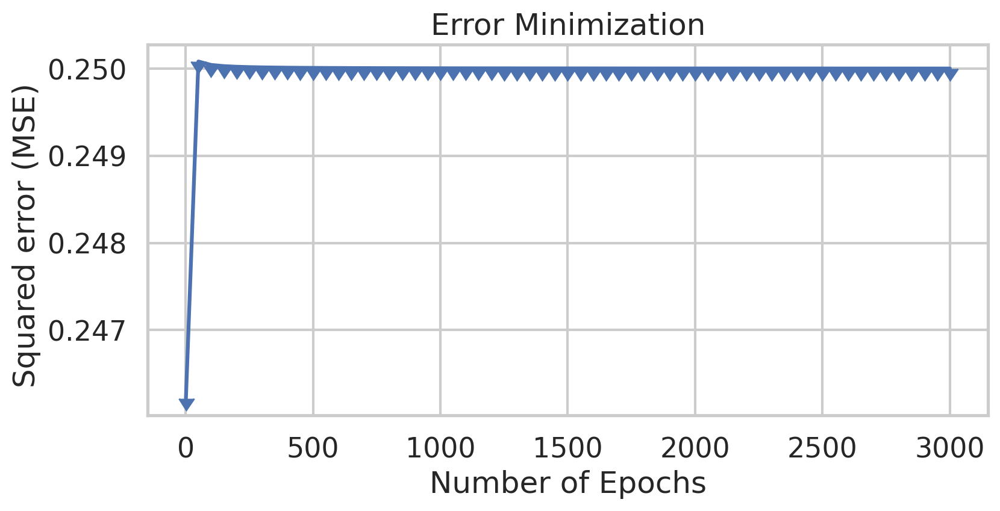

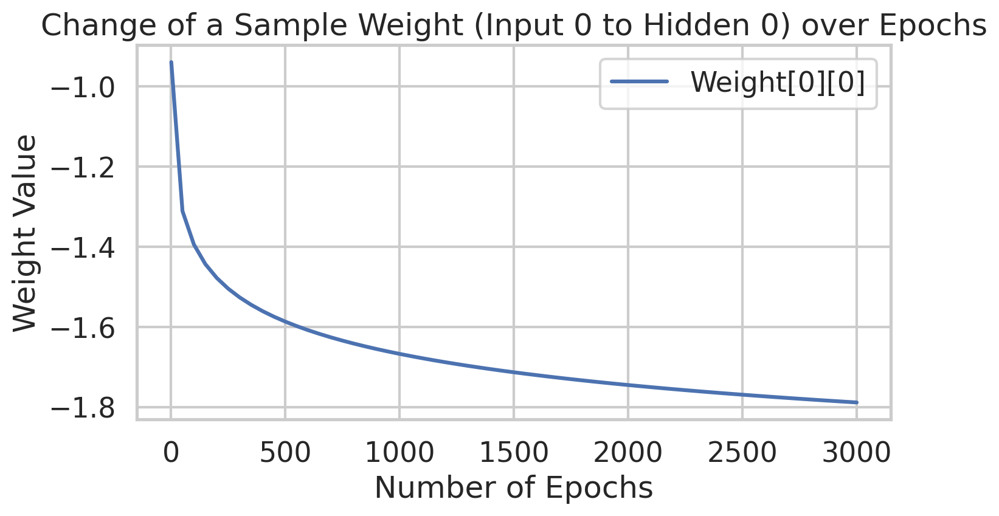

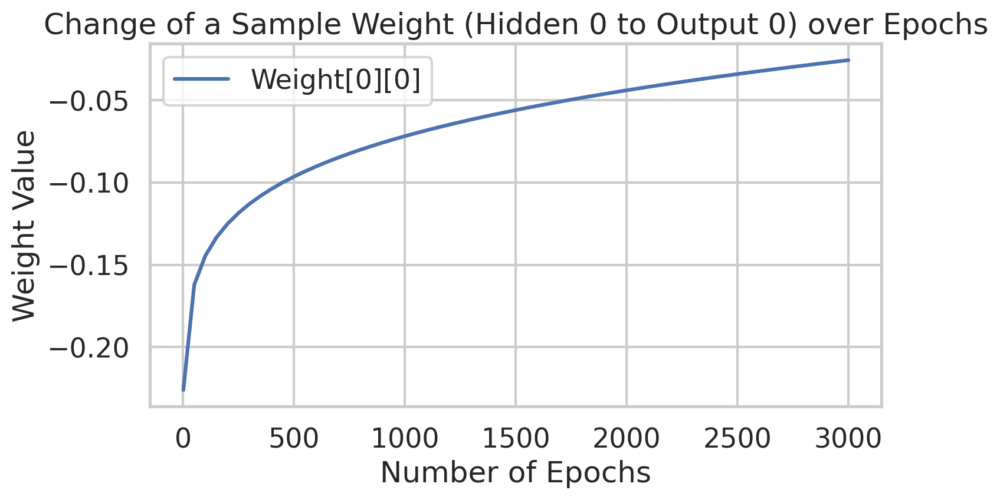

Overall accuracy: 66.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 0.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 66.67% hits and 33.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 0 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 68.33%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 0.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 68.33% hits and 31.67% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 0 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 3
 - Learning Rate: 0.1
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.16192477327584173
Epoch  50 - Total Error:  0.02631645009294031
Epoch  100 - Total Error:  0.017070235565430688
Epoch  150 - Total Error:  0.014623239837267776
Epoch  200 - Total Error:  0.013518955907420672
Epoch  250 - Total Error:  0.01288190

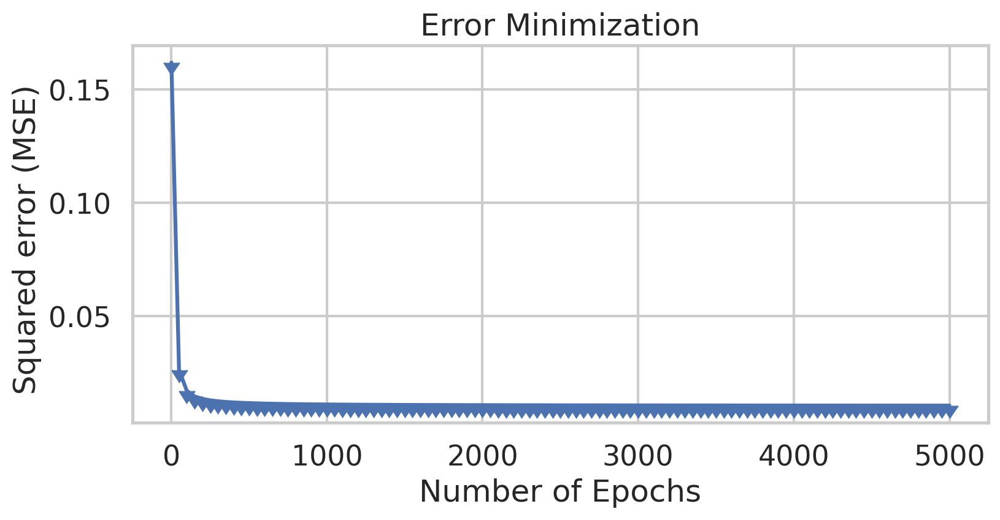

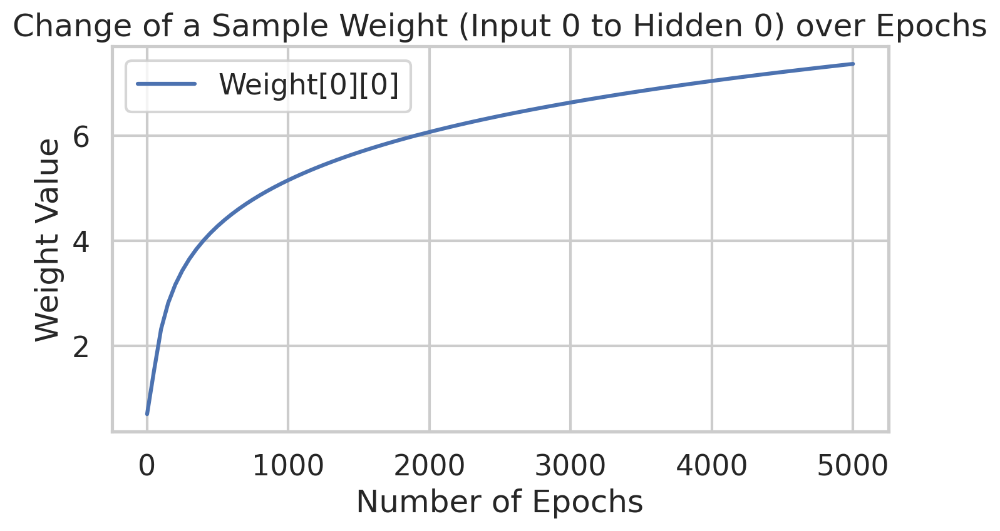

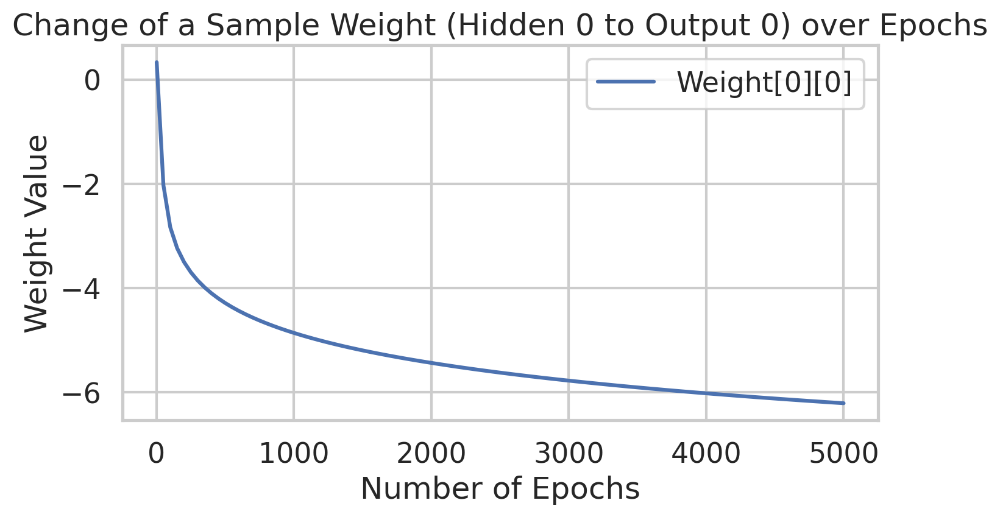

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 27.50%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 27.50% hits and 72.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.001
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3491745865902389
Epoch  50 - Total Error:  0.2477129985962142
Epoch  100 - Total Error:  0.22733135604530527
Epoch  150 - Total Error:  0.1754412208795311
Epoch  200 - Total Error:  0.13572970980929133
Epoch  250 - Total Error:  0.11085746065252

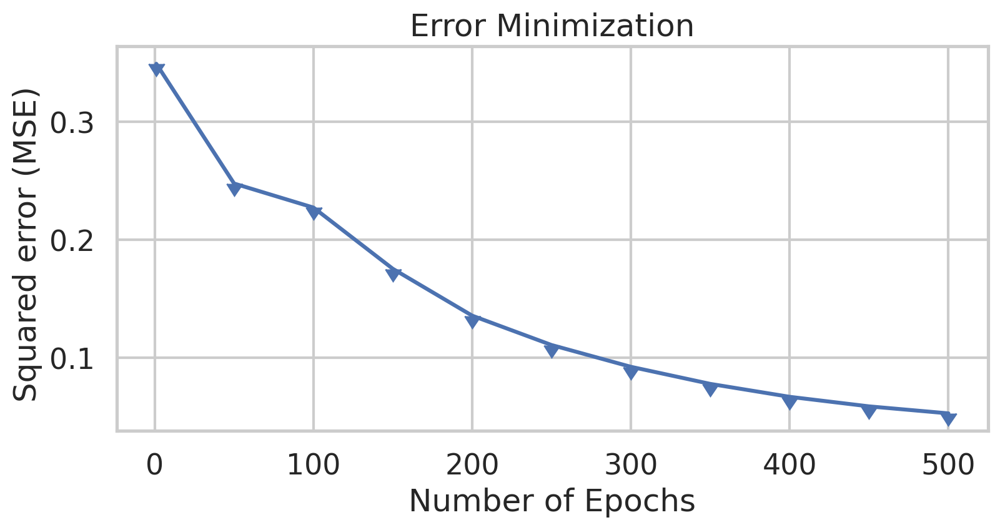

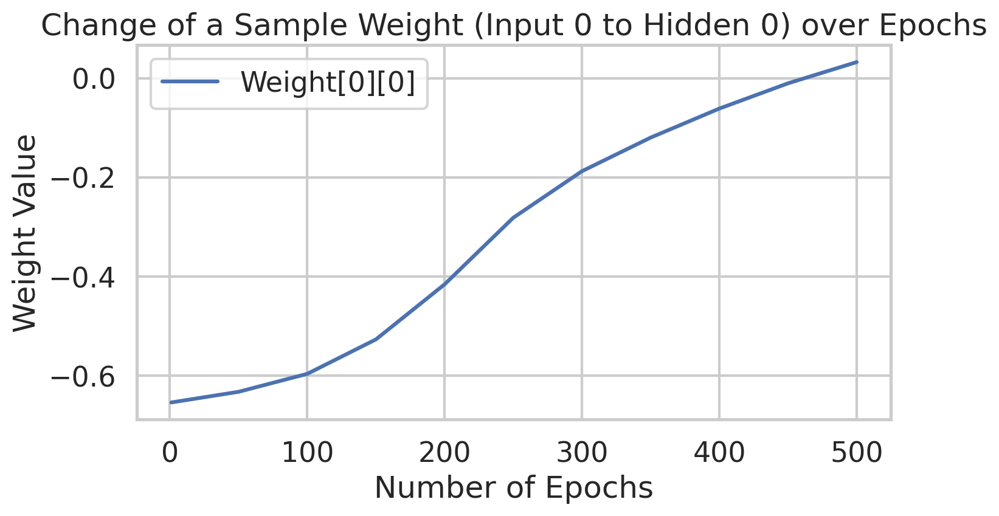

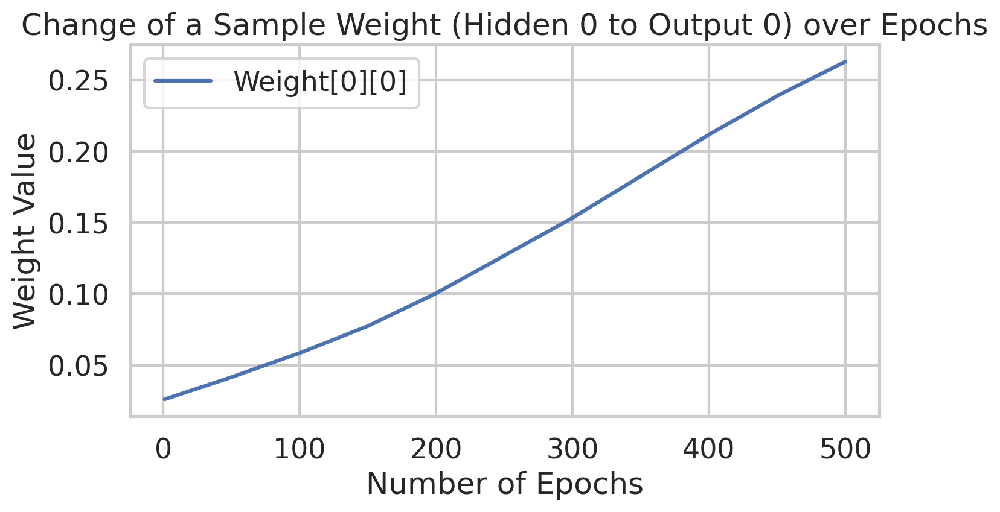

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 96.97%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 32 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.001
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.25473130579958414
Epoch  50 - Total Error:  0.14404675193490252
Epoch  100 - Total Error:  0.12097319074436905
Epoch  150 - Total Error:  0.10757453070438713
Epoch  200 - Total Error:  0.09704443163663717
Epoch  250 - Total Error:  0.0879206

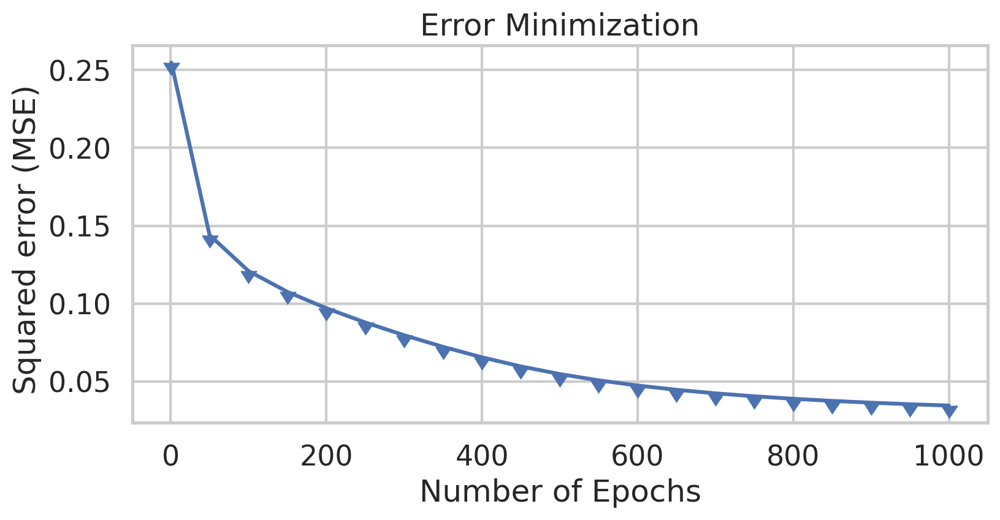

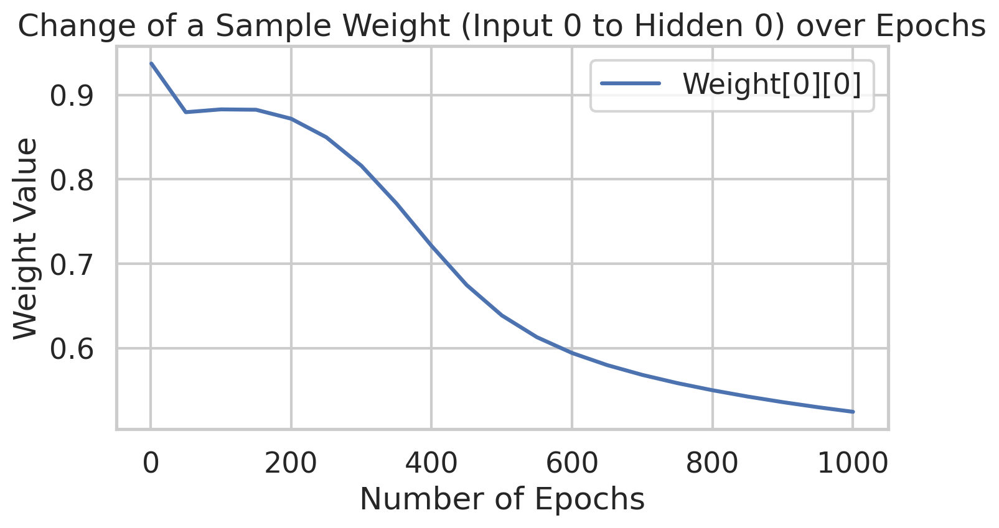

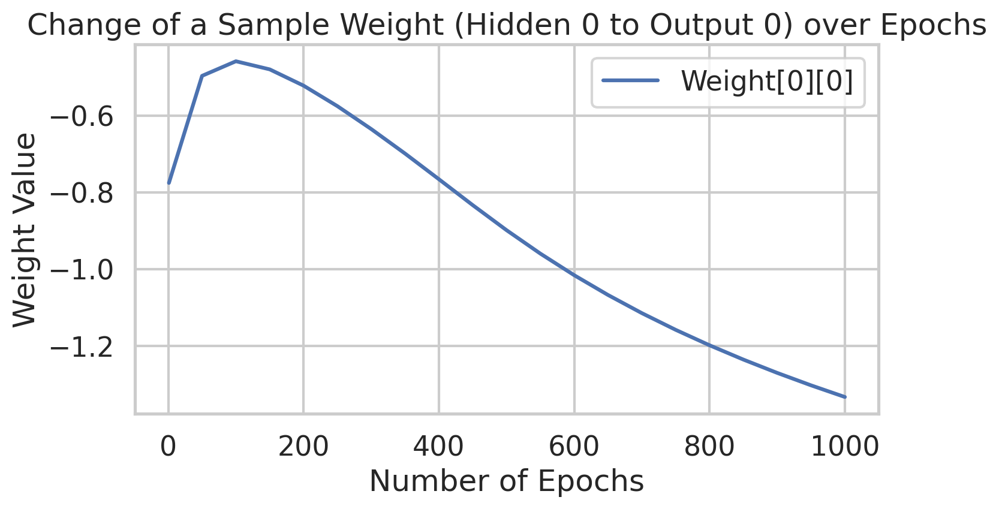

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.00%
 - Accuracy Setosa: 98.78%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 81 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.001
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.28231147212214125
Epoch  50 - Total Error:  0.16193473668360053
Epoch  100 - Total Error:  0.13015644682320668
Epoch  150 - Total Error:  0.11296724482200632
Epoch  200 - Total Error:  0.10015865800201727
Epoch  250 - Total Error:  0.0895797

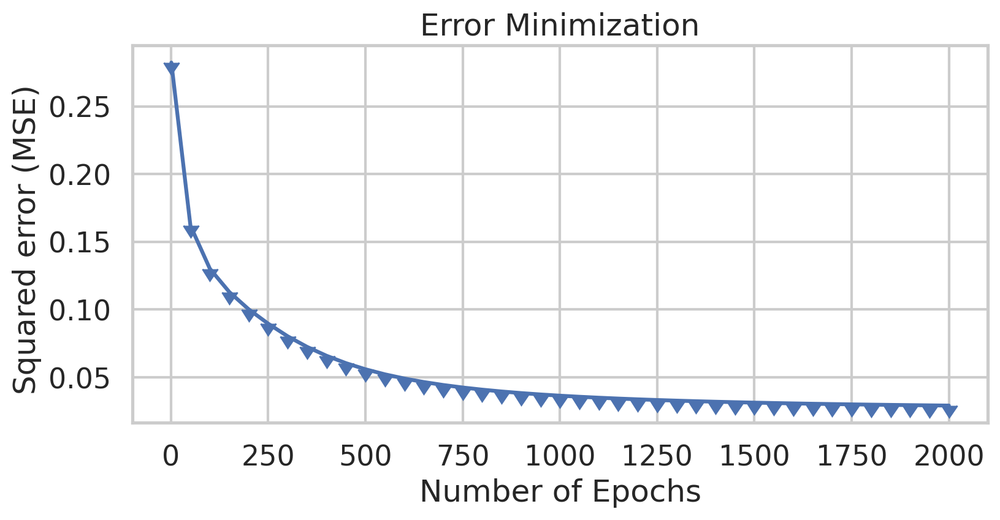

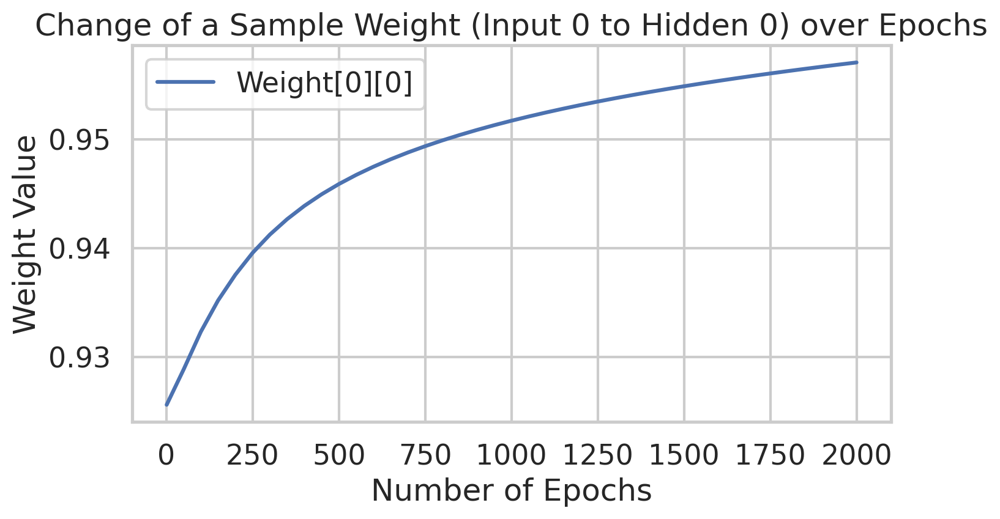

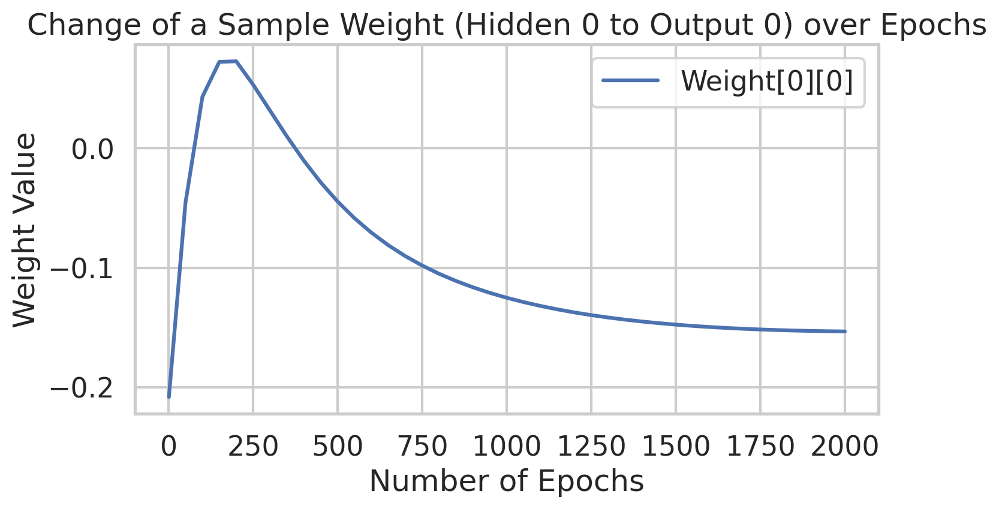

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.001
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2777646882249286
Epoch  50 - Total Error:  0.16973633036351055
Epoch  100 - Total Error:  0.1387527620035486
Epoch  150 - Total Error:  0.1223072533766721
Epoch  200 - Total Error:  0.11044062794376366
Epoch  250 - Total Error:  0.100452517

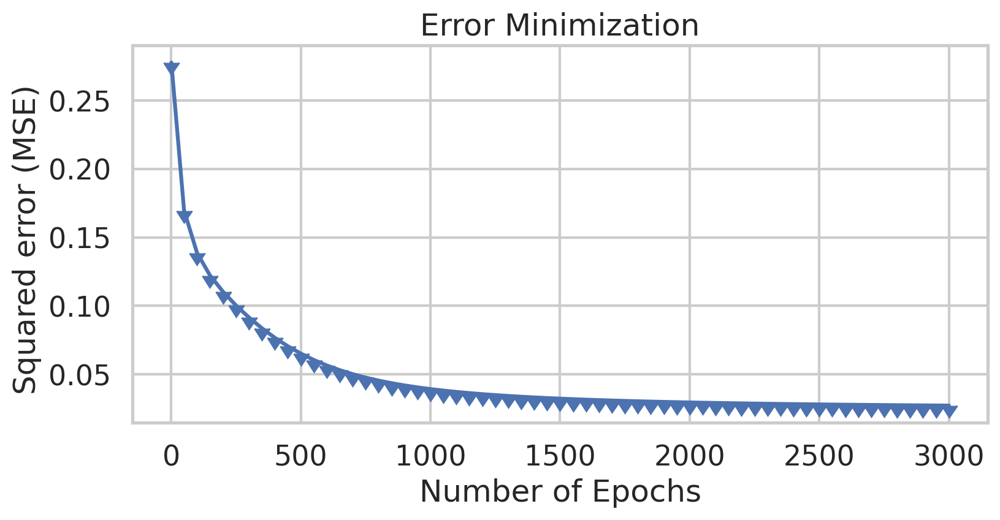

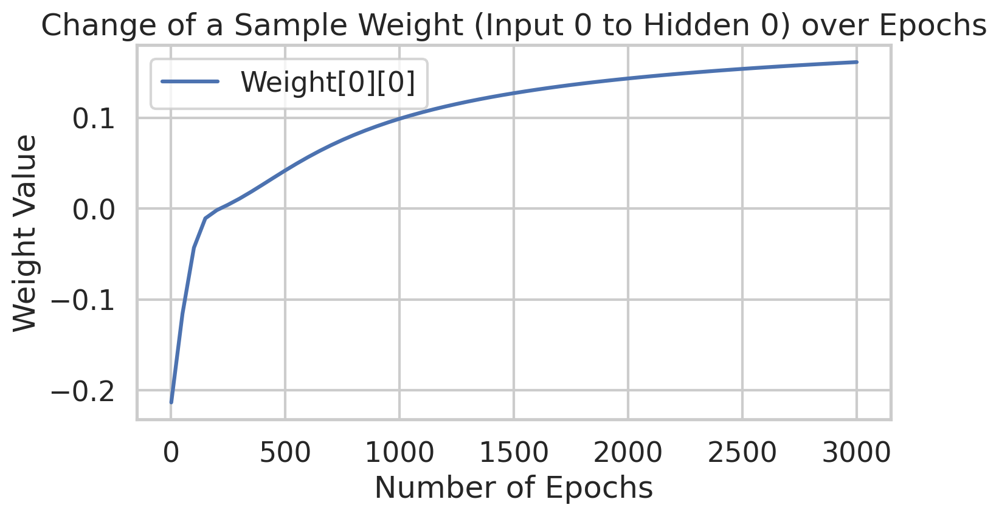

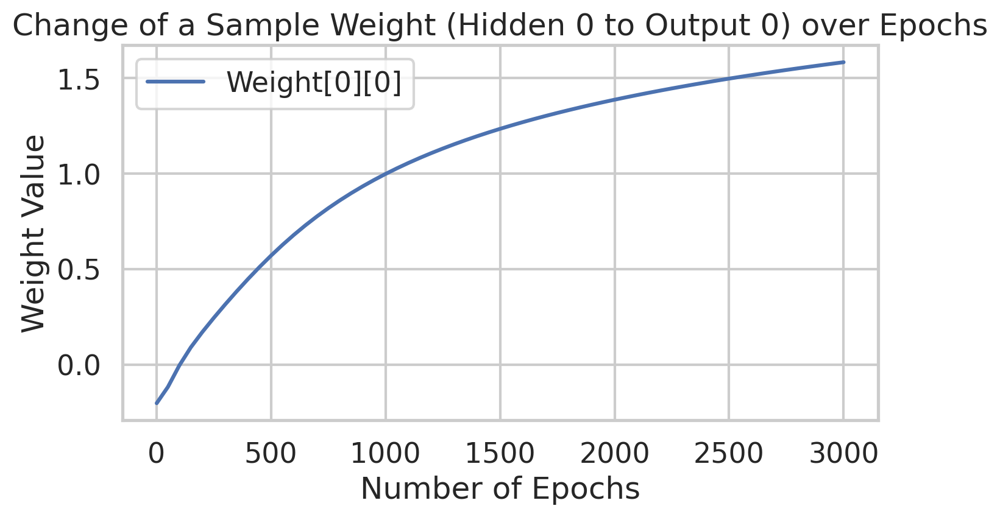

Overall accuracy: 83.33%
 - Accuracy Setosa: 80.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 83.33% hits and 16.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 16 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 72.50%
 - Accuracy Setosa: 65.85%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 72.50% hits and 27.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 54 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.001
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2775963944883408
Epoch  50 - Total Error:  0.18868814878991538
Epoch  100 - Total Error:  0.1579159848926051
Epoch  150 - Total Error:  0.1267798841137873
Epoch  200 - Total Error:  0.10602034881241634
Epoch  250 - Total Error:  0.091054234

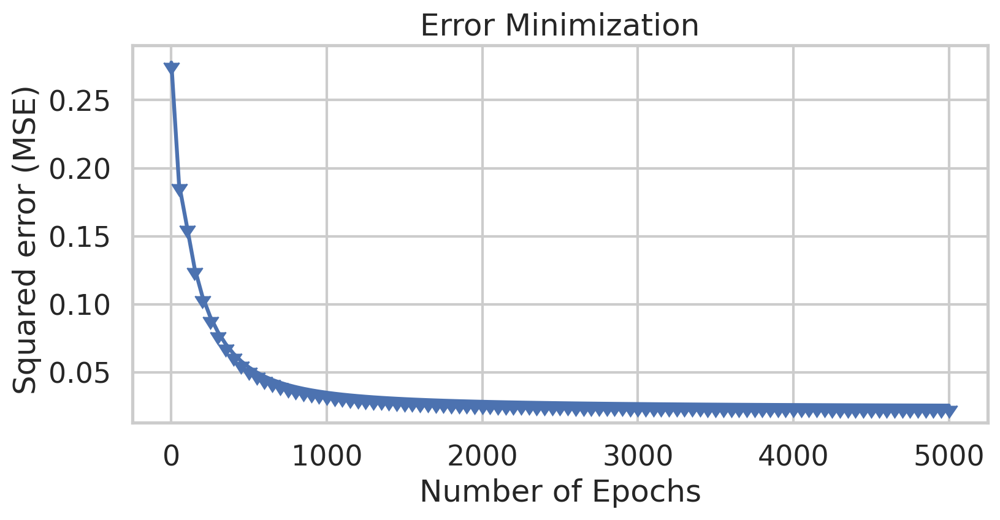

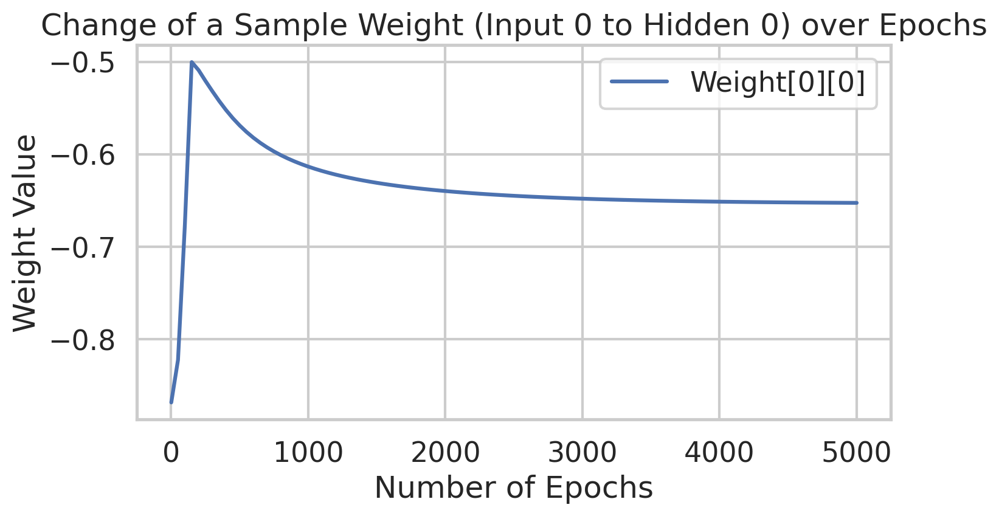

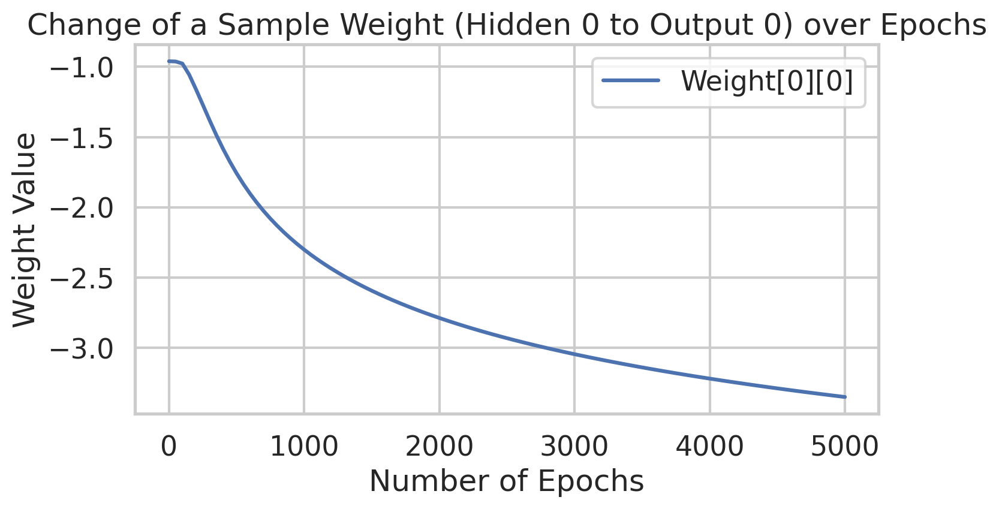

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.005
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.32177788073815966
Epoch  50 - Total Error:  0.06673009705394521
Epoch  100 - Total Error:  0.045272214199155475
Epoch  150 - Total Error:  0.03710752245391091
Epoch  200 - Total Error:  0.033170498222738876
Epoch  250 - Total Error:  0.03095

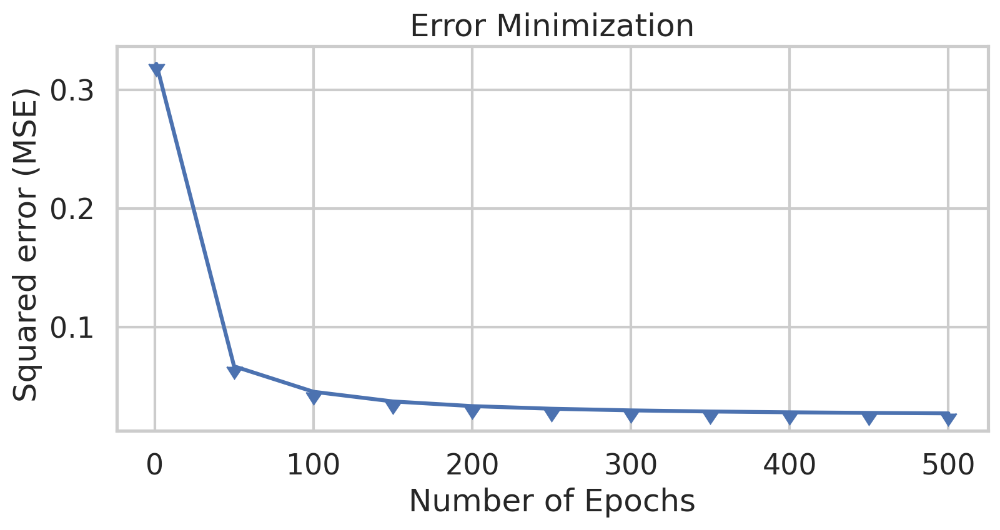

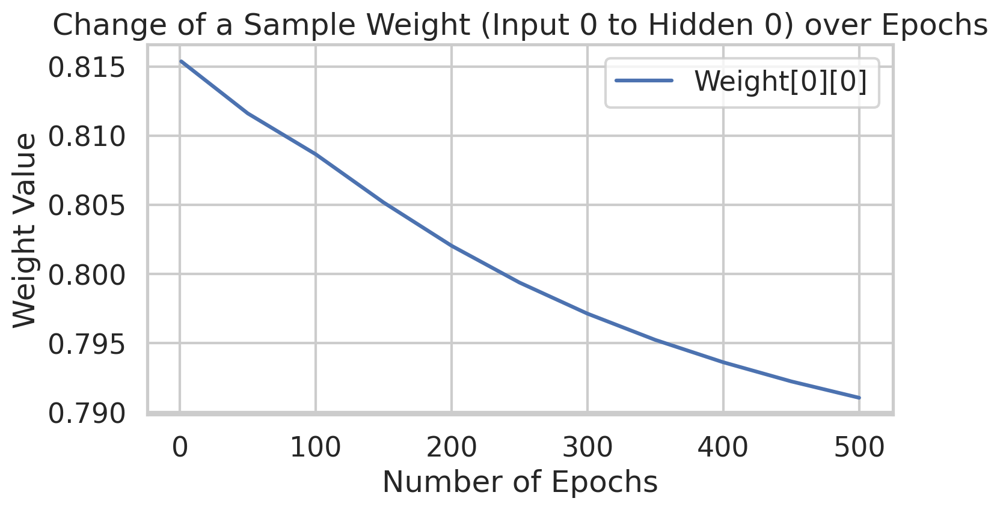

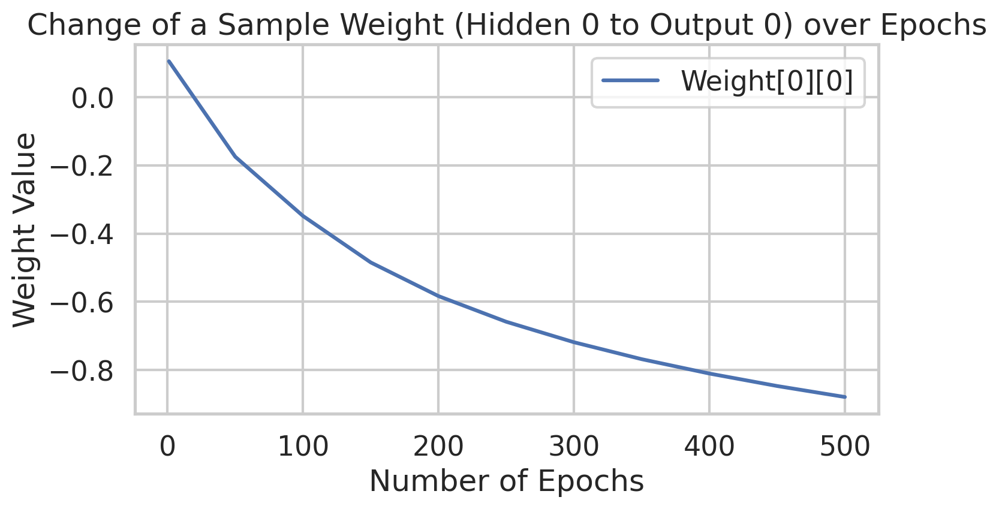

Overall accuracy: 86.67%
 - Accuracy Setosa: 85.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 86.67% hits and 13.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 17 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 89.17%
 - Accuracy Setosa: 90.24%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 89.17% hits and 10.83% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 74 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.005
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.23844003723460286
Epoch  50 - Total Error:  0.11745259074748064
Epoch  100 - Total Error:  0.07570833935884076
Epoch  150 - Total Error:  0.05523067678927802
Epoch  200 - Total Error:  0.04520443349836024
Epoch  250 - Total Error:  0.039713

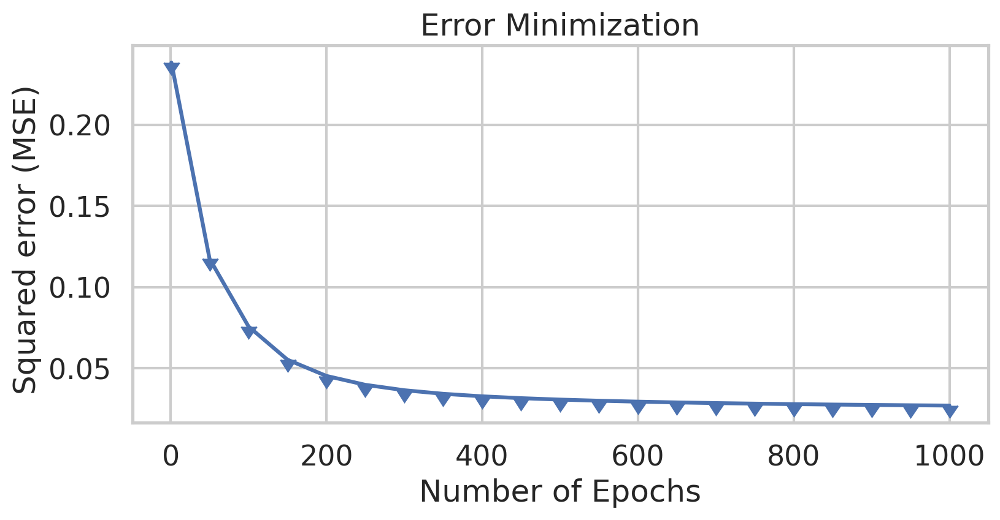

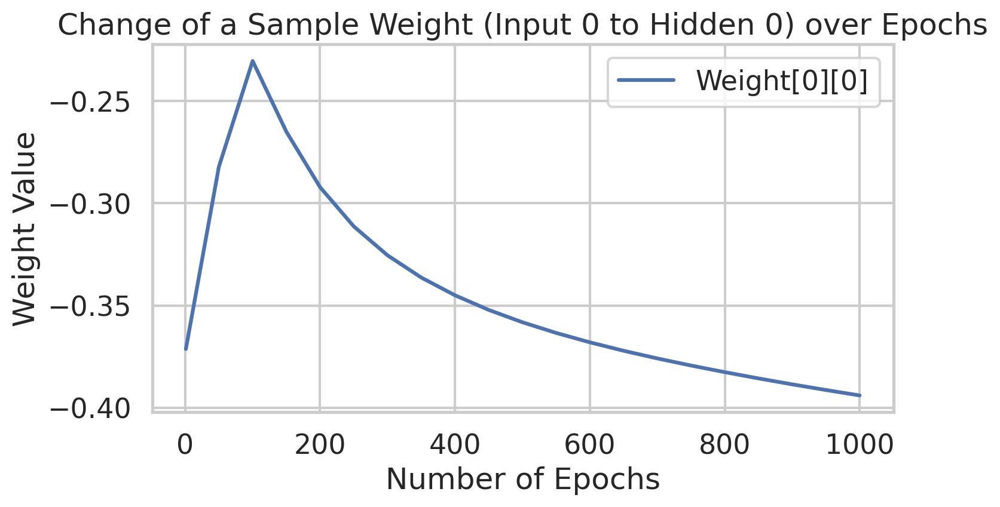

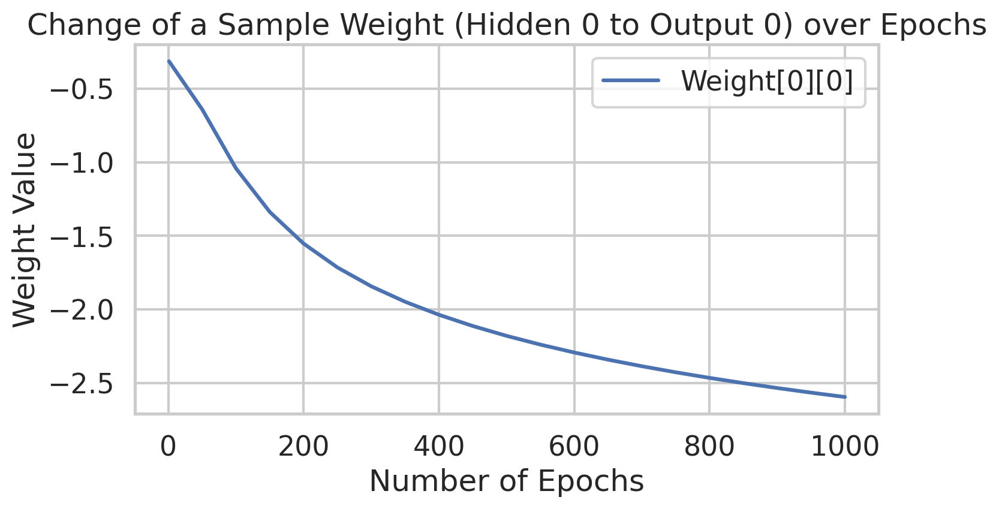

Overall accuracy: 73.33%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 22.22%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 73.33% hits and 26.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 2 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 79.17%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 39.39%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 79.17% hits and 20.83% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 13 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.005
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.46328875561175686
Epoch  50 - Total Error:  0.11977455692574081
Epoch  100 - Total Error:  0.07491966579417282
Epoch  150 - Total Error:  0.05021183654385518
Epoch  200 - Total Error:  0.03963194495938412
Epoch  250 - Total Error:  0.034576

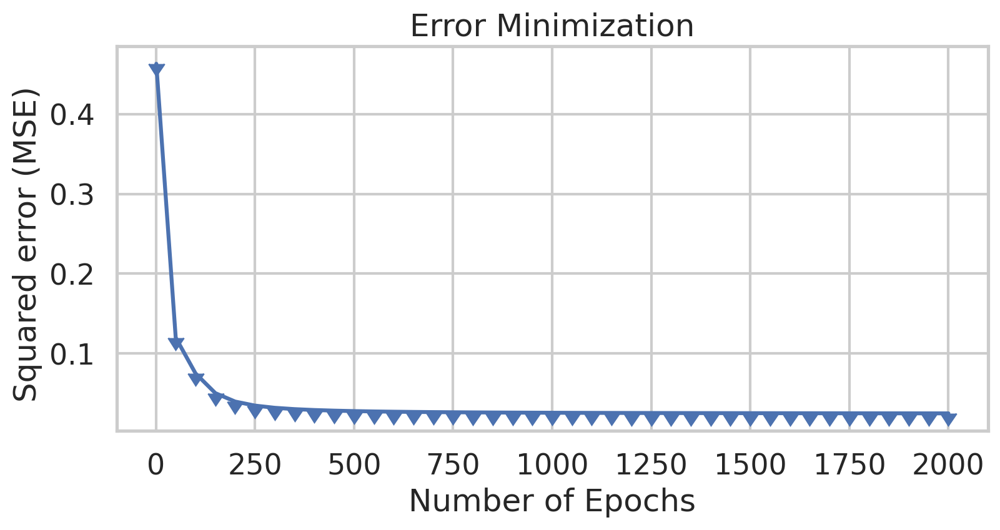

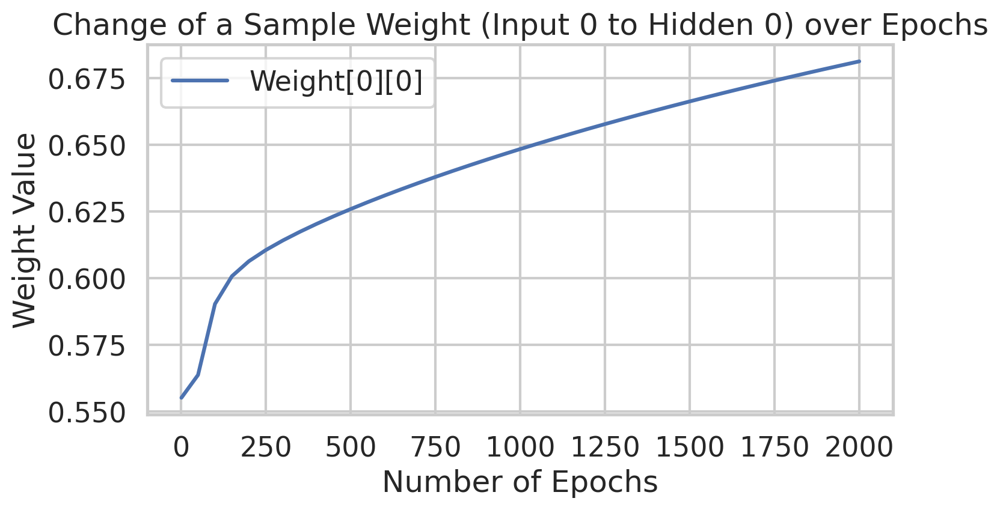

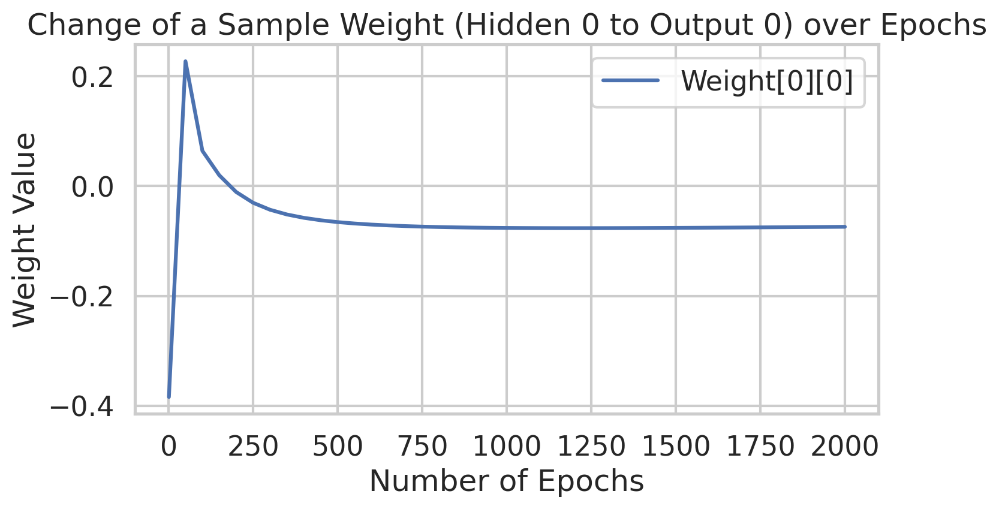

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.005
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3353085075399893
Epoch  50 - Total Error:  0.15517228092945956
Epoch  100 - Total Error:  0.1531220994301855
Epoch  150 - Total Error:  0.1522931030529742
Epoch  200 - Total Error:  0.1429300999550228
Epoch  250 - Total Error:  0.1088911873

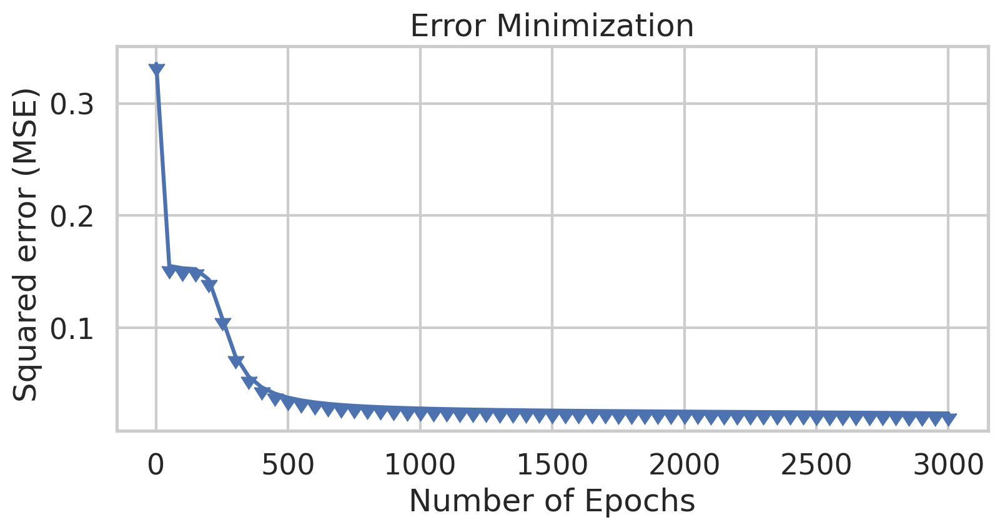

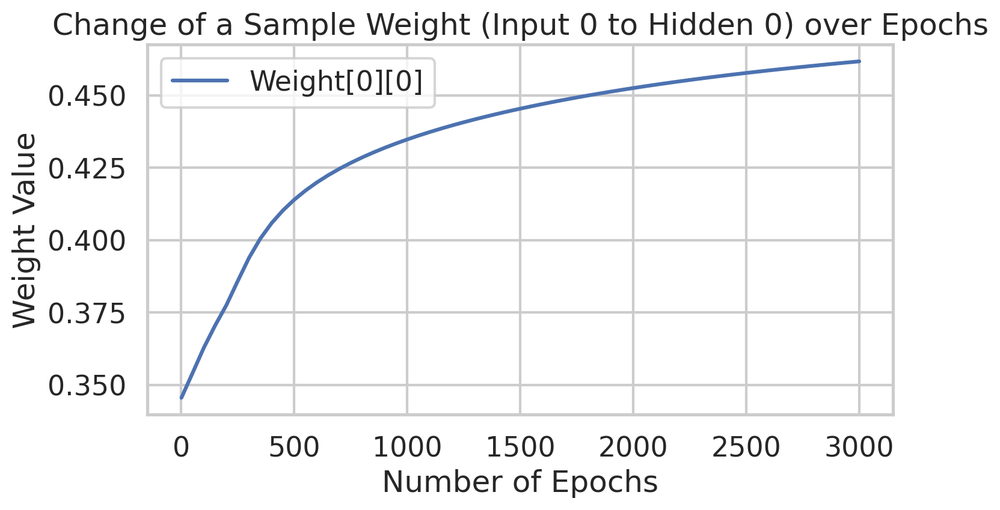

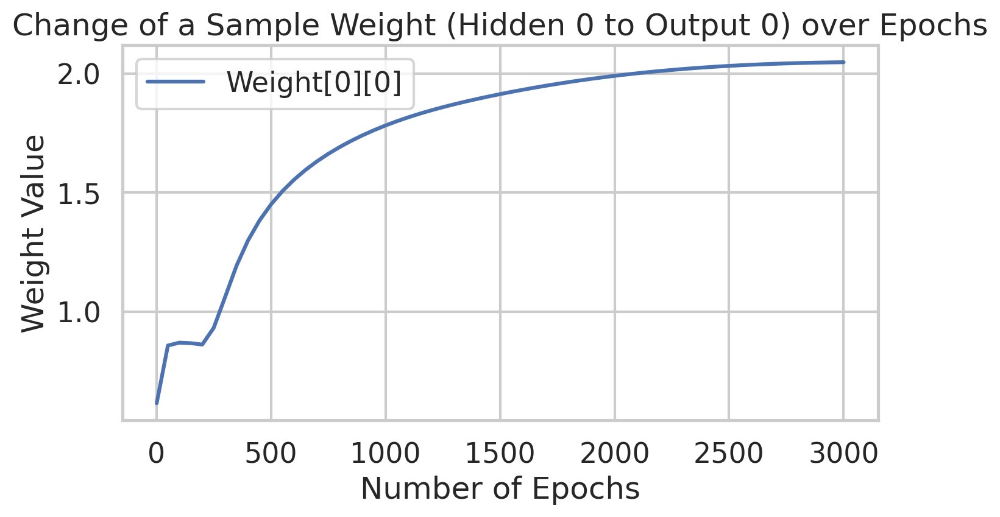

Overall accuracy: 76.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 33.33%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 76.67% hits and 23.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 3 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 82.50%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 51.52%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 82.50% hits and 17.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 17 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.005
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3312693844799712
Epoch  50 - Total Error:  0.07149516045823846
Epoch  100 - Total Error:  0.04769981425693552
Epoch  150 - Total Error:  0.0383946885421217
Epoch  200 - Total Error:  0.03399469670134631
Epoch  250 - Total Error:  0.03155550

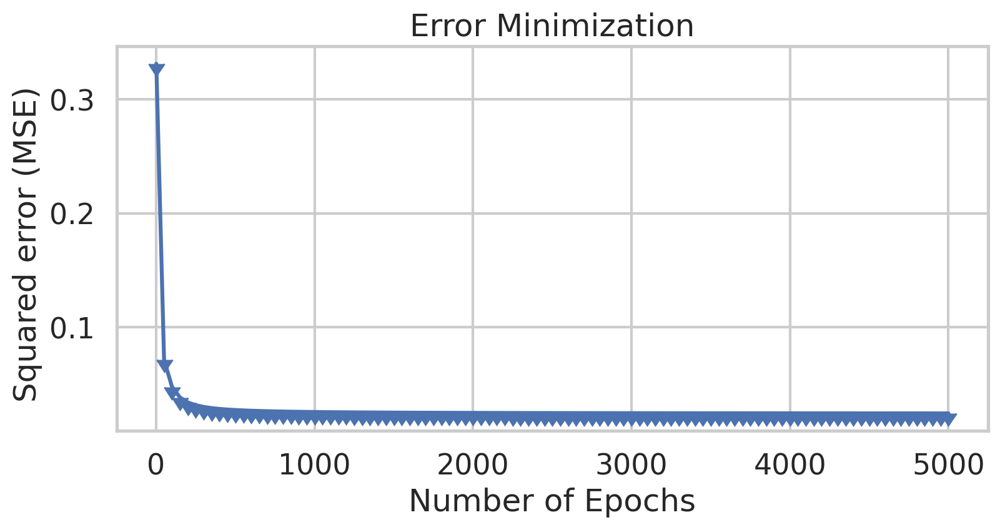

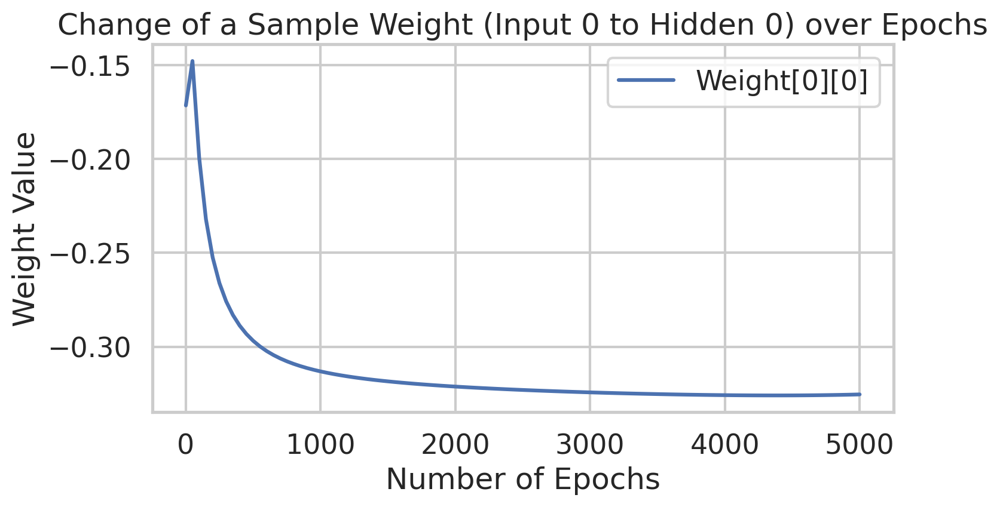

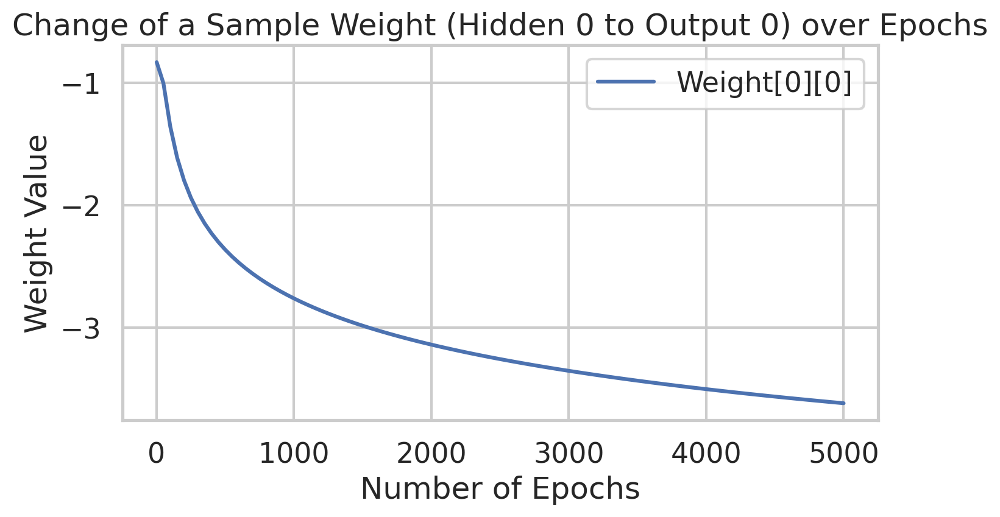

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.01
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2714412507897934
Epoch  50 - Total Error:  0.09038052991226074
Epoch  100 - Total Error:  0.043051768352743616
Epoch  150 - Total Error:  0.031907580943931584
Epoch  200 - Total Error:  0.028593798513783148
Epoch  250 - Total Error:  0.027156

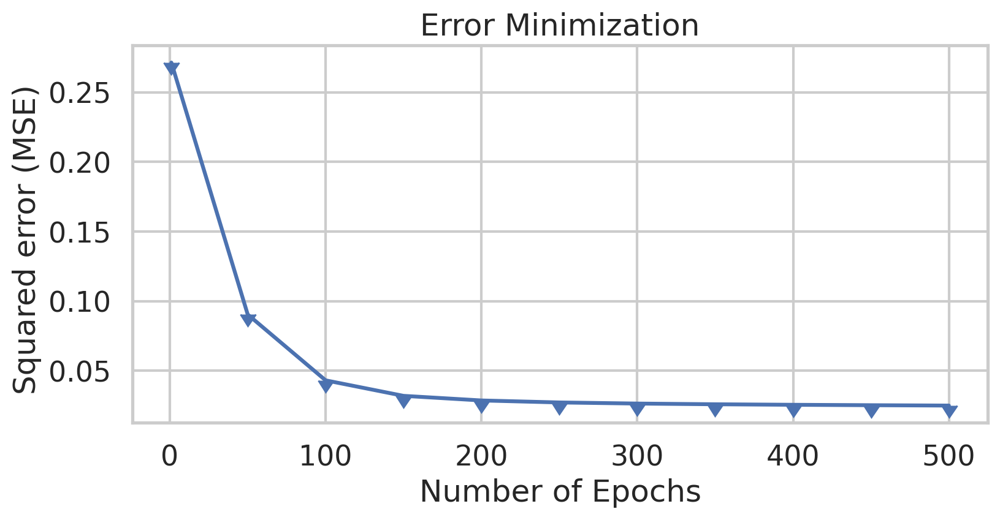

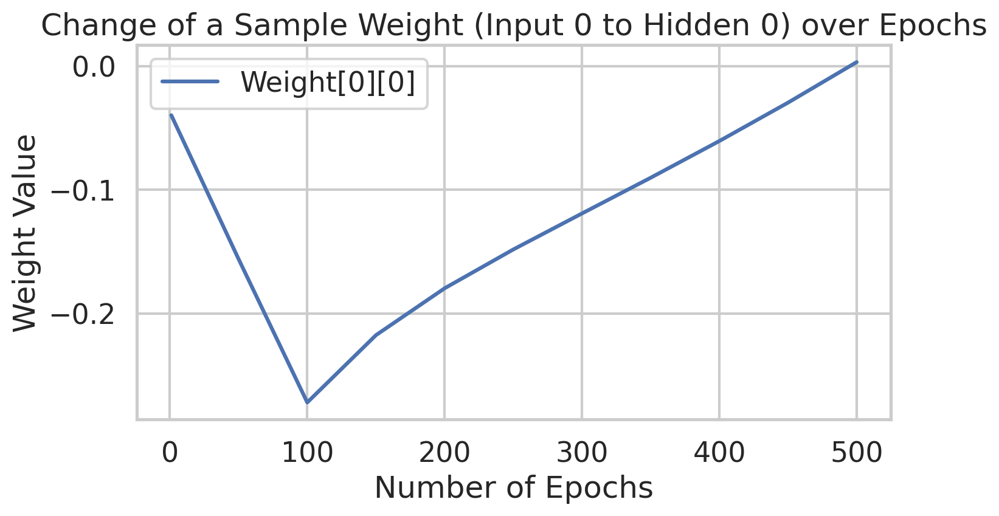

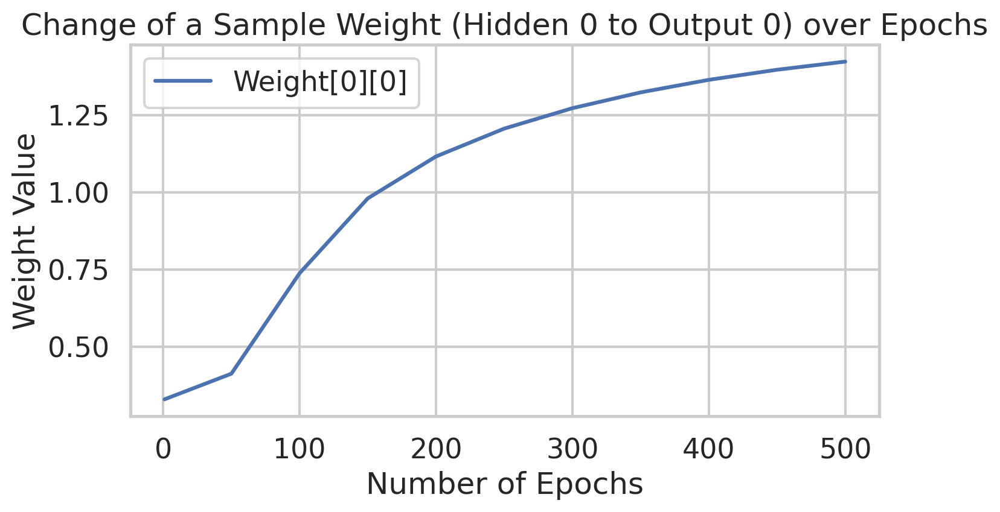

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.01
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3116206819416179
Epoch  50 - Total Error:  0.05225165801726108
Epoch  100 - Total Error:  0.033536573082673014
Epoch  150 - Total Error:  0.029284218811966863
Epoch  200 - Total Error:  0.02761164364645261
Epoch  250 - Total Error:  0.026746

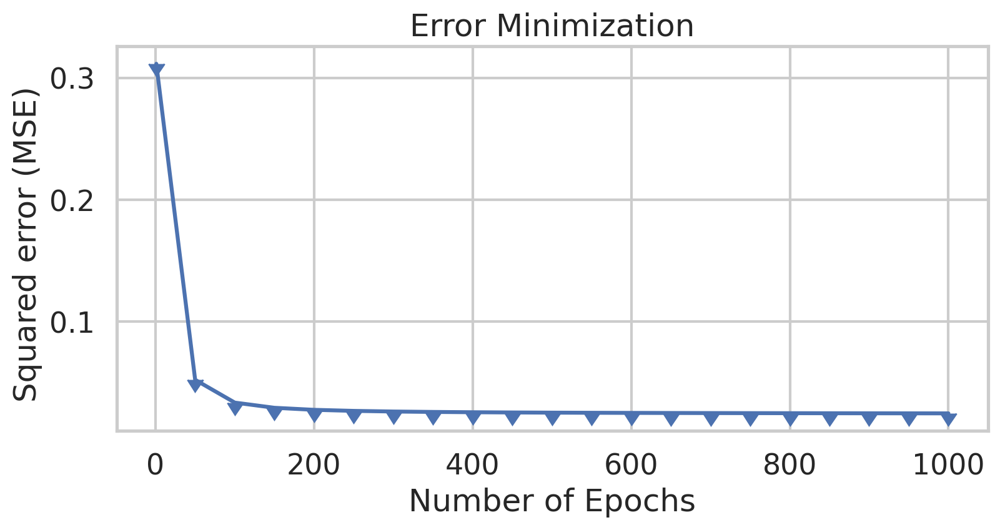

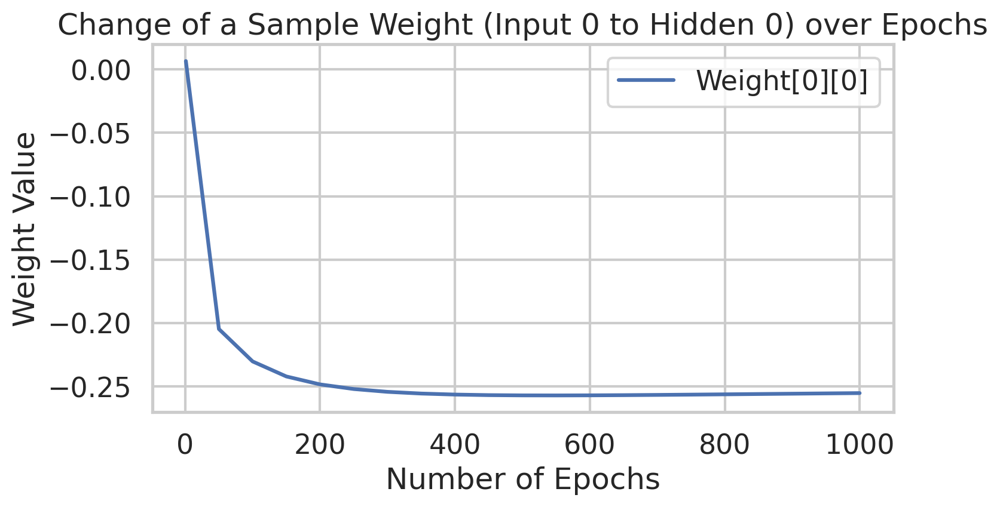

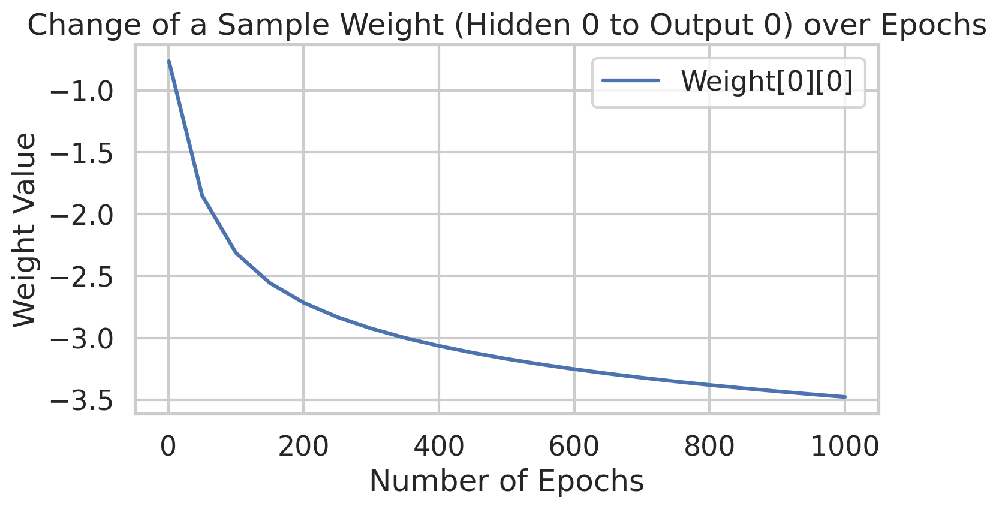

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.01
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2187602034143604
Epoch  50 - Total Error:  0.06564533188162854
Epoch  100 - Total Error:  0.03864097655164518
Epoch  150 - Total Error:  0.03212490998952409
Epoch  200 - Total Error:  0.029614478897064134
Epoch  250 - Total Error:  0.0283144

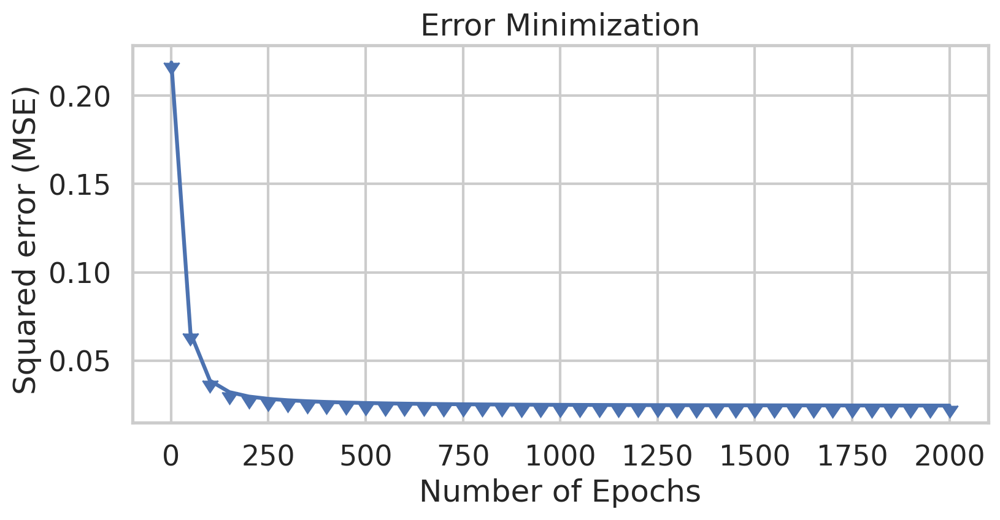

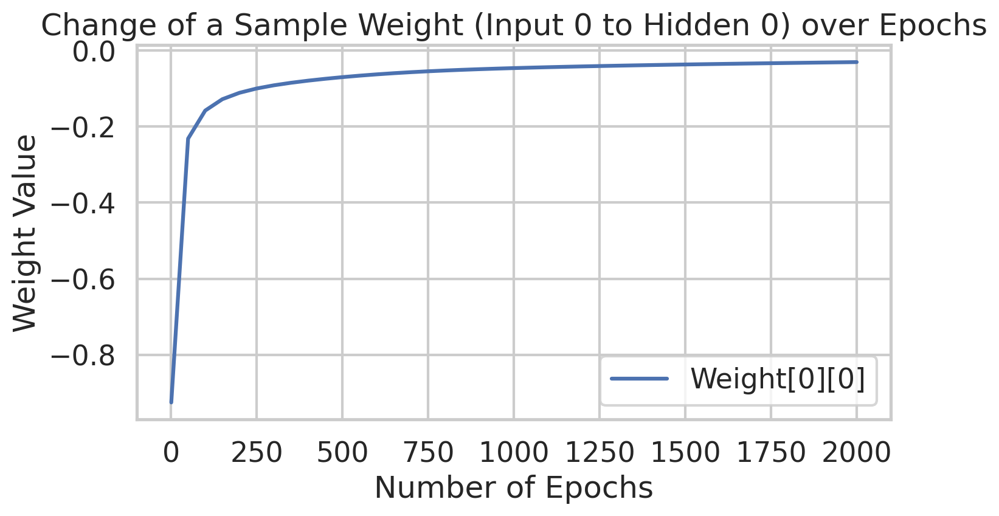

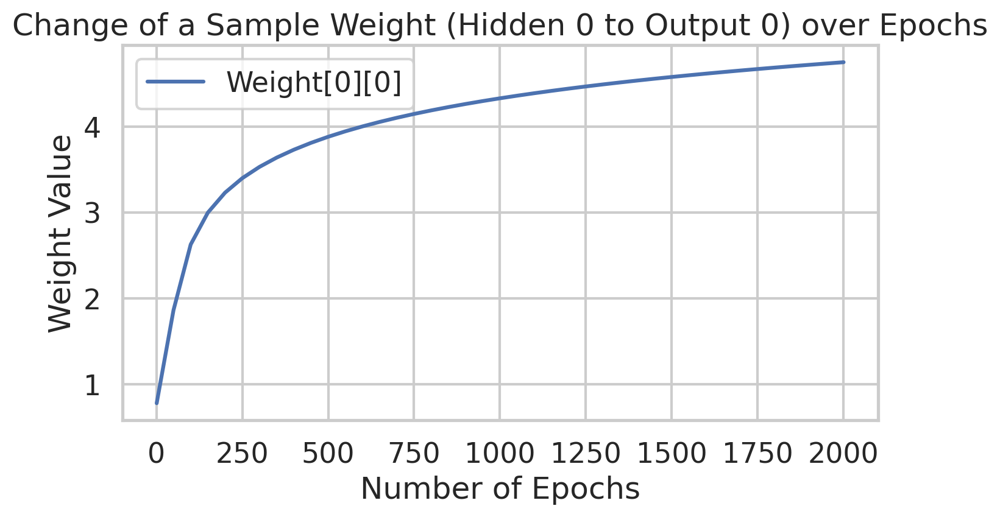

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.01
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2581093264837653
Epoch  50 - Total Error:  0.061640589820741415
Epoch  100 - Total Error:  0.03944335309780087
Epoch  150 - Total Error:  0.03252217600497948
Epoch  200 - Total Error:  0.029613136071506247
Epoch  250 - Total Error:  0.028108

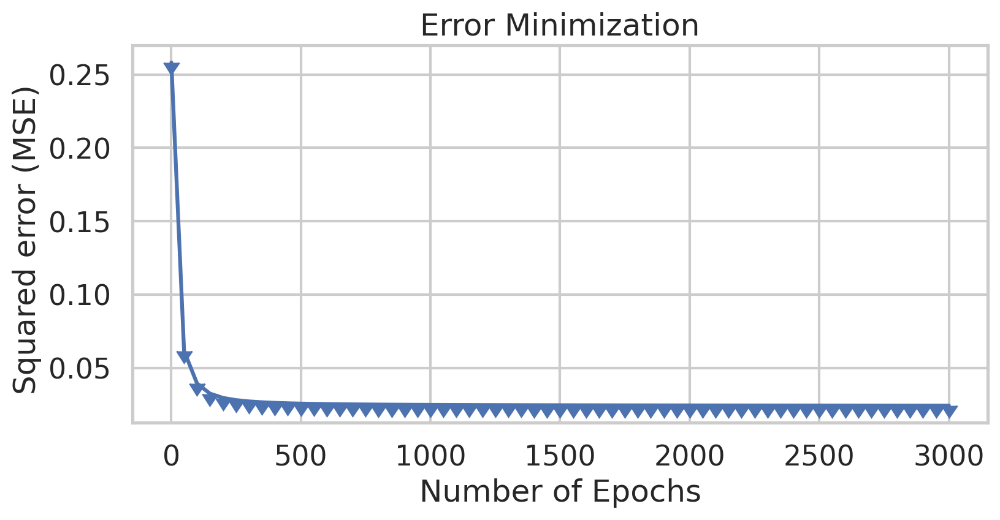

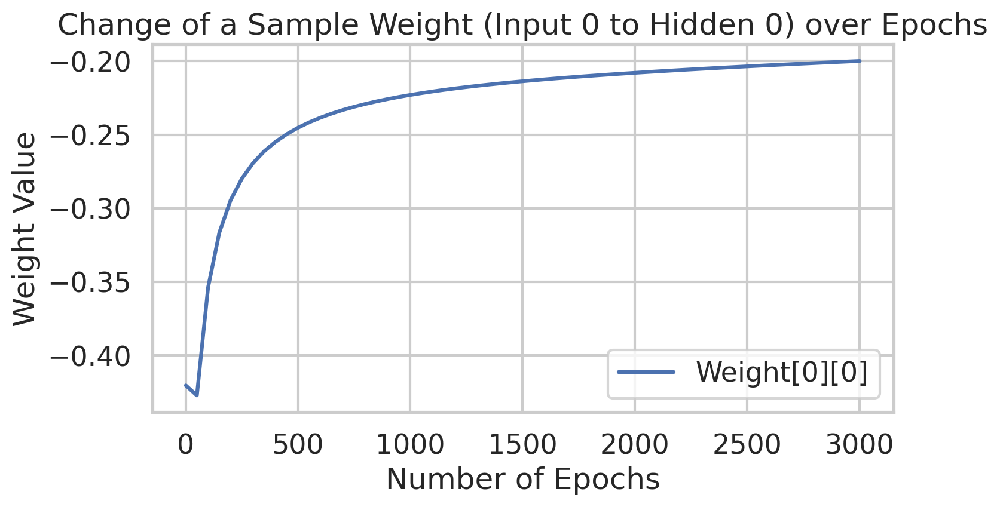

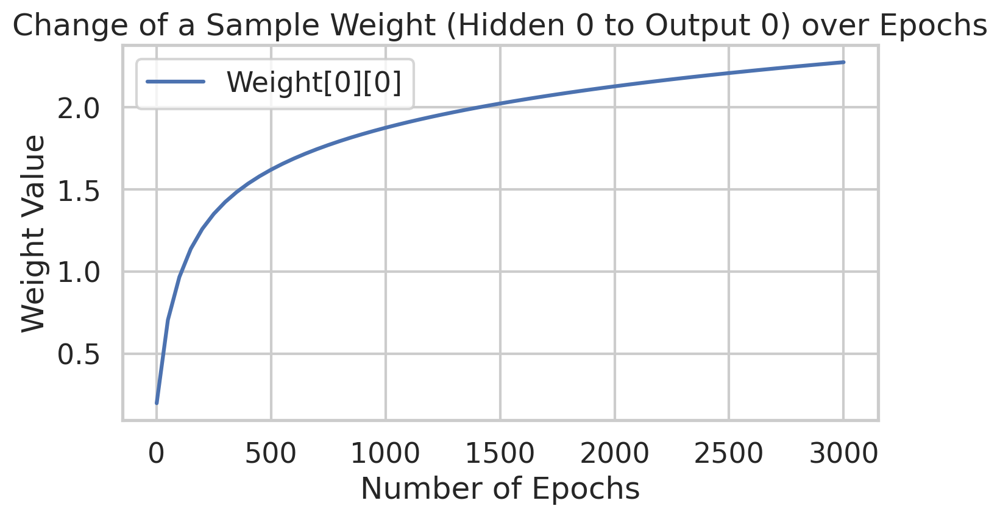

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.01
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.5253484697105831
Epoch  50 - Total Error:  0.07191539780381836
Epoch  100 - Total Error:  0.04130922663455975
Epoch  150 - Total Error:  0.03189893508285807
Epoch  200 - Total Error:  0.02878804911122235
Epoch  250 - Total Error:  0.02738464

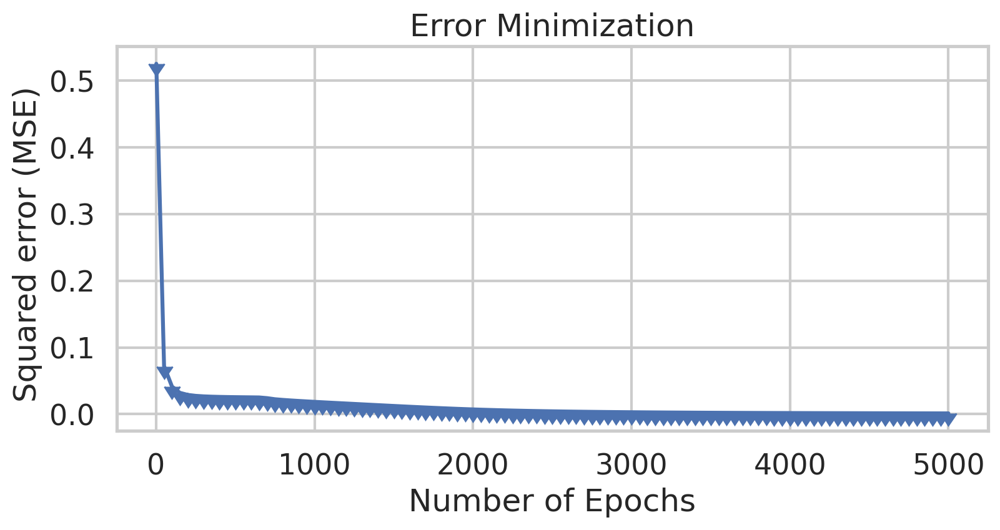

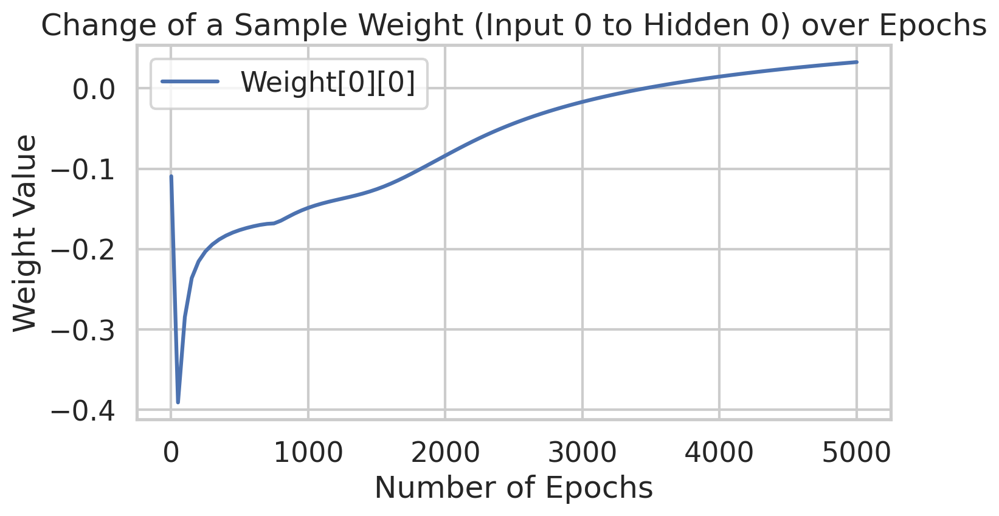

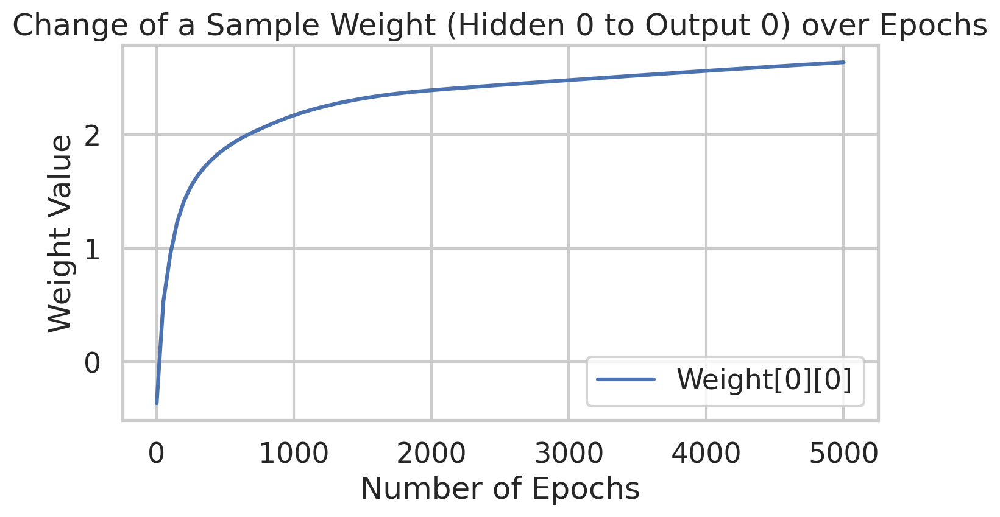

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 27.50%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 27.50% hits and 72.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.05
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.23360156075015015
Epoch  50 - Total Error:  0.02821571828887719
Epoch  100 - Total Error:  0.025775592766729482
Epoch  150 - Total Error:  0.025167080407785994
Epoch  200 - Total Error:  0.024893901332572143
Epoch  250 - Total Error:  0.024738845

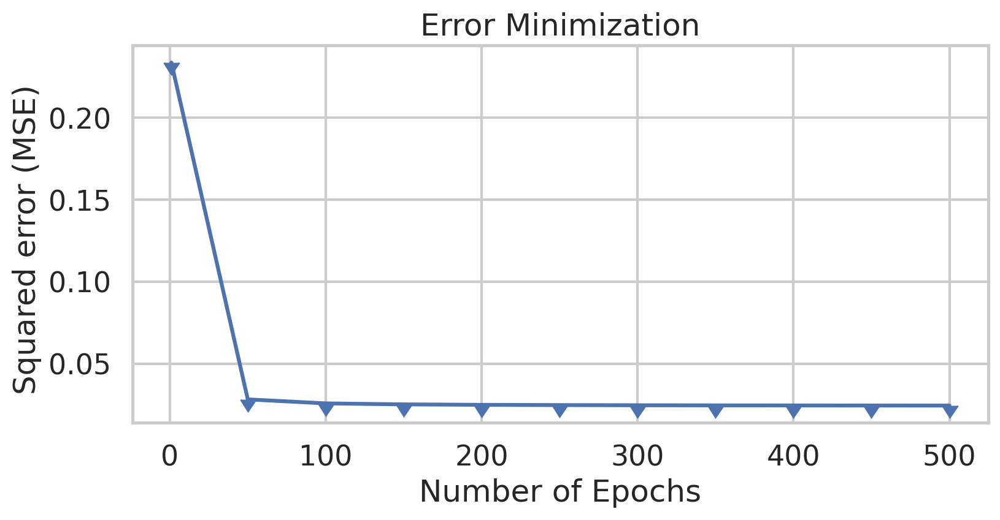

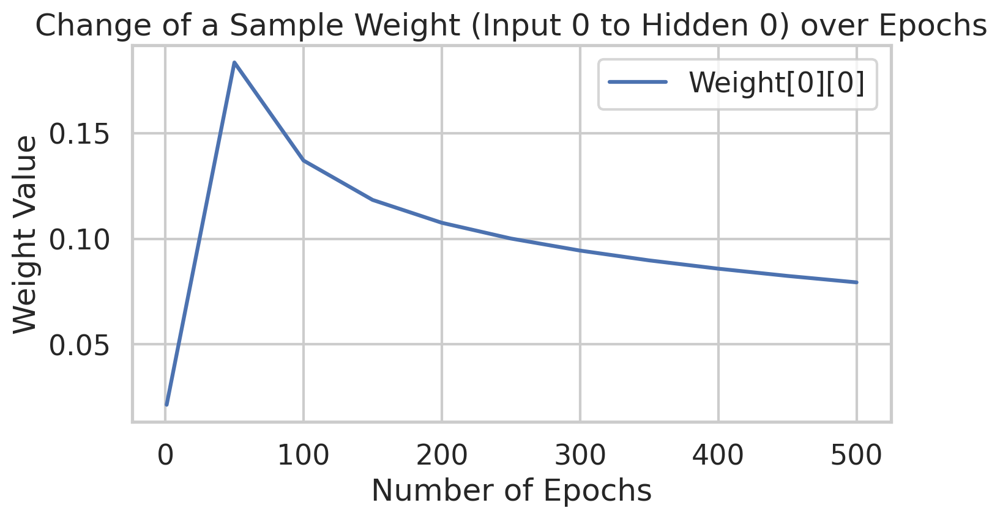

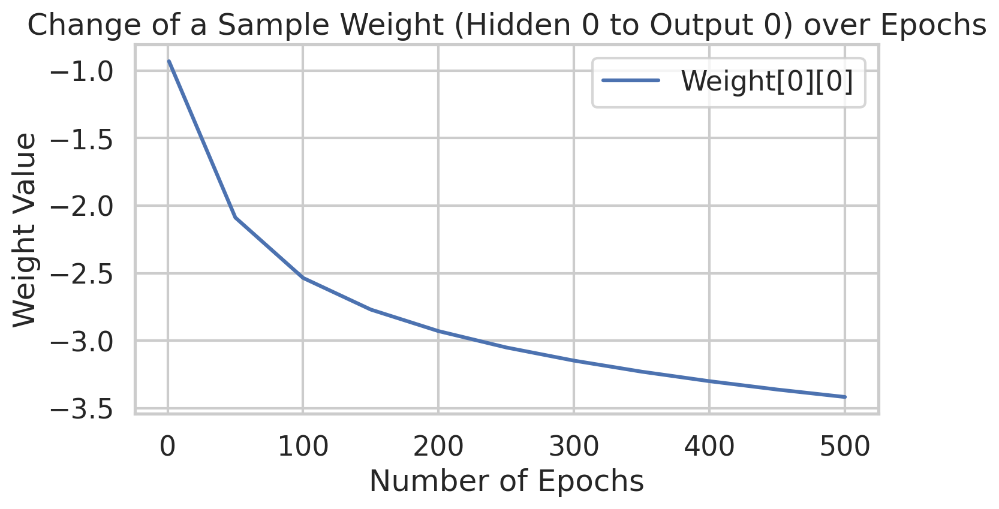

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.05
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.20047279460959594
Epoch  50 - Total Error:  0.026908426549746393
Epoch  100 - Total Error:  0.02541106149864462
Epoch  150 - Total Error:  0.025003608860112696
Epoch  200 - Total Error:  0.024802161122429476
Epoch  250 - Total Error:  0.0246

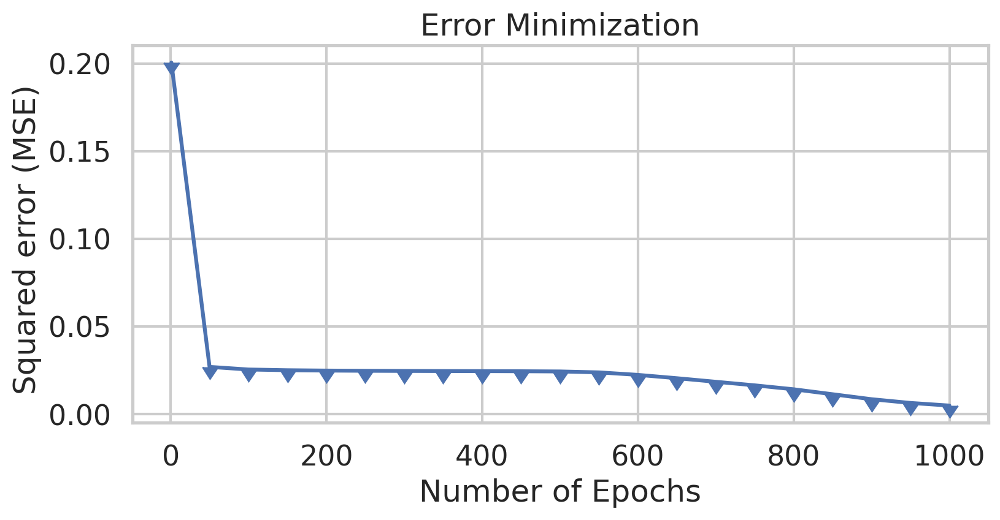

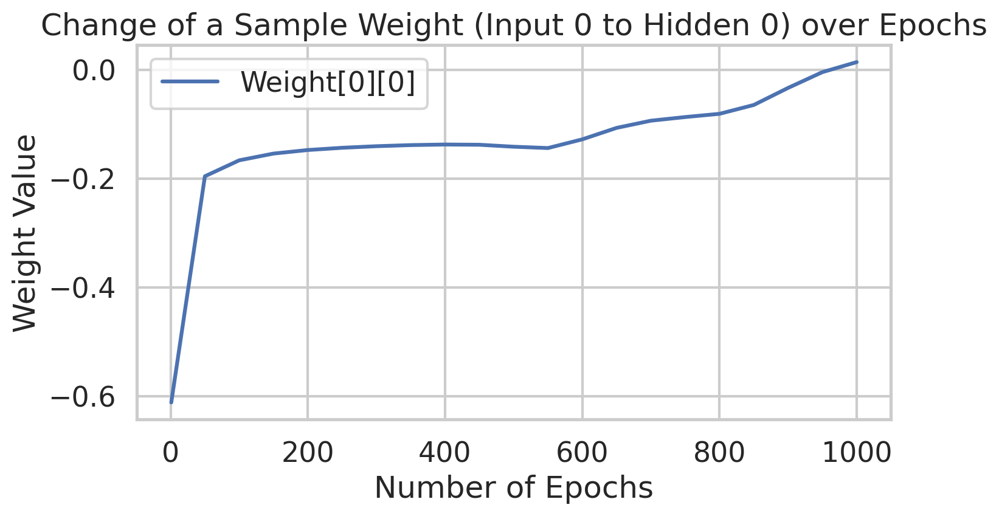

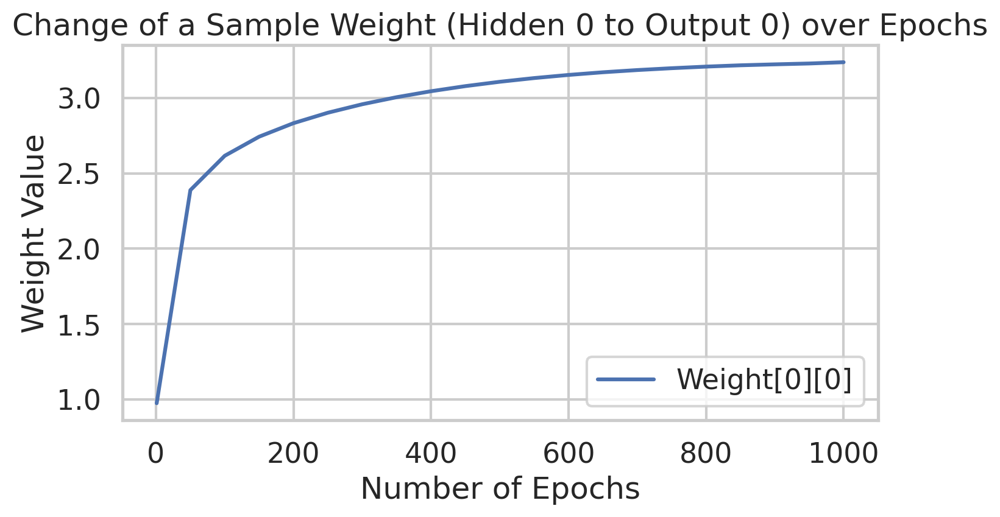

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 97.50%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 40.00%

=== Train Results ===
Porcents : 97.50% hits and 2.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 2 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.05
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.17292817354666648
Epoch  50 - Total Error:  0.027351179857882744
Epoch  100 - Total Error:  0.025605991342020594
Epoch  150 - Total Error:  0.025097295498166673
Epoch  200 - Total Error:  0.024856766419320976
Epoch  250 - Total Error:  0.02

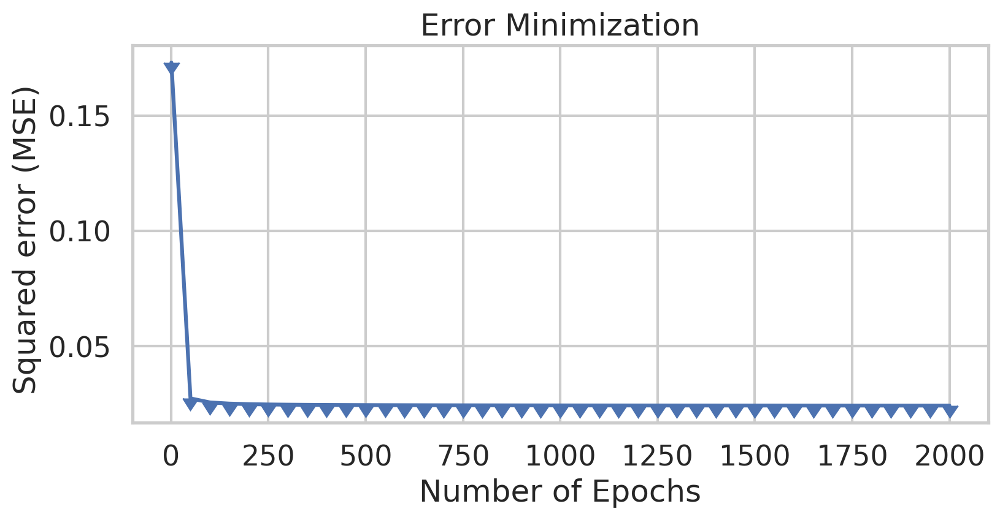

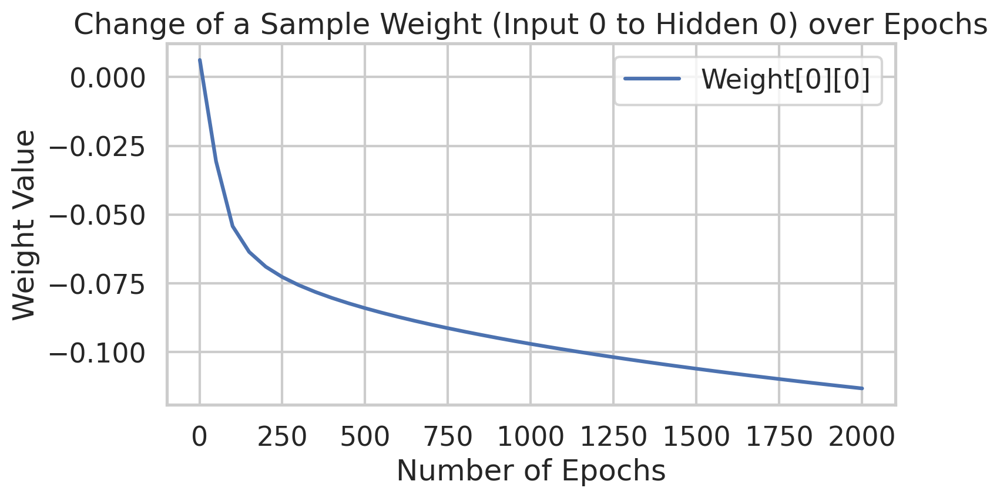

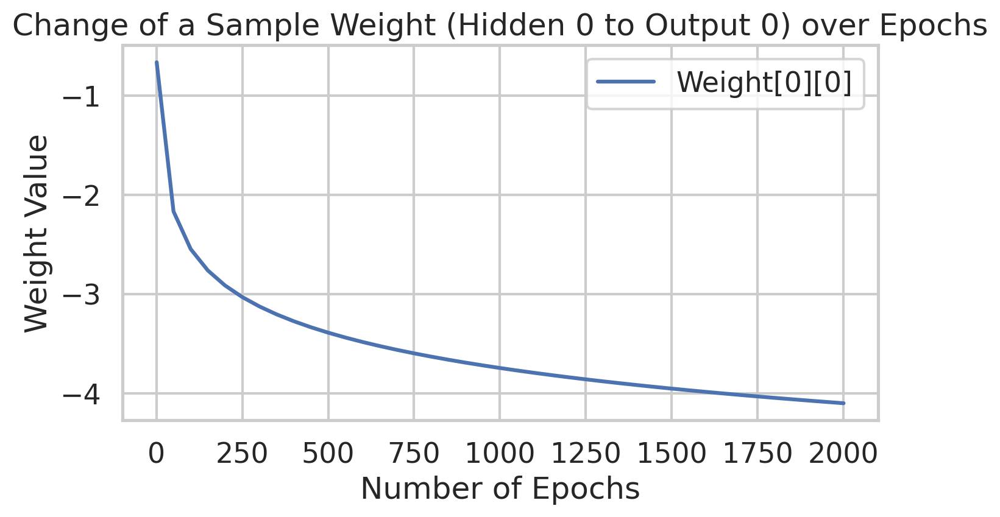

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.05
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.20862744148131715
Epoch  50 - Total Error:  0.02838026758164505
Epoch  100 - Total Error:  0.02581502889646856
Epoch  150 - Total Error:  0.02518188842557049
Epoch  200 - Total Error:  0.02490026960210633
Epoch  250 - Total Error:  0.0247347

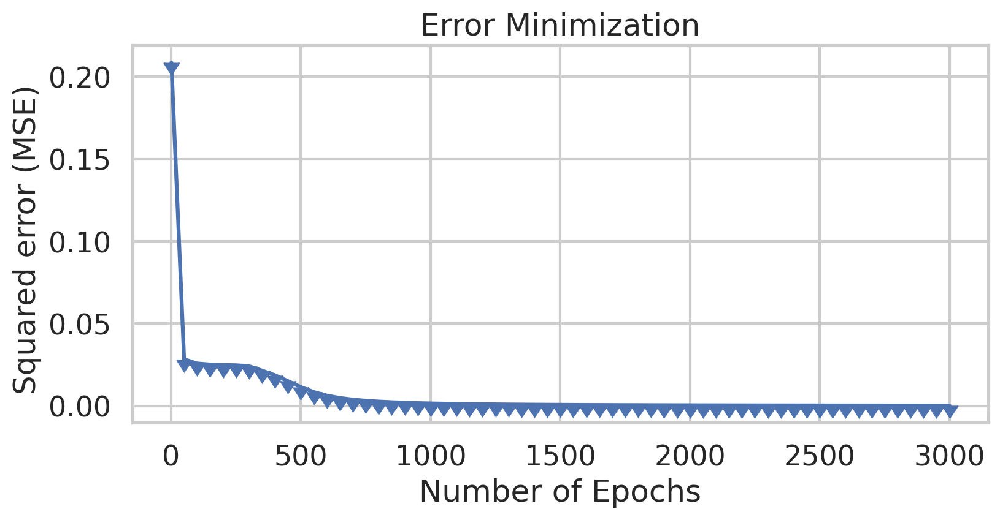

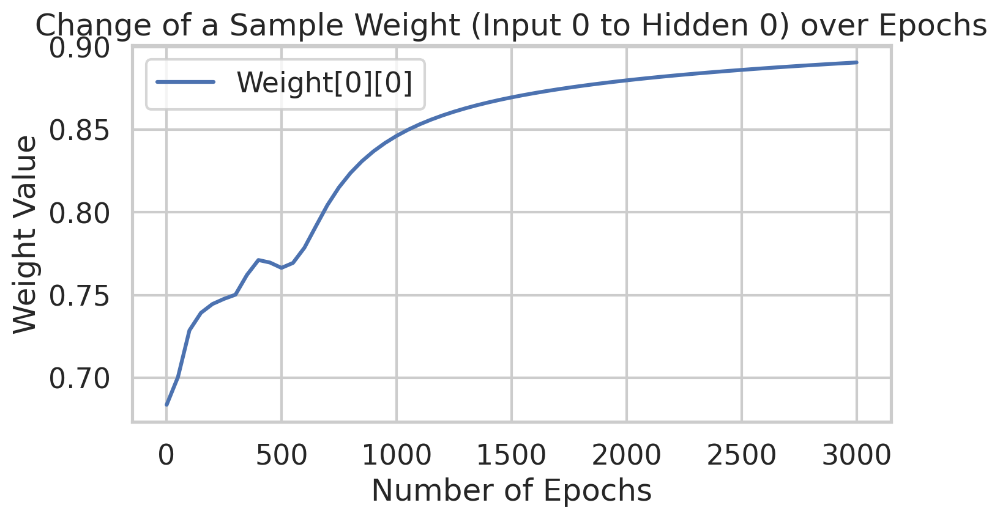

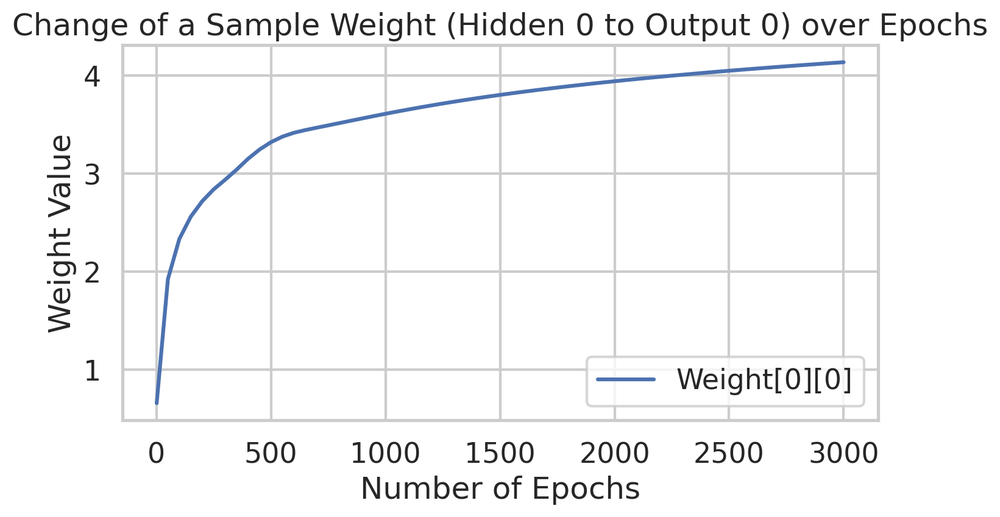

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 29.17%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 40.00%

=== Train Results ===
Porcents : 29.17% hits and 70.83% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 2 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.05
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.1970932066254673
Epoch  50 - Total Error:  0.15287901156702102
Epoch  100 - Total Error:  0.15215633157486125
Epoch  150 - Total Error:  0.032154981557998896
Epoch  200 - Total Error:  0.02761866465342479
Epoch  250 - Total Error:  0.0266525504

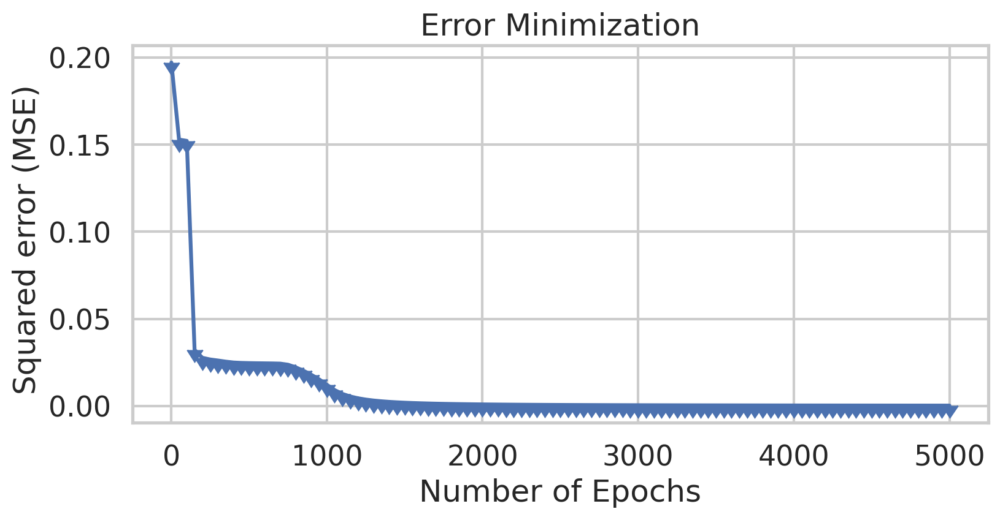

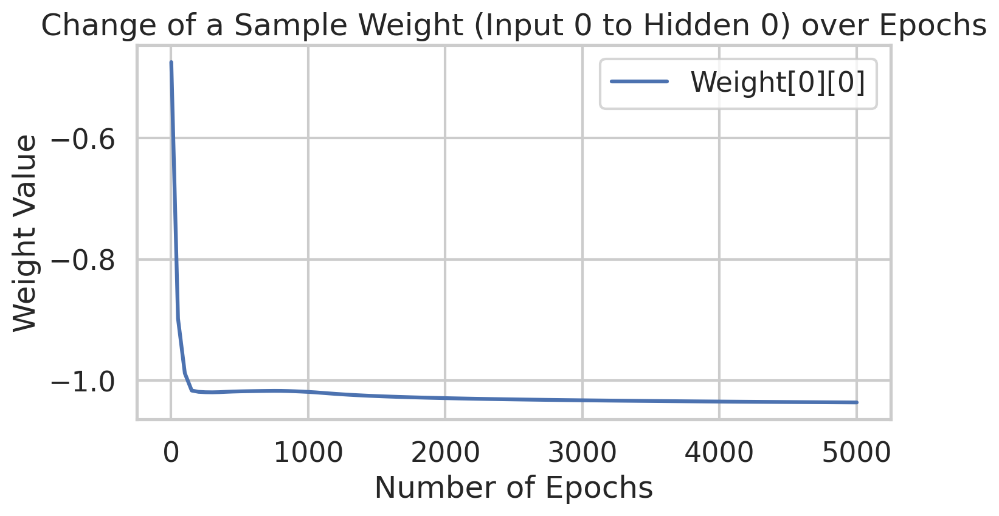

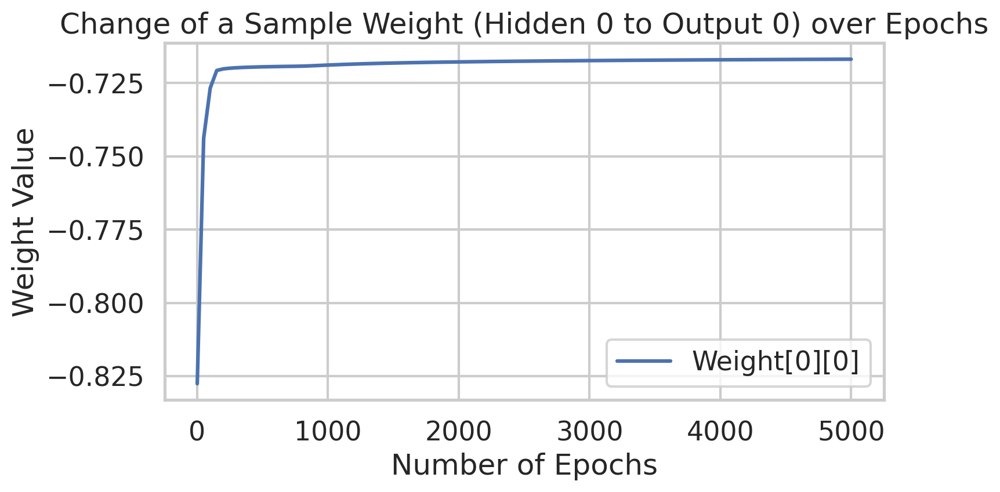

Overall accuracy: 70.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 0.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 70.00% hits and 30.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 0 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 75.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 9.09%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 75.00% hits and 25.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 3 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.1
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.19177964214473242
Epoch  50 - Total Error:  0.025943375415099286
Epoch  100 - Total Error:  0.024955520808444234
Epoch  150 - Total Error:  0.02468598455991953
Epoch  200 - Total Error:  0.024560721952205093
Epoch  250 - Total Error:  0.02448

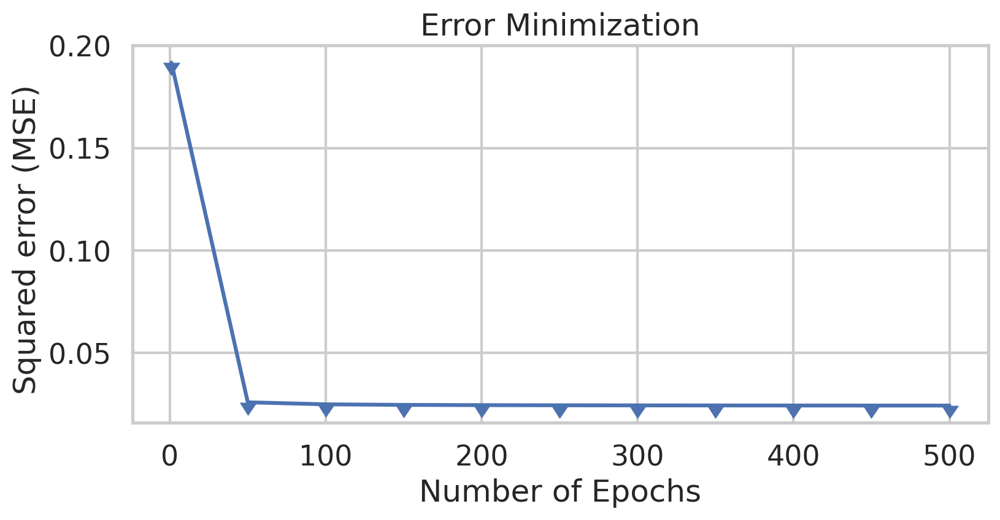

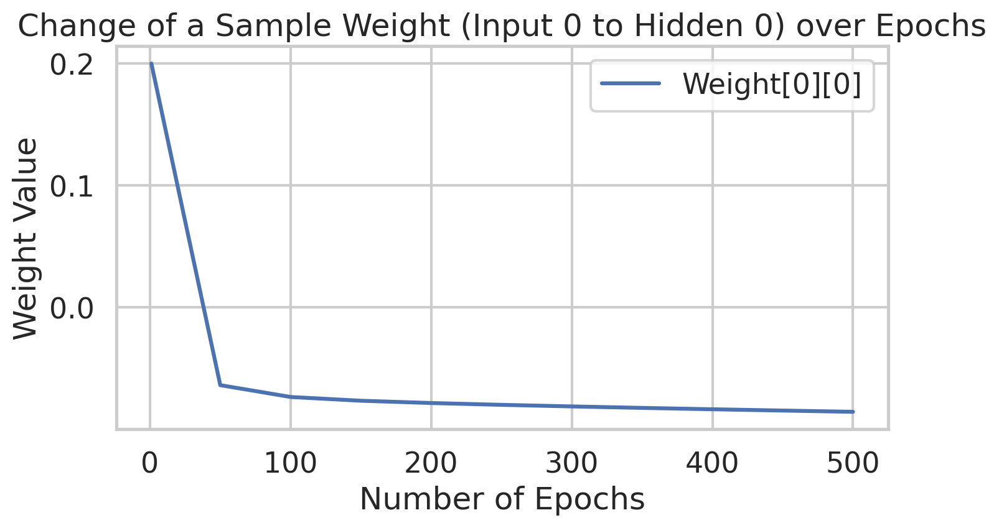

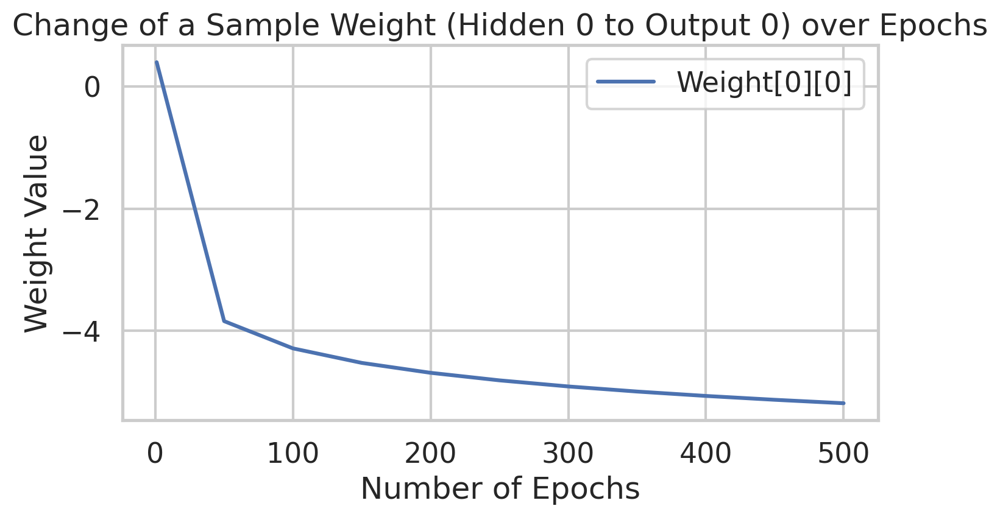

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.1
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.14906634095640584
Epoch  50 - Total Error:  0.025376839453920233
Epoch  100 - Total Error:  0.02478521989875136
Epoch  150 - Total Error:  0.024597641130762758
Epoch  200 - Total Error:  0.024504267029956762
Epoch  250 - Total Error:  0.02444

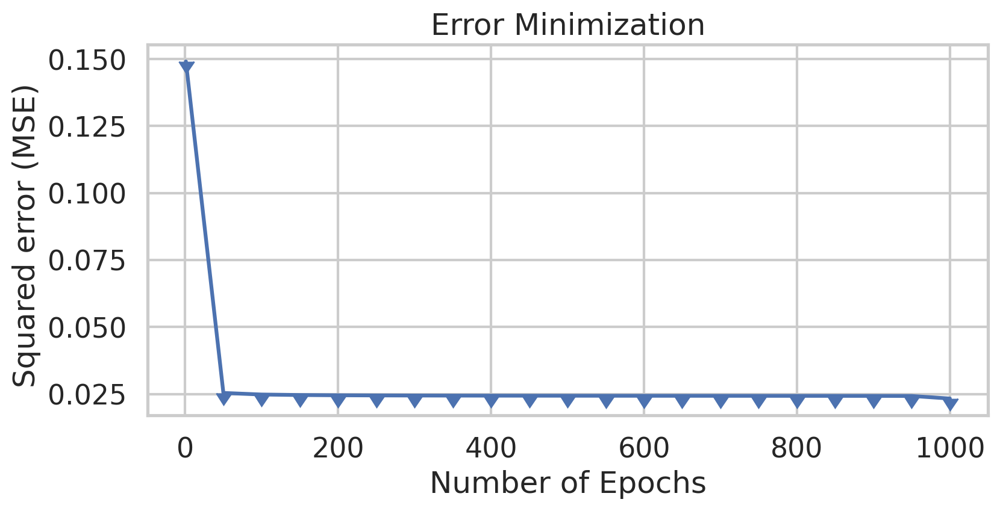

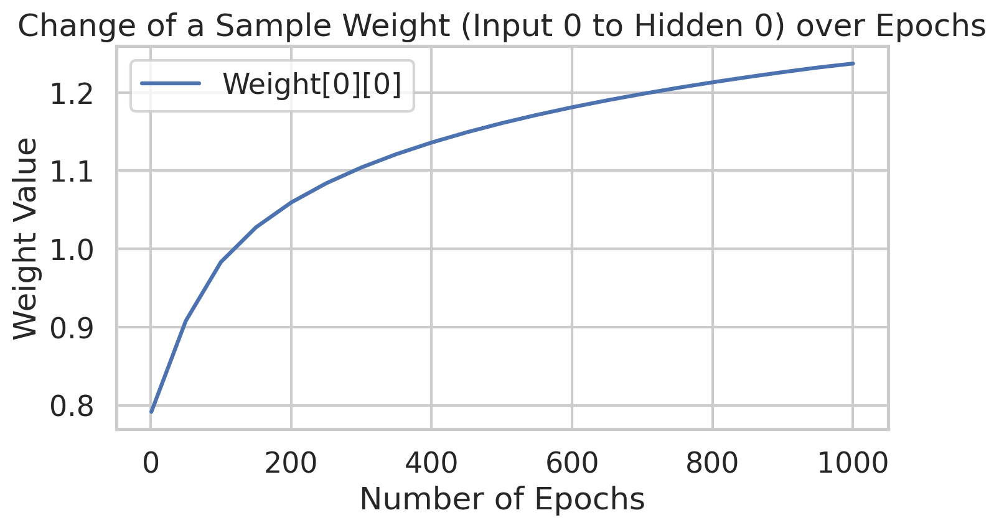

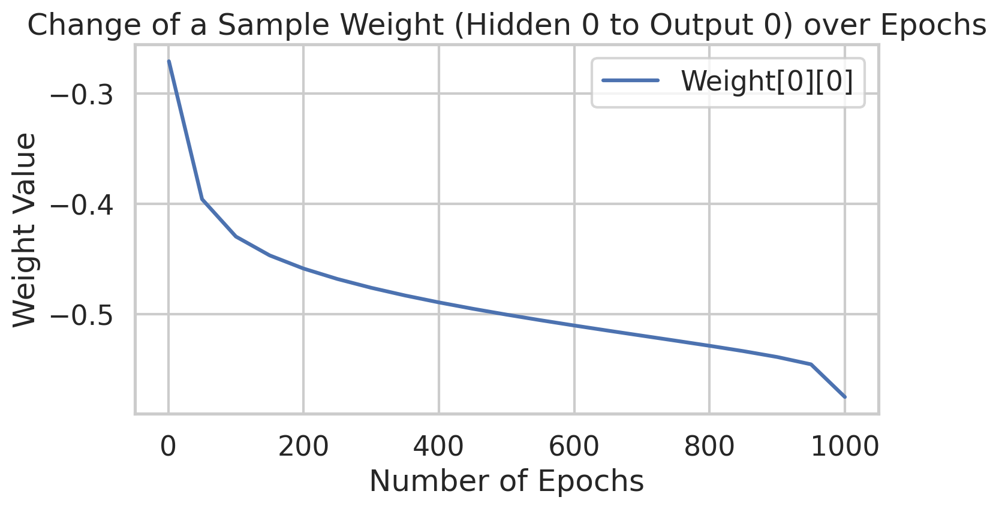

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.1
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.17118523123999566
Epoch  50 - Total Error:  0.026246652041075014
Epoch  100 - Total Error:  0.025054678271637744
Epoch  150 - Total Error:  0.02473290017267179
Epoch  200 - Total Error:  0.024590573689657405
Epoch  250 - Total Error:  0.02451

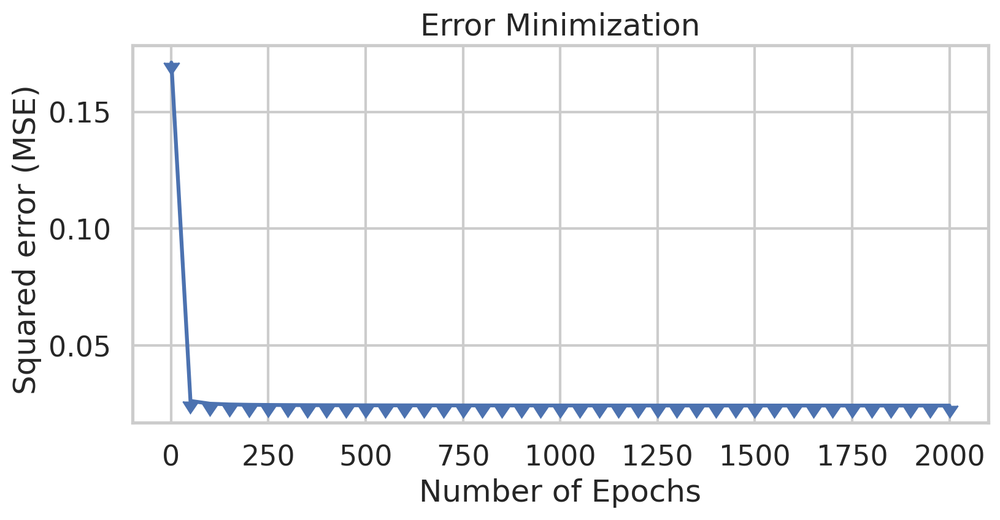

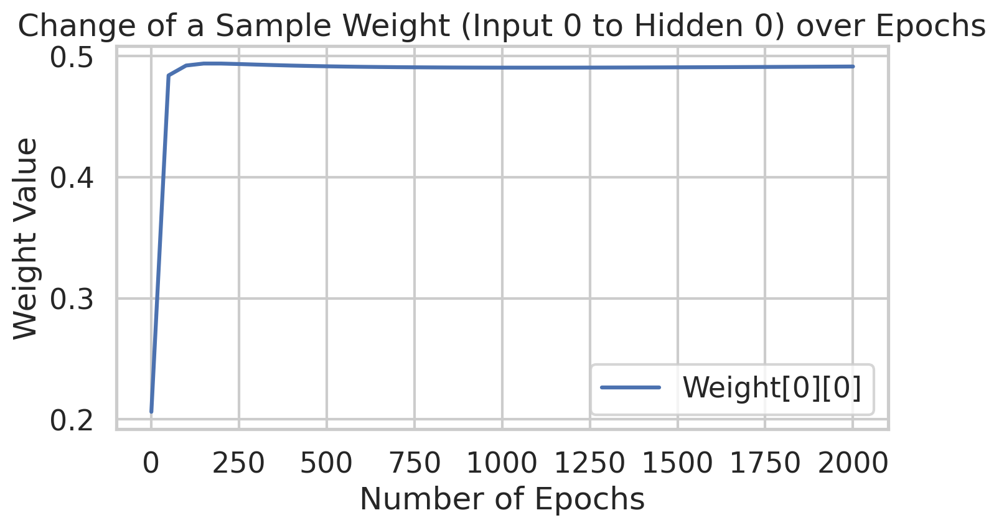

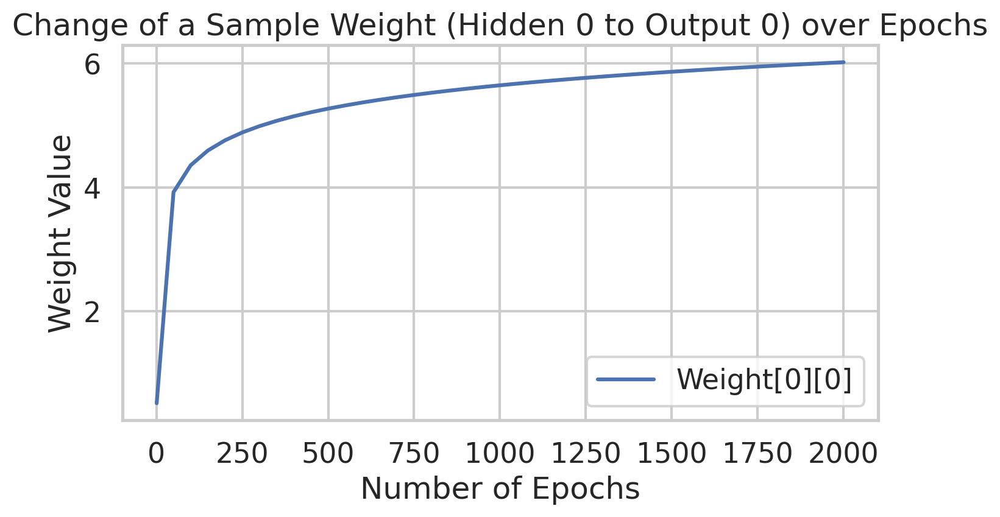

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 91.67%
 - Accuracy Setosa: 93.90%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 91.67% hits and 8.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 77 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.1
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.16551033474420687
Epoch  50 - Total Error:  0.025715118786807434
Epoch  100 - Total Error:  0.02489827830958675
Epoch  150 - Total Error:  0.02464951770736547
Epoch  200 - Total Error:  0.02452477395059871
Epoch  250 - Total Error:  0.02443594

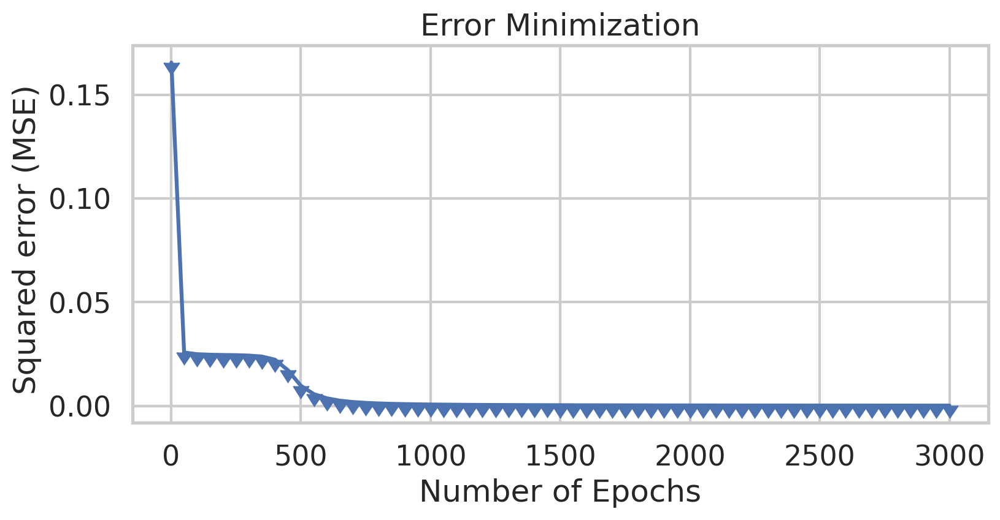

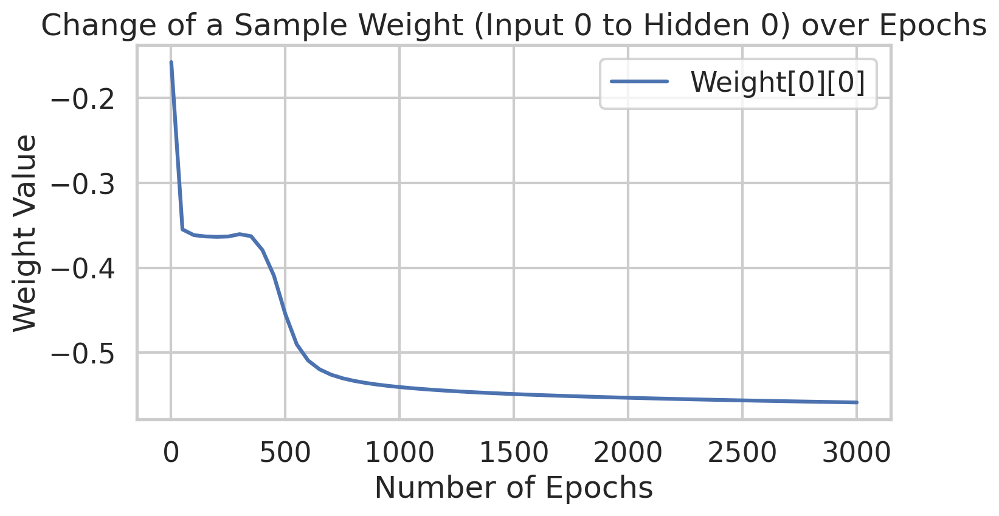

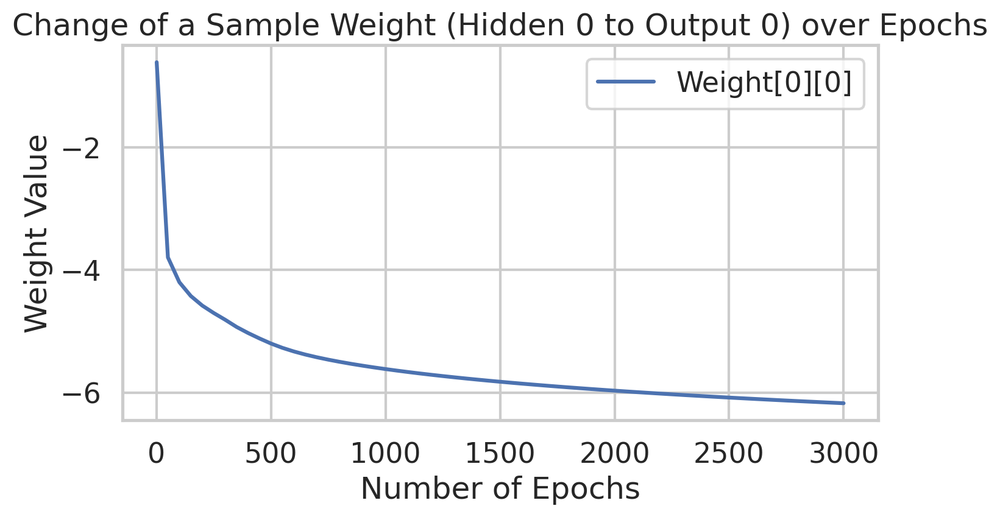

Overall accuracy: 33.33%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 33.33% hits and 66.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 31.67%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 31.67% hits and 68.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 5
 - Learning Rate: 0.1
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.24512289568792142
Epoch  50 - Total Error:  0.029343334834253984
Epoch  100 - Total Error:  0.026881303126684138
Epoch  150 - Total Error:  0.025750754609211435
Epoch  200 - Total Error:  0.025183337258065635
Epoch  250 - Total Error:  0.0249

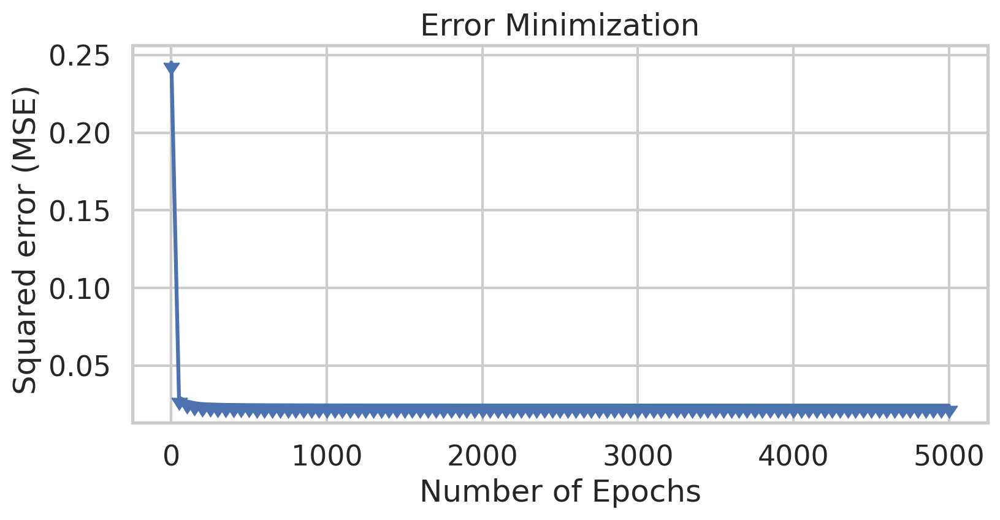

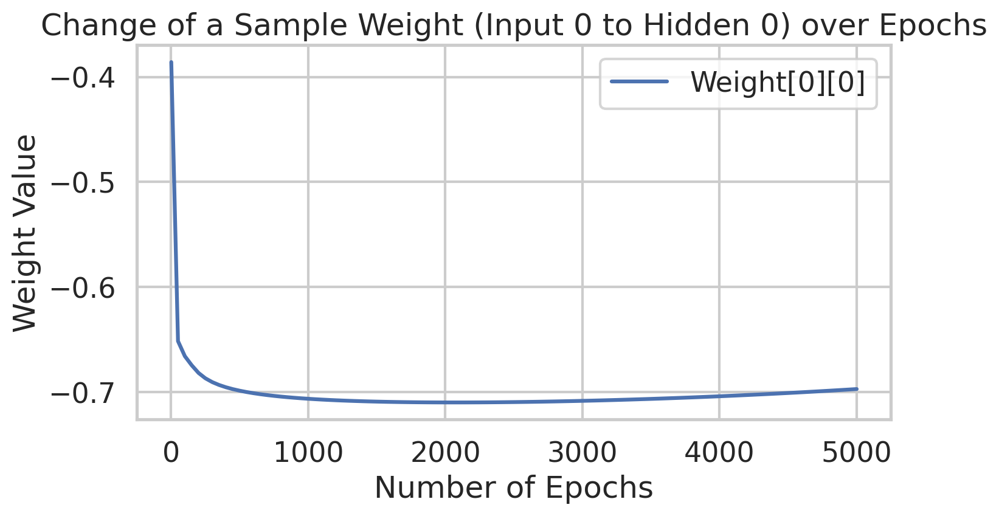

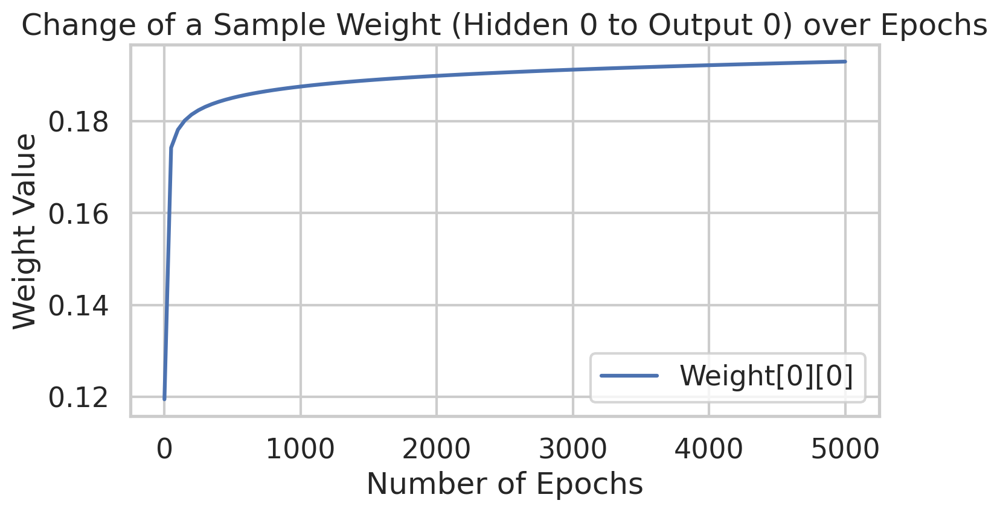

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 96.97%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 32 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.001
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.431599438285388
Epoch  50 - Total Error:  0.16831023448556479
Epoch  100 - Total Error:  0.14825612185600462
Epoch  150 - Total Error:  0.13933460513069906
Epoch  200 - Total Error:  0.1310409813149007
Epoch  250 - Total Error:  0.12170146491

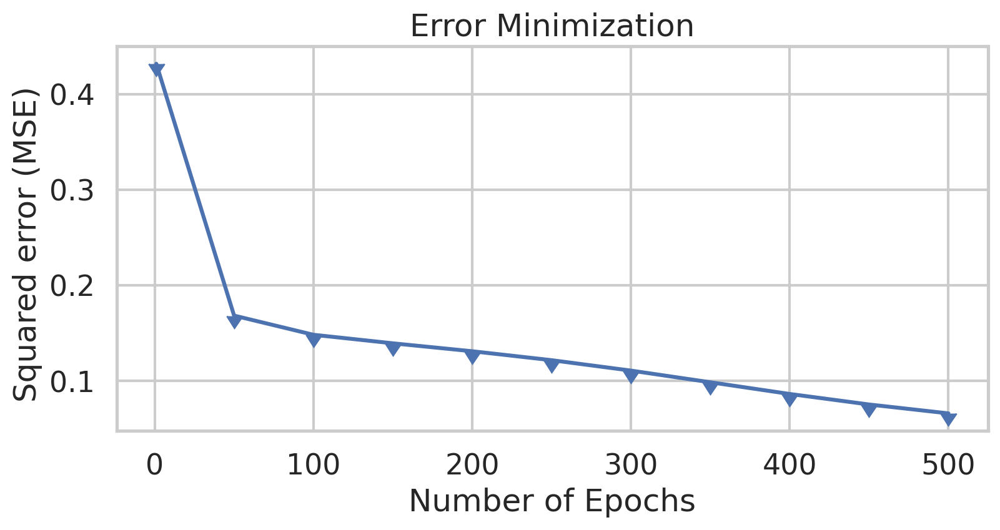

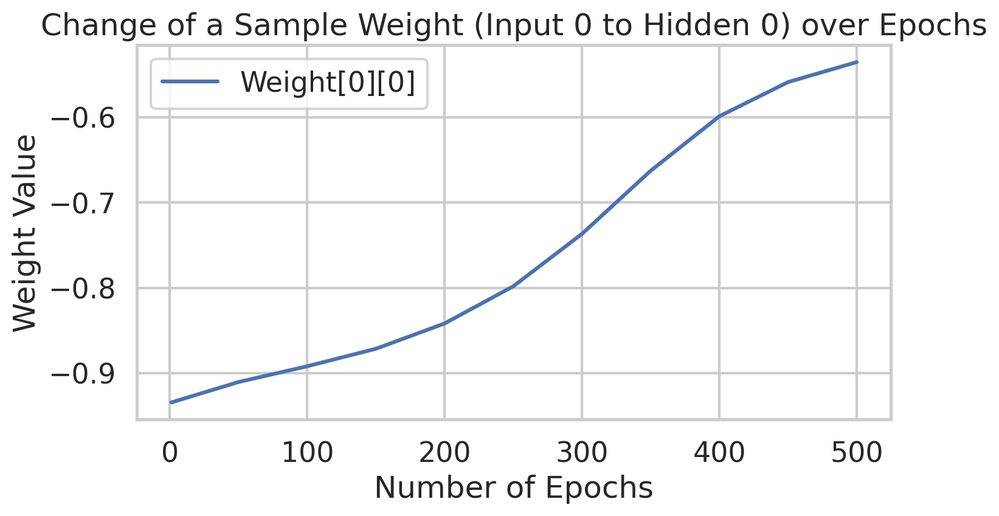

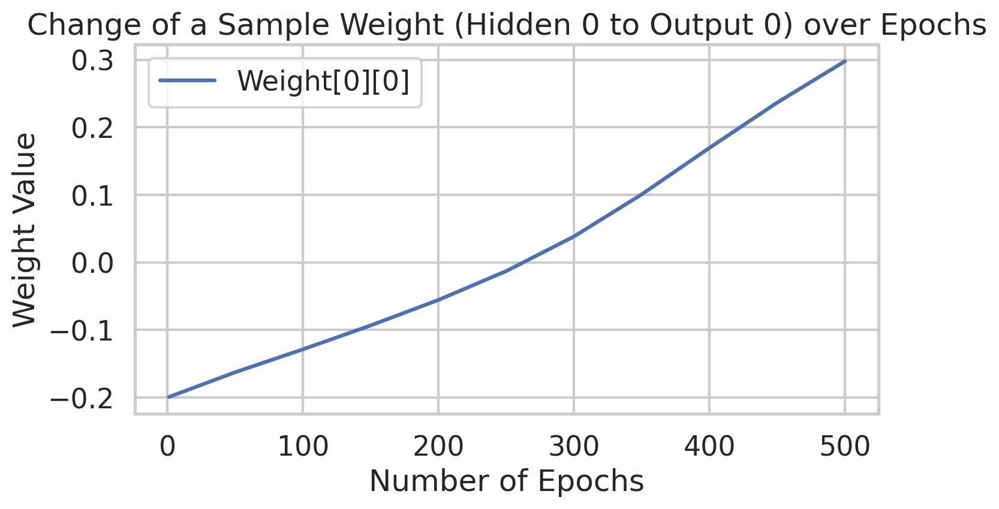

Overall accuracy: 73.33%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 22.22%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 73.33% hits and 26.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 2 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 80.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 45.45%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 80.83% hits and 19.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 15 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.001
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3224874689280295
Epoch  50 - Total Error:  0.17745703025661066
Epoch  100 - Total Error:  0.1460959581916689
Epoch  150 - Total Error:  0.13612084808876163
Epoch  200 - Total Error:  0.12832765438672764
Epoch  250 - Total Error:  0.12066500

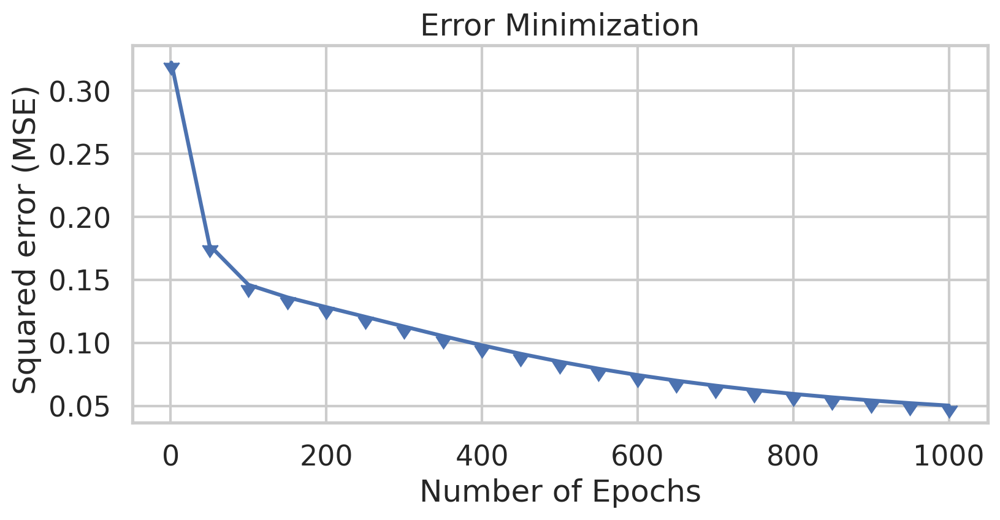

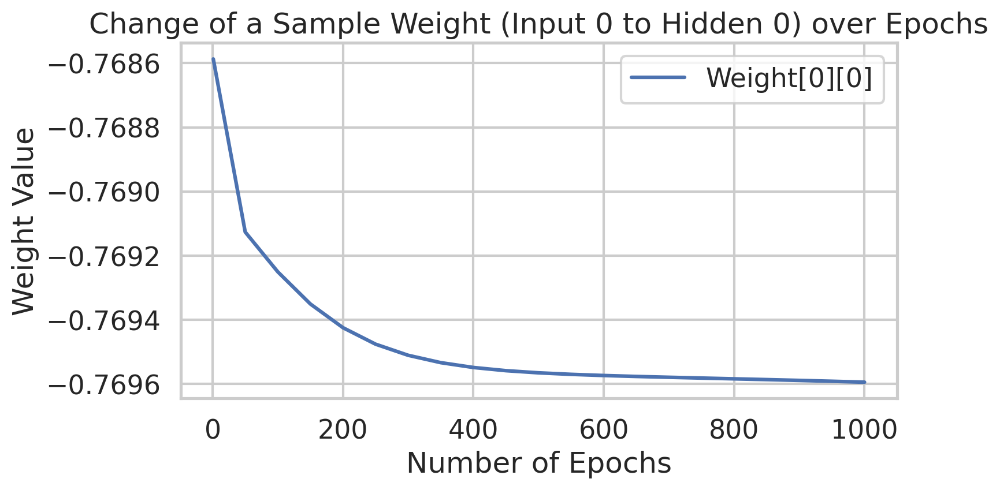

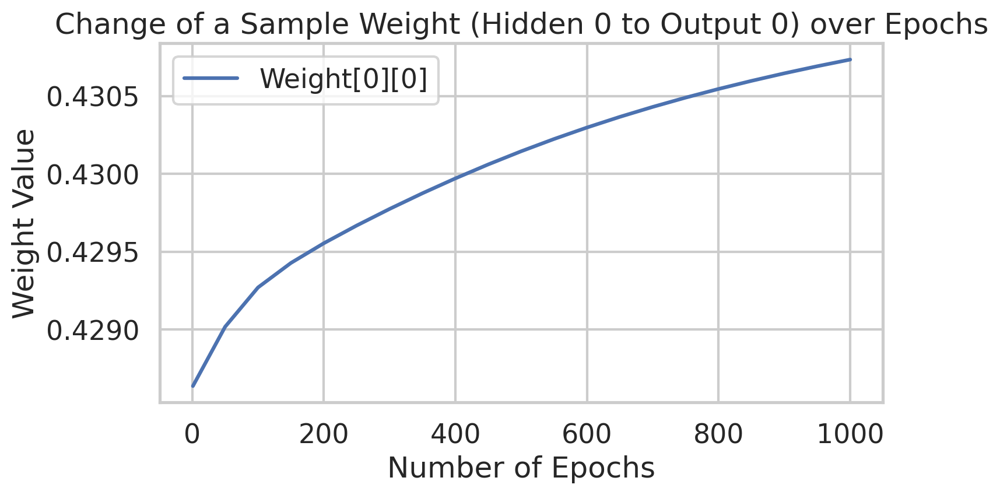

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.00%
 - Accuracy Setosa: 98.78%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 81 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.001
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3034214028054854
Epoch  50 - Total Error:  0.20616025930495338
Epoch  100 - Total Error:  0.16080452071042114
Epoch  150 - Total Error:  0.15374824499594006
Epoch  200 - Total Error:  0.1493963912460904
Epoch  250 - Total Error:  0.141973447

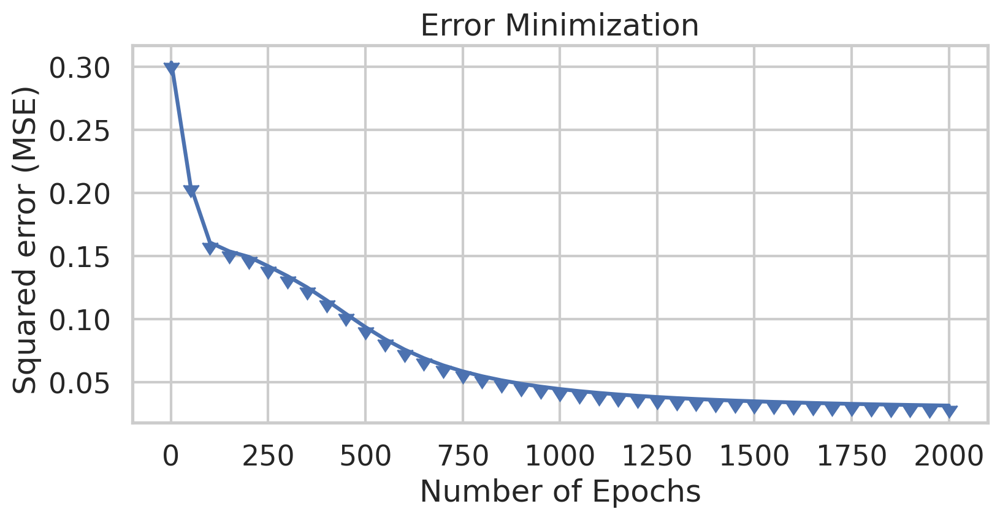

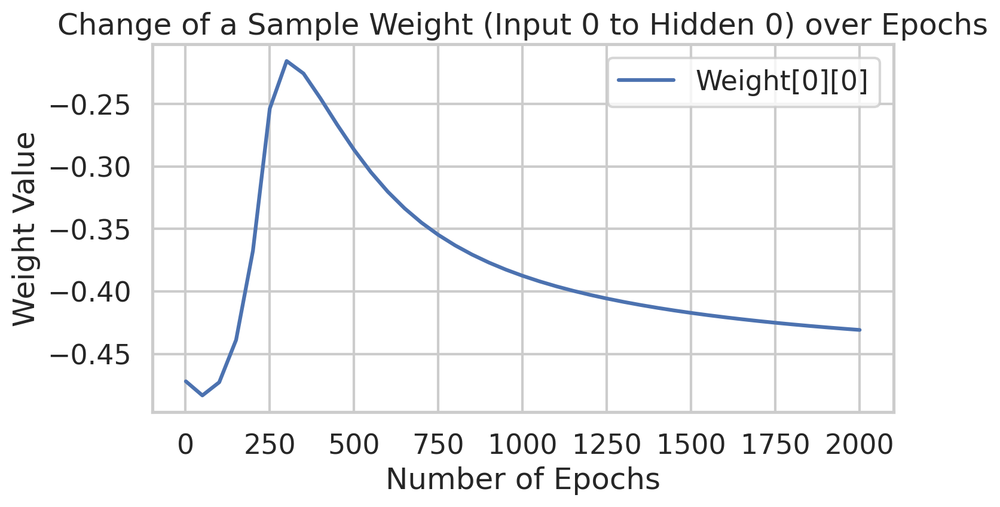

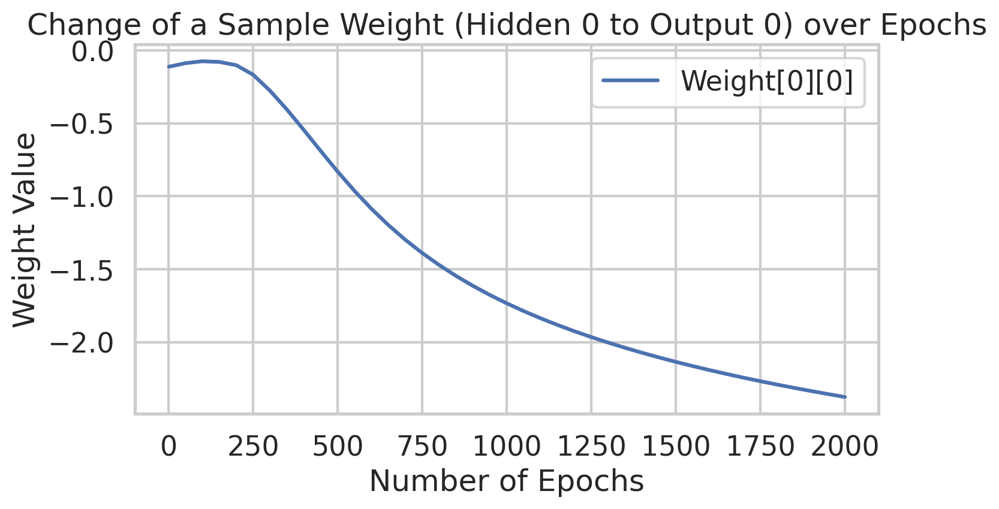

Overall accuracy: 73.33%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 22.22%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 73.33% hits and 26.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 2 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 70.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 9.09%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 70.83% hits and 29.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 3 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.001
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3110562046037007
Epoch  50 - Total Error:  0.1306623976501585
Epoch  100 - Total Error:  0.10243084351535778
Epoch  150 - Total Error:  0.08438005741837852
Epoch  200 - Total Error:  0.07181479123723676
Epoch  250 - Total Error:  0.0622976364

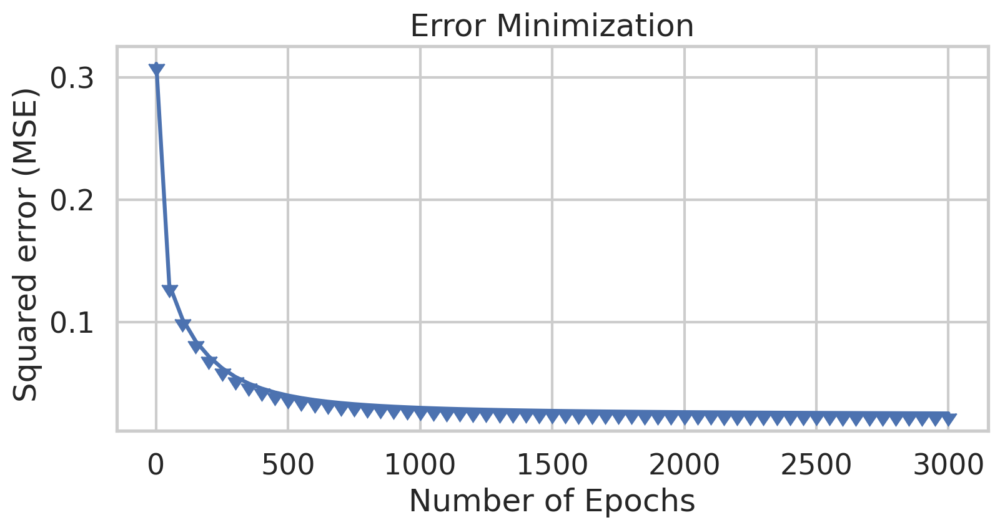

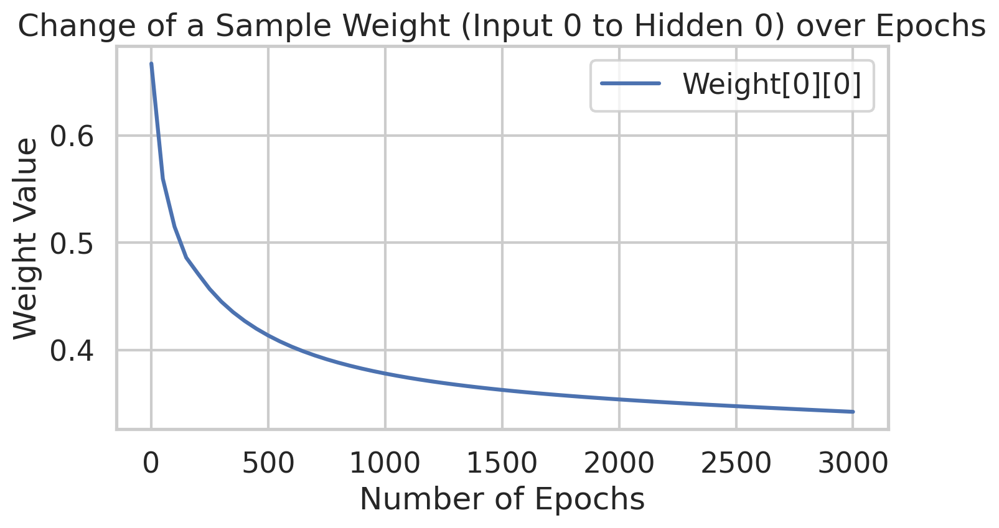

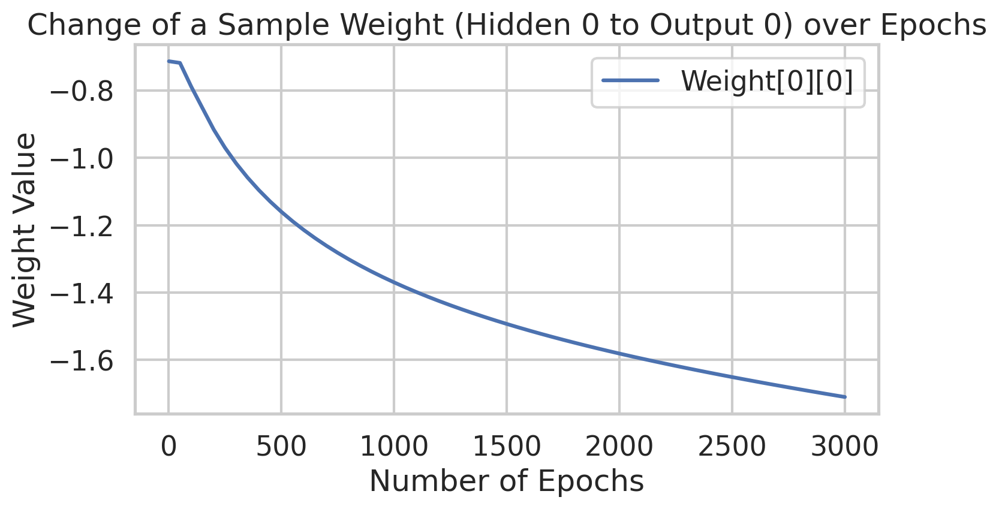

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.001
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.21605766658583744
Epoch  50 - Total Error:  0.14057924702343802
Epoch  100 - Total Error:  0.12062957709878681
Epoch  150 - Total Error:  0.10585878107899524
Epoch  200 - Total Error:  0.0926556808942082
Epoch  250 - Total Error:  0.0814333

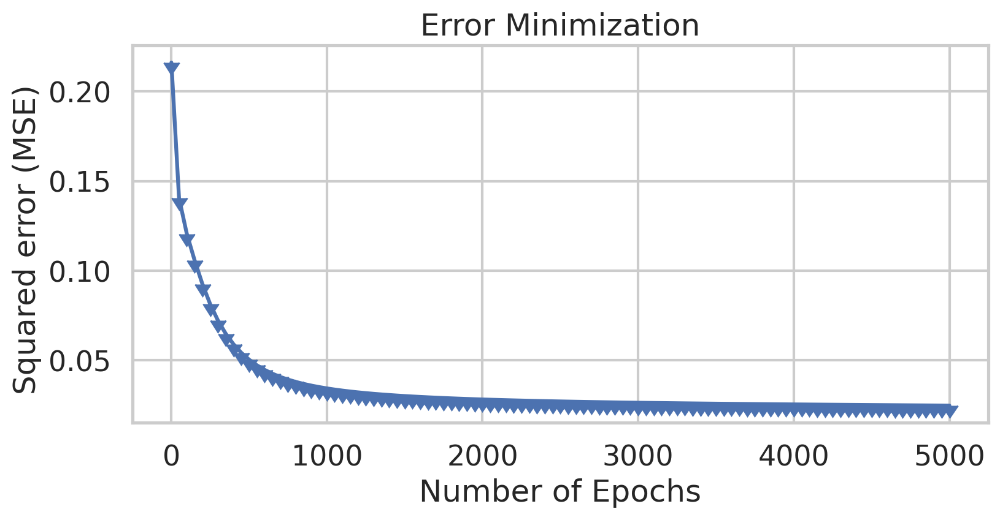

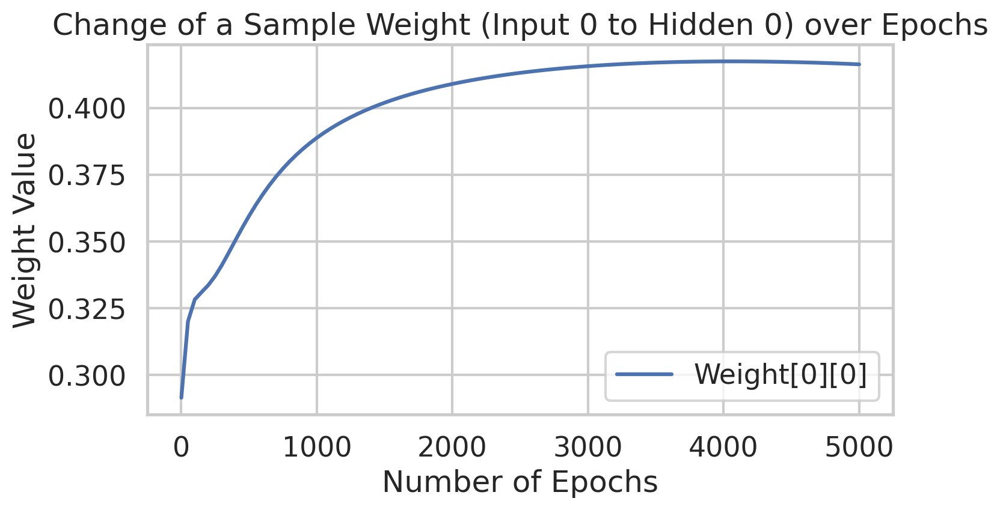

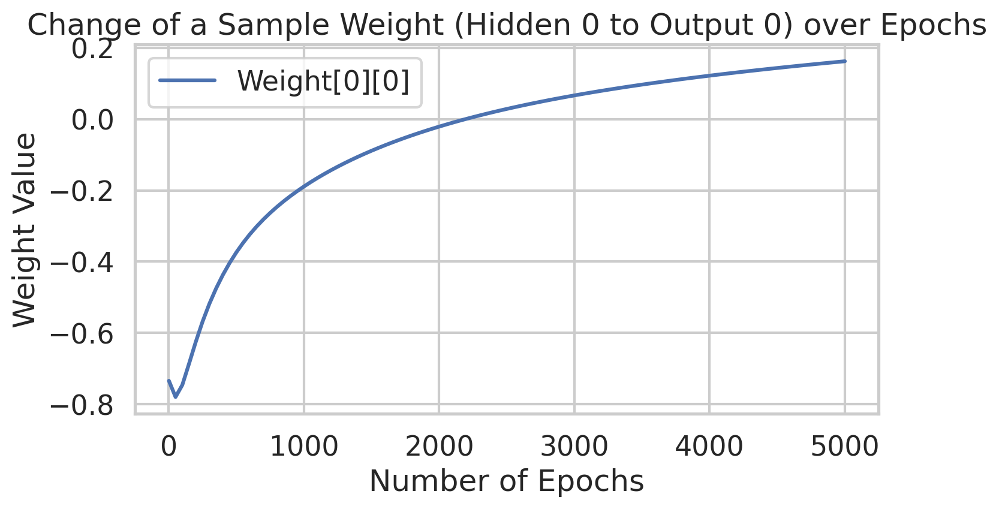

Overall accuracy: 76.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 33.33%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 76.67% hits and 23.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 3 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 80.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 42.42%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 80.00% hits and 20.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 14 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.005
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2962324626759201
Epoch  50 - Total Error:  0.07965289446596407
Epoch  100 - Total Error:  0.050986870591771406
Epoch  150 - Total Error:  0.03888997512556328
Epoch  200 - Total Error:  0.033580774522378065
Epoch  250 - Total Error:  0.030889

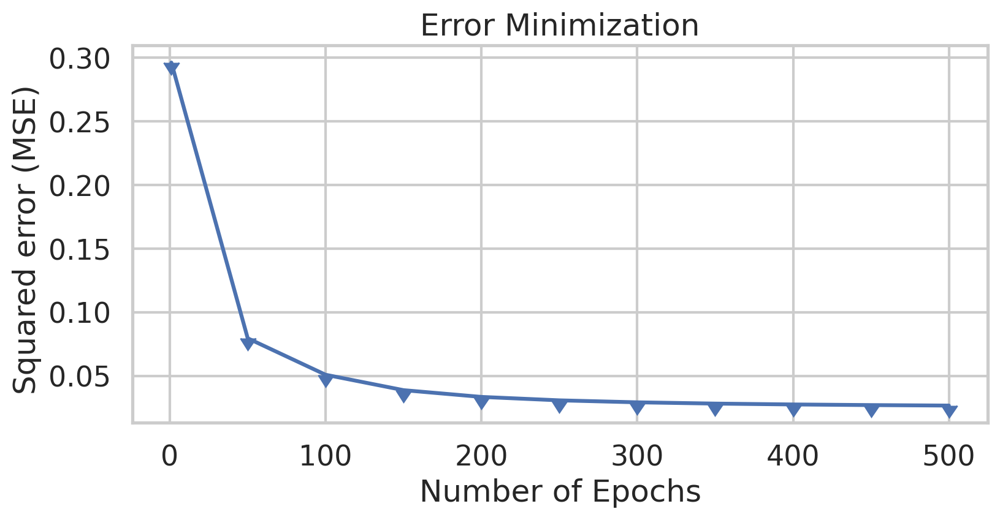

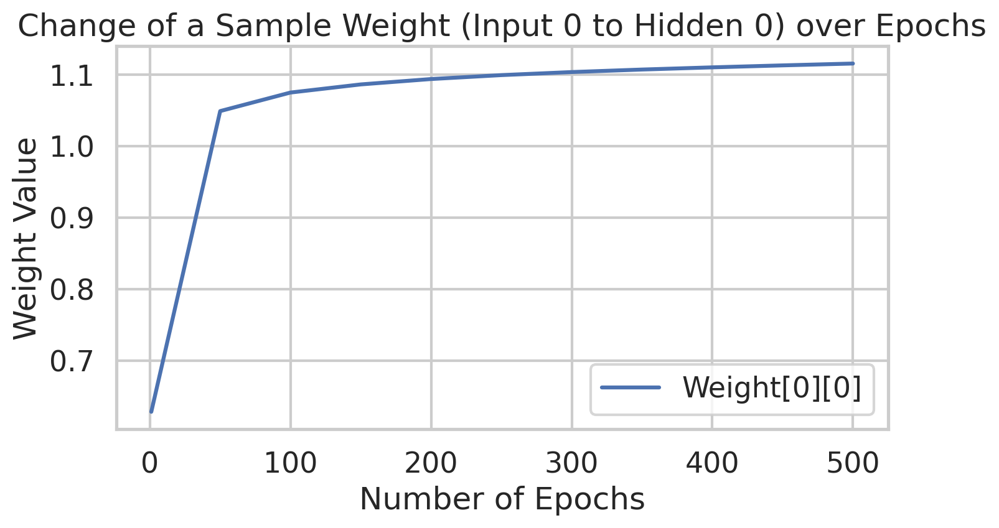

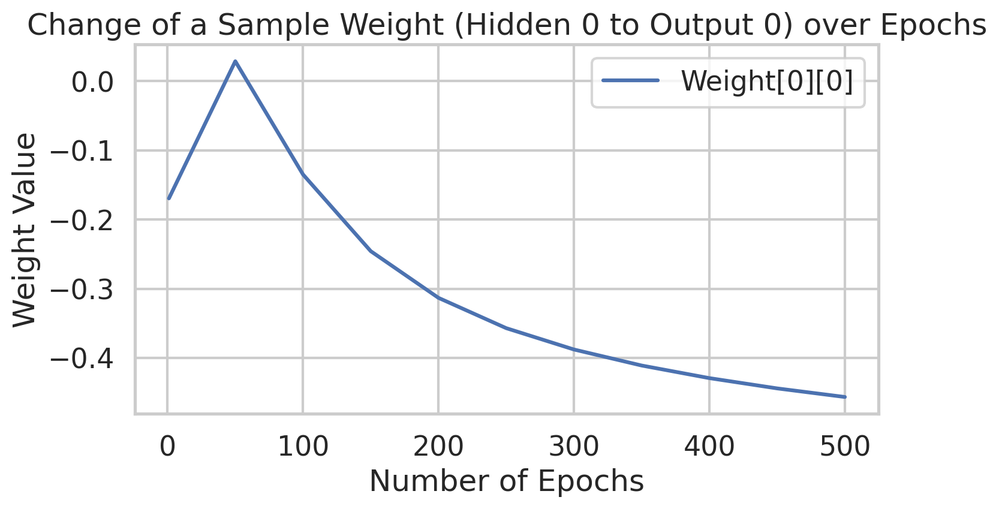

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.005
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.16478607660034594
Epoch  50 - Total Error:  0.1319792560102592
Epoch  100 - Total Error:  0.08198050897479146
Epoch  150 - Total Error:  0.05099054812560698
Epoch  200 - Total Error:  0.038916640794182174
Epoch  250 - Total Error:  0.033652

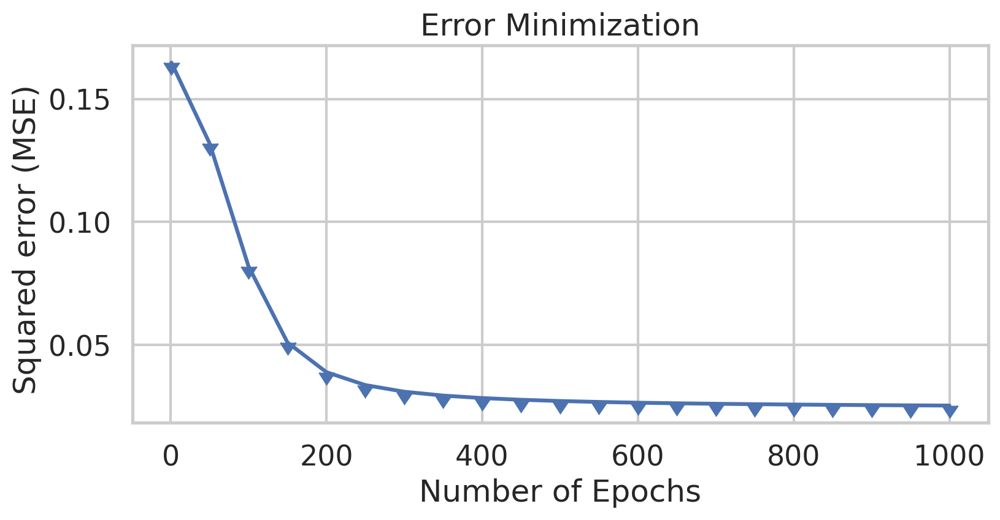

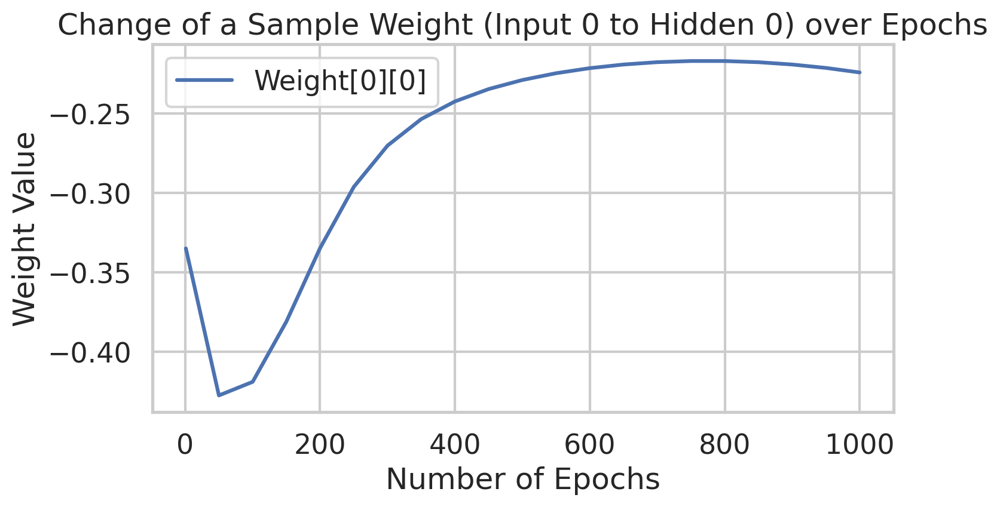

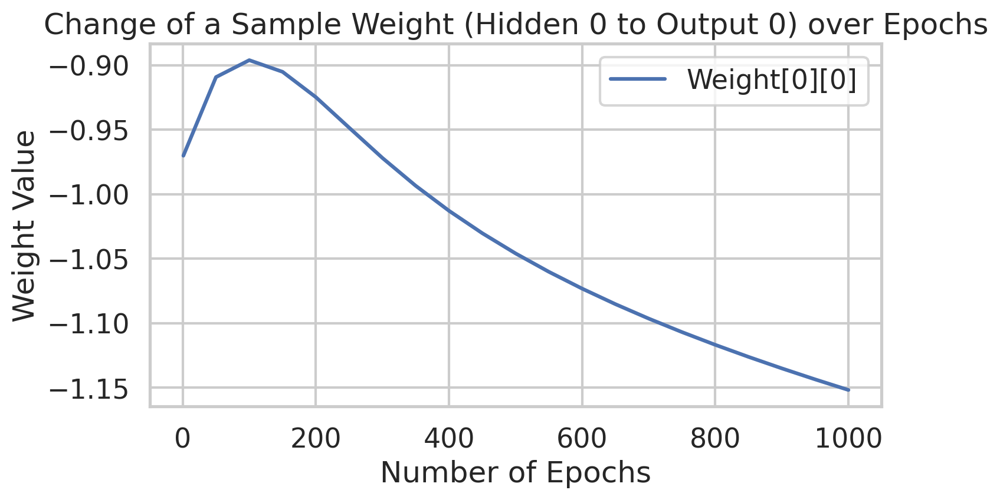

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.005
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2141119133652038
Epoch  50 - Total Error:  0.07105538801544352
Epoch  100 - Total Error:  0.04447023757726418
Epoch  150 - Total Error:  0.03520613216887299
Epoch  200 - Total Error:  0.031294959875418776
Epoch  250 - Total Error:  0.029289

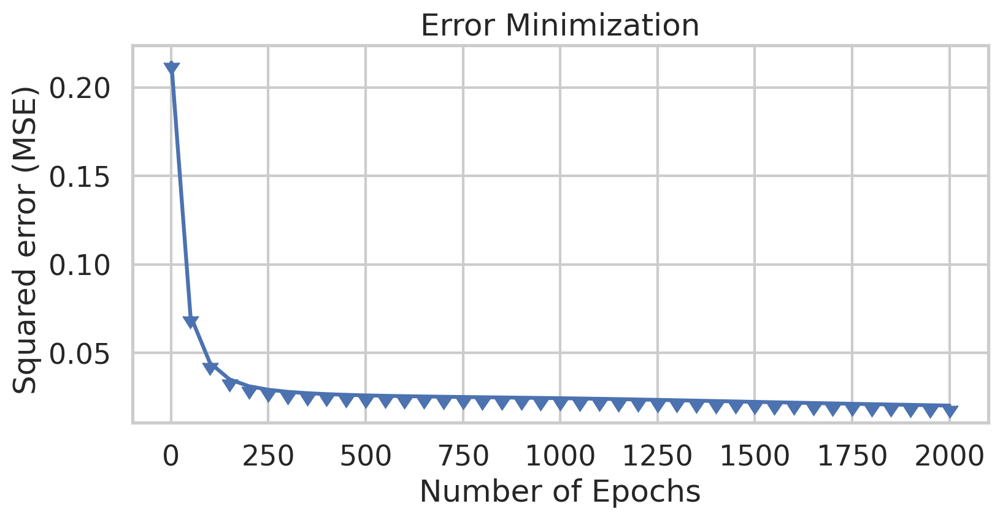

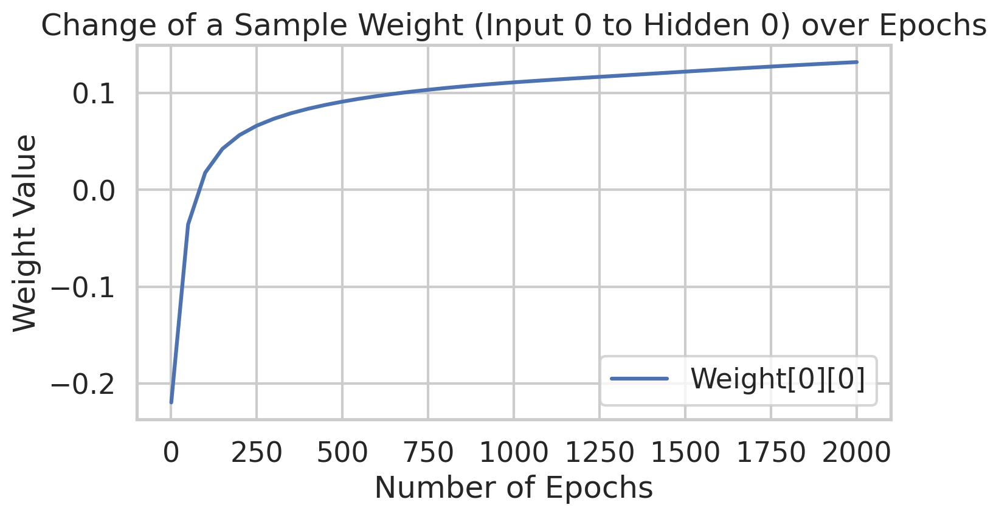

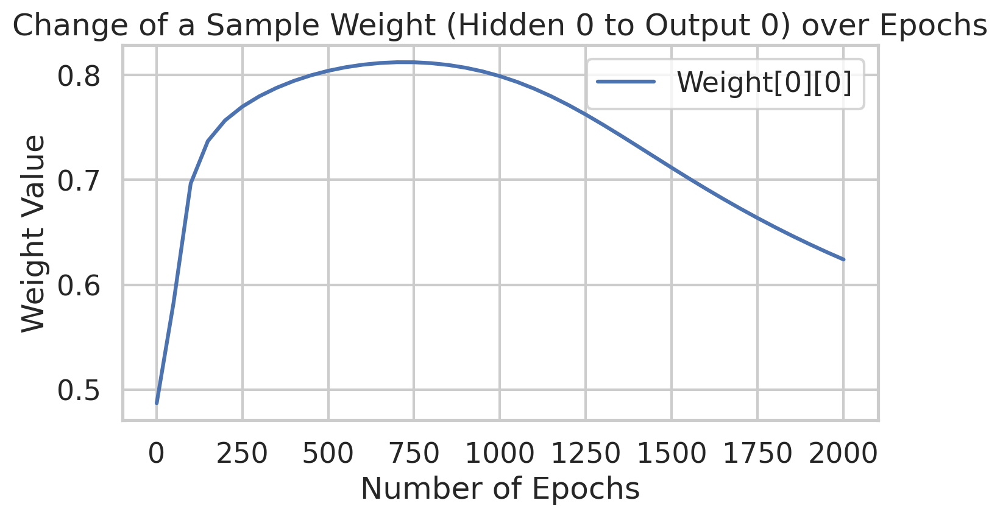

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.005
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2648062962763226
Epoch  50 - Total Error:  0.10455660038816814
Epoch  100 - Total Error:  0.05841038929052489
Epoch  150 - Total Error:  0.041650155765700664
Epoch  200 - Total Error:  0.03511223719662749
Epoch  250 - Total Error:  0.031964

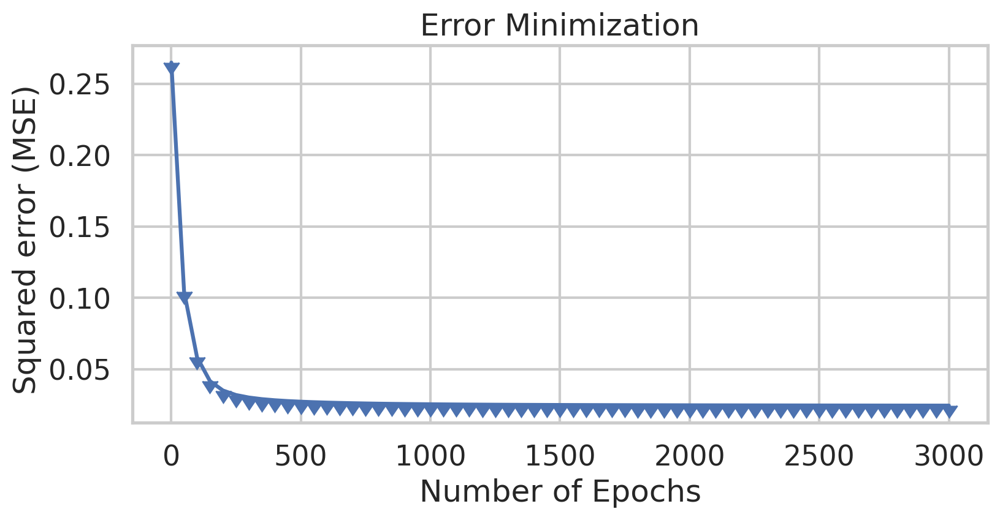

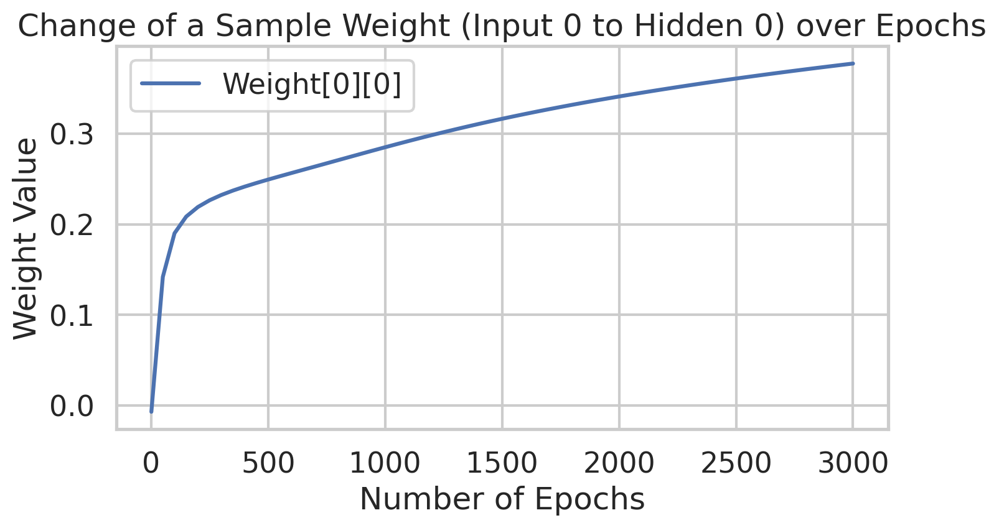

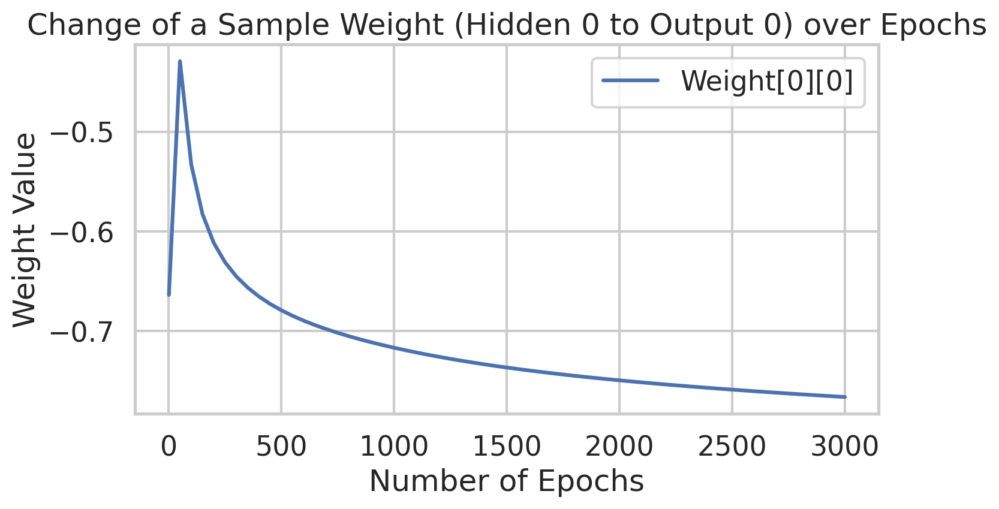

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.005
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3362316253929844
Epoch  50 - Total Error:  0.1575216091468586
Epoch  100 - Total Error:  0.1387065719929649
Epoch  150 - Total Error:  0.10106190833533901
Epoch  200 - Total Error:  0.05585343461365629
Epoch  250 - Total Error:  0.039897035

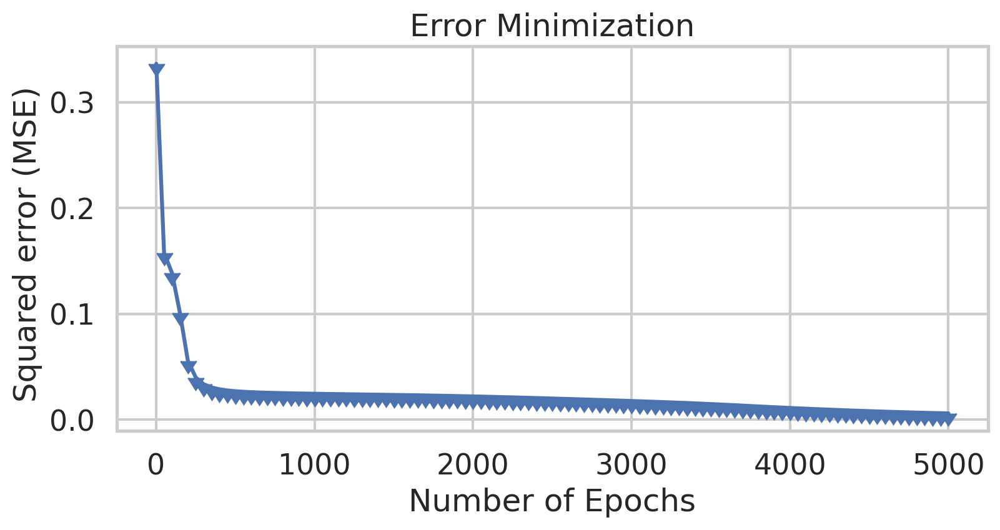

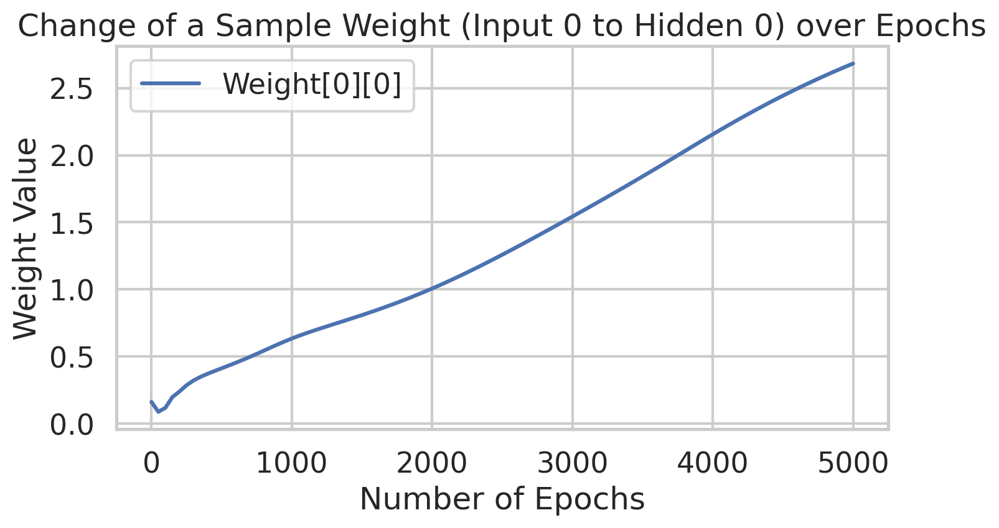

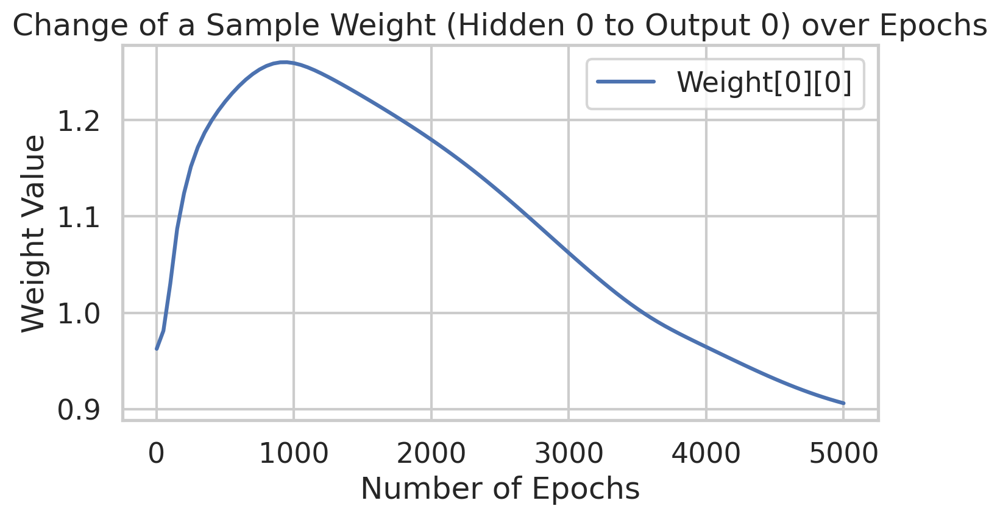

Overall accuracy: 100.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 100.00% hits and 0.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 100.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 100.00% hits and 0.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.01
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.17104227010018141
Epoch  50 - Total Error:  0.09406024540035578
Epoch  100 - Total Error:  0.052905517315292014
Epoch  150 - Total Error:  0.03960409473375966
Epoch  200 - Total Error:  0.033891663977800815
Epoch  250 - Total Error:  

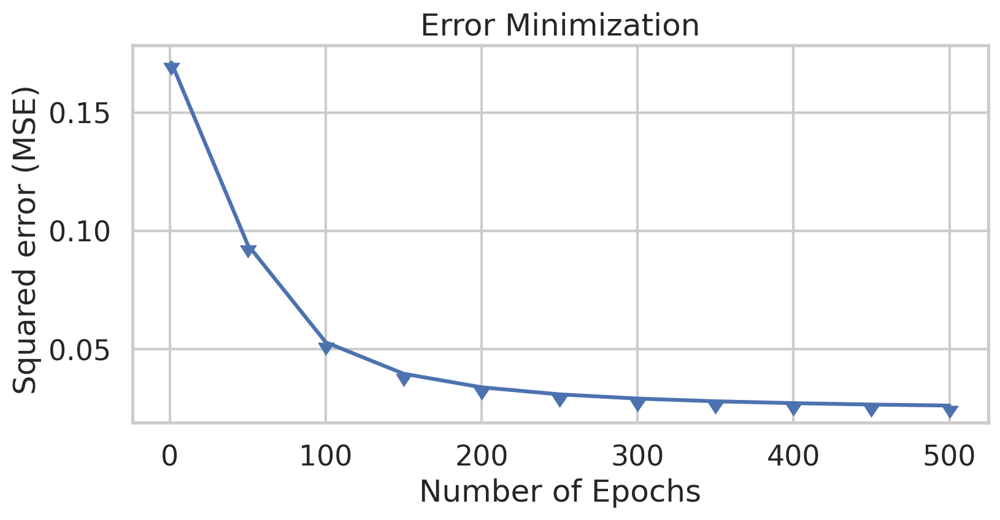

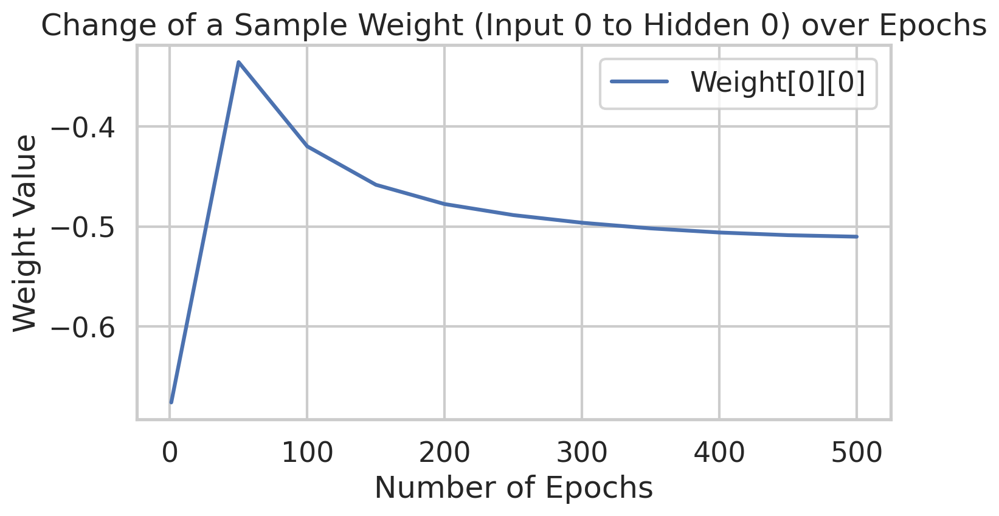

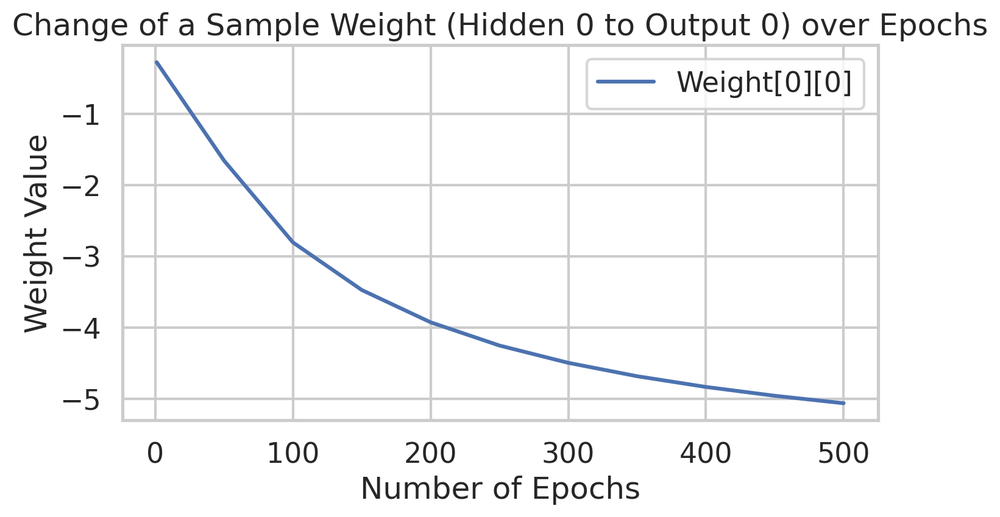

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.01
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.18610190875504393
Epoch  50 - Total Error:  0.046940957622902284
Epoch  100 - Total Error:  0.03236035906870332
Epoch  150 - Total Error:  0.028858517027034864
Epoch  200 - Total Error:  0.027392584328404294
Epoch  250 - Total Error:  0.0265

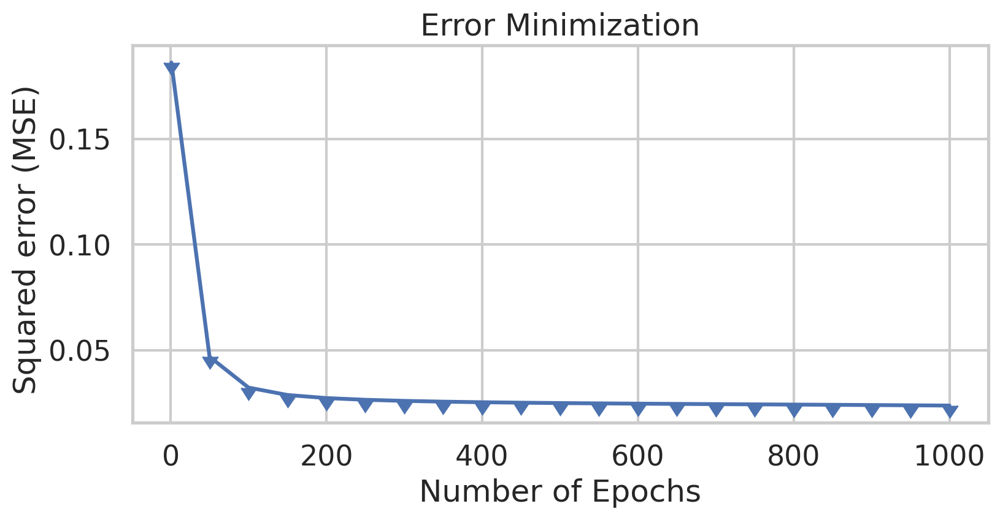

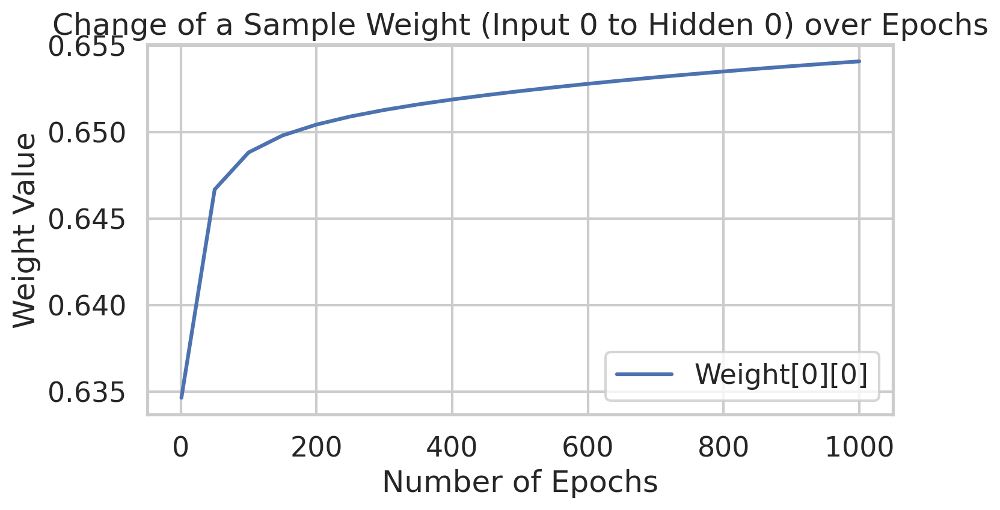

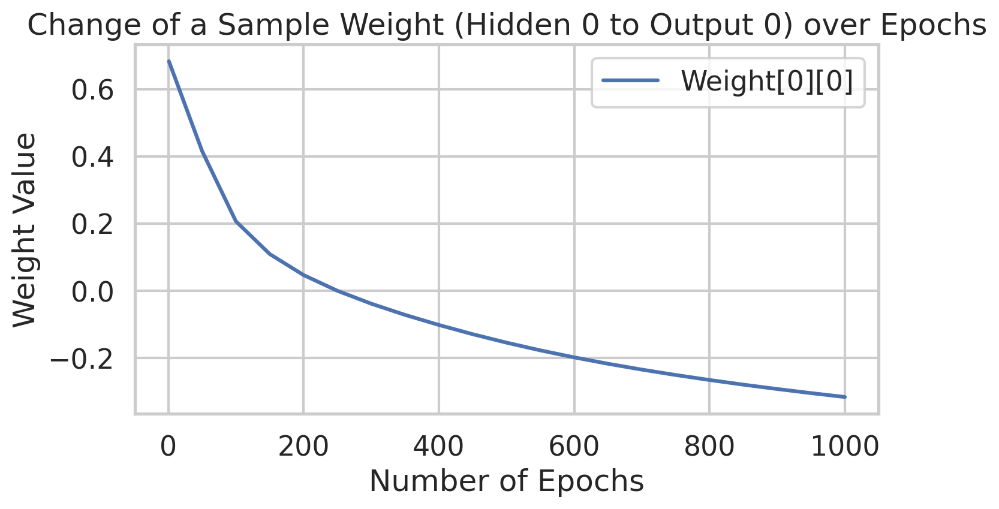

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.01
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.35604787829006396
Epoch  50 - Total Error:  0.06847001377086263
Epoch  100 - Total Error:  0.040046344709280986
Epoch  150 - Total Error:  0.03325023897281257
Epoch  200 - Total Error:  0.030457520544007997
Epoch  250 - Total Error:  0.02891

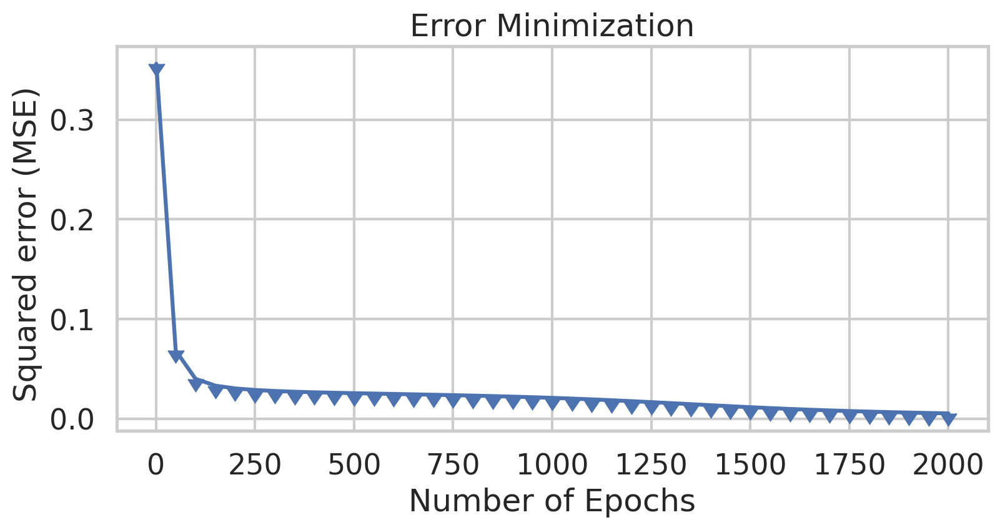

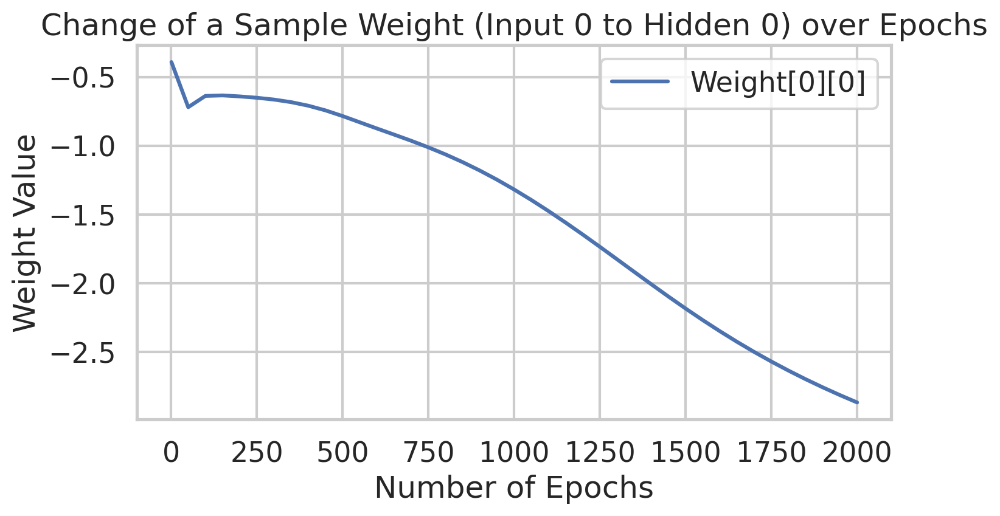

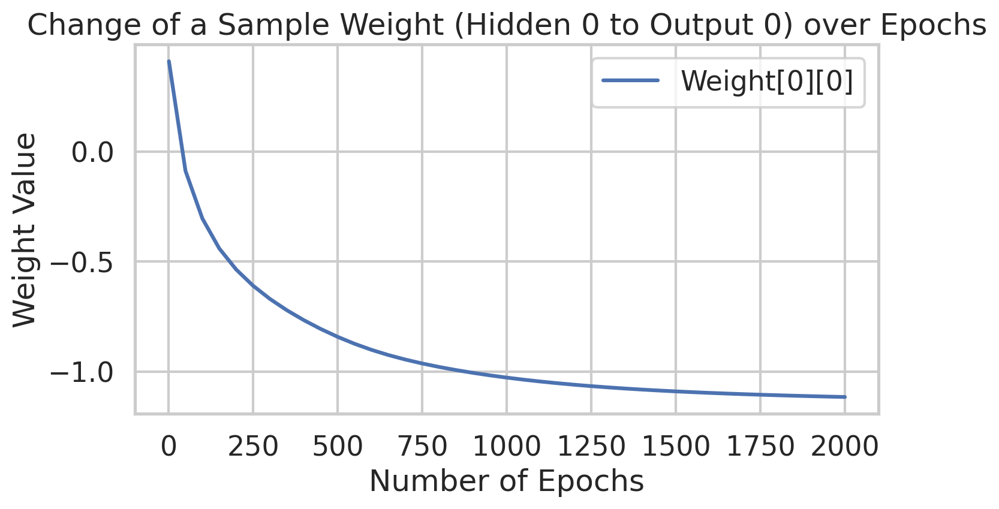

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 96.97%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 32 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.01
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.20092436203588507
Epoch  50 - Total Error:  0.0639165009857568
Epoch  100 - Total Error:  0.035141478981689164
Epoch  150 - Total Error:  0.02969397416277665
Epoch  200 - Total Error:  0.027740254017979086
Epoch  250 - Total Error:  0.0267709

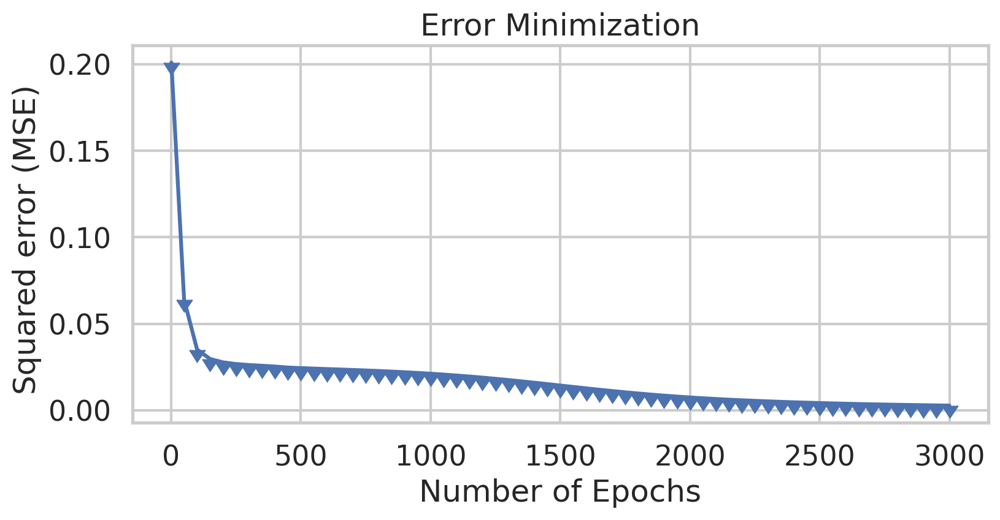

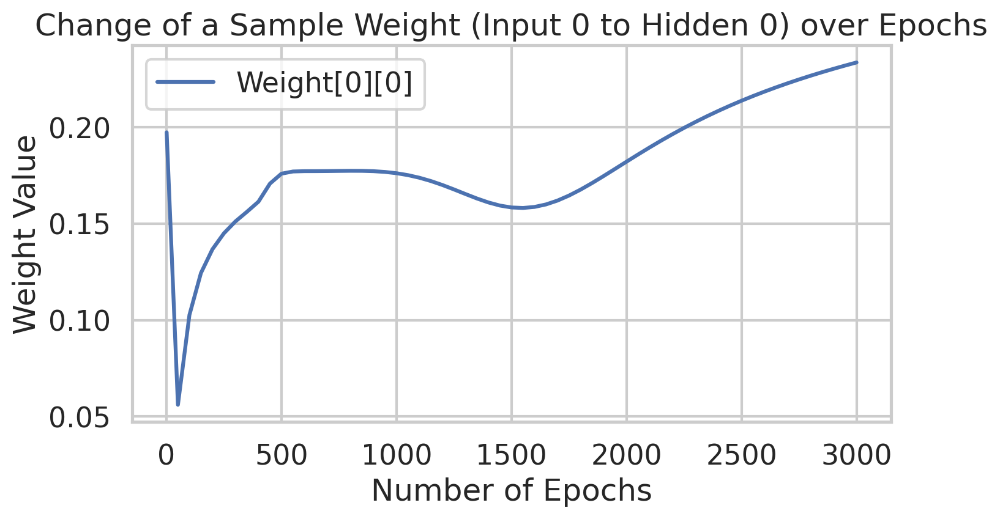

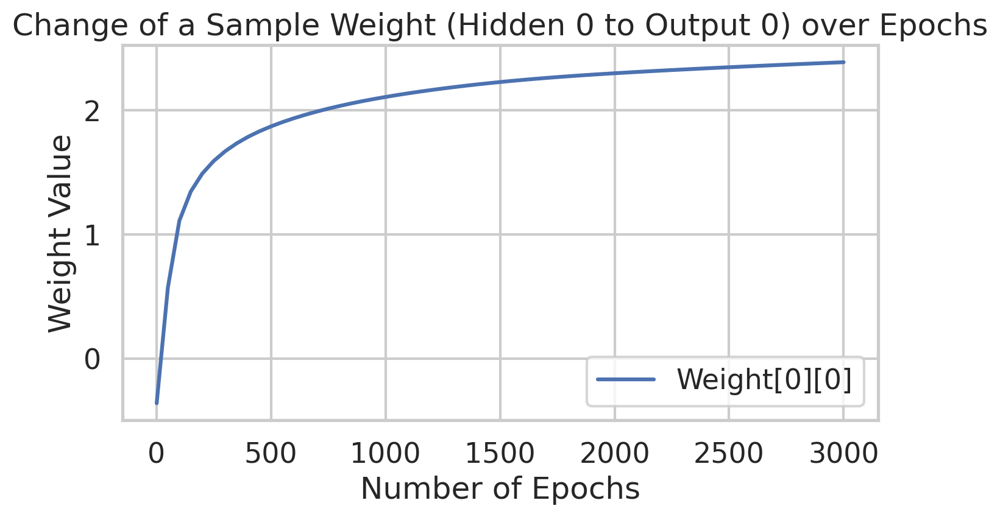

Overall accuracy: 33.33%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 33.33% hits and 66.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 31.67%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 31.67% hits and 68.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.01
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3271946107764686
Epoch  50 - Total Error:  0.04986556976058664
Epoch  100 - Total Error:  0.03257340915892328
Epoch  150 - Total Error:  0.028726975614652015
Epoch  200 - Total Error:  0.027215107075220932
Epoch  250 - Total Error:  0.026424

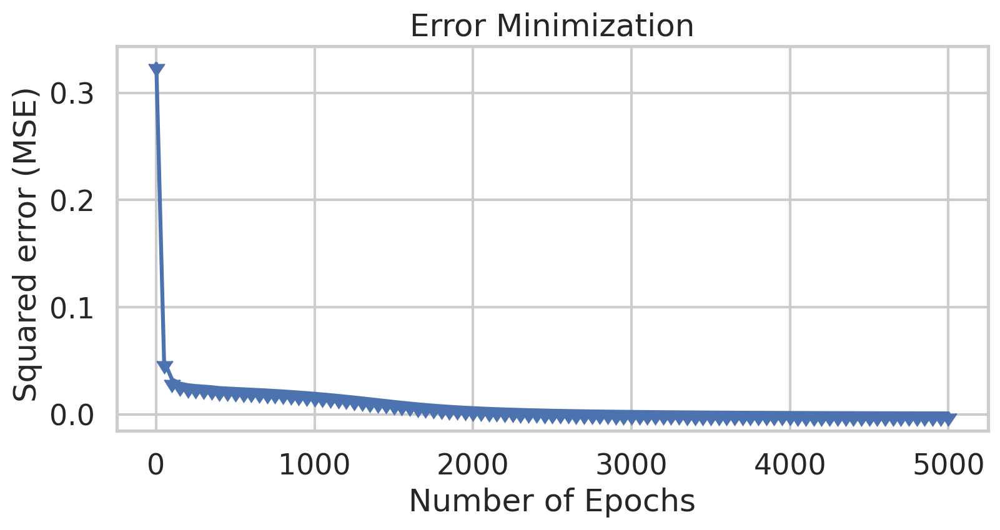

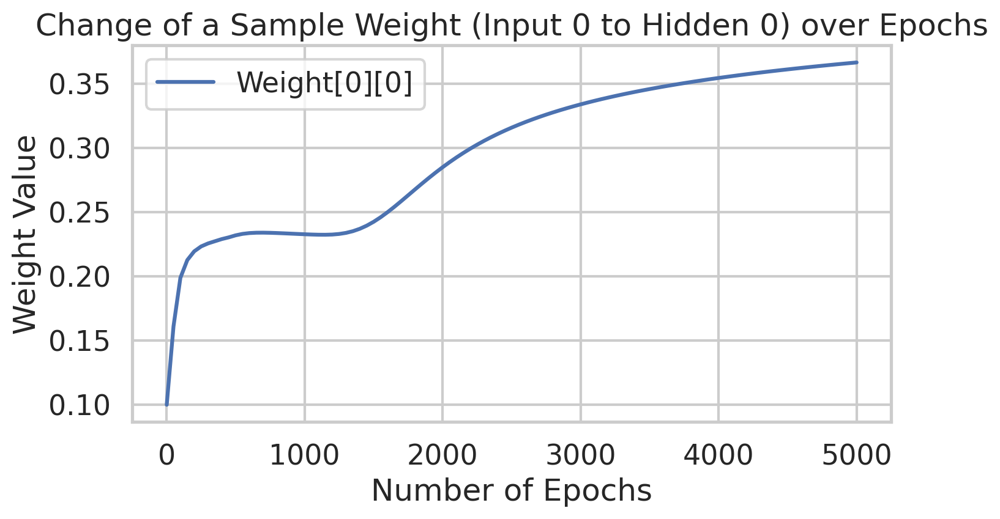

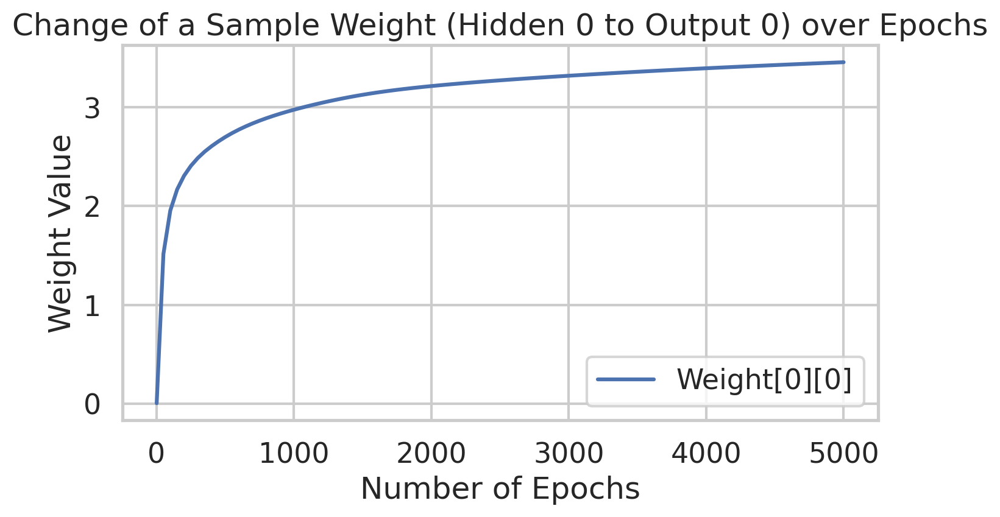

Overall accuracy: 33.33%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 33.33% hits and 66.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 31.67%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 31.67% hits and 68.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.05
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2534683745964868
Epoch  50 - Total Error:  0.026831466376895683
Epoch  100 - Total Error:  0.025205123456181186
Epoch  150 - Total Error:  0.024647382159777336
Epoch  200 - Total Error:  0.02422430409838181
Epoch  250 - Total Error:  0.023694

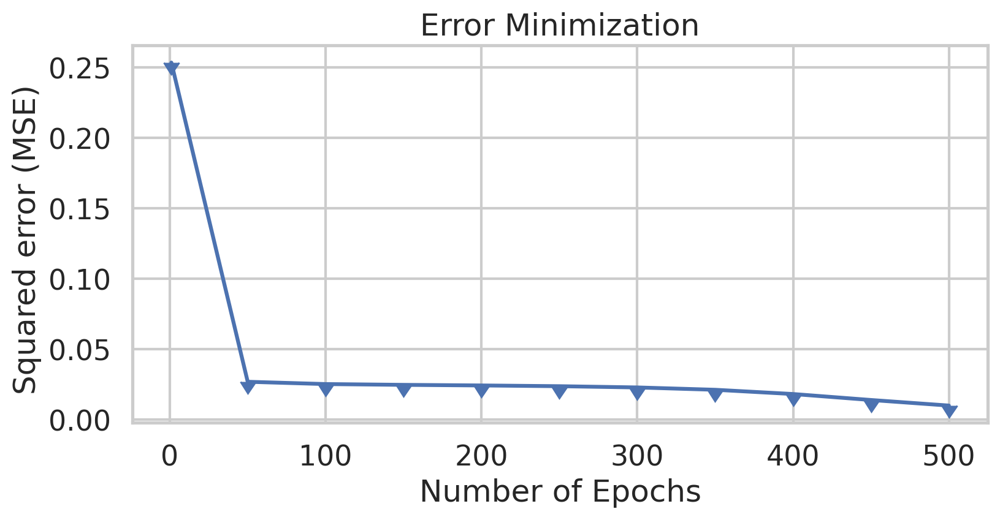

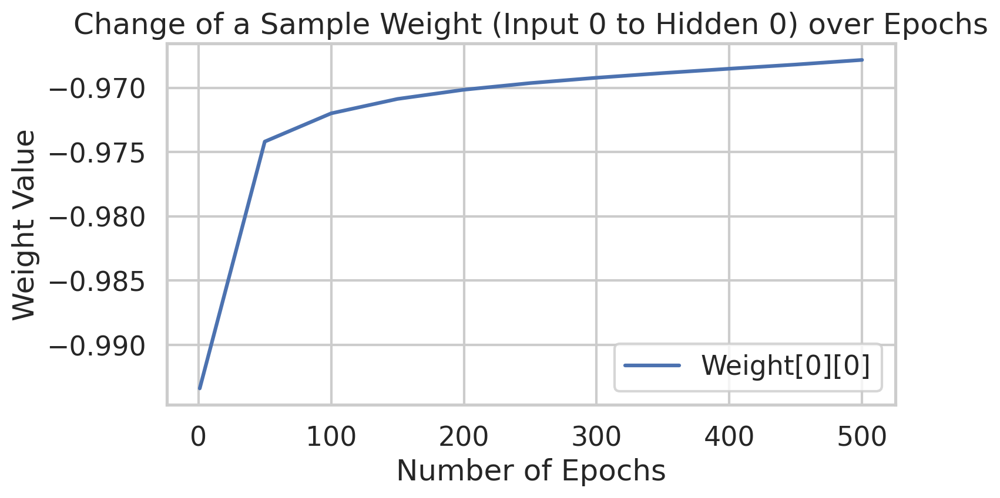

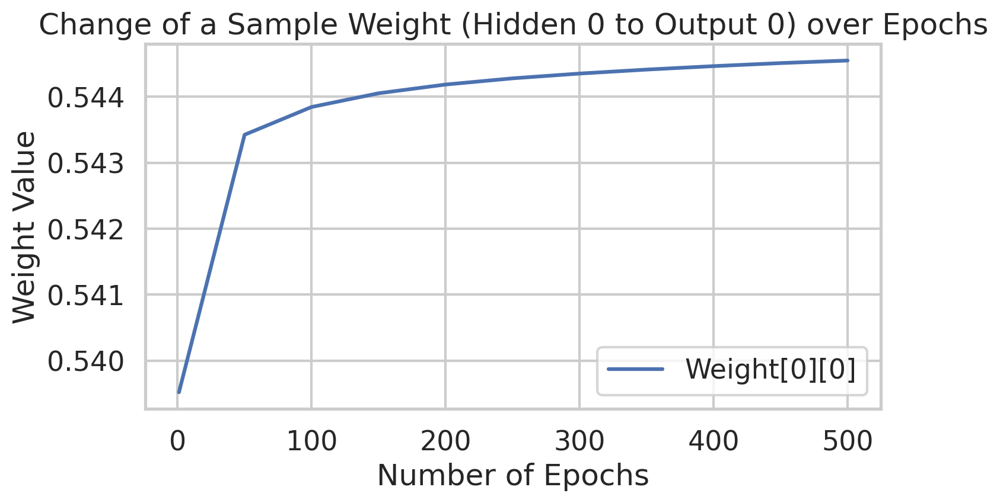

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 97.50%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 40.00%

=== Train Results ===
Porcents : 97.50% hits and 2.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 2 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.05
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.19785182652849664
Epoch  50 - Total Error:  0.031895229627368224
Epoch  100 - Total Error:  0.02783255423565589
Epoch  150 - Total Error:  0.026589384650156884
Epoch  200 - Total Error:  0.025897938492584052
Epoch  250 - Total Error:  0.025

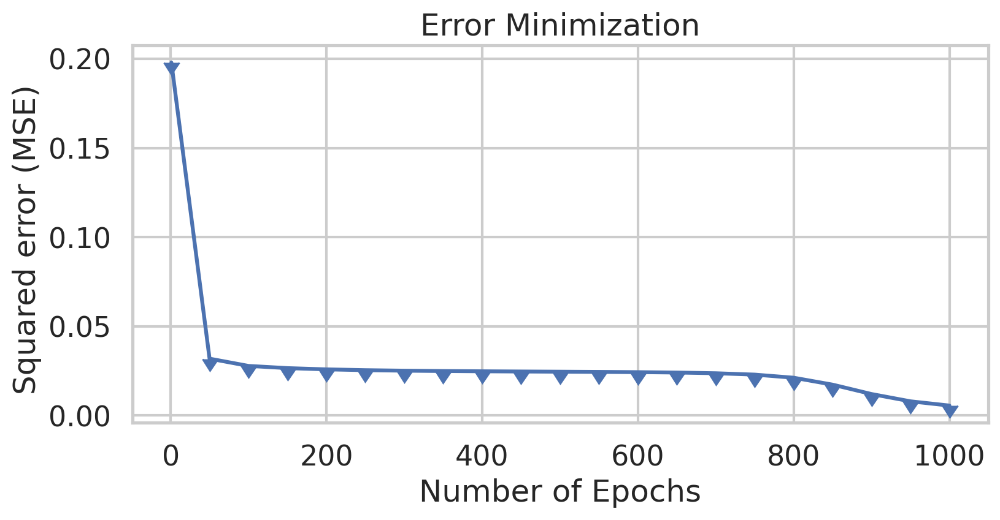

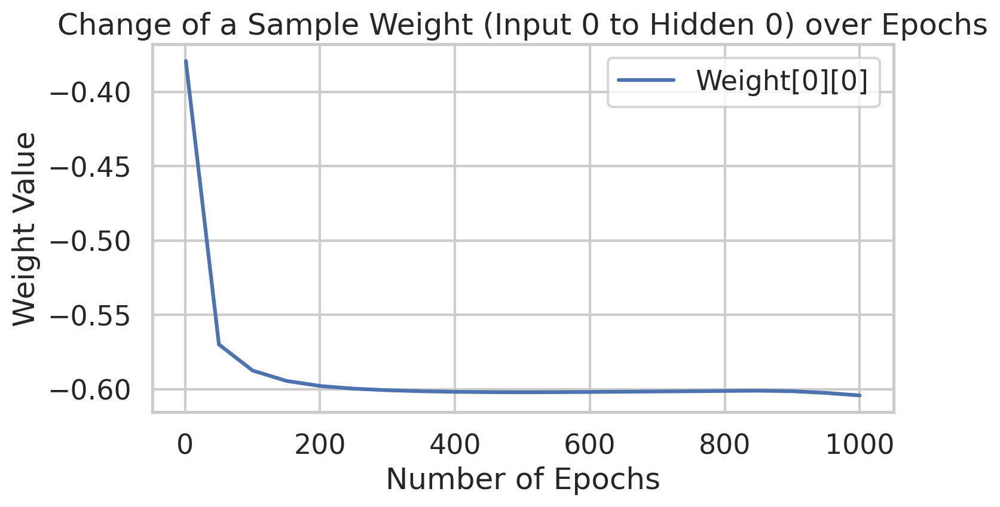

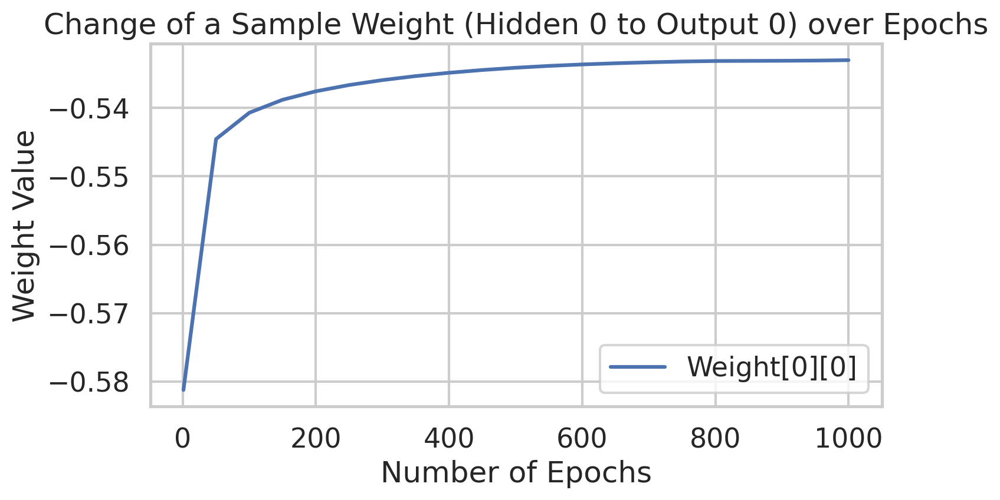

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.00%
 - Accuracy Setosa: 98.78%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 81 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.05
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2514376691257337
Epoch  50 - Total Error:  0.03284759825899884
Epoch  100 - Total Error:  0.028017157118546323
Epoch  150 - Total Error:  0.026575823970793264
Epoch  200 - Total Error:  0.025725766568049292
Epoch  250 - Total Error:  0.025214

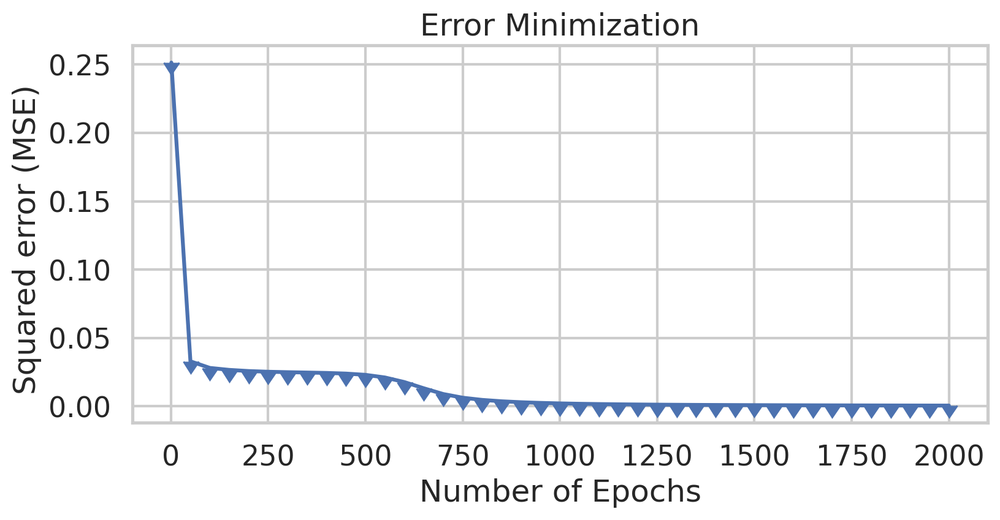

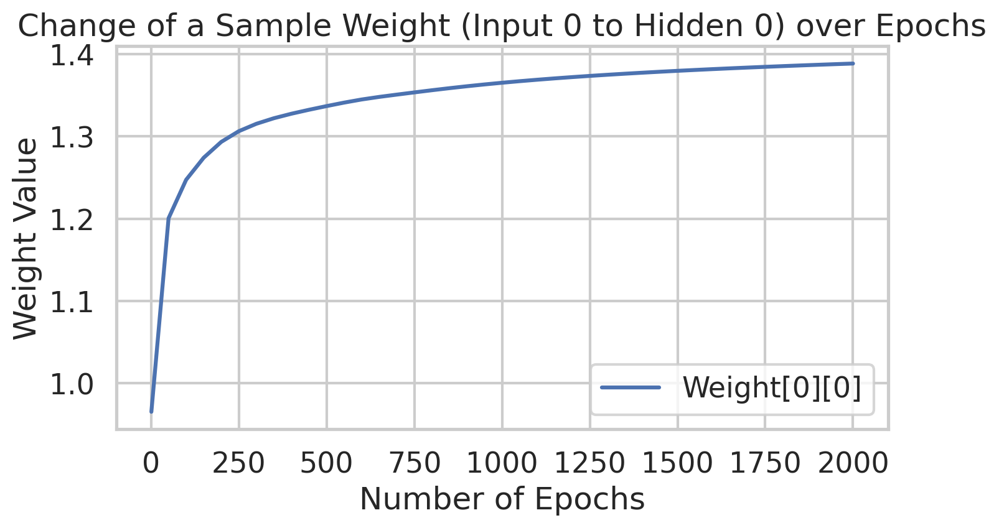

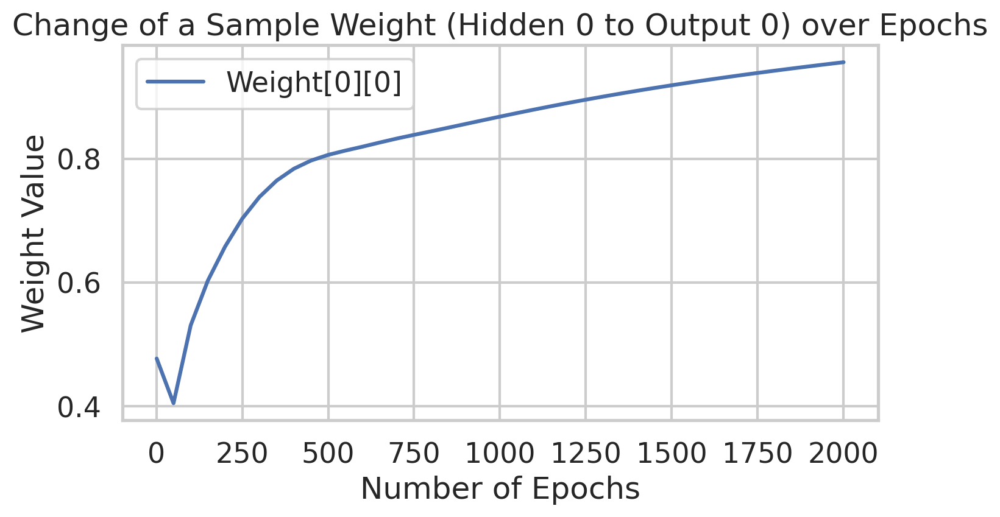

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.00%
 - Accuracy Setosa: 98.78%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 81 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.05
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2086765995140765
Epoch  50 - Total Error:  0.02704356058510574
Epoch  100 - Total Error:  0.025408179761049574
Epoch  150 - Total Error:  0.024964973904944034
Epoch  200 - Total Error:  0.0247567353445853
Epoch  250 - Total Error:  0.02463436

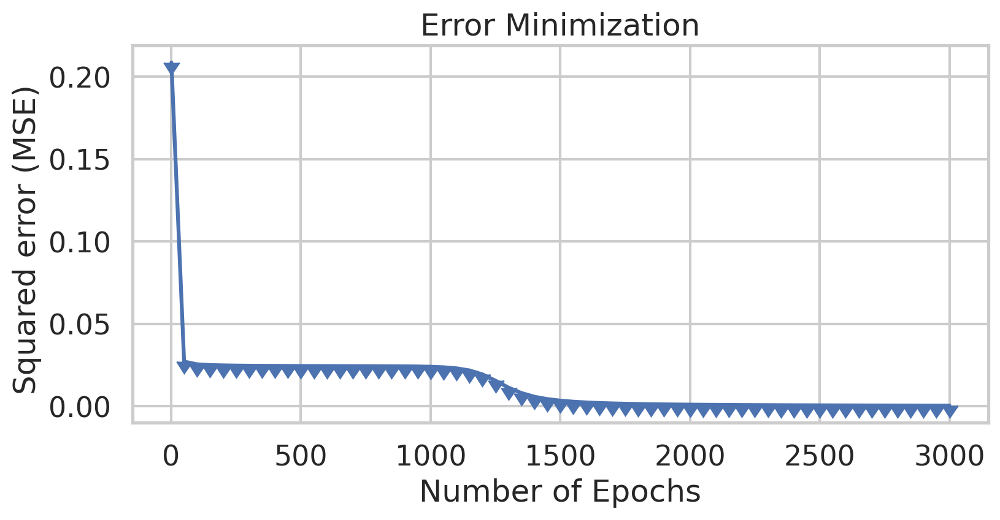

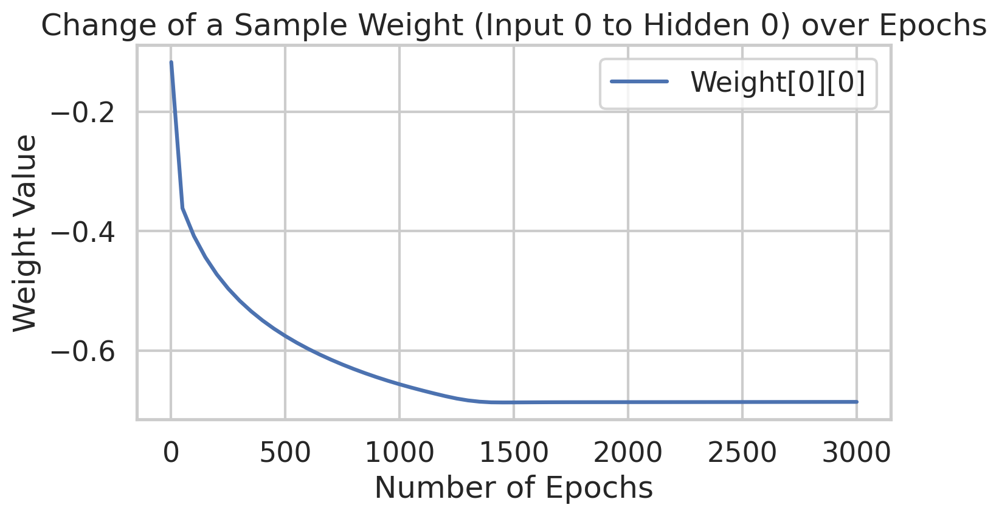

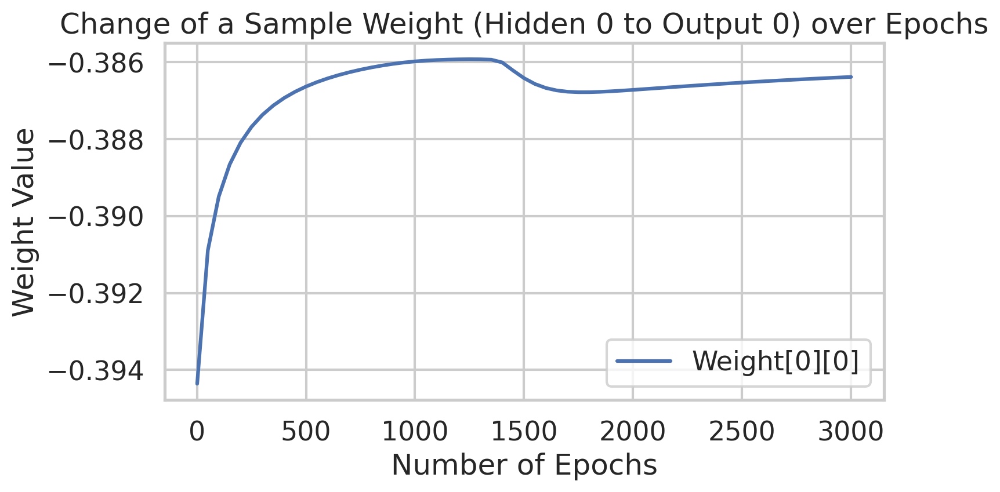

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 29.17%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 40.00%

=== Train Results ===
Porcents : 29.17% hits and 70.83% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 2 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.05
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.18697966989307305
Epoch  50 - Total Error:  0.026382036832044476
Epoch  100 - Total Error:  0.024984840318604824
Epoch  150 - Total Error:  0.02420216660605544
Epoch  200 - Total Error:  0.0231897496541939
Epoch  250 - Total Error:  0.021523874

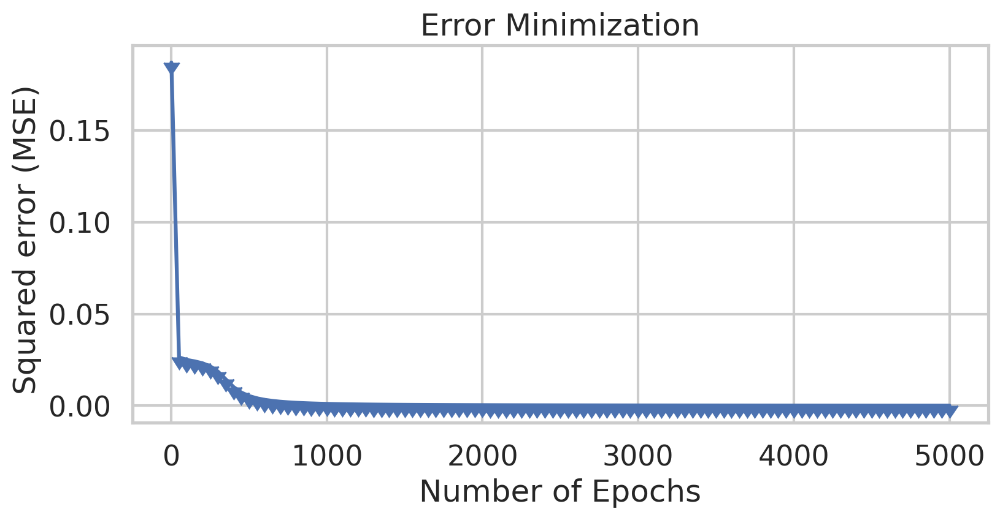

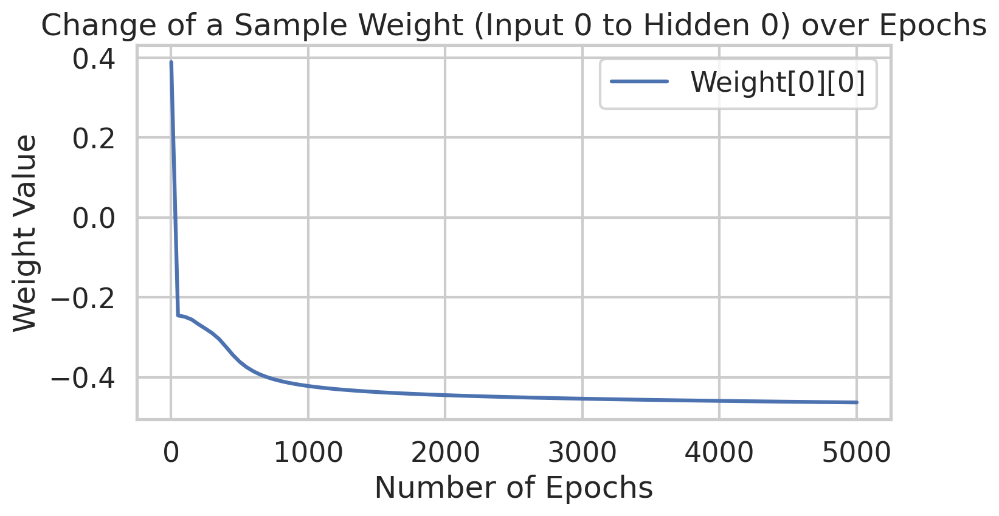

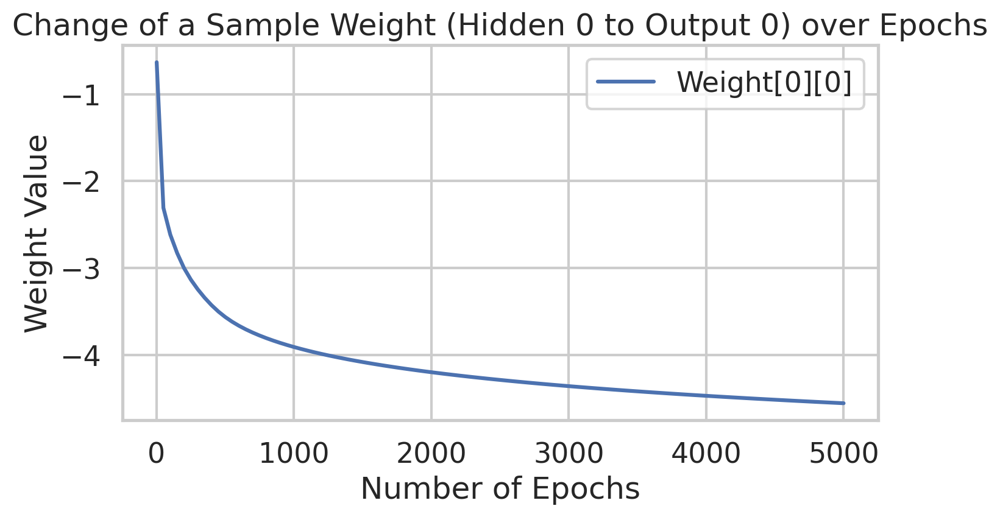

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 88.89%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 8 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 31.67%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 31.67% hits and 68.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.1
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.15781782739976308
Epoch  50 - Total Error:  0.02544217748929283
Epoch  100 - Total Error:  0.024809850498902507
Epoch  150 - Total Error:  0.024554861786113397
Epoch  200 - Total Error:  0.02220813660115804
Epoch  250 - Total Error:  0.01785390

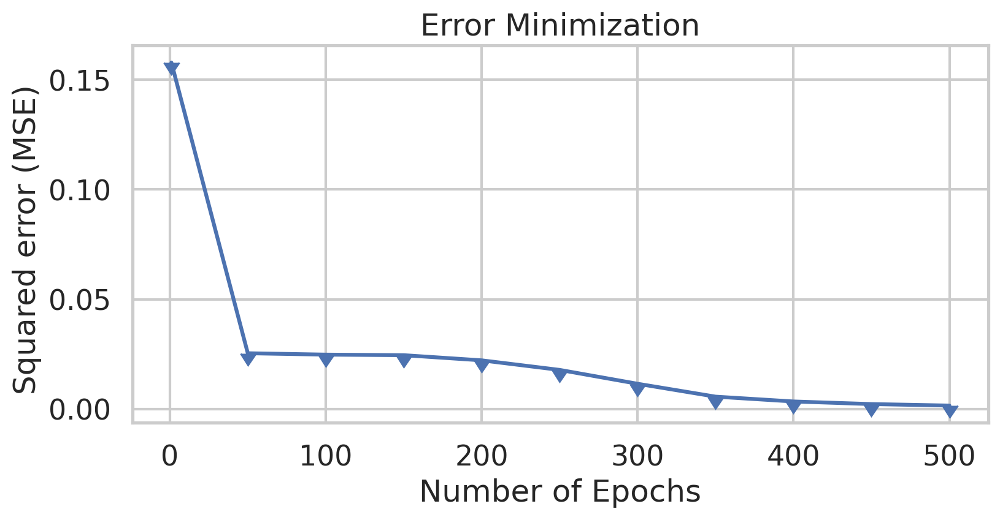

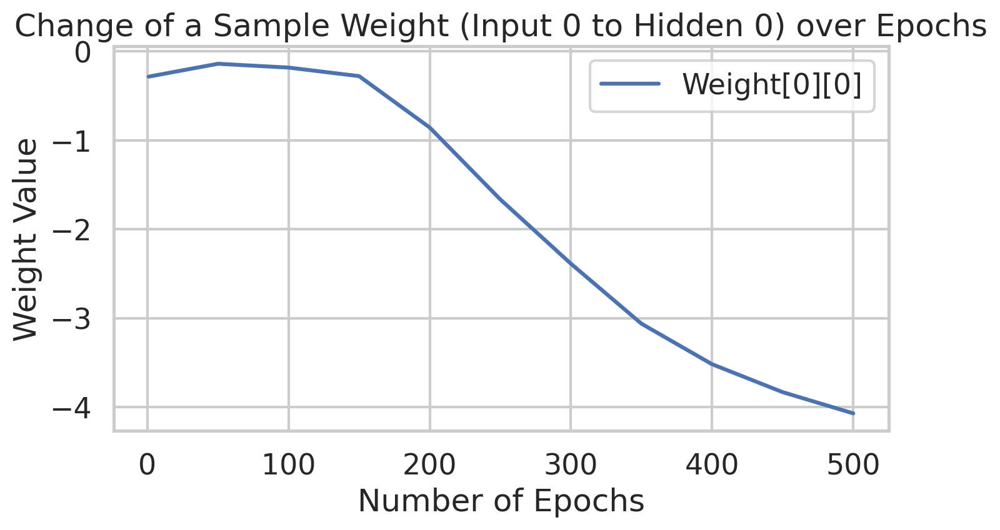

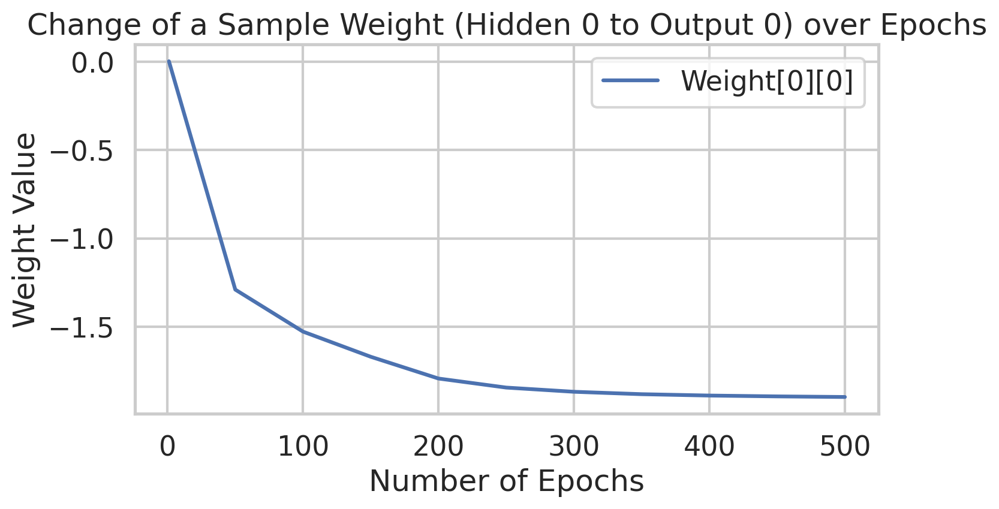

Overall accuracy: 60.00%
 - Accuracy Setosa: 45.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 60.00% hits and 40.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 9 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 56.67%
 - Accuracy Setosa: 42.68%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 56.67% hits and 43.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 35 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.1
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.20938652644030614
Epoch  50 - Total Error:  0.025839998152993527
Epoch  100 - Total Error:  0.024718634102438183
Epoch  150 - Total Error:  0.023301882280721626
Epoch  200 - Total Error:  0.017933020948177288
Epoch  250 - Total Error:  0.00871

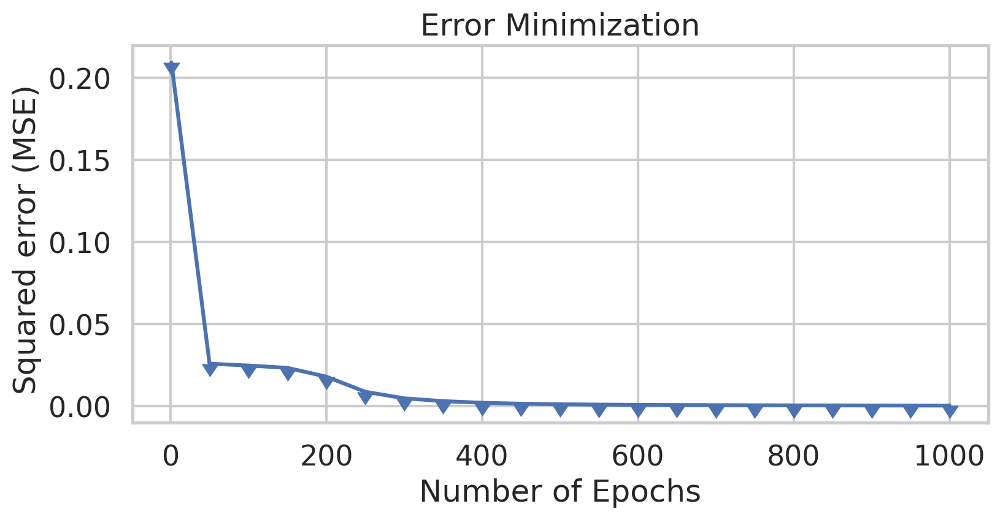

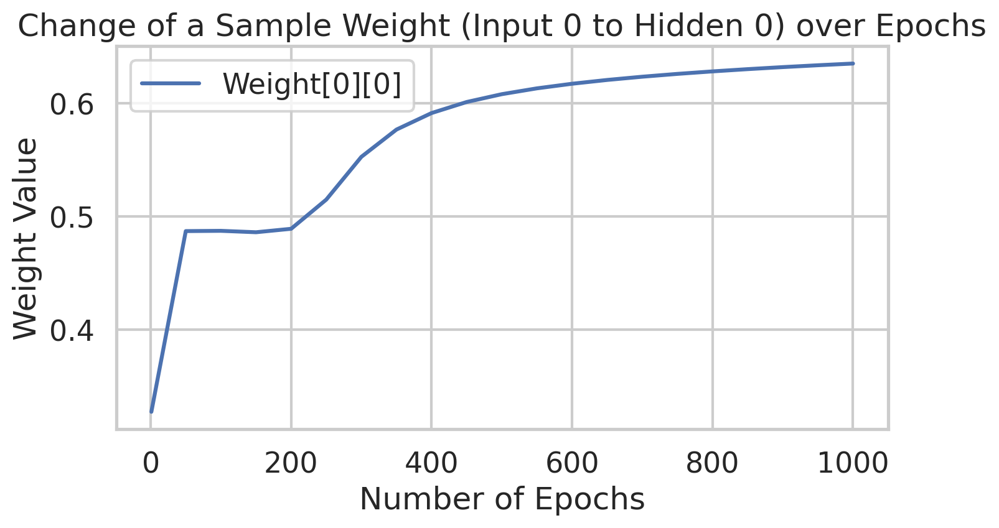

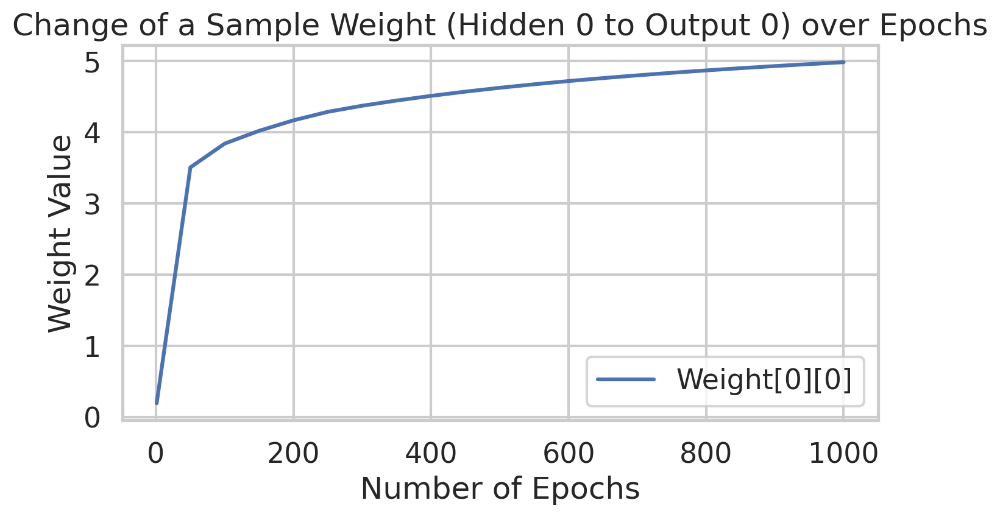

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 27.50%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 27.50% hits and 72.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.1
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.1696123754242113
Epoch  50 - Total Error:  0.026996399471903305
Epoch  100 - Total Error:  0.025227396212780768
Epoch  150 - Total Error:  0.024856701308266876
Epoch  200 - Total Error:  0.02469689321446158
Epoch  250 - Total Error:  0.0246067216

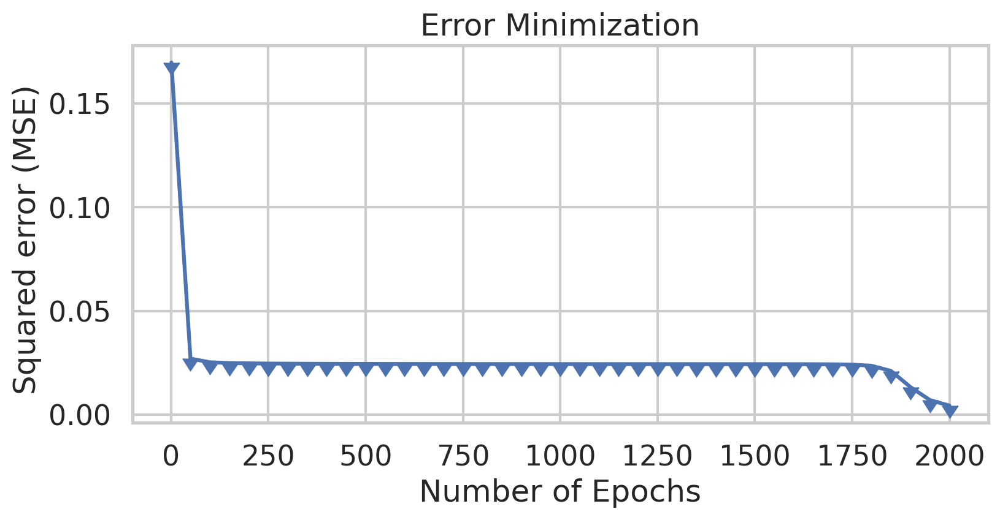

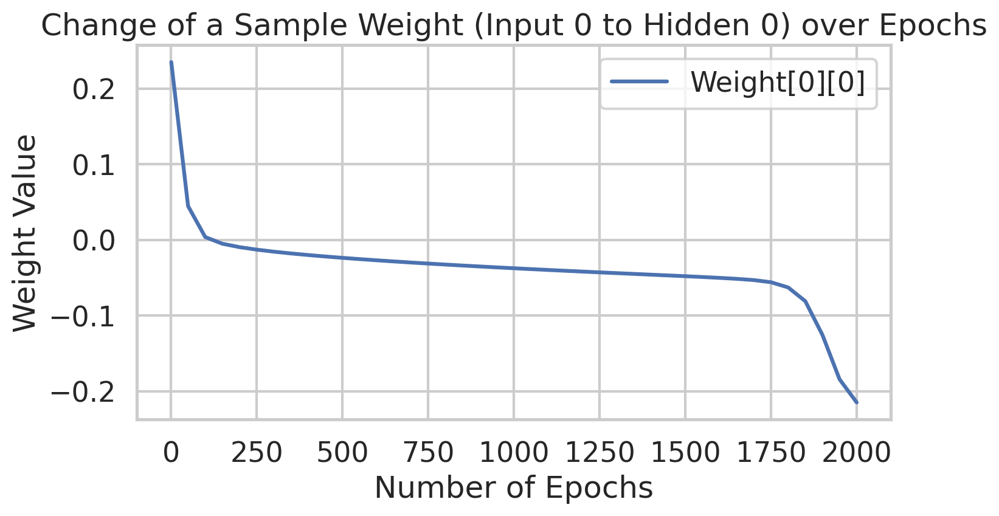

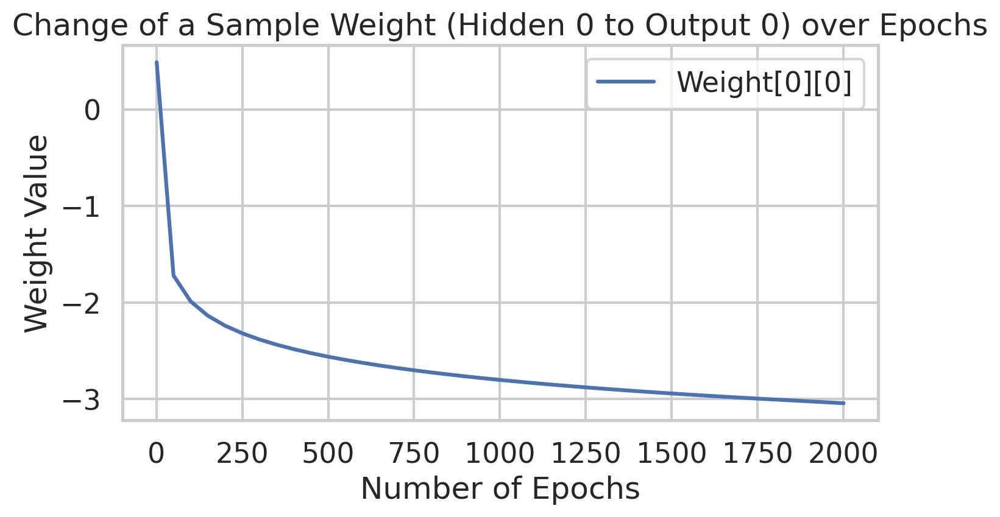

Overall accuracy: 76.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 22.22%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 76.67% hits and 23.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 2 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 85.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 48.48%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 85.83% hits and 14.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 16 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.1
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.17311672361216093
Epoch  50 - Total Error:  0.025481143060624357
Epoch  100 - Total Error:  0.024816276272932678
Epoch  150 - Total Error:  0.024612590378341473
Epoch  200 - Total Error:  0.024507371780452737
Epoch  250 - Total Error:  0.

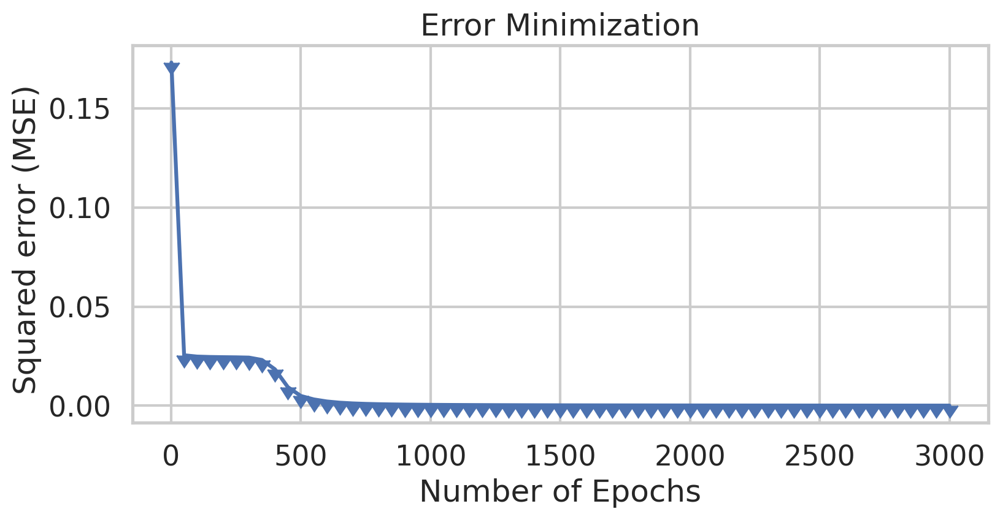

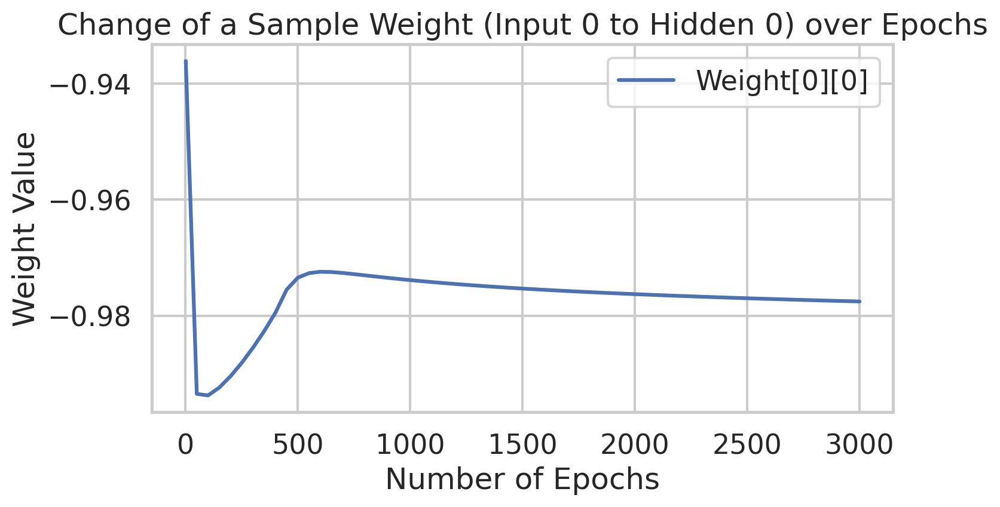

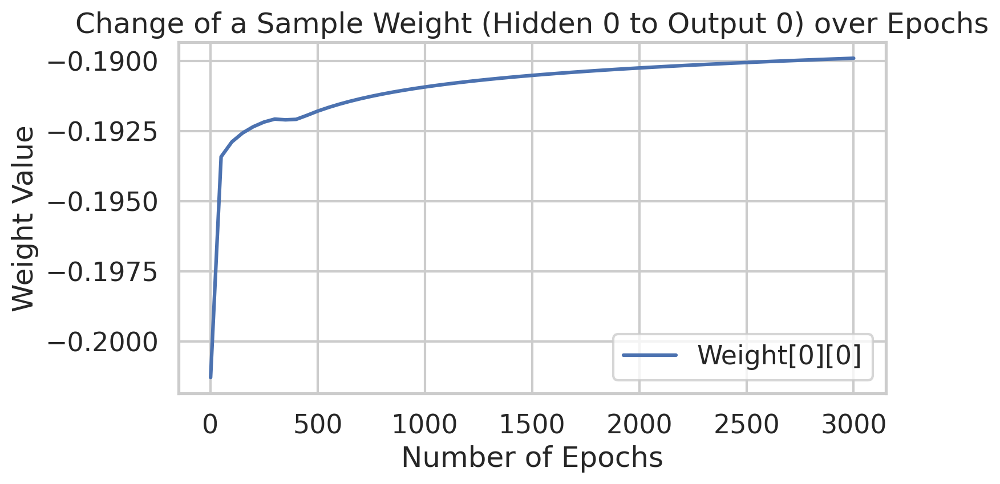

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 27.50%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 27.50% hits and 72.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 7
 - Learning Rate: 0.1
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2124376894702084
Epoch  50 - Total Error:  0.02517767846907193
Epoch  100 - Total Error:  0.023616721043638034
Epoch  150 - Total Error:  0.02053182297648571
Epoch  200 - Total Error:  0.01410315164885806
Epoch  250 - Total Error:  0.007876398814

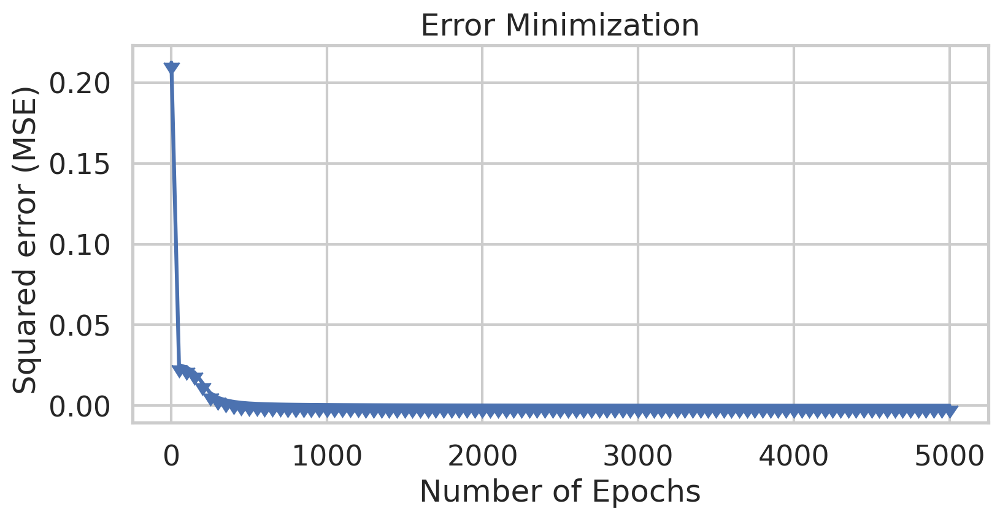

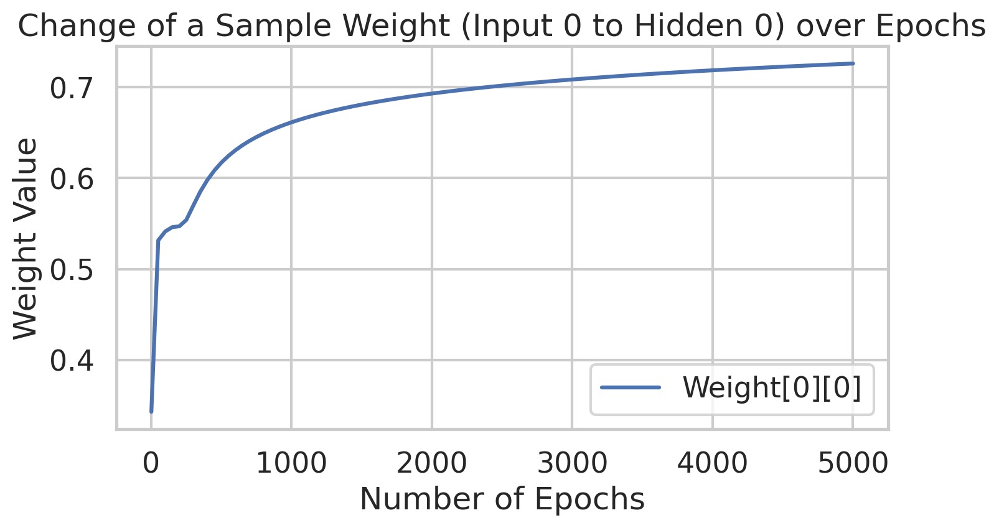

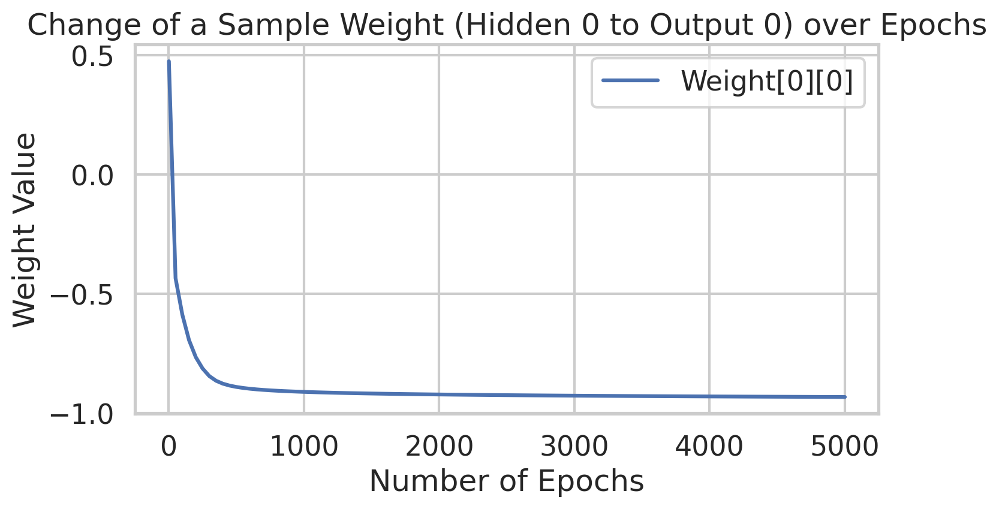

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 88.89%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 8 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 31.67%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 31.67% hits and 68.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.001
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.27201820625160206
Epoch  50 - Total Error:  0.14934988895240187
Epoch  100 - Total Error:  0.13575094097052515
Epoch  150 - Total Error:  0.12435250779354888
Epoch  200 - Total Error:  0.1125136419579471
Epoch  250 - Total Error:  0.101118343

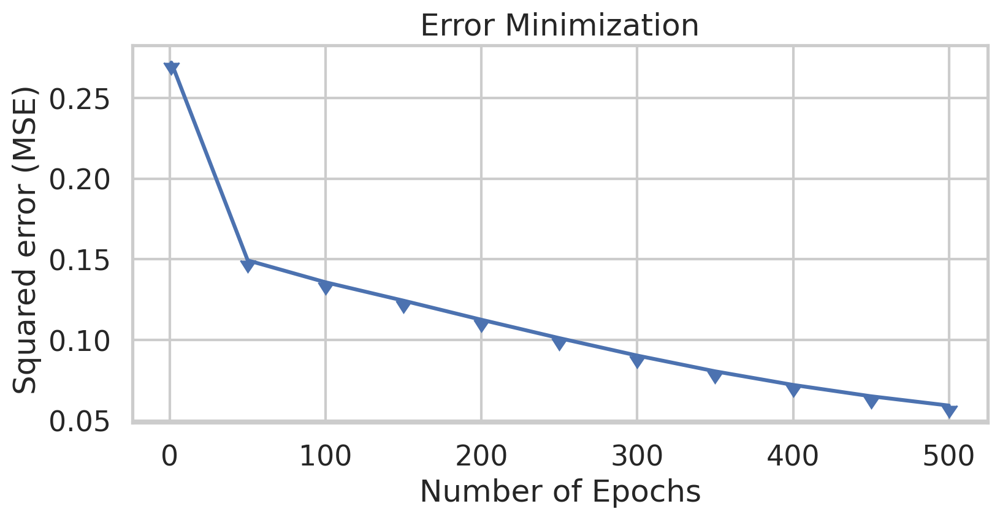

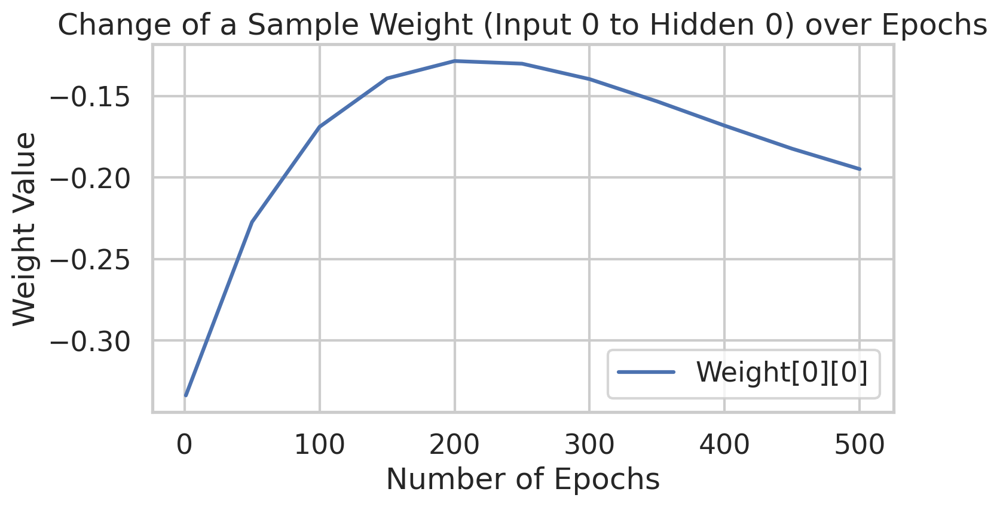

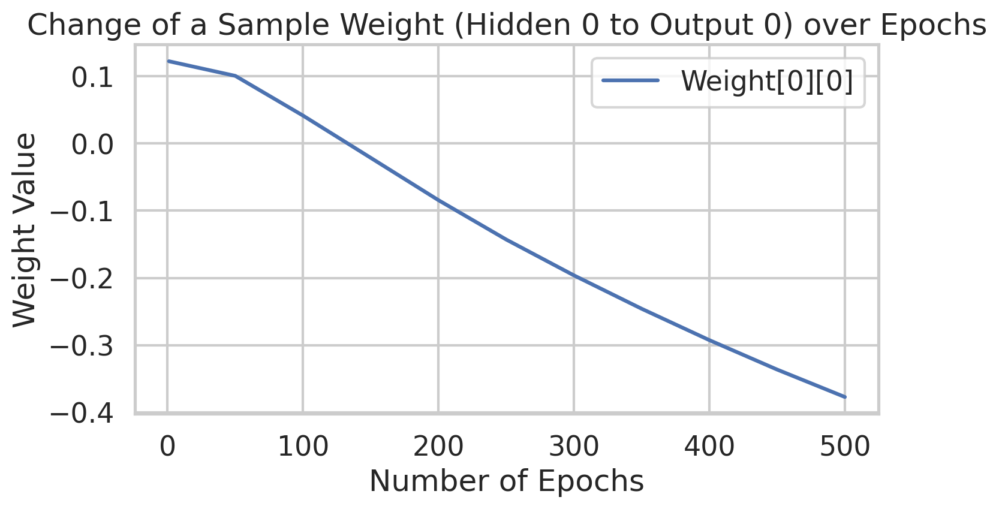

Overall accuracy: 66.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 0.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 66.67% hits and 33.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 0 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 68.33%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 0.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 68.33% hits and 31.67% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 0 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.001
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2576407913230419
Epoch  50 - Total Error:  0.13419121310724824
Epoch  100 - Total Error:  0.11095180860972549
Epoch  150 - Total Error:  0.09554457353024487
Epoch  200 - Total Error:  0.08358805163563948
Epoch  250 - Total Error:  0.0739947030

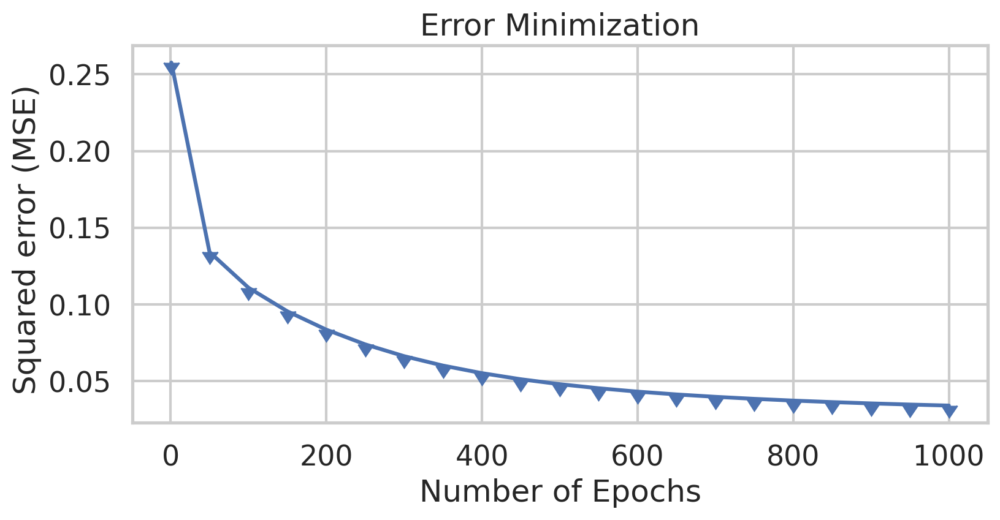

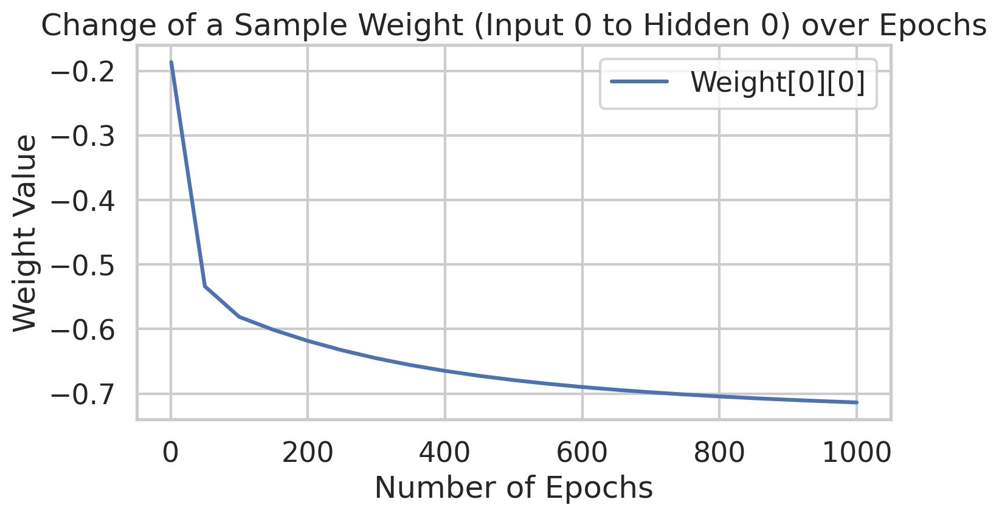

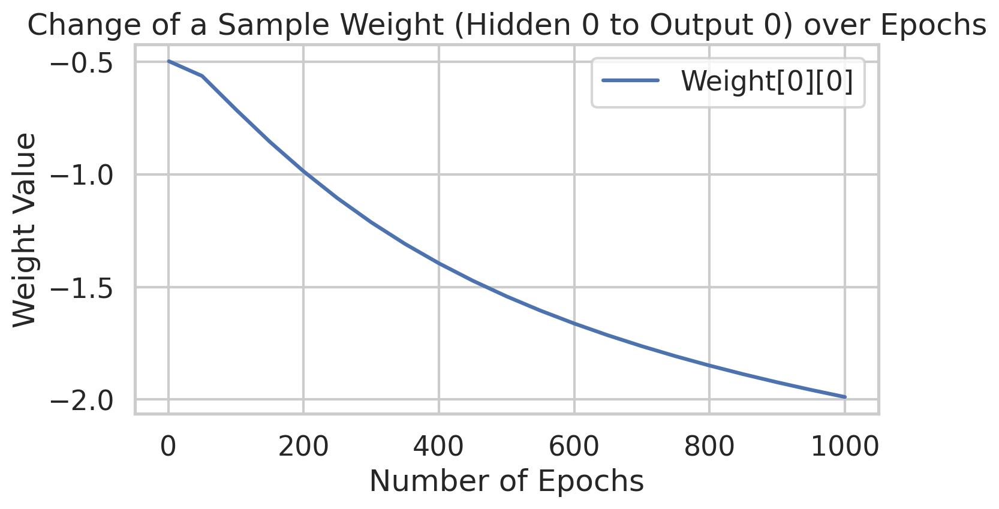

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 96.97%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 32 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.001
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2919261975260045
Epoch  50 - Total Error:  0.15937894518245255
Epoch  100 - Total Error:  0.1443418832354174
Epoch  150 - Total Error:  0.13579510918884424
Epoch  200 - Total Error:  0.12429193611842185
Epoch  250 - Total Error:  0.111701972

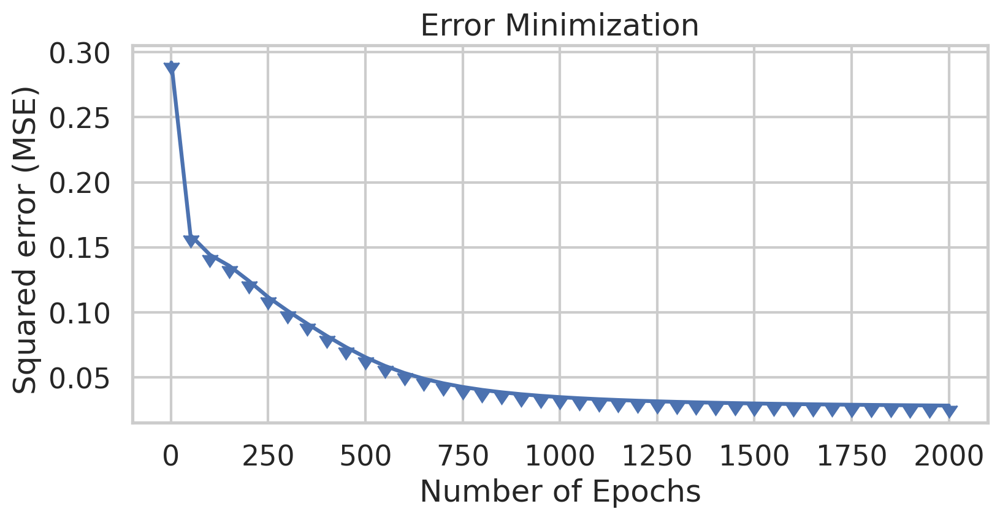

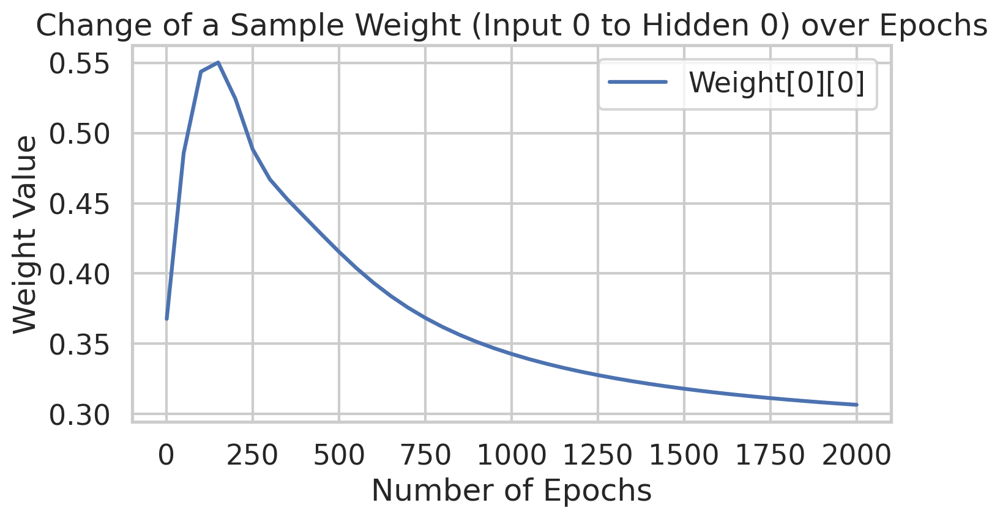

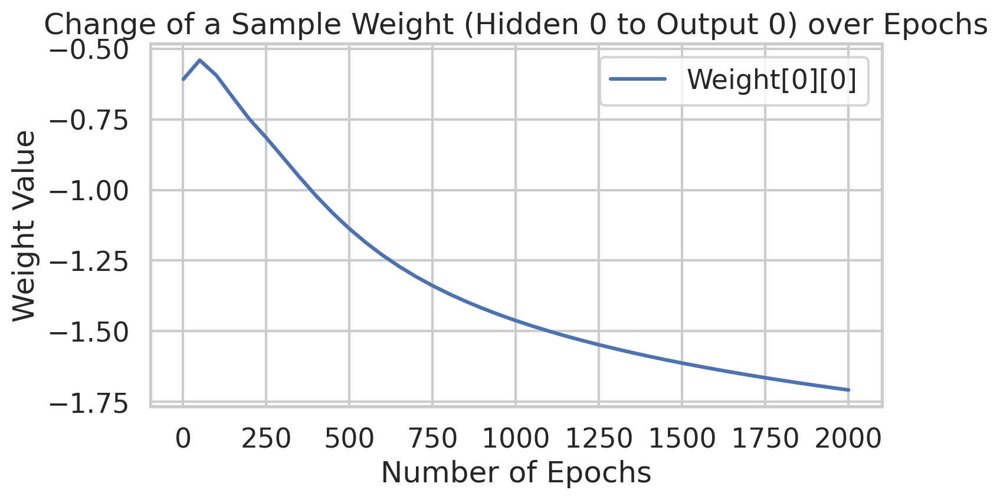

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.001
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3433631888892167
Epoch  50 - Total Error:  0.1856683072655021
Epoch  100 - Total Error:  0.1607894294811773
Epoch  150 - Total Error:  0.1528374029001158
Epoch  200 - Total Error:  0.13981345344166085
Epoch  250 - Total Error:  0.1289275858

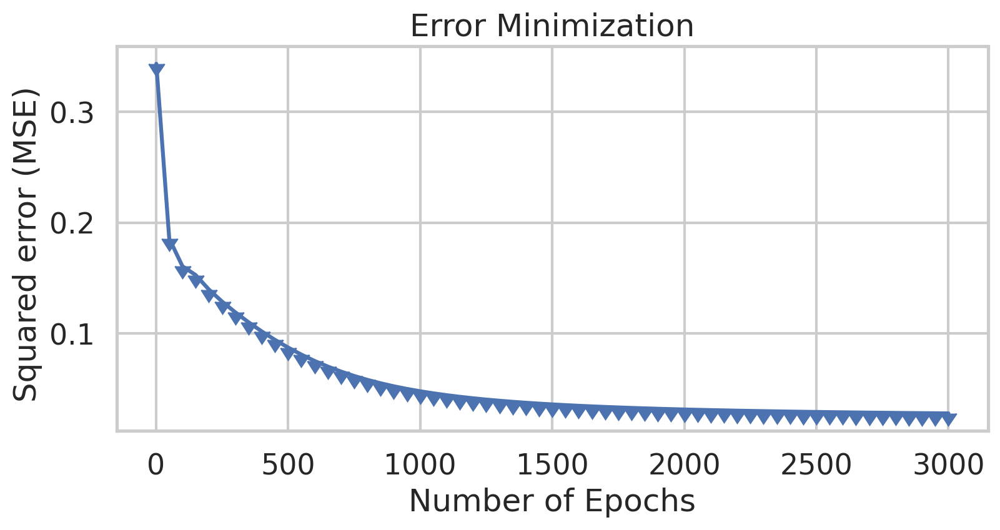

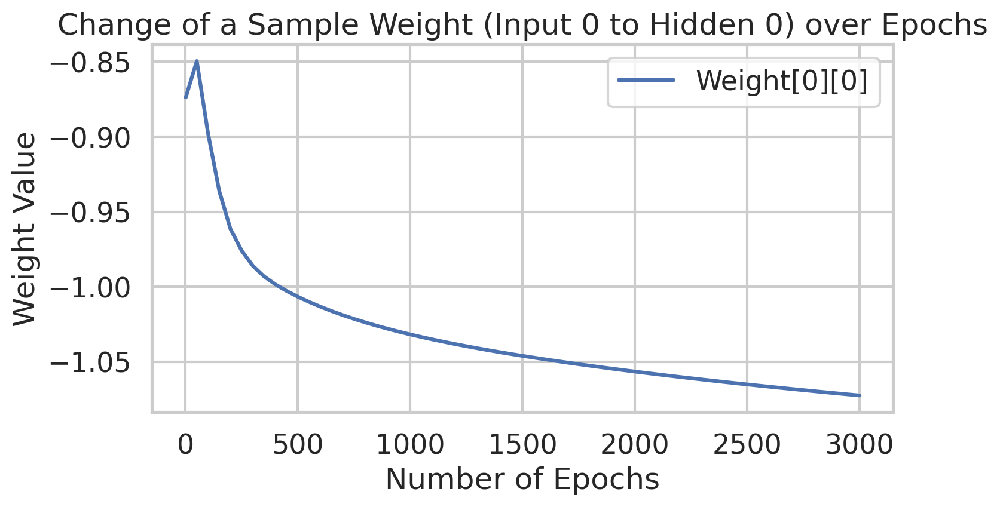

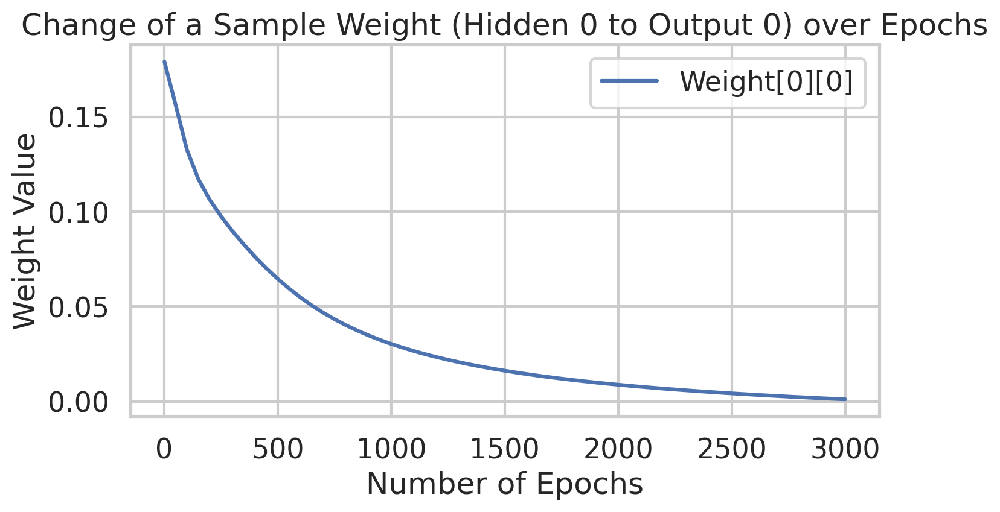

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 89.17%
 - Accuracy Setosa: 90.24%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 89.17% hits and 10.83% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 74 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.001
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.4645693259099104
Epoch  50 - Total Error:  0.16668236686934276
Epoch  100 - Total Error:  0.15483291561927554
Epoch  150 - Total Error:  0.15227643778323915
Epoch  200 - Total Error:  0.14986660704792948
Epoch  250 - Total Error:  0.1433473

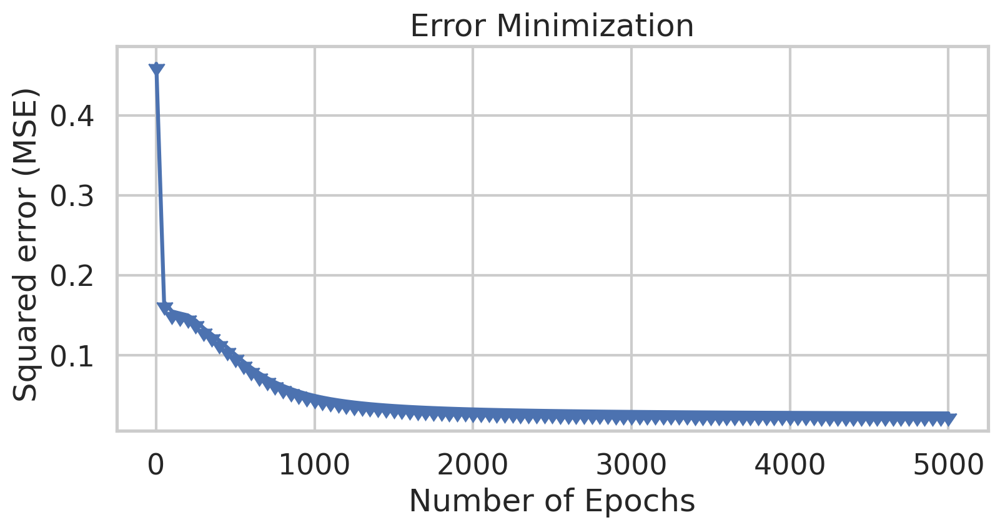

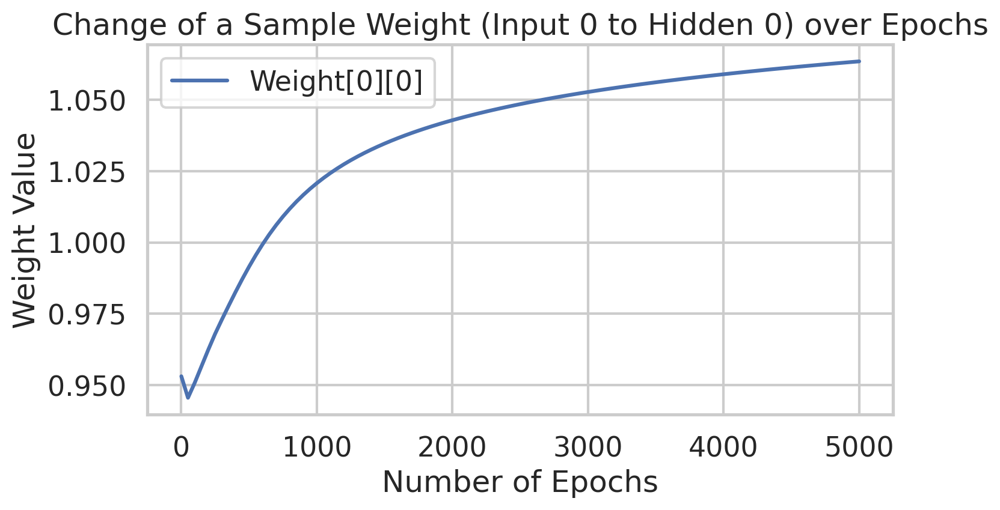

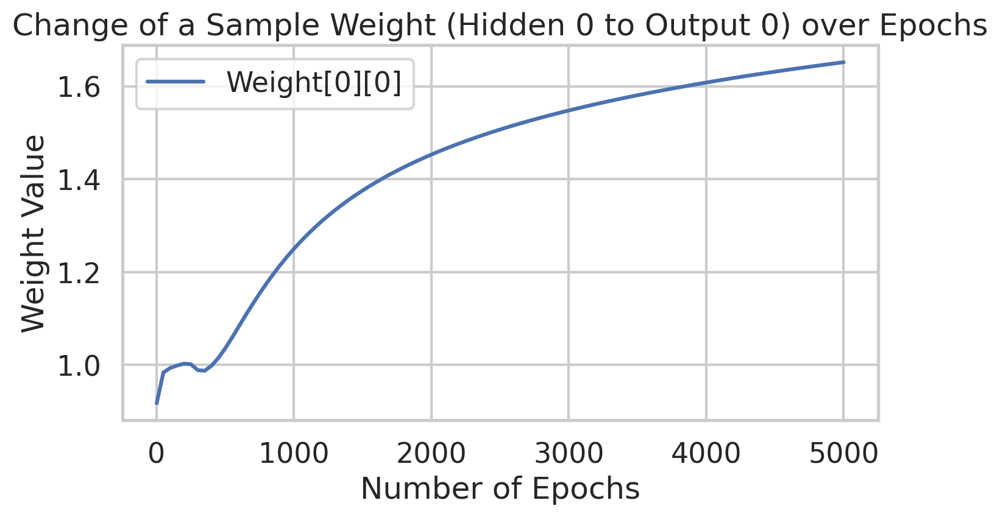

Overall accuracy: 83.33%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 55.56%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 83.33% hits and 16.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 5 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 88.33%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 72.73%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 88.33% hits and 11.67% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 24 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.005
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.27533318367177445
Epoch  50 - Total Error:  0.08568008800518782
Epoch  100 - Total Error:  0.04892310318298691
Epoch  150 - Total Error:  0.036134205911526475
Epoch  200 - Total Error:  0.03173789575079125
Epoch  250 - Total Error:  0.029650

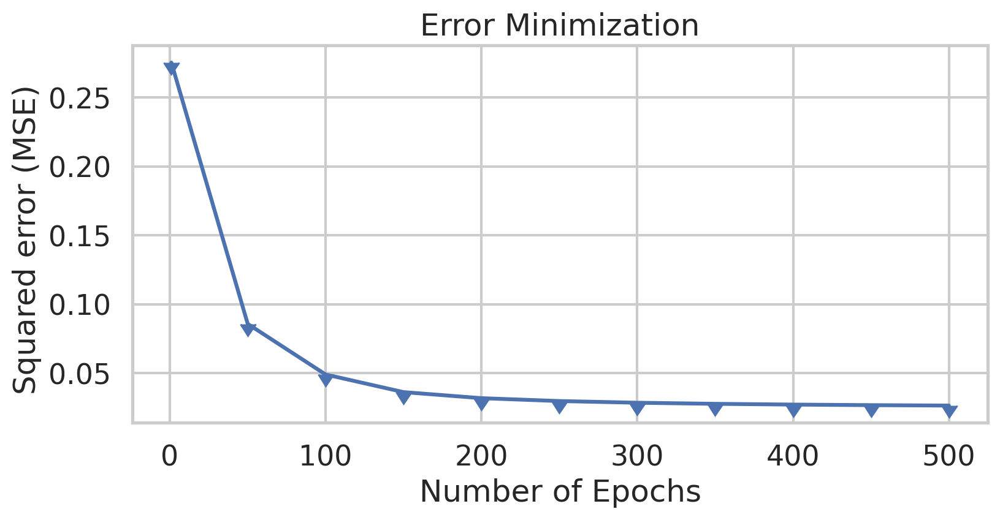

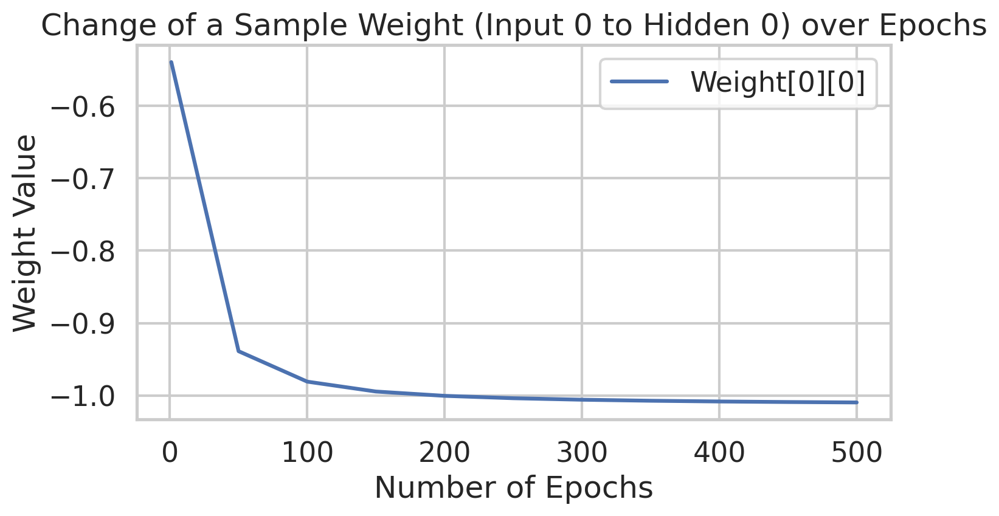

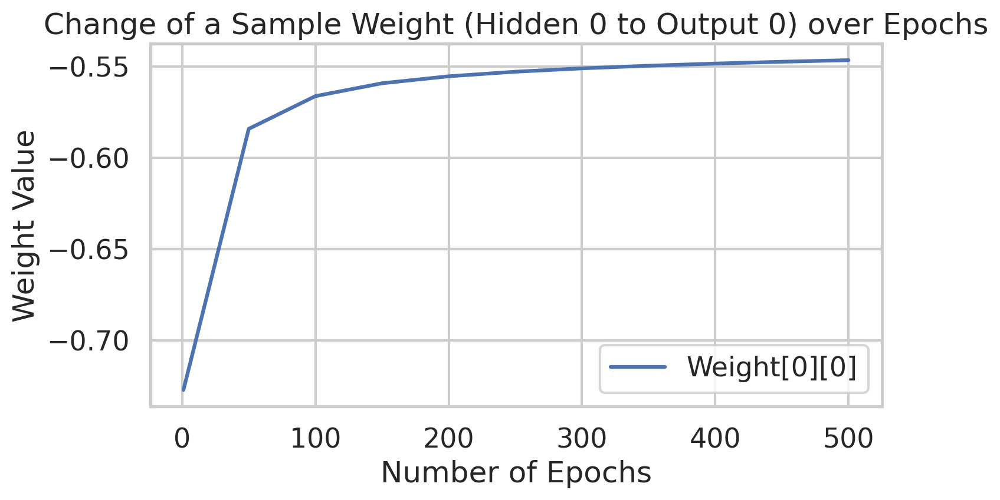

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.005
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.21698646712836797
Epoch  50 - Total Error:  0.10855735256318949
Epoch  100 - Total Error:  0.058411082202347246
Epoch  150 - Total Error:  0.039983580738701195
Epoch  200 - Total Error:  0.03332737573272435
Epoch  250 - Total Error:  0.0303

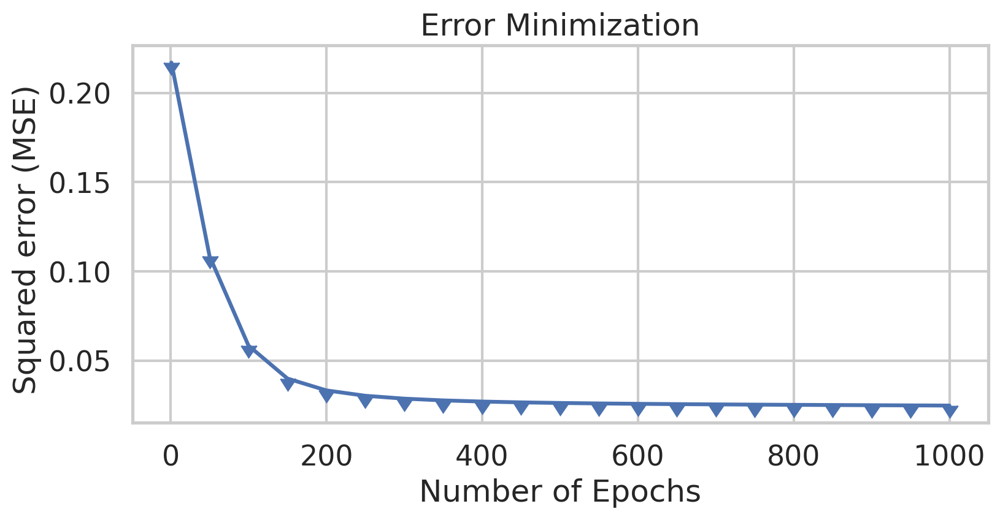

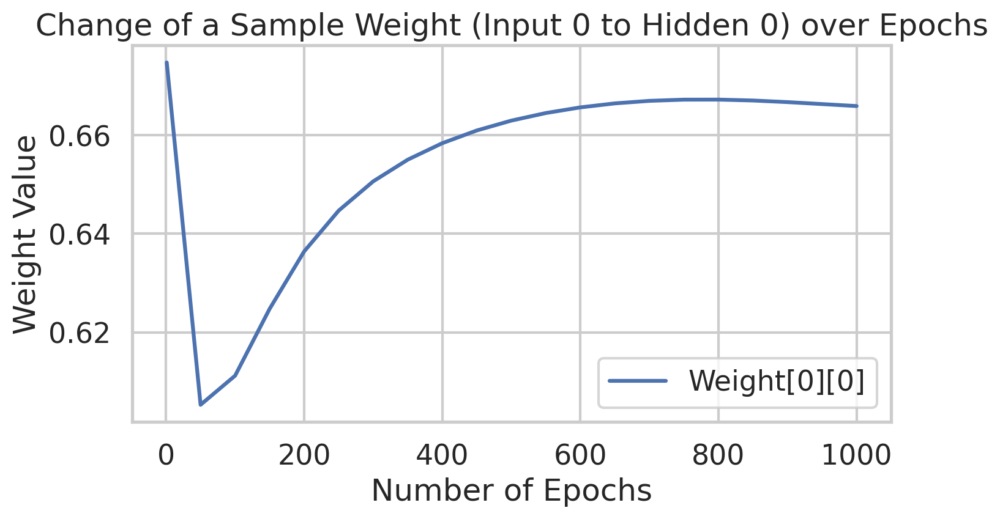

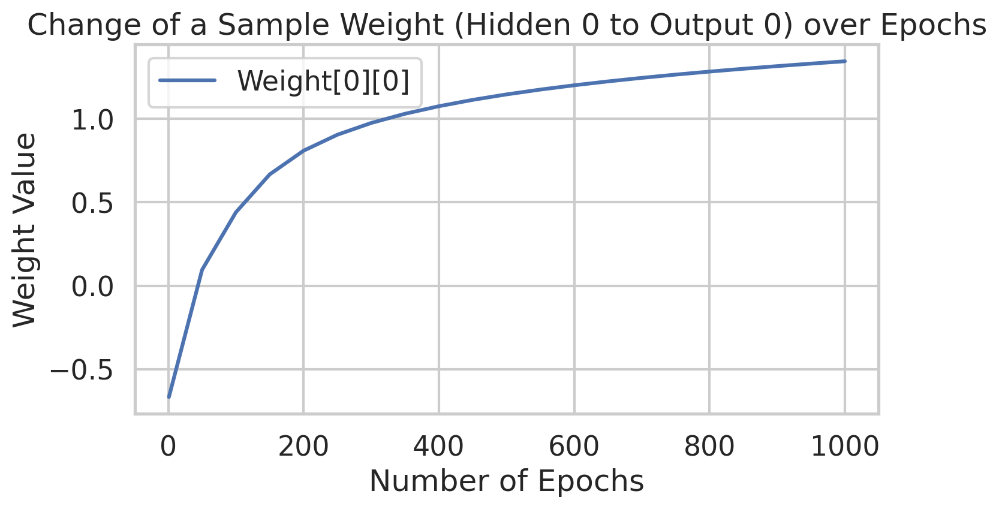

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.005
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2585711701933261
Epoch  50 - Total Error:  0.1135850947051464
Epoch  100 - Total Error:  0.061943790340637926
Epoch  150 - Total Error:  0.0418080138896835
Epoch  200 - Total Error:  0.03471335293632864
Epoch  250 - Total Error:  0.03154597

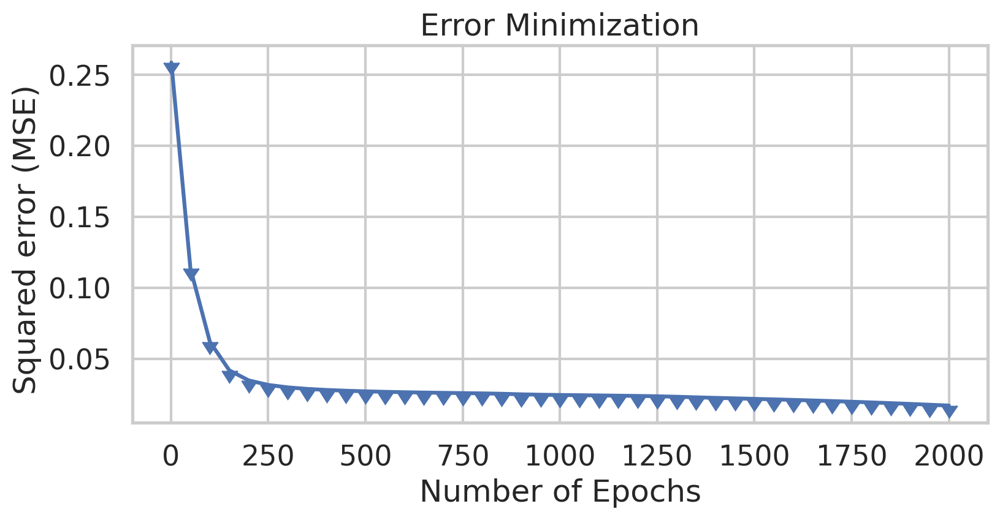

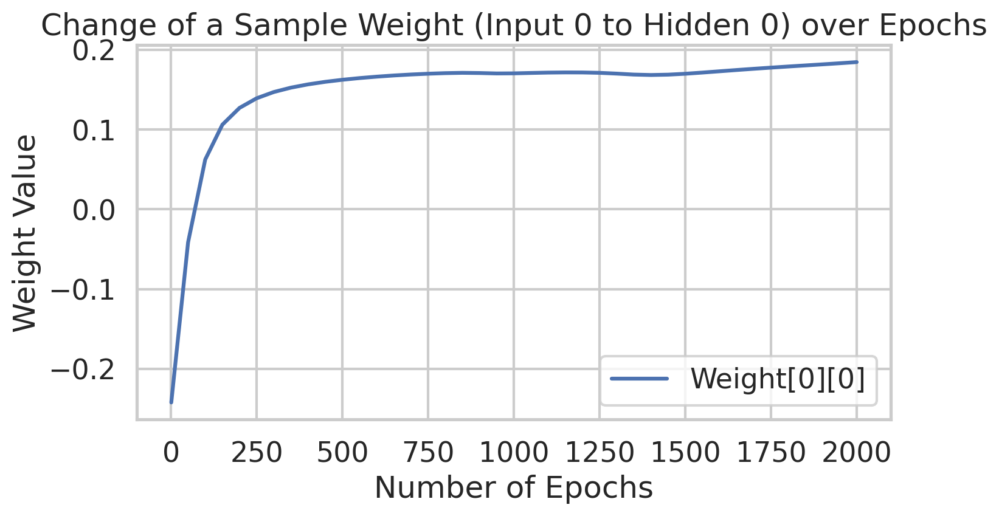

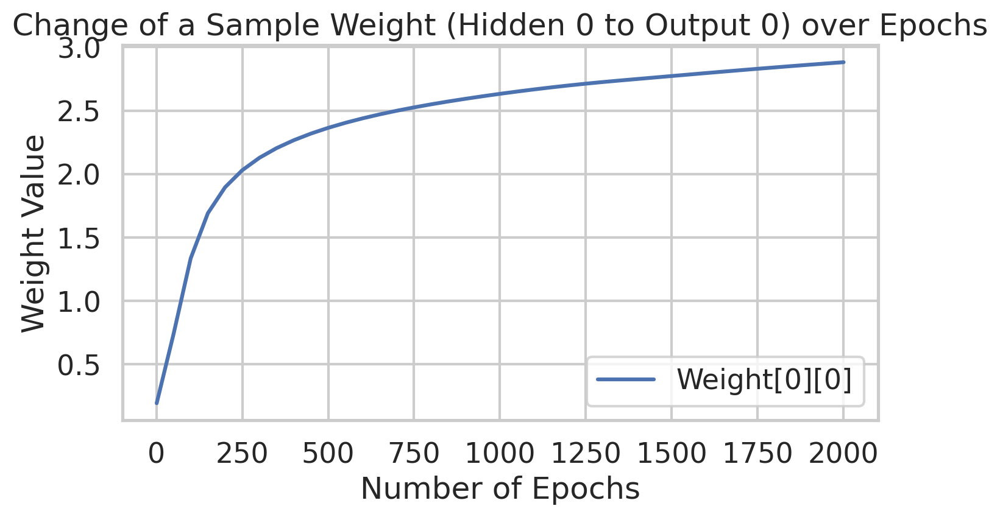

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.005
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3329272436741407
Epoch  50 - Total Error:  0.10490660809050002
Epoch  100 - Total Error:  0.058672557008328234
Epoch  150 - Total Error:  0.04119257045257227
Epoch  200 - Total Error:  0.03484636163088293
Epoch  250 - Total Error:  0.031946

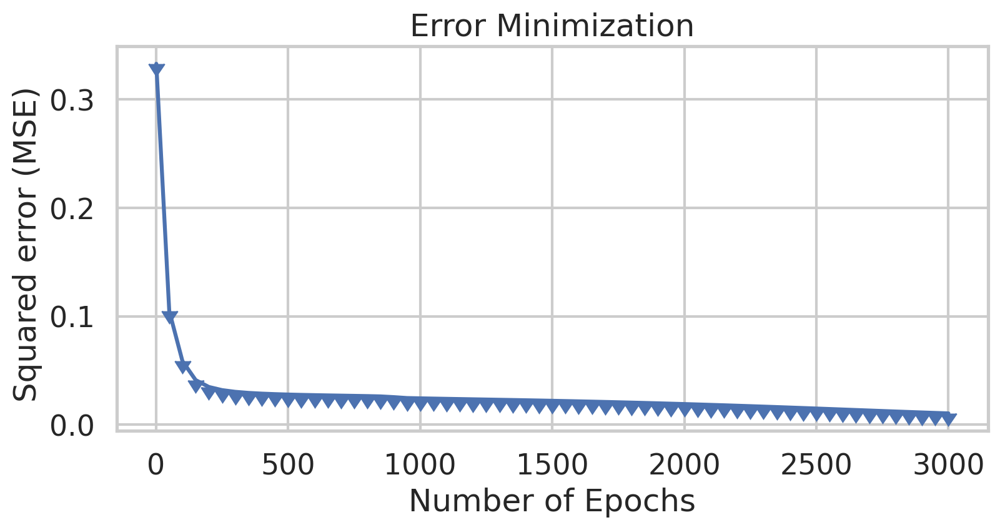

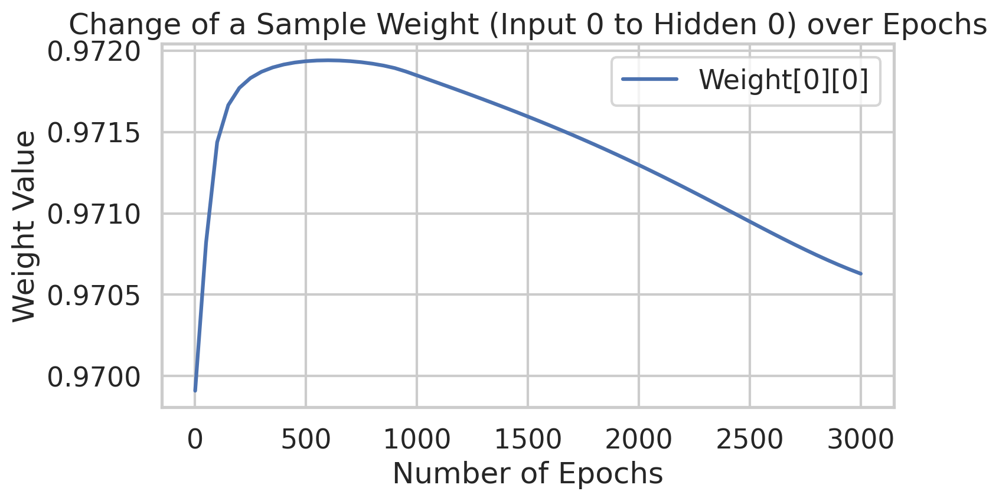

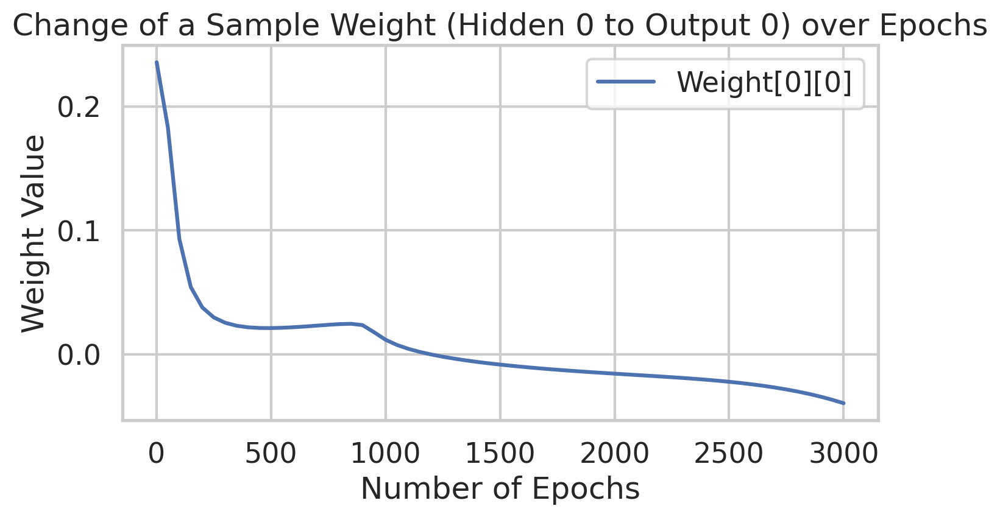

Overall accuracy: 100.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 100.00% hits and 0.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 98.33%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 60.00%

=== Train Results ===
Porcents : 98.33% hits and 1.67% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 3 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.005
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.23946343552295205
Epoch  50 - Total Error:  0.07300655928319882
Epoch  100 - Total Error:  0.04682995996111353
Epoch  150 - Total Error:  0.03715774526423922
Epoch  200 - Total Error:  0.03286936867973604
Epoch  250 - Total Error:  0.0

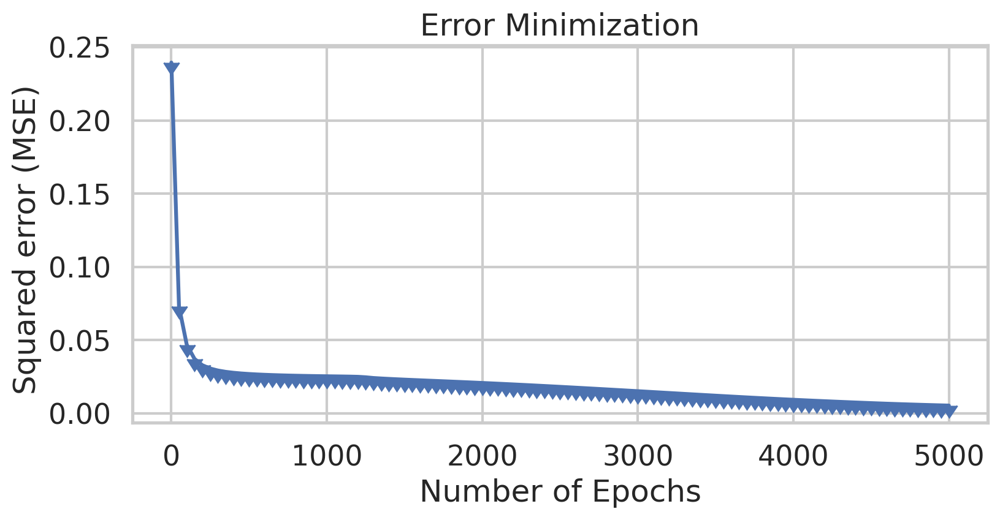

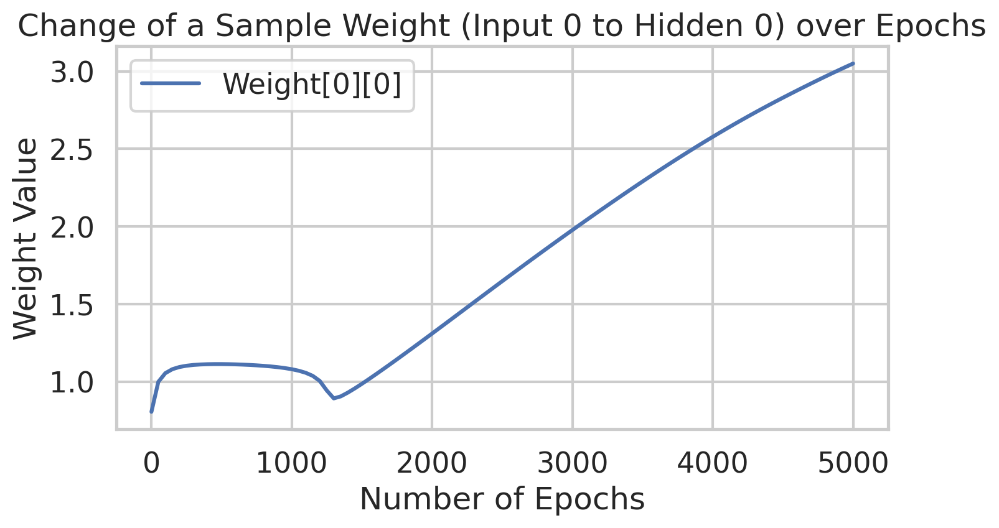

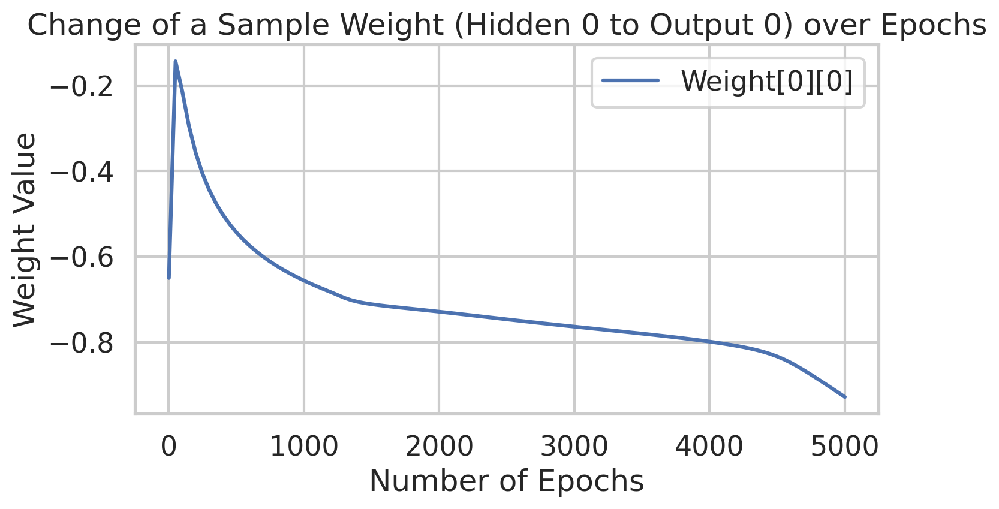

Overall accuracy: 50.00%
 - Accuracy Setosa: 30.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 50.00% hits and 50.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 6 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 50.00%
 - Accuracy Setosa: 32.93%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 50.00% hits and 50.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 27 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.01
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3060959501615599
Epoch  50 - Total Error:  0.0478047914196191
Epoch  100 - Total Error:  0.031881022215342066
Epoch  150 - Total Error:  0.02845958048899867
Epoch  200 - Total Error:  0.027041872679251164
Epoch  250 - Total Error:  0.026249917

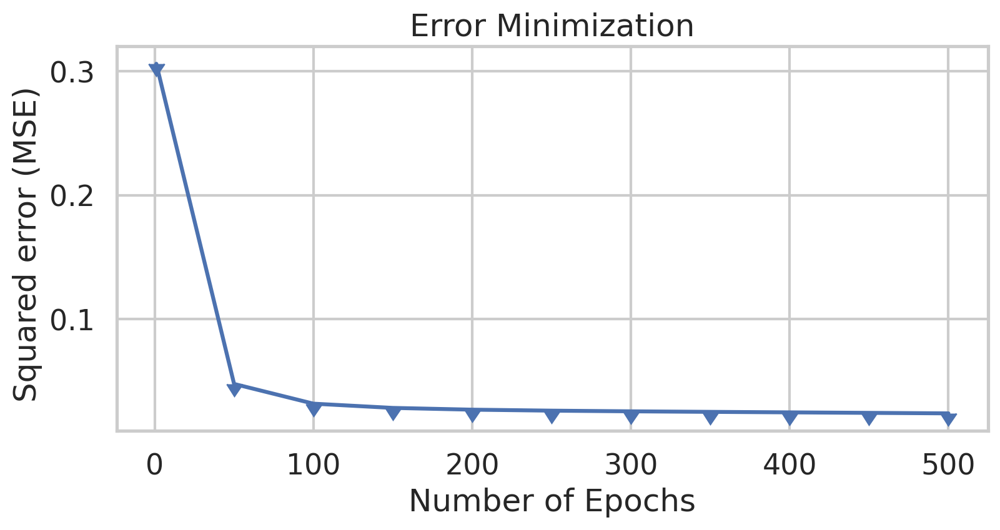

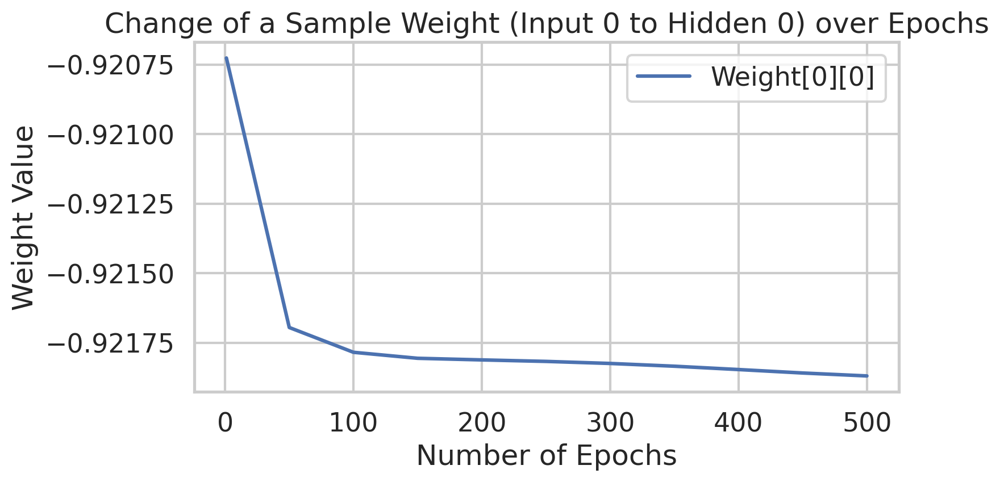

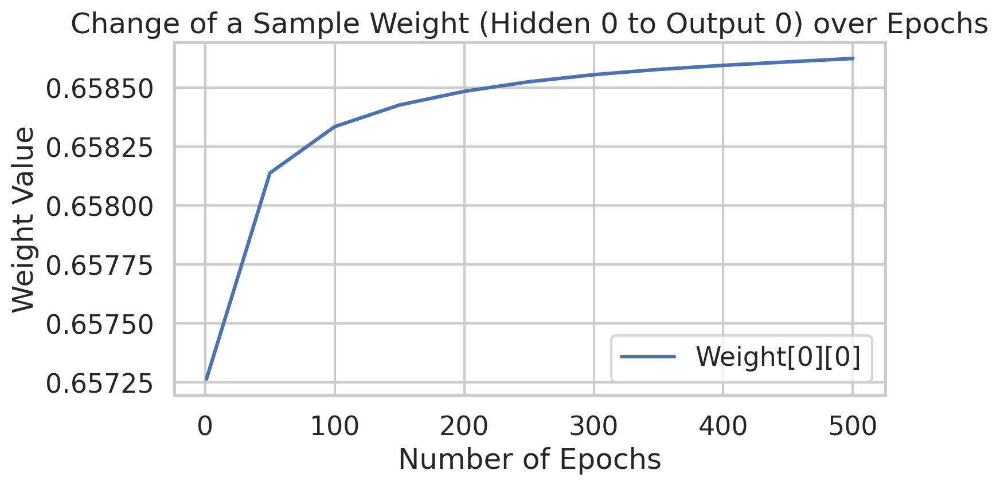

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.01
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3047208268628279
Epoch  50 - Total Error:  0.04414040716623977
Epoch  100 - Total Error:  0.030939812709276628
Epoch  150 - Total Error:  0.028046768577340307
Epoch  200 - Total Error:  0.026885105138404402
Epoch  250 - Total Error:  0.02627

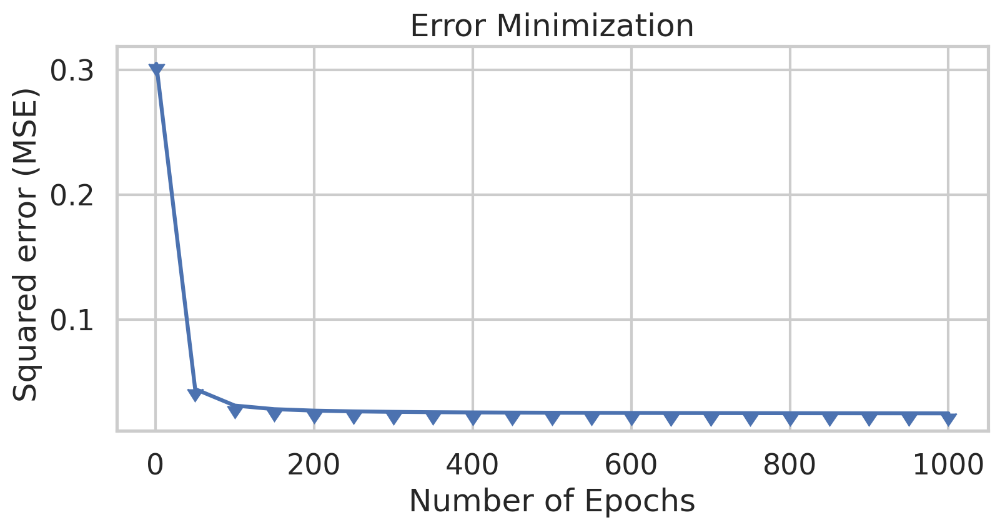

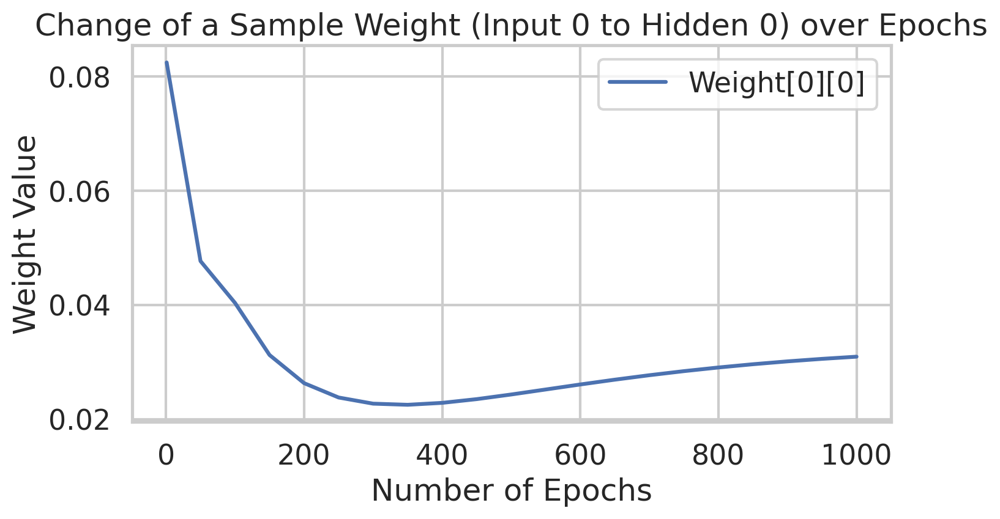

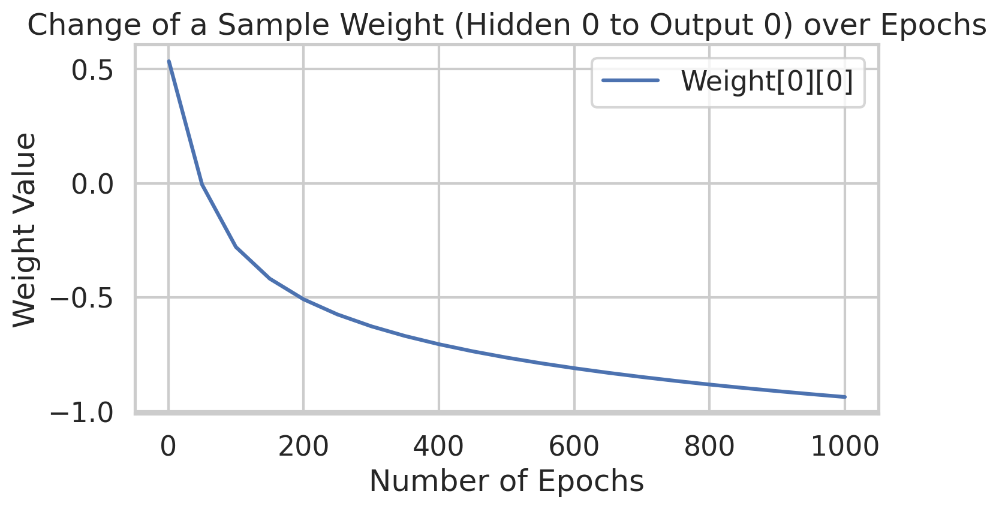

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.01
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.28025736846922145
Epoch  50 - Total Error:  0.07122190021416724
Epoch  100 - Total Error:  0.03532775345111451
Epoch  150 - Total Error:  0.029579485984603127
Epoch  200 - Total Error:  0.027579829424722025
Epoch  250 - Total Error:  0.02658

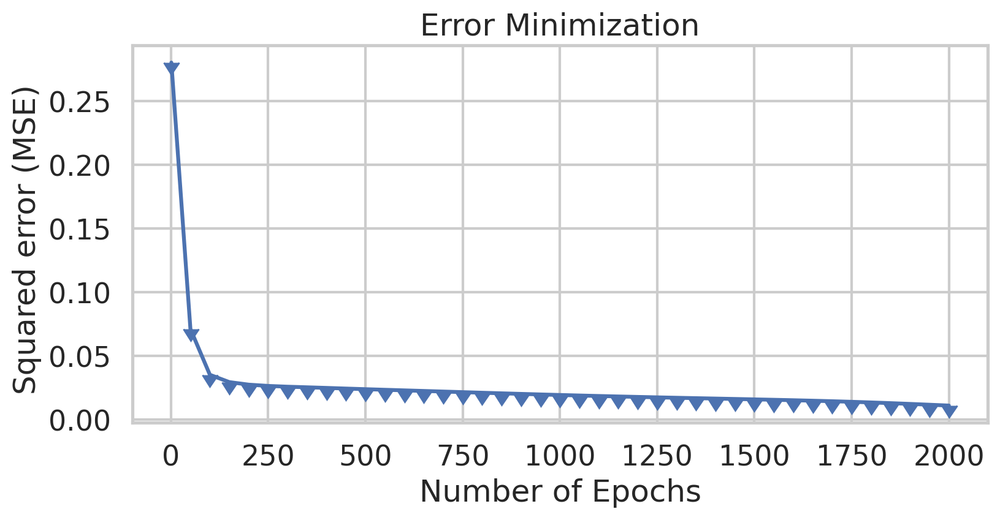

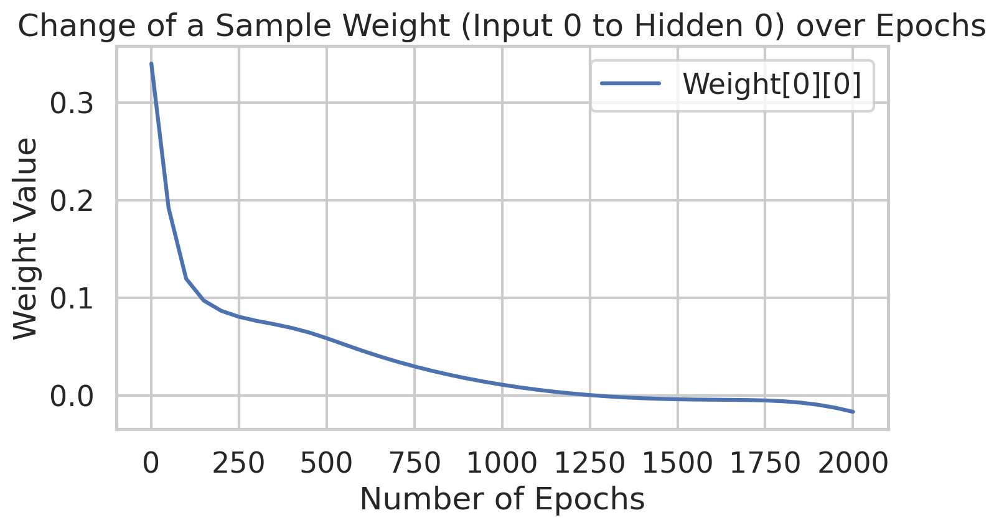

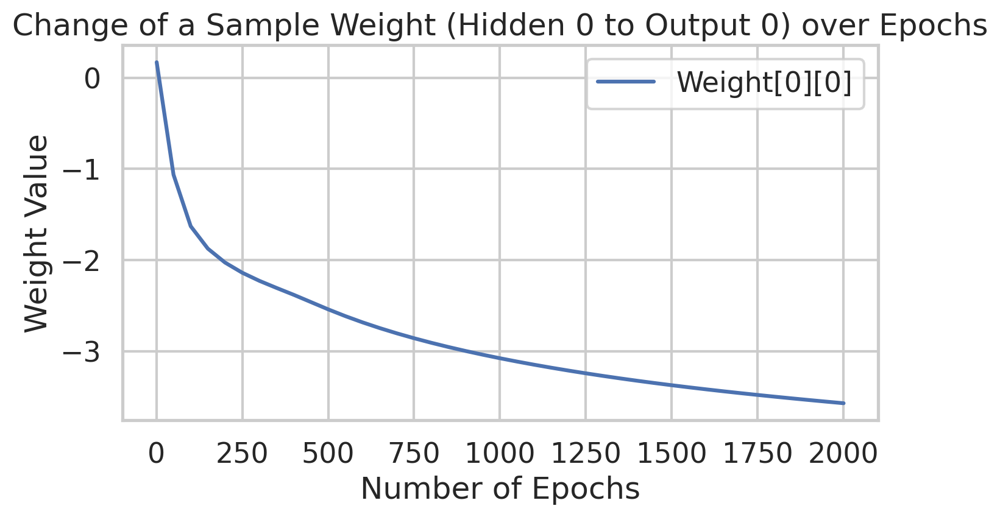

Overall accuracy: 83.33%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 44.44%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 83.33% hits and 16.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 4 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 83.33%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 39.39%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 83.33% hits and 16.67% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 13 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.01
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2085734446465636
Epoch  50 - Total Error:  0.03609238767348508
Epoch  100 - Total Error:  0.02903917579553279
Epoch  150 - Total Error:  0.02693624580278361
Epoch  200 - Total Error:  0.025356906842116313
Epoch  250 - Total Error:  0.024

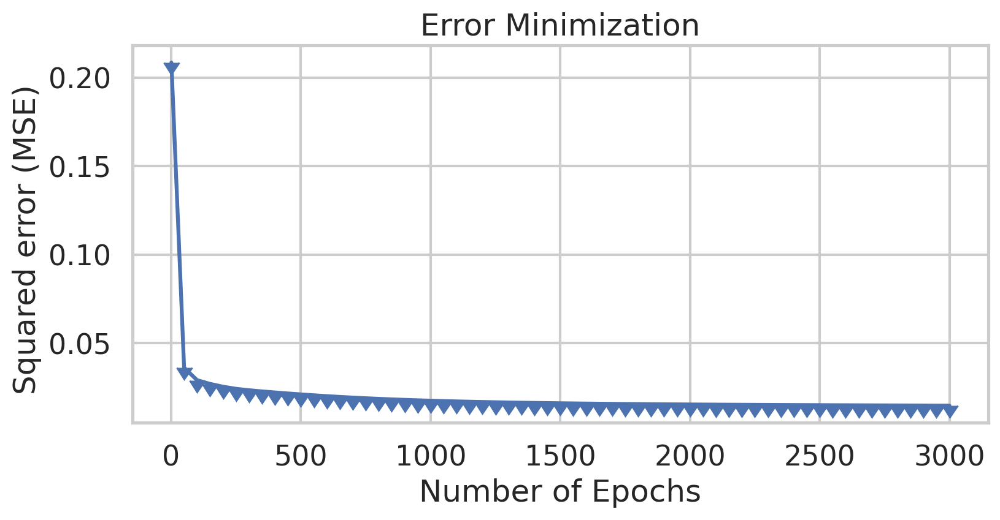

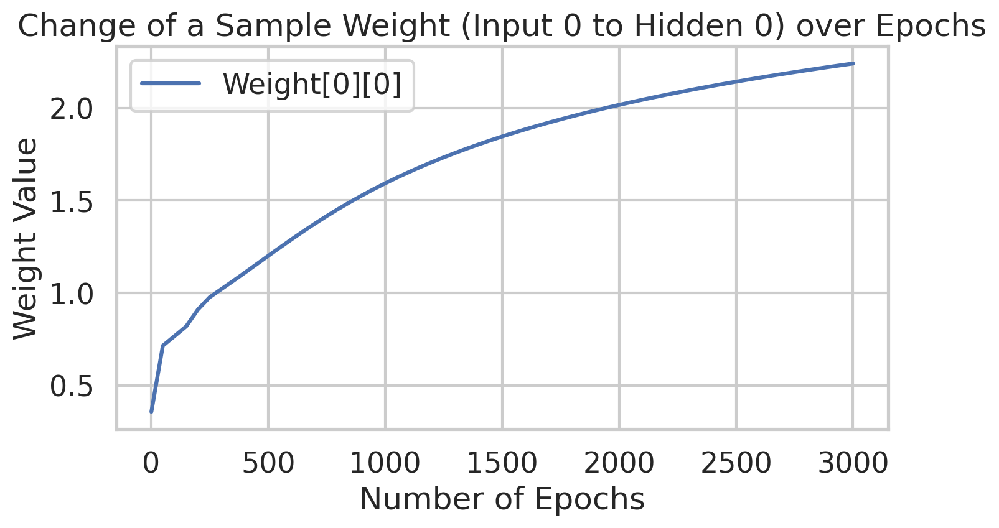

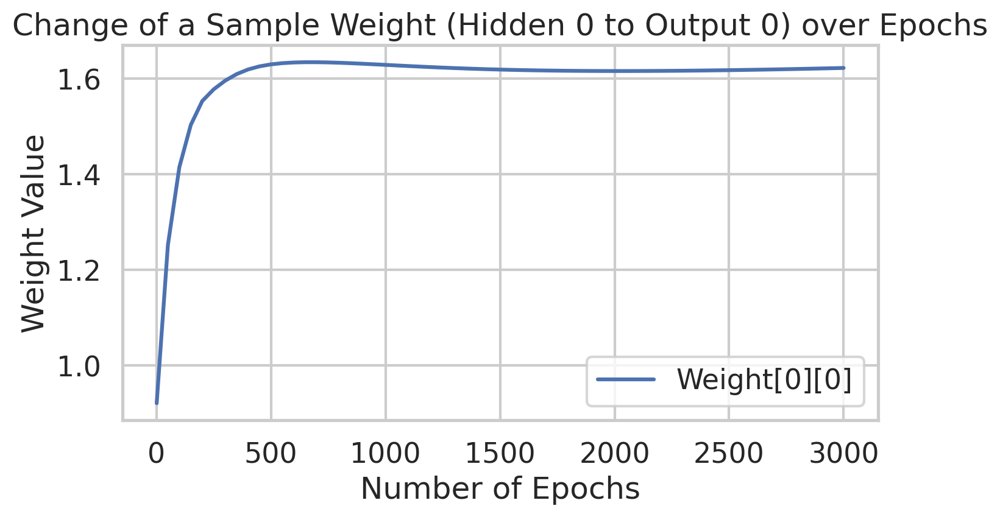

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.01
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.22494677359581783
Epoch  50 - Total Error:  0.04684003394027395
Epoch  100 - Total Error:  0.03399408102389003
Epoch  150 - Total Error:  0.030257591591686582
Epoch  200 - Total Error:  0.028567568986906617
Epoch  250 - Total Error:  0.02759

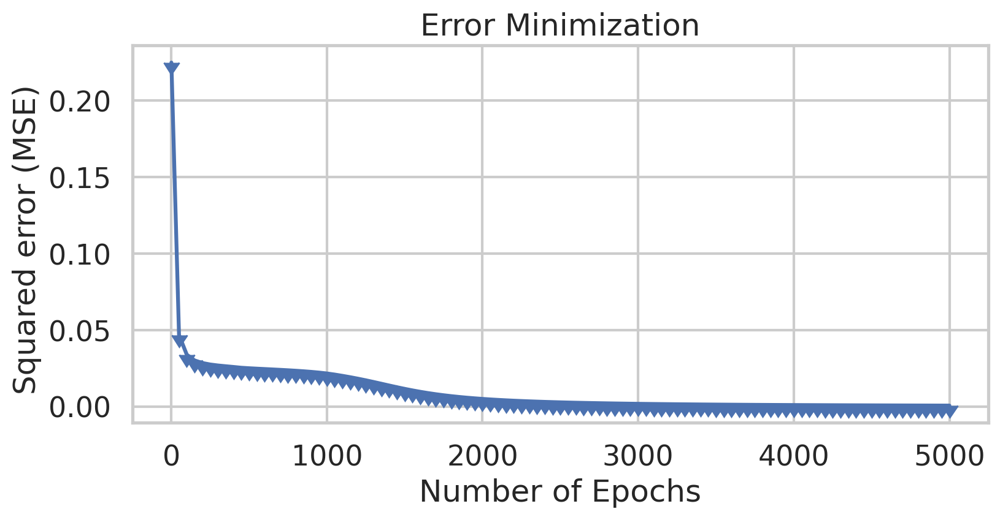

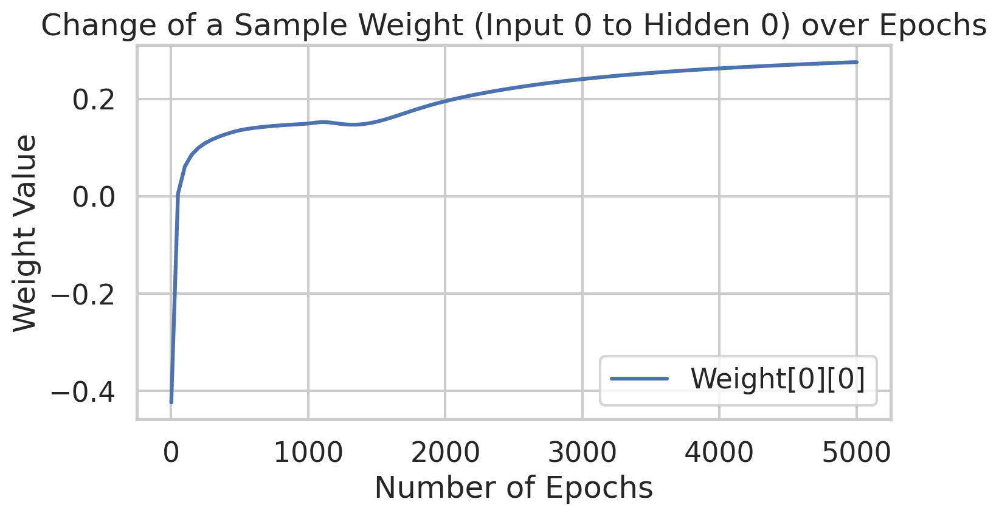

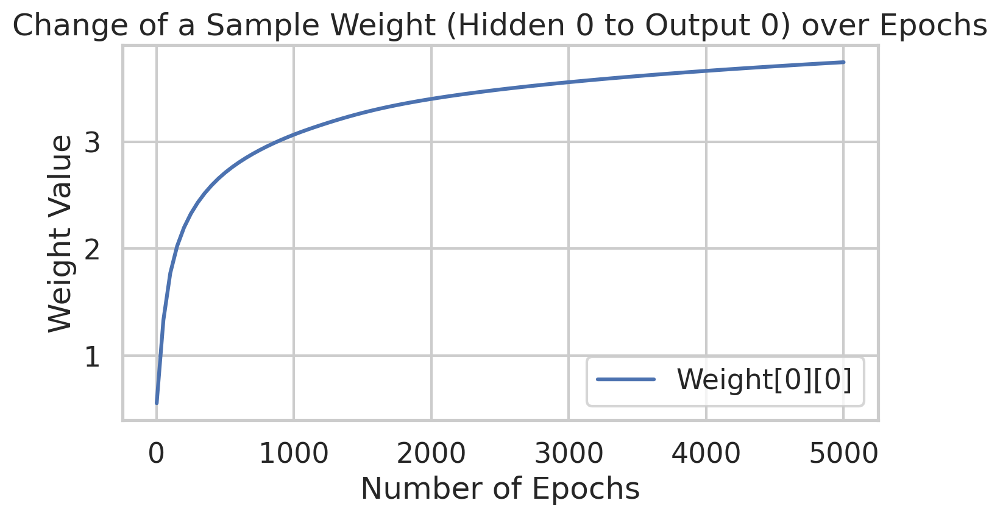

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 27.50%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 27.50% hits and 72.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.05
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.18353232249239002
Epoch  50 - Total Error:  0.025144465612623745
Epoch  100 - Total Error:  0.023154654656483493
Epoch  150 - Total Error:  0.020969153560338023
Epoch  200 - Total Error:  0.0180225283197291
Epoch  250 - Total Error:  0.0140946071

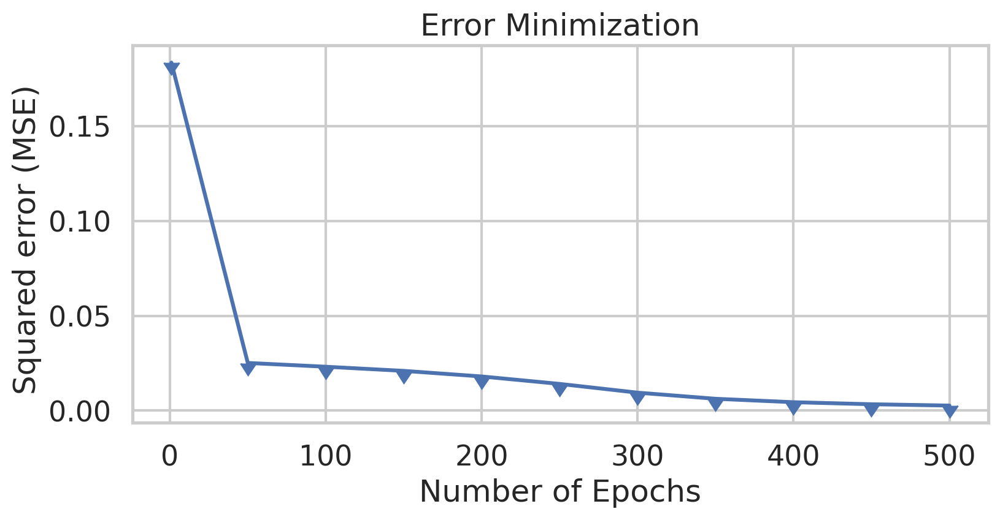

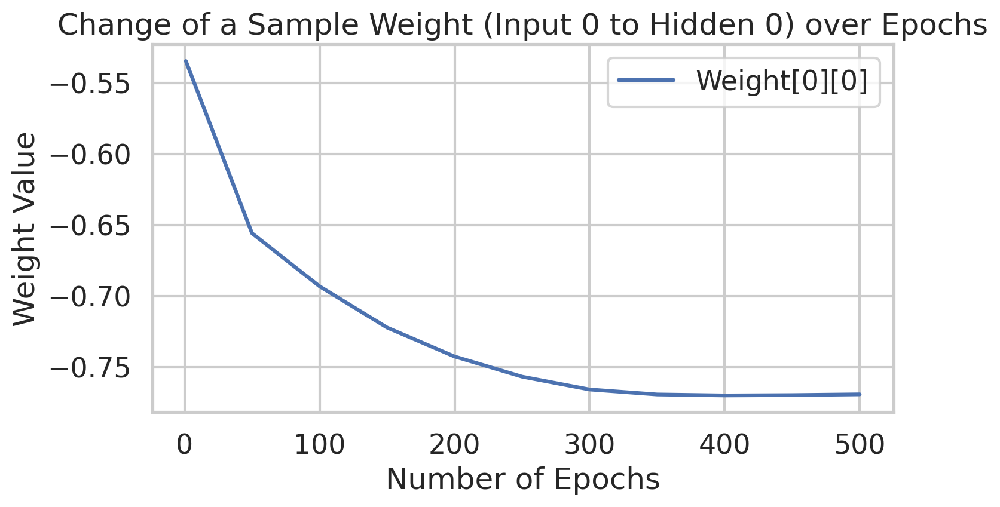

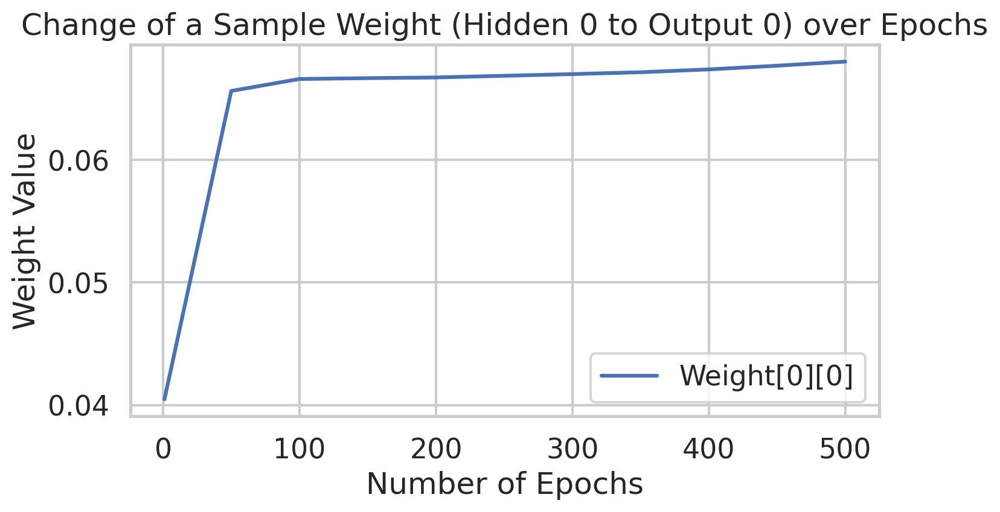

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 93.33%
 - Accuracy Setosa: 96.34%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 93.33% hits and 6.67% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 79 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.05
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.19022452255690805
Epoch  50 - Total Error:  0.027168076542625142
Epoch  100 - Total Error:  0.025505501456308678
Epoch  150 - Total Error:  0.02503644309130599
Epoch  200 - Total Error:  0.02481499056702908
Epoch  250 - Total Error:  0.024685

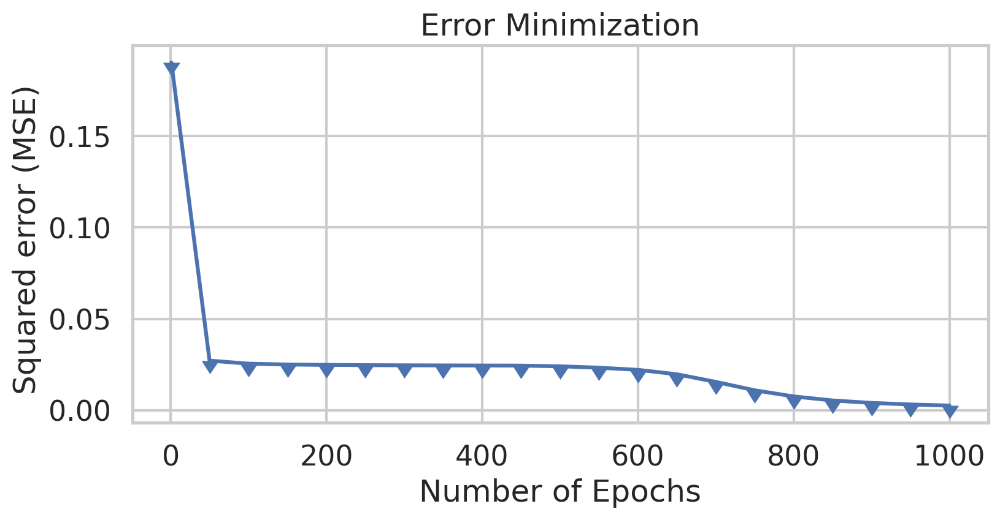

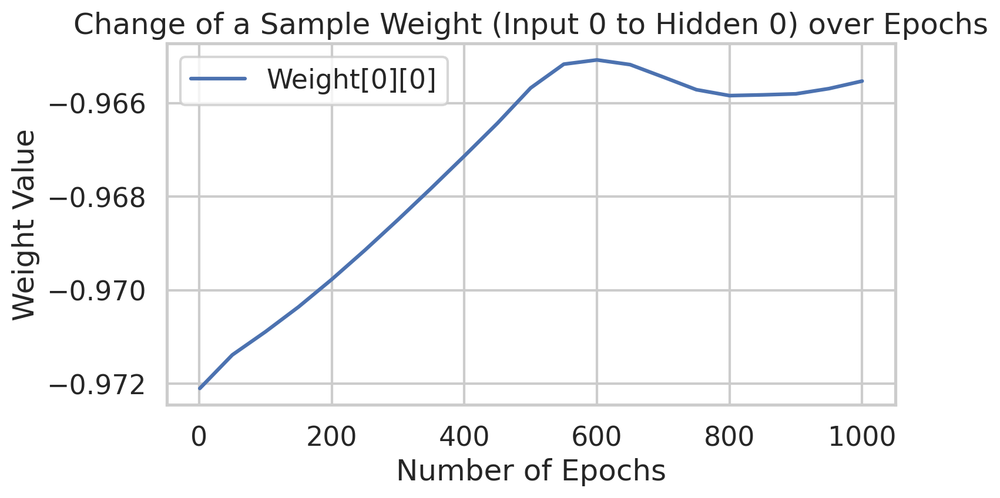

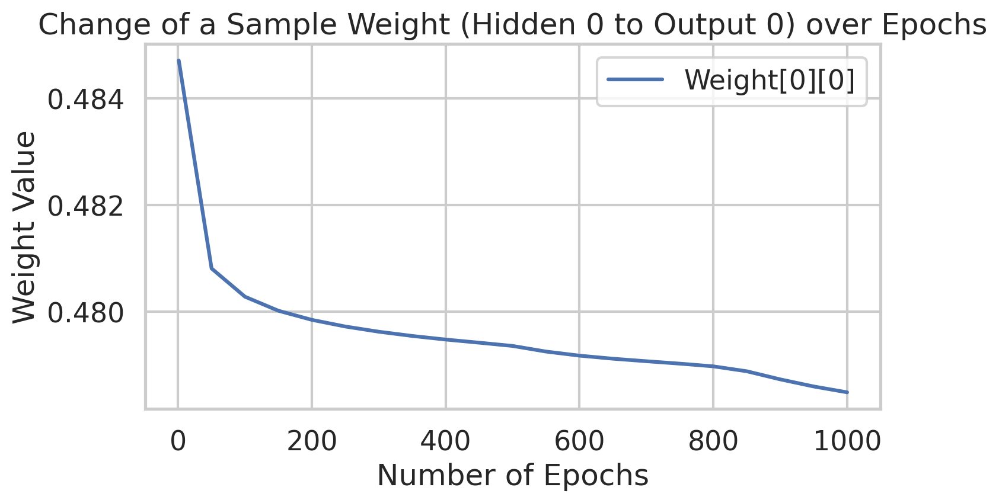

Overall accuracy: 33.33%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 33.33% hits and 66.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 31.67%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 31.67% hits and 68.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.05
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2112913838723533
Epoch  50 - Total Error:  0.026230604650498746
Epoch  100 - Total Error:  0.024050396039828992
Epoch  150 - Total Error:  0.02224741232124278
Epoch  200 - Total Error:  0.020045541093933174
Epoch  250 - Total Error:  0.01771

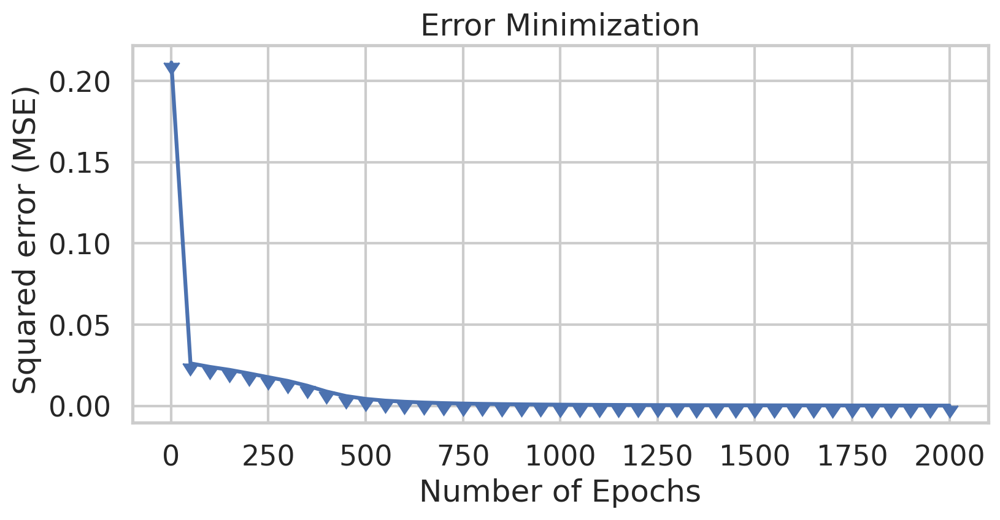

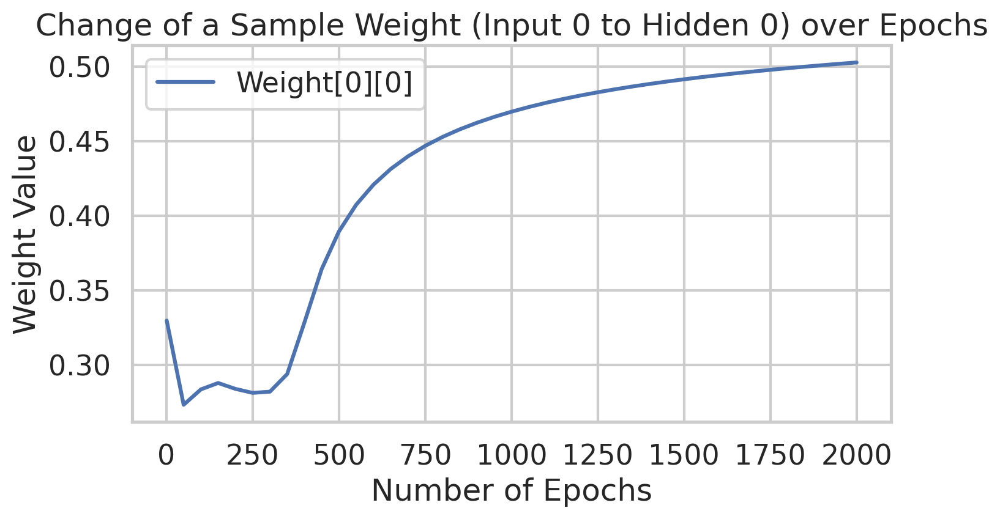

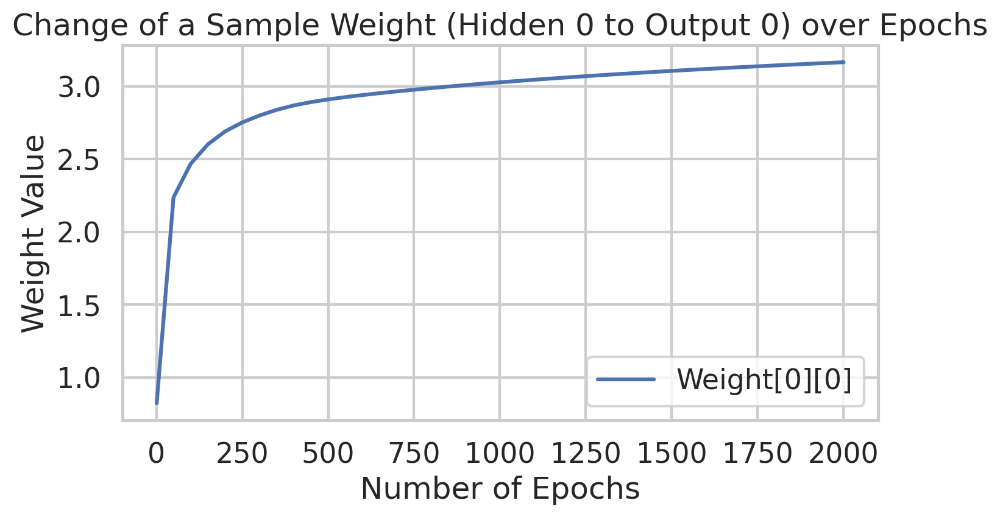

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 29.17%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 40.00%

=== Train Results ===
Porcents : 29.17% hits and 70.83% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 2 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.05
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.20669666502644704
Epoch  50 - Total Error:  0.026735601822988963
Epoch  100 - Total Error:  0.025295270722462945
Epoch  150 - Total Error:  0.024444885963415923
Epoch  200 - Total Error:  0.02349842642200656
Epoch  250 - Total Error:  0.0218995

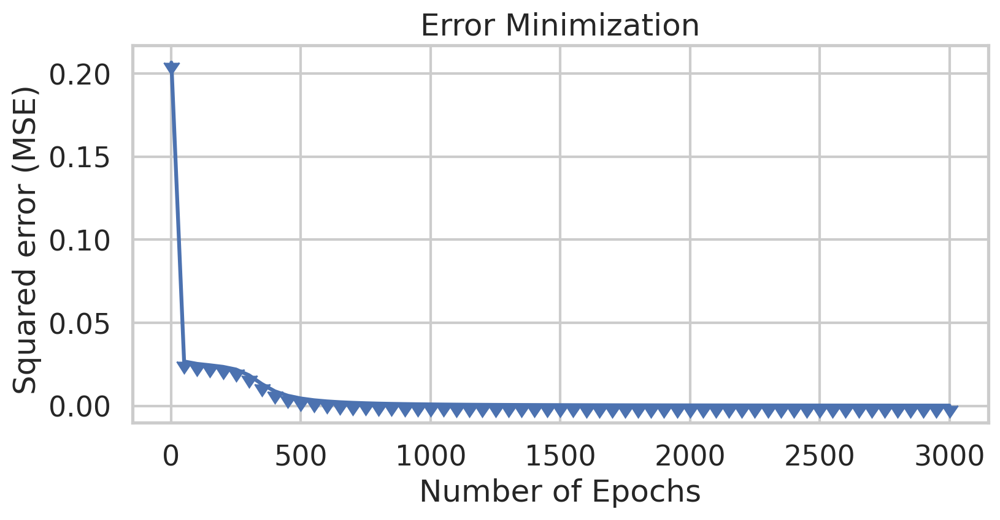

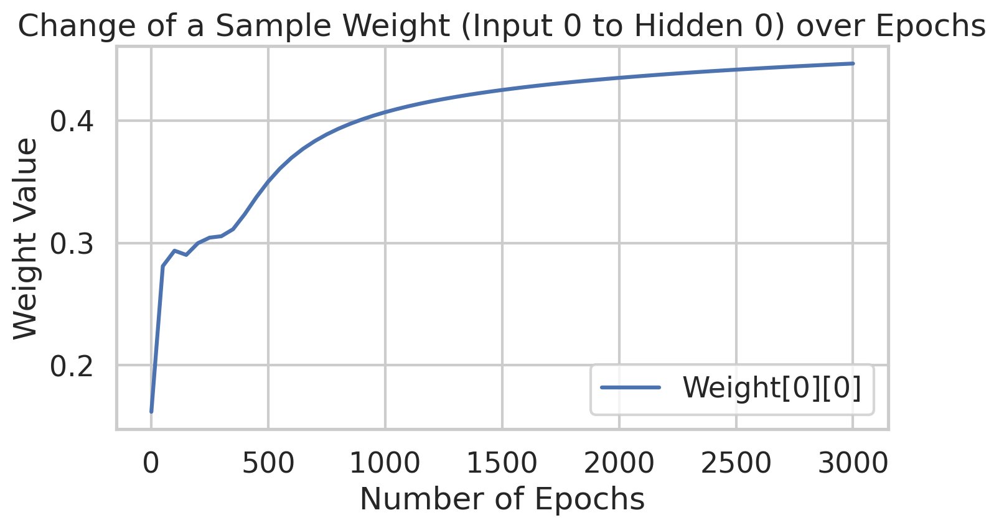

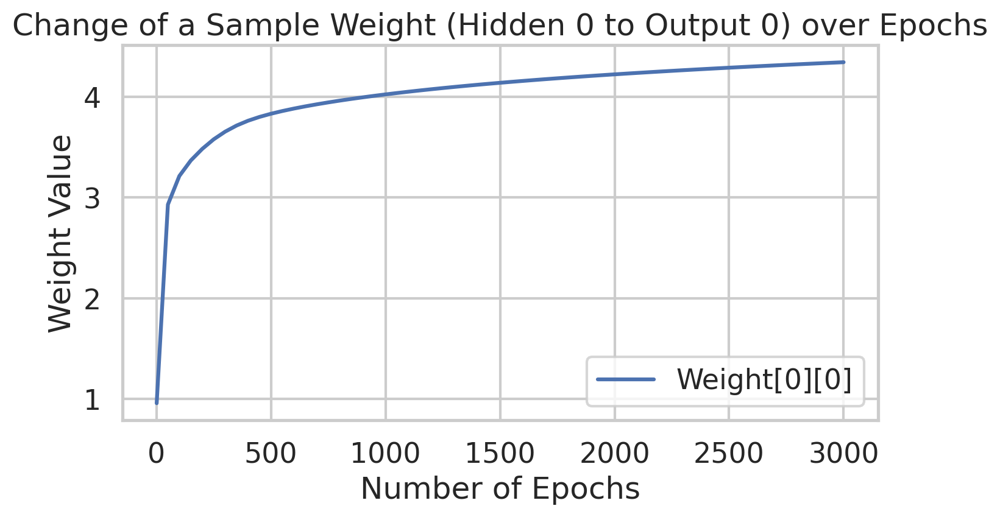

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 27.50%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 27.50% hits and 72.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.05
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.17939885576906617
Epoch  50 - Total Error:  0.027280030862828517
Epoch  100 - Total Error:  0.025303365353308353
Epoch  150 - Total Error:  0.024364031429837306
Epoch  200 - Total Error:  0.023487493601319794
Epoch  250 - Total Error:  0.0220506

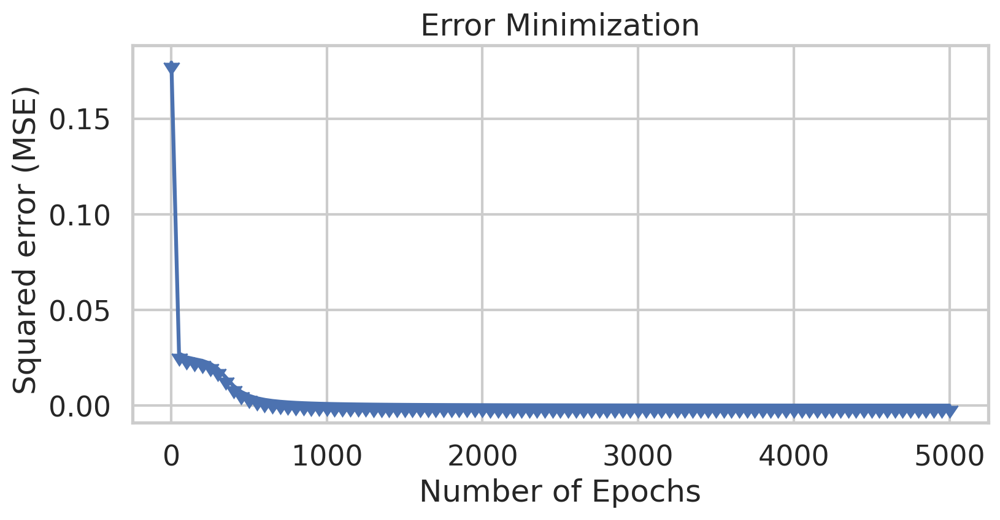

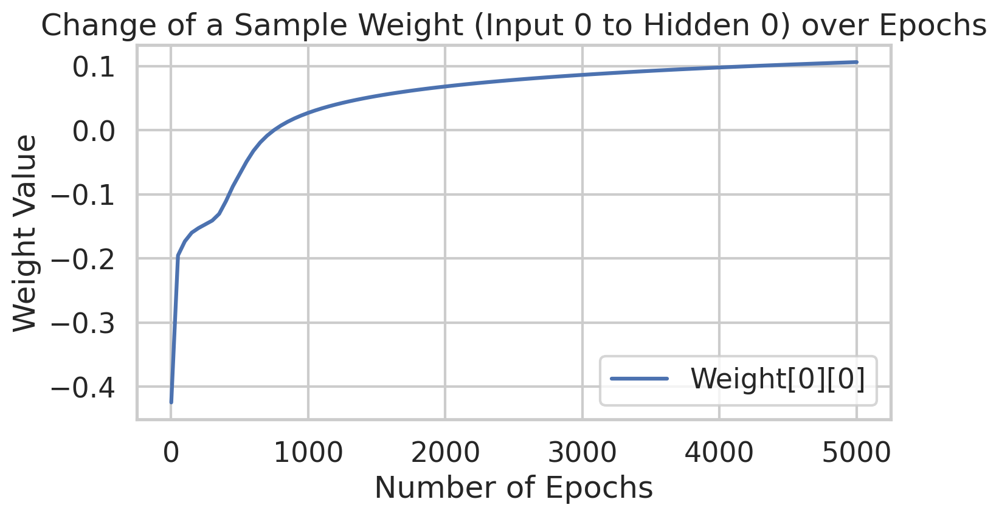

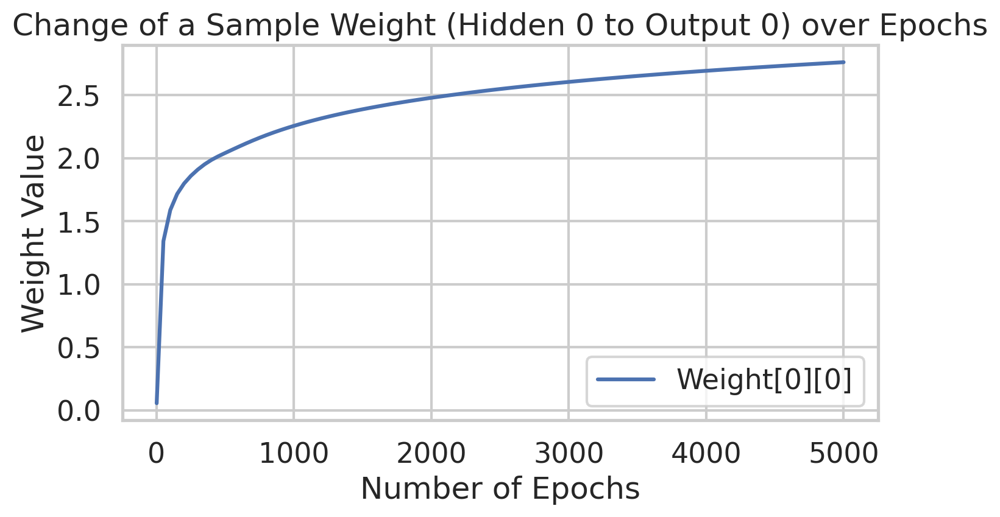

Overall accuracy: 33.33%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 33.33% hits and 66.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 31.67%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 31.67% hits and 68.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.1
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.1476710458753693
Epoch  50 - Total Error:  0.025424427681062144
Epoch  100 - Total Error:  0.023067121112598968
Epoch  150 - Total Error:  0.019193396772379266
Epoch  200 - Total Error:  0.015176376870696421
Epoch  250 - Total Error:  0.008740

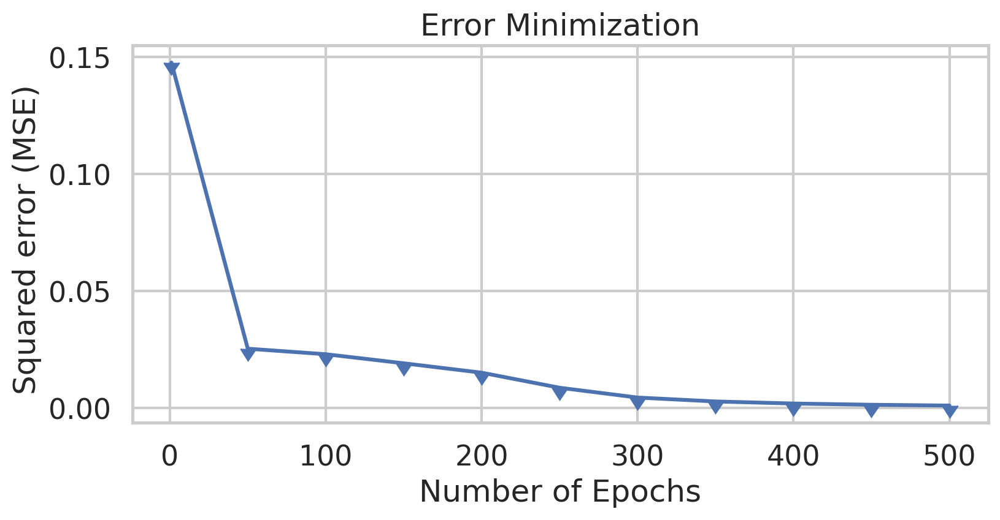

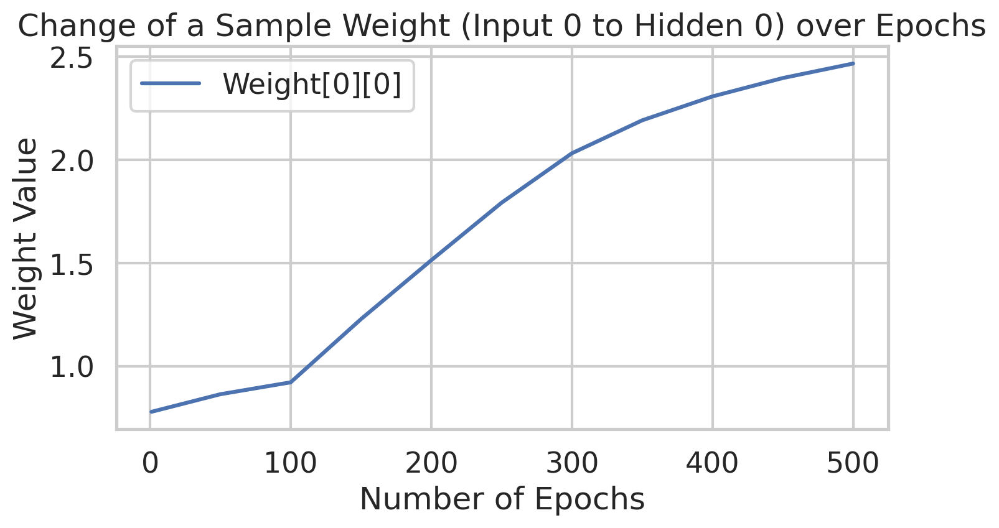

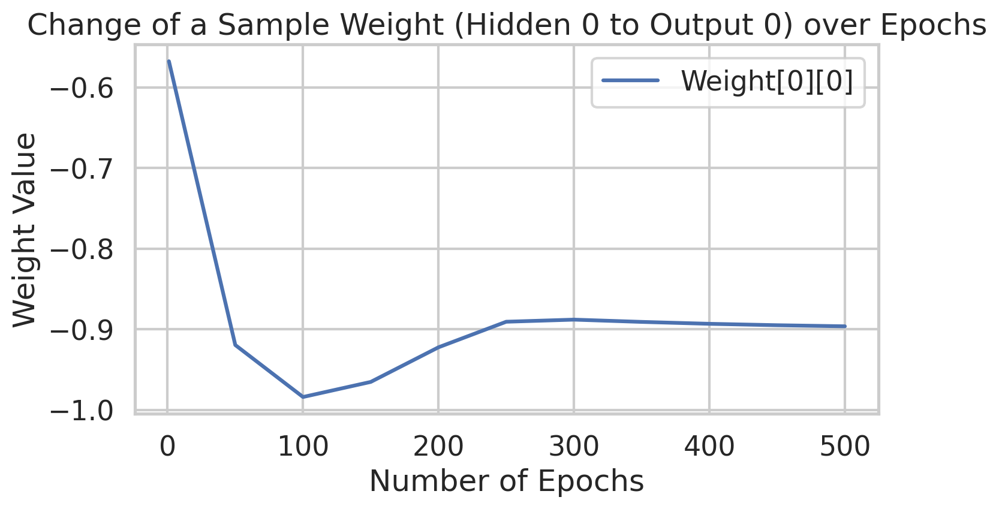

Overall accuracy: 60.00%
 - Accuracy Setosa: 60.00%
 - Accuracy Versicolour: 55.56%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 60.00% hits and 40.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 12 hits
* Iris-Versicolour: 9 samples, 5 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 62.50%
 - Accuracy Setosa: 60.98%
 - Accuracy Versicolour: 60.61%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 62.50% hits and 37.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 50 hits
* Iris-Versicolour: 33 samples, 20 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.1
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.13484443397824938
Epoch  50 - Total Error:  0.020842487300971196
Epoch  100 - Total Error:  0.016893366196333352
Epoch  150 - Total Error:  0.014498323142091632
Epoch  200 - Total Error:  0.009136513288776967
Epoch  250 - Total Error:  0.00

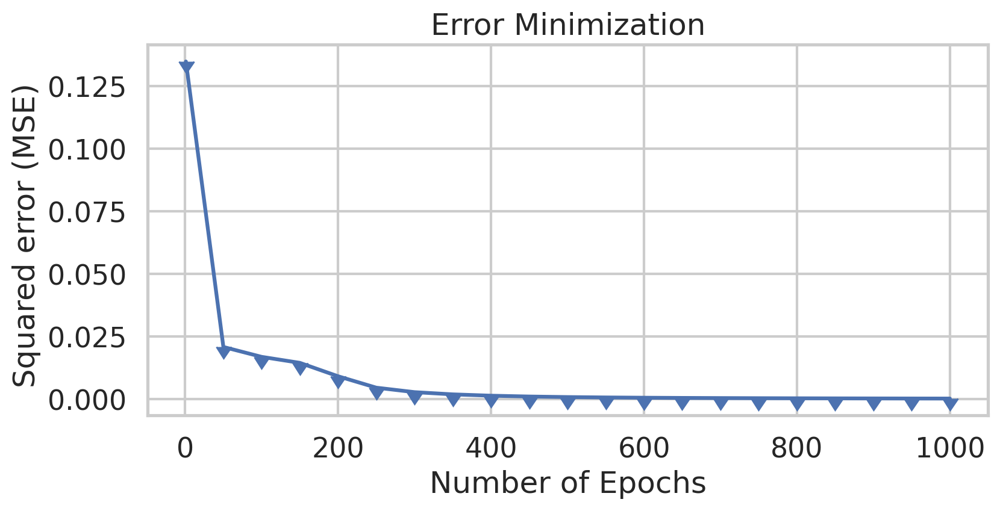

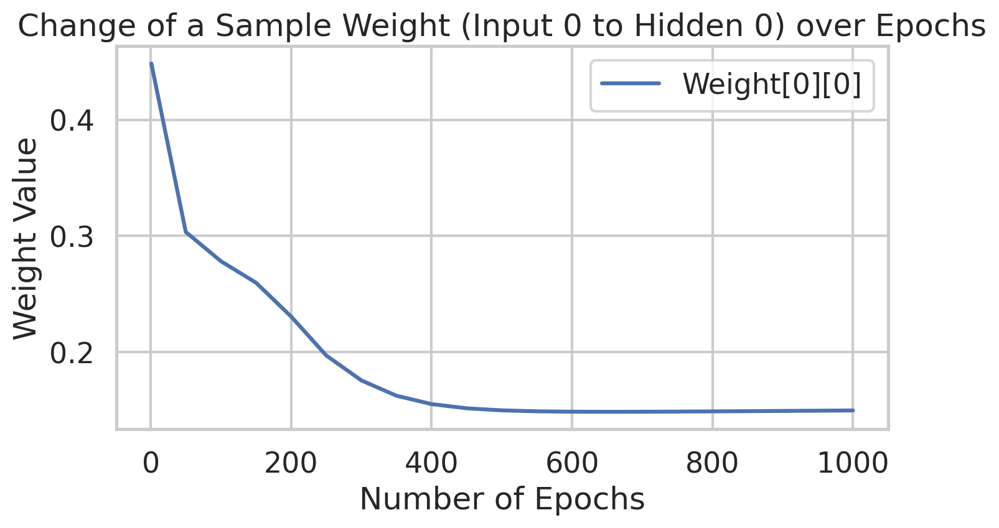

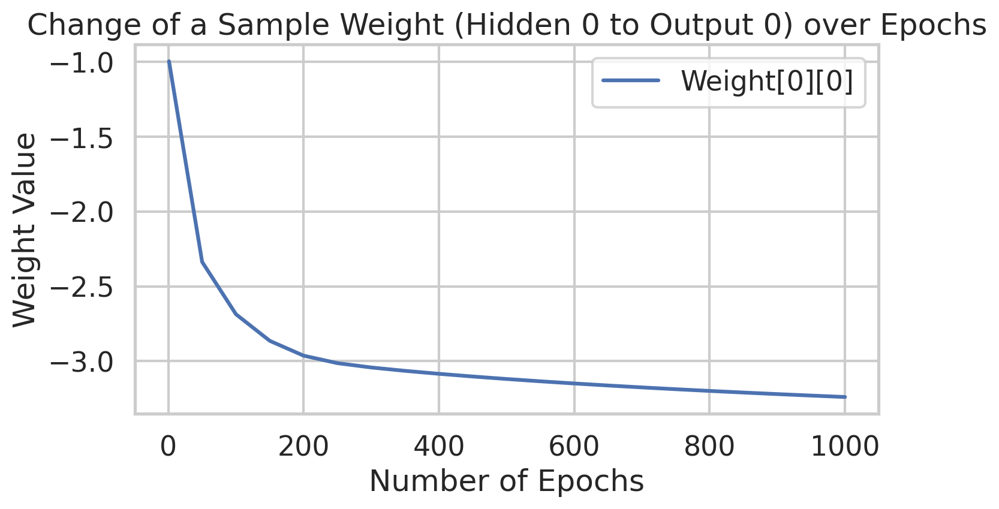

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 29.17%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 40.00%

=== Train Results ===
Porcents : 29.17% hits and 70.83% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 2 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.1
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.20441165138607537
Epoch  50 - Total Error:  0.026320635855444474
Epoch  100 - Total Error:  0.02472498792937515
Epoch  150 - Total Error:  0.023708756084654687
Epoch  200 - Total Error:  0.020477008327589512
Epoch  250 - Total Error:  0.01228300

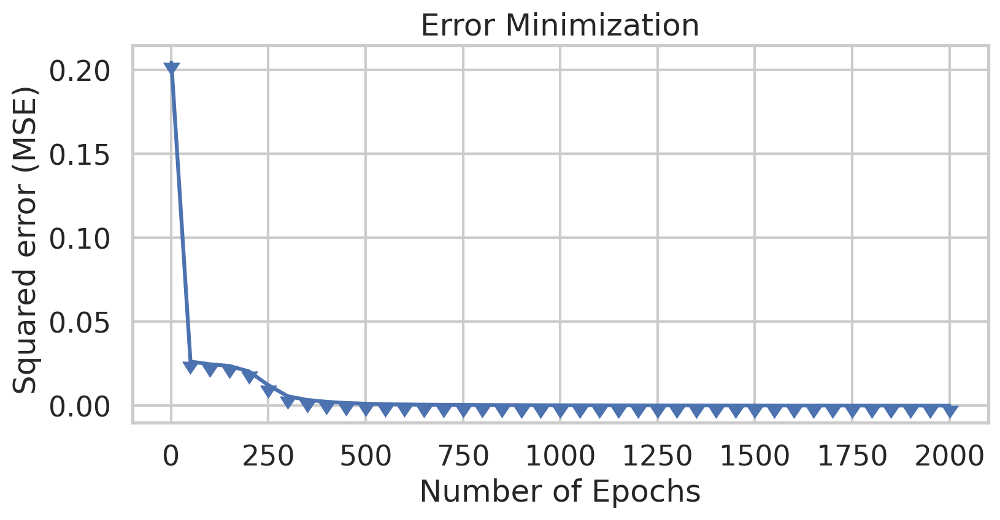

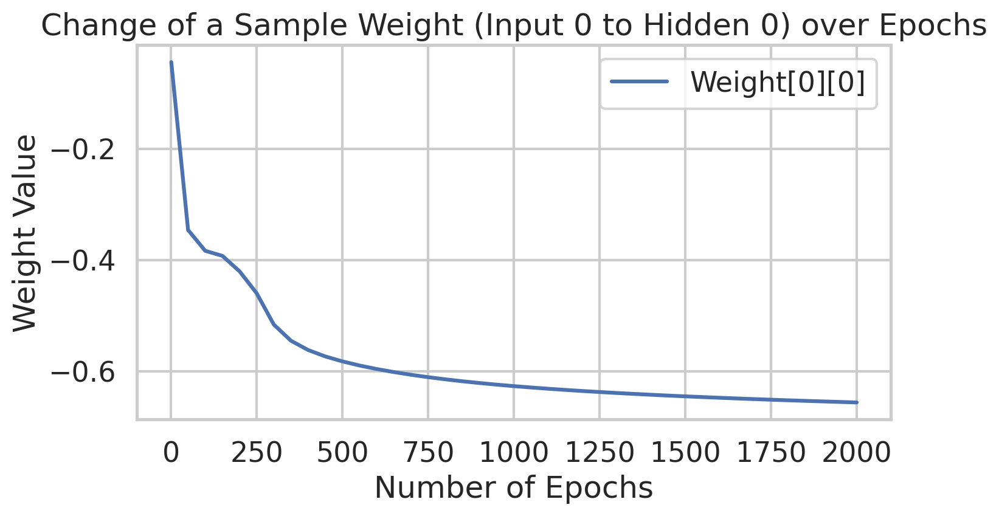

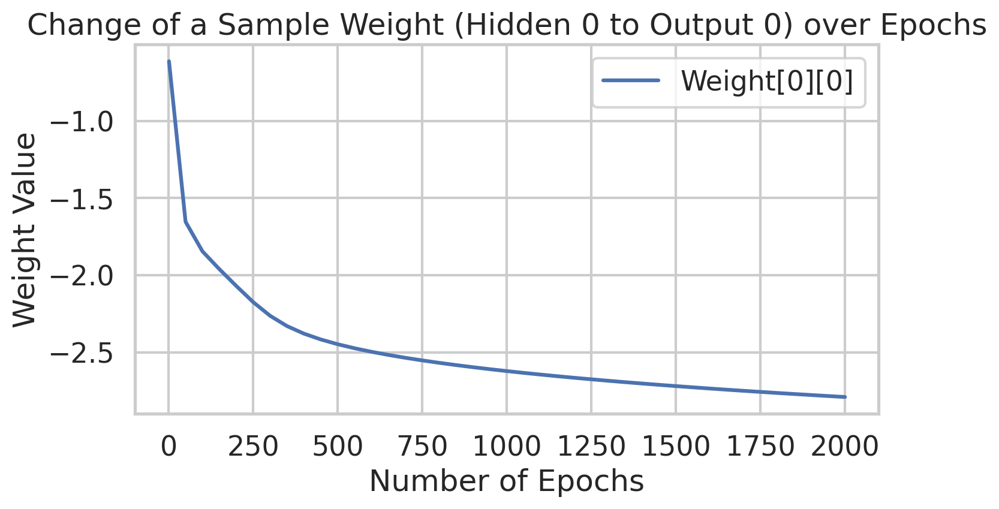

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 27.50%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 27.50% hits and 72.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.1
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.16574768950211366
Epoch  50 - Total Error:  0.025494029507735997
Epoch  100 - Total Error:  0.02487870709510647
Epoch  150 - Total Error:  0.024685605139379136
Epoch  200 - Total Error:  0.0245902578351176
Epoch  250 - Total Error:  0.02453304834

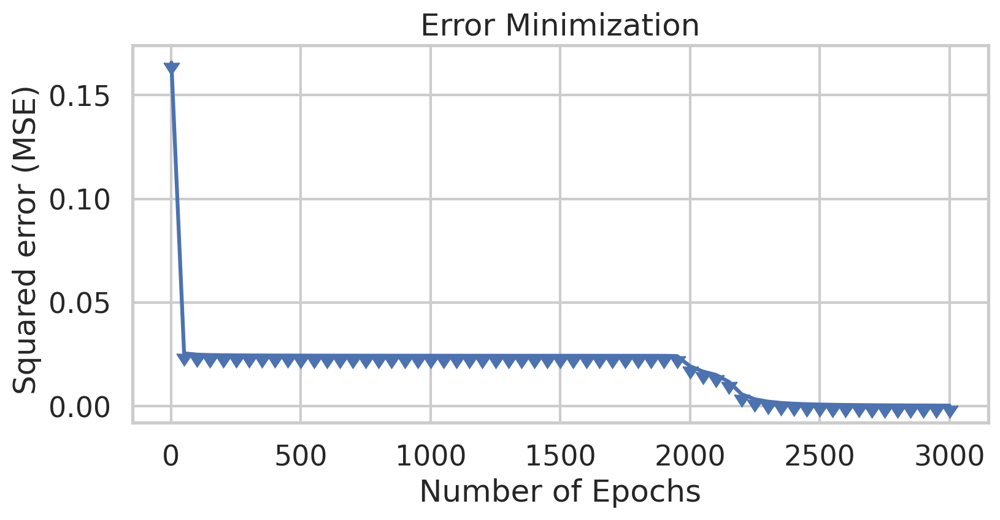

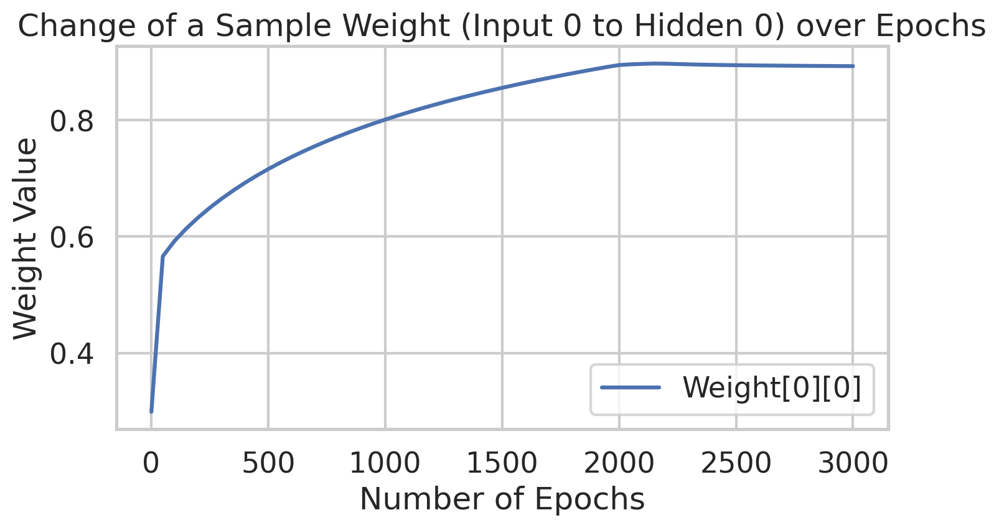

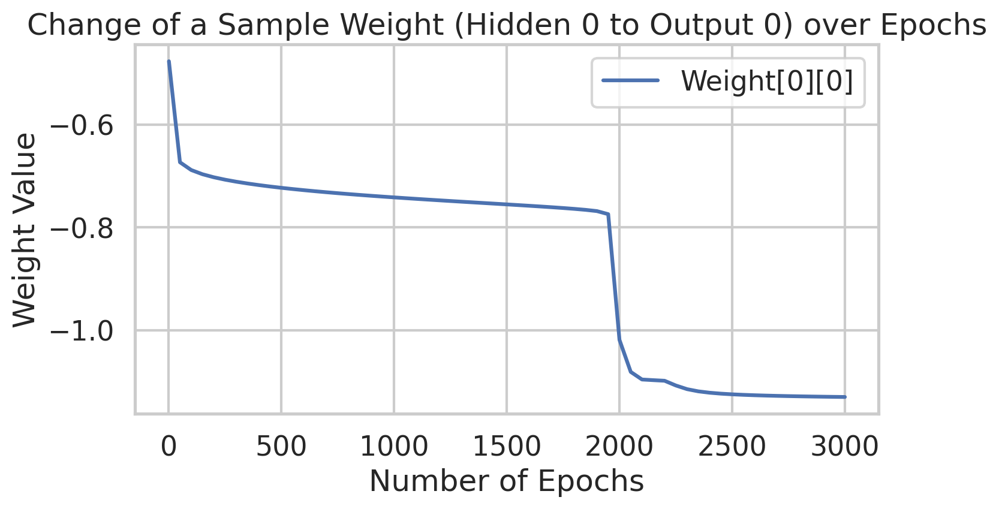

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 88.89%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 8 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 97.50%
 - Accuracy Setosa: 98.78%
 - Accuracy Versicolour: 93.94%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 97.50% hits and 2.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 81 hits
* Iris-Versicolour: 33 samples, 31 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 9
 - Learning Rate: 0.1
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.1657870615867271
Epoch  50 - Total Error:  0.025808332202769377
Epoch  100 - Total Error:  0.024954986717126208
Epoch  150 - Total Error:  0.024615351037806085
Epoch  200 - Total Error:  0.024274175105073
Epoch  250 - Total Error:  0.0233216

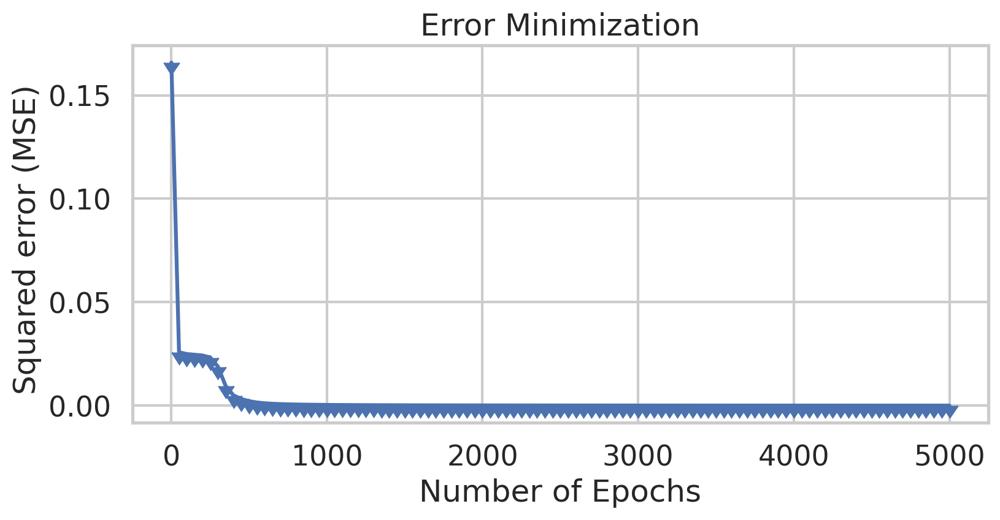

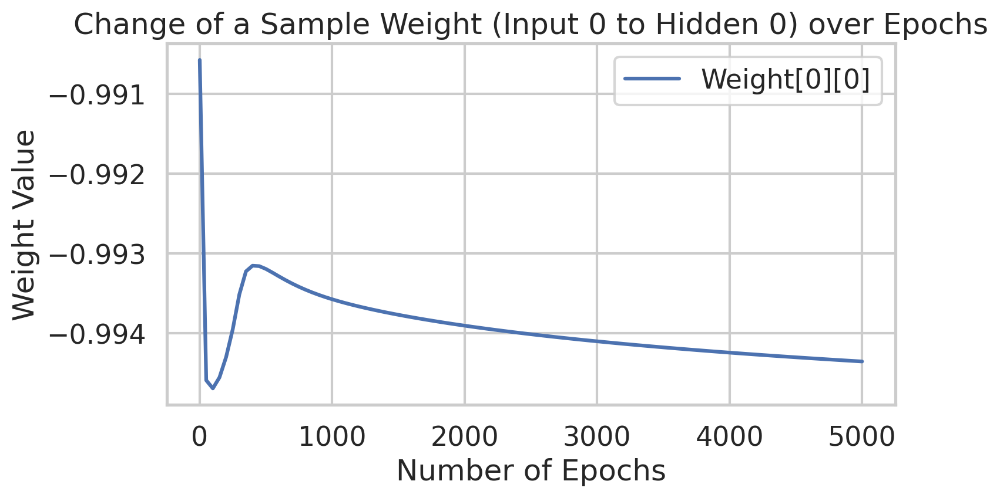

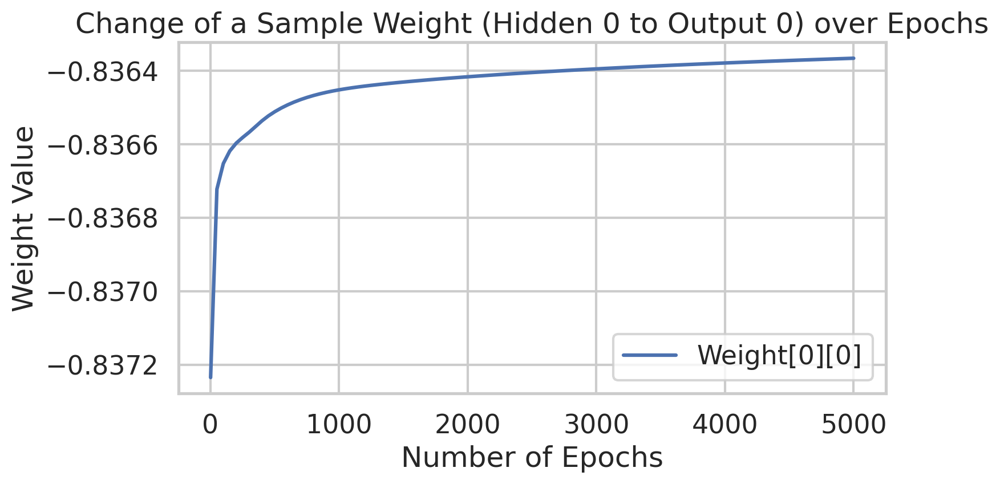

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 27.50%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 27.50% hits and 72.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.001
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.20008416952946134
Epoch  50 - Total Error:  0.16025435707879726
Epoch  100 - Total Error:  0.15059704399685667
Epoch  150 - Total Error:  0.14422866063371964
Epoch  200 - Total Error:  0.13170441305775368
Epoch  250 - Total Error:  0.0997066766

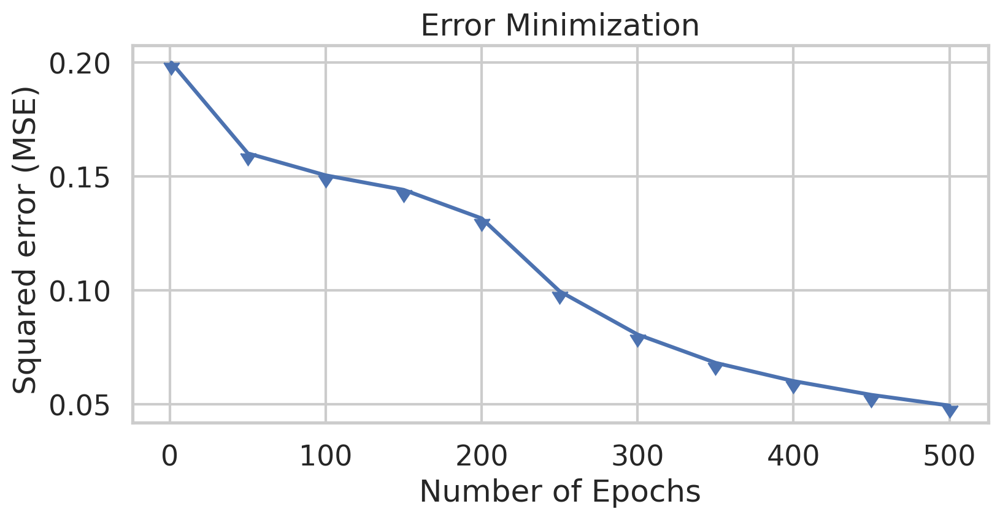

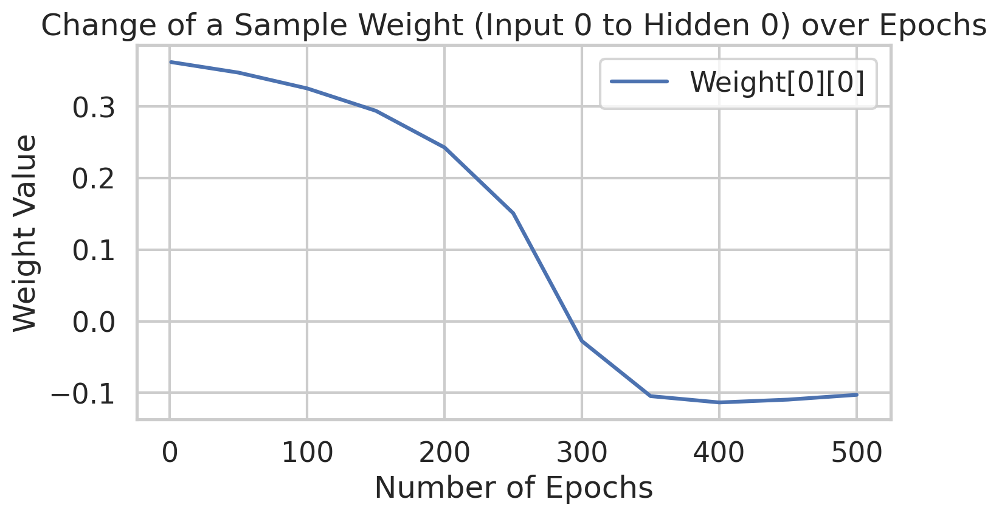

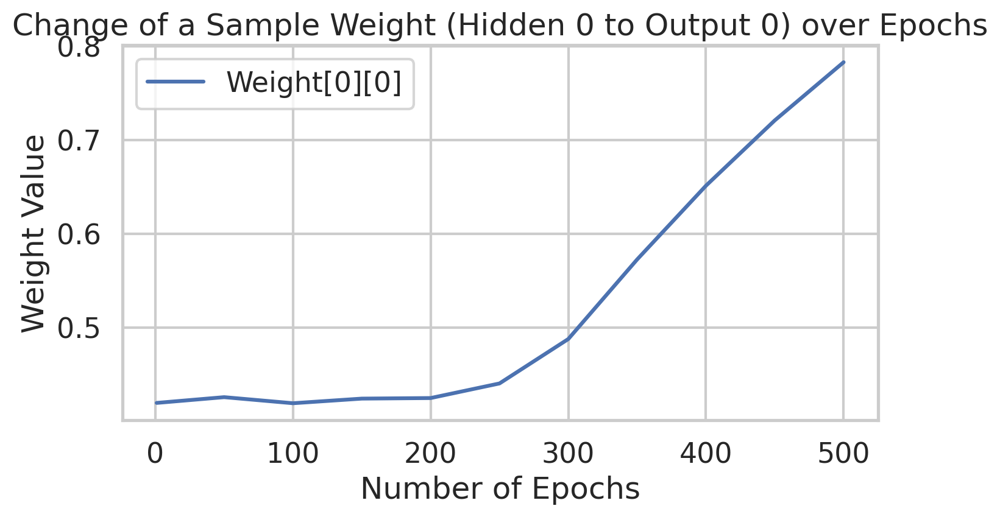

Overall accuracy: 73.33%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 22.22%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 73.33% hits and 26.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 2 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 75.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 24.24%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 75.00% hits and 25.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 8 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.001
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2786683174308856
Epoch  50 - Total Error:  0.153110150864798
Epoch  100 - Total Error:  0.14151522865183447
Epoch  150 - Total Error:  0.13386583558368595
Epoch  200 - Total Error:  0.12338533061809845
Epoch  250 - Total Error:  0.109462349

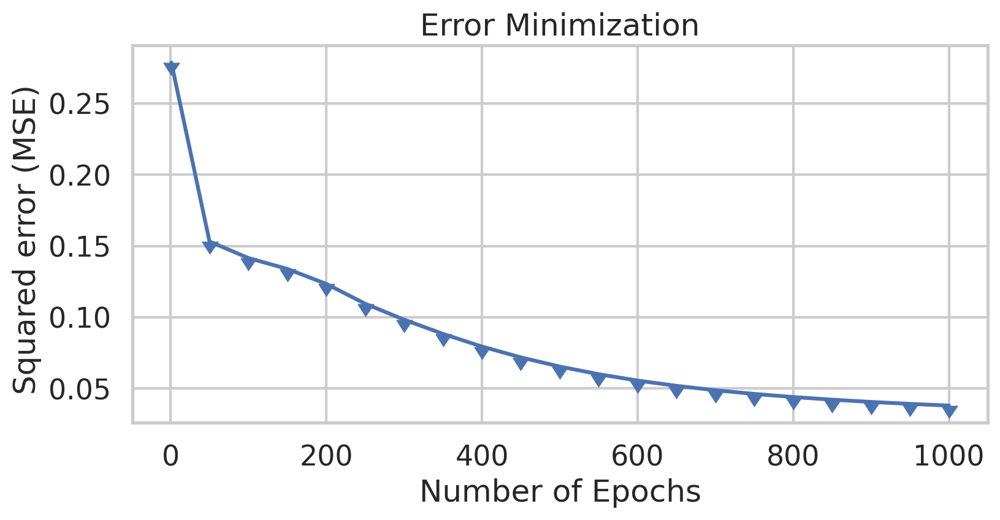

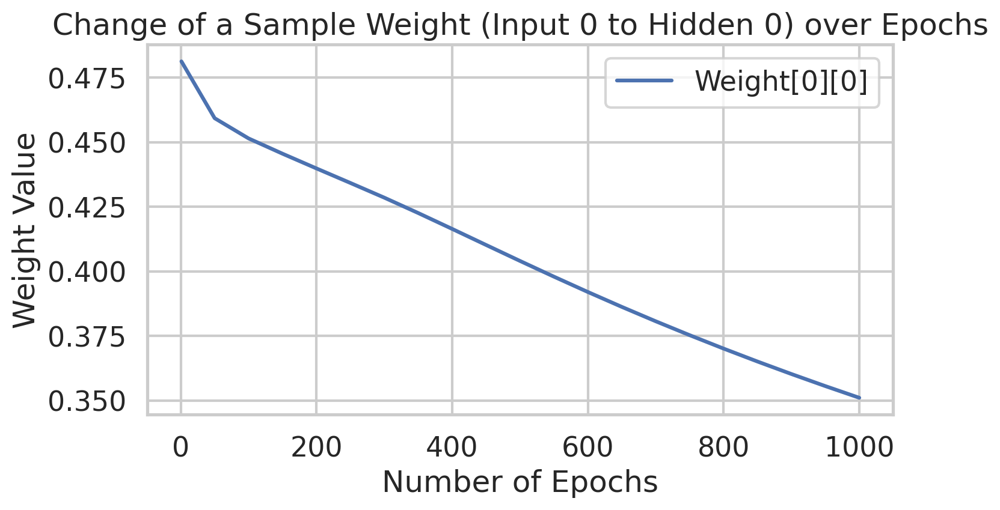

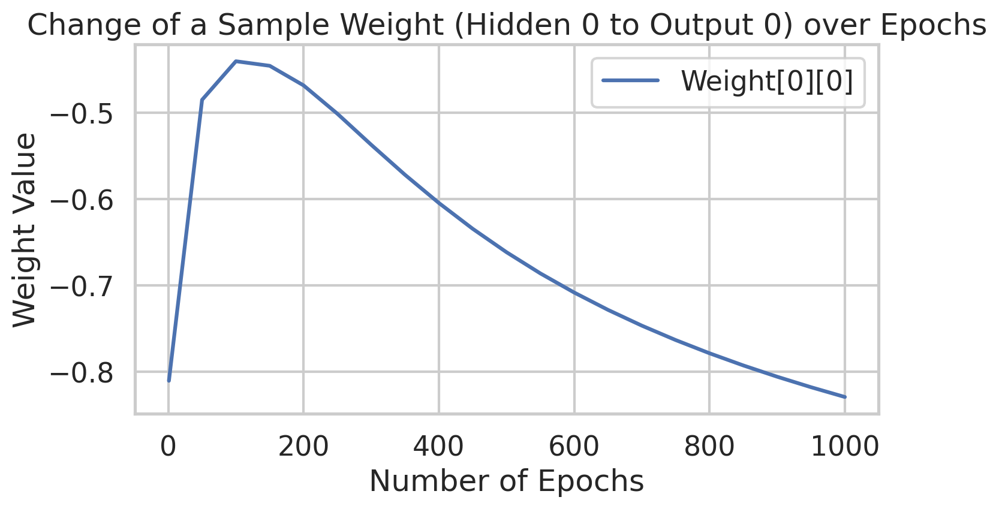

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.001
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2448112696351119
Epoch  50 - Total Error:  0.14615307416196732
Epoch  100 - Total Error:  0.12721564008531472
Epoch  150 - Total Error:  0.1157934975840629
Epoch  200 - Total Error:  0.10620678601694195
Epoch  250 - Total Error:  0.0977021

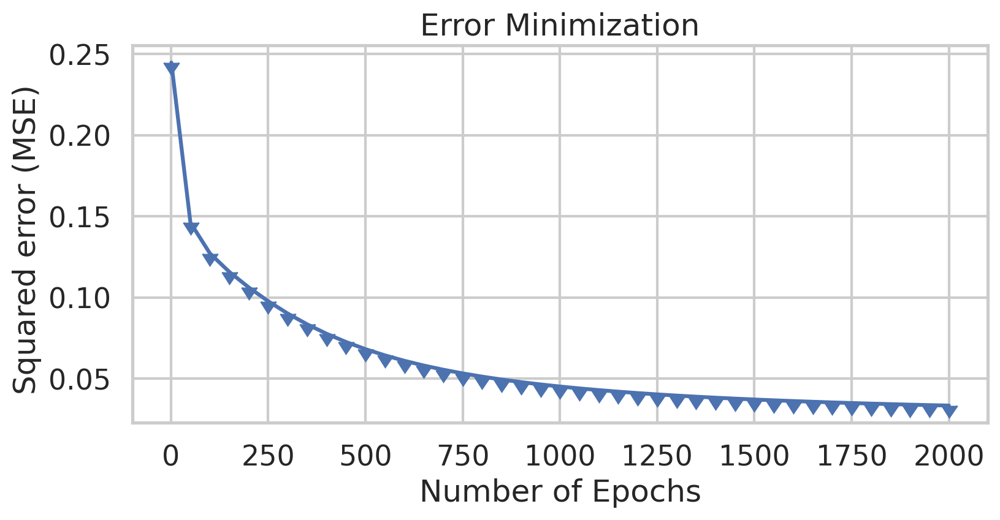

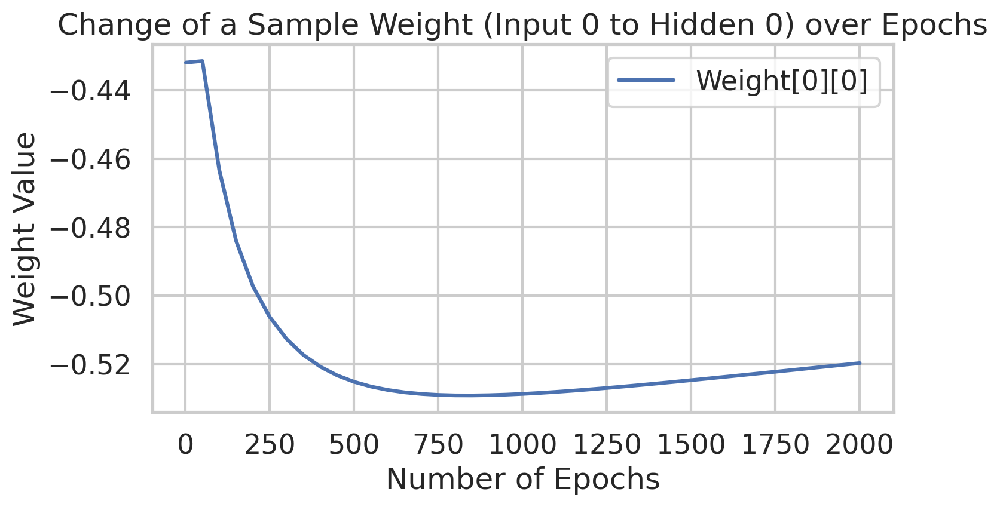

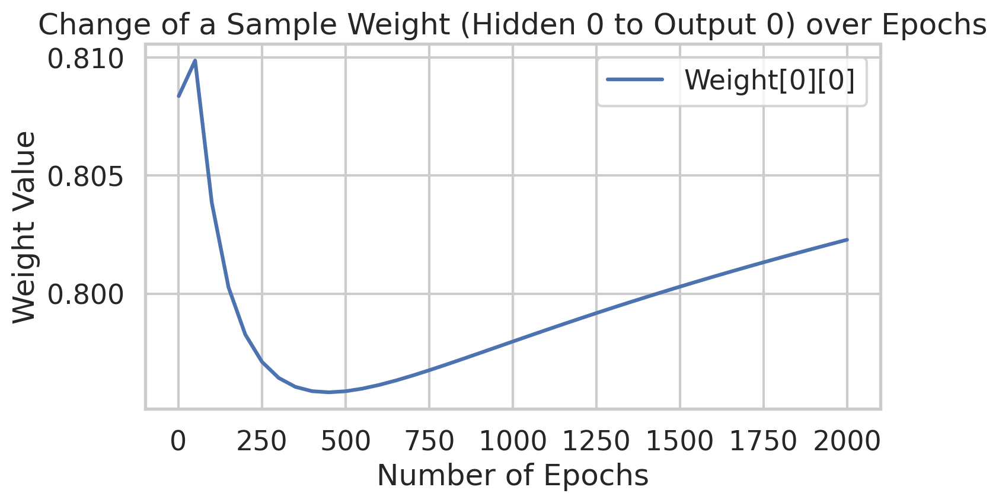

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 96.97%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.00% hits and 5.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 32 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.001
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.35605275353226773
Epoch  50 - Total Error:  0.15457247921615735
Epoch  100 - Total Error:  0.12826269513189792
Epoch  150 - Total Error:  0.10889303598981663
Epoch  200 - Total Error:  0.09194946860665648
Epoch  250 - Total Error:  0.077616

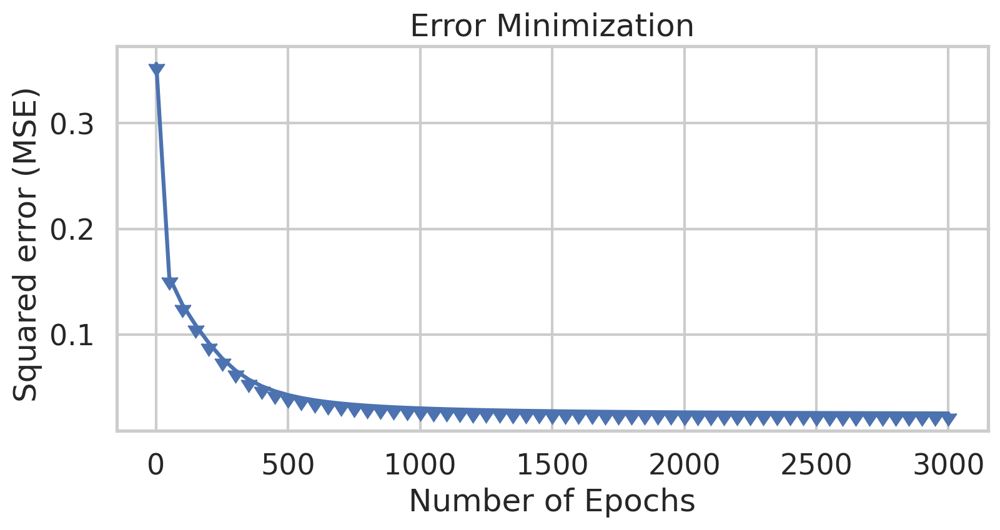

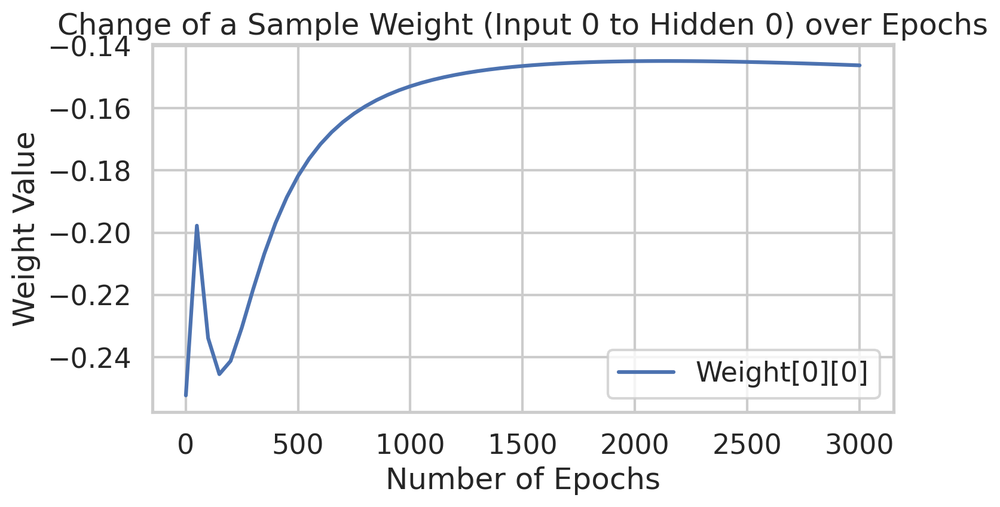

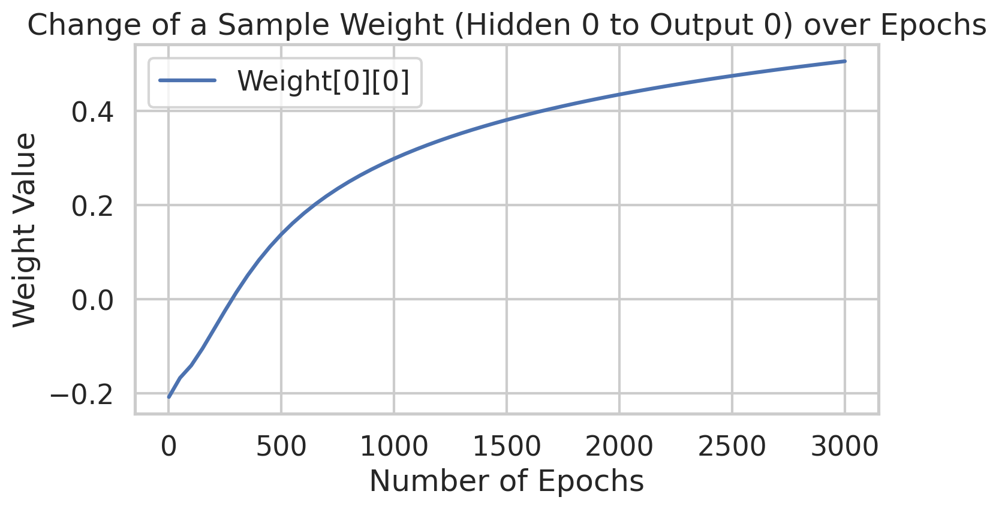

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.001
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.33471446676550465
Epoch  50 - Total Error:  0.15076982440054854
Epoch  100 - Total Error:  0.13623770113778566
Epoch  150 - Total Error:  0.12101759415244998
Epoch  200 - Total Error:  0.10324839200675132
Epoch  250 - Total Error:  0.08662

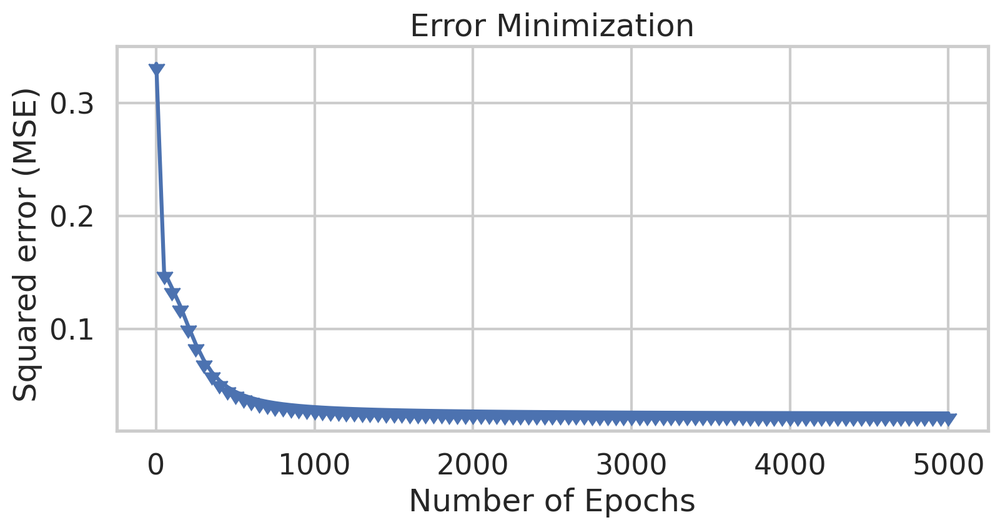

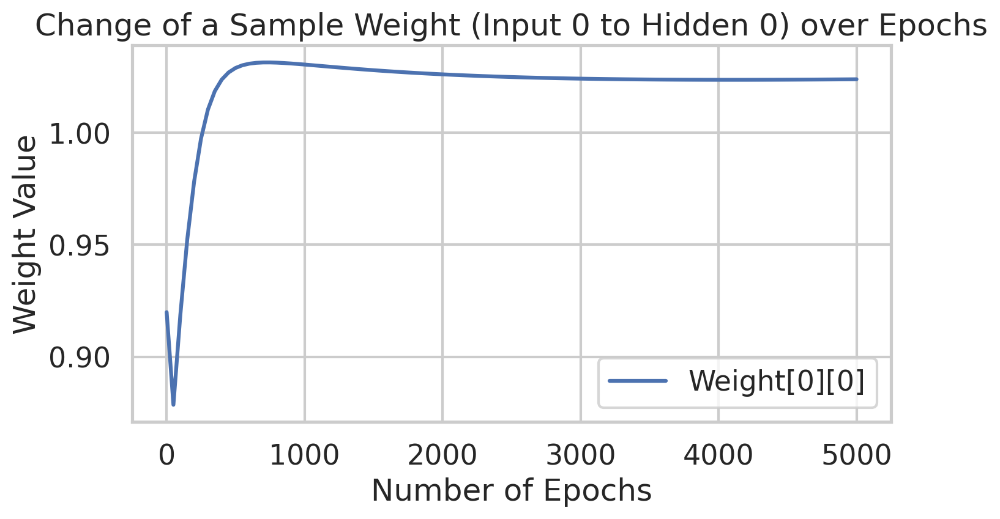

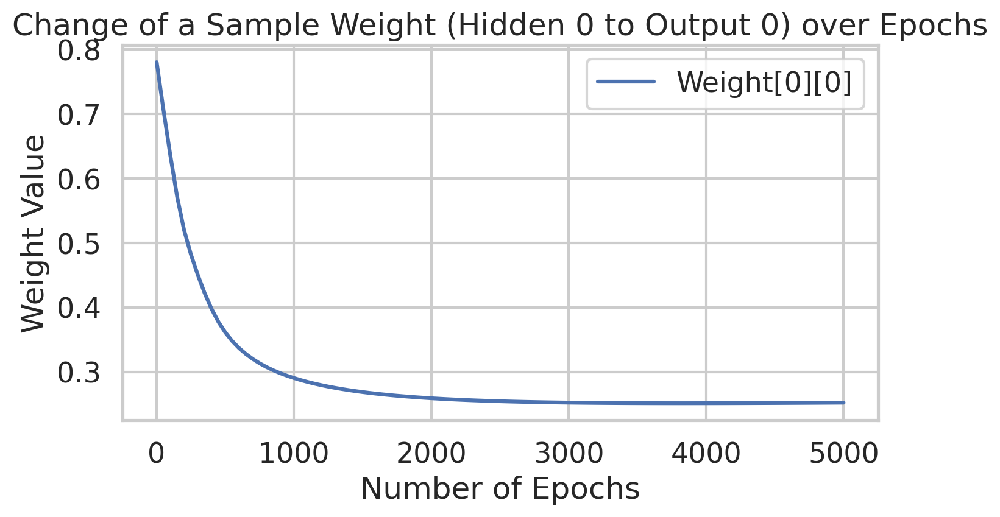

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.005
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3143892473997109
Epoch  50 - Total Error:  0.08532601004110744
Epoch  100 - Total Error:  0.04658717541701773
Epoch  150 - Total Error:  0.03643506499790867
Epoch  200 - Total Error:  0.0327172952329773
Epoch  250 - Total Error:  0.03089842

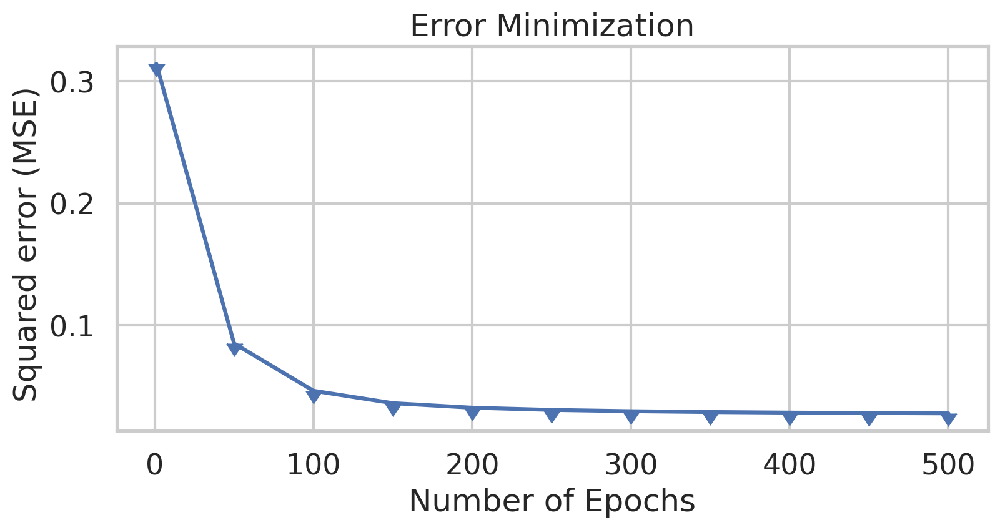

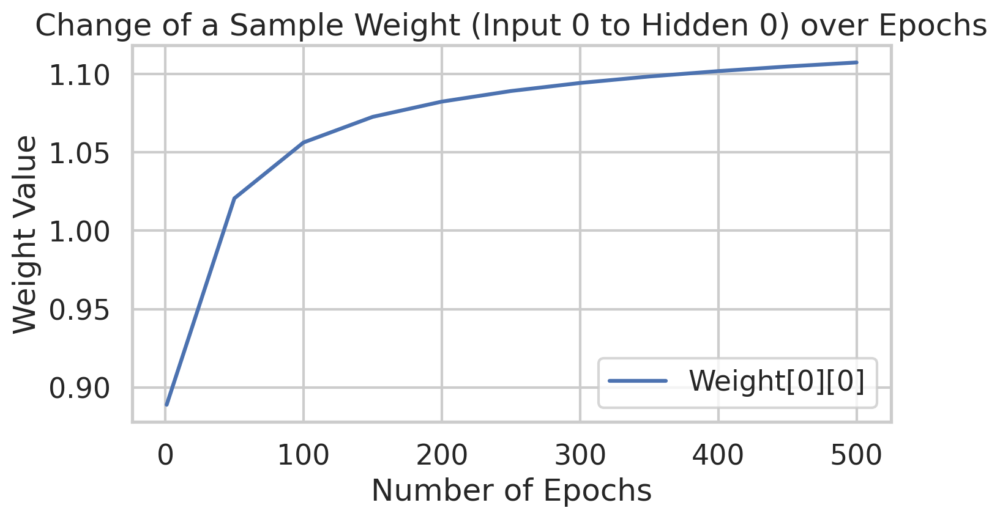

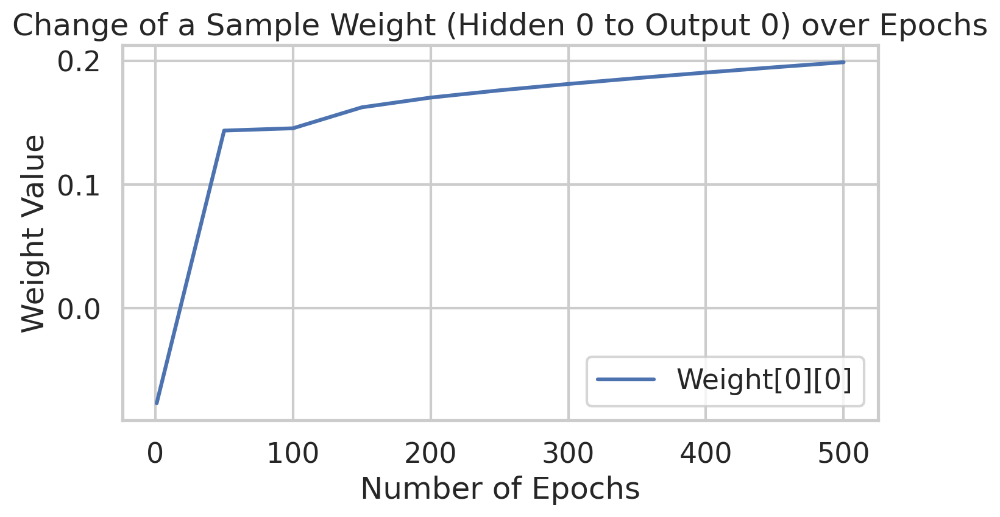

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.005
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.2039488728818369
Epoch  50 - Total Error:  0.07329394228455524
Epoch  100 - Total Error:  0.04434733400328506
Epoch  150 - Total Error:  0.034712145764807044
Epoch  200 - Total Error:  0.03077758117223787
Epoch  250 - Total Error:  0.02880

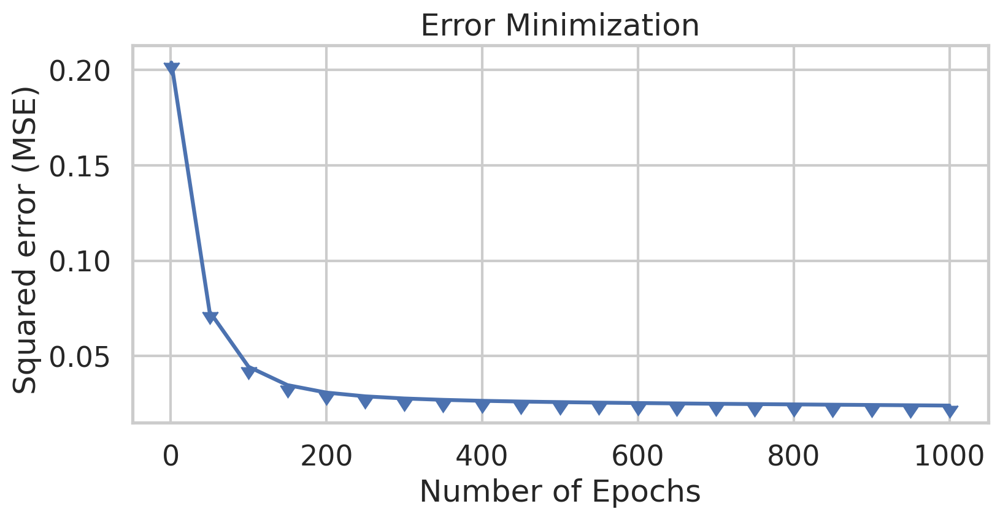

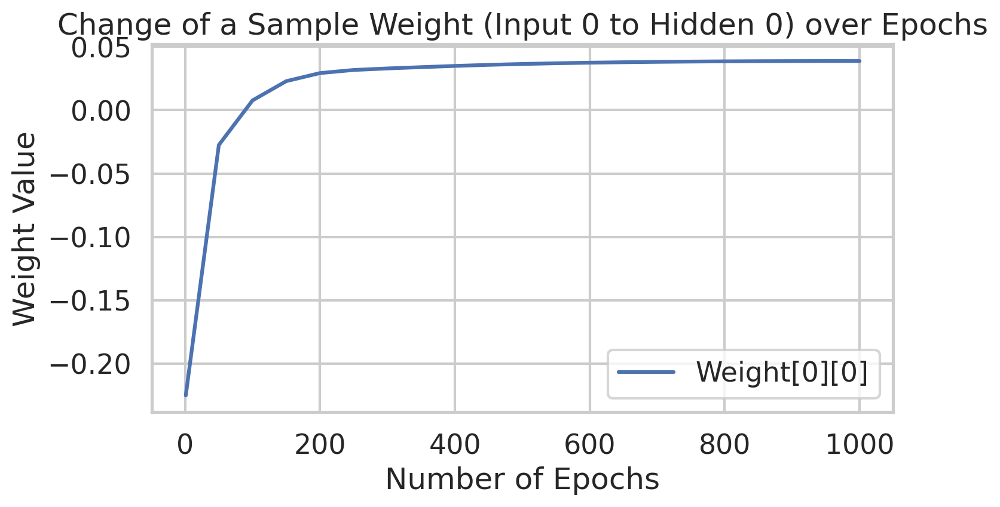

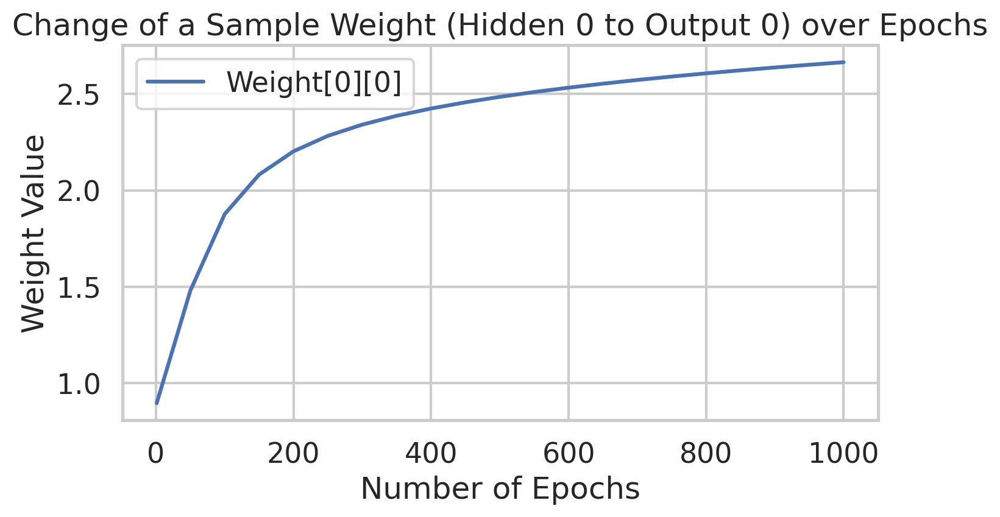

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.005
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.20417033721517536
Epoch  50 - Total Error:  0.08647916736691817
Epoch  100 - Total Error:  0.04839803846368656
Epoch  150 - Total Error:  0.03640949523844487
Epoch  200 - Total Error:  0.03177066867997531
Epoch  250 - Total Error:  0.02946

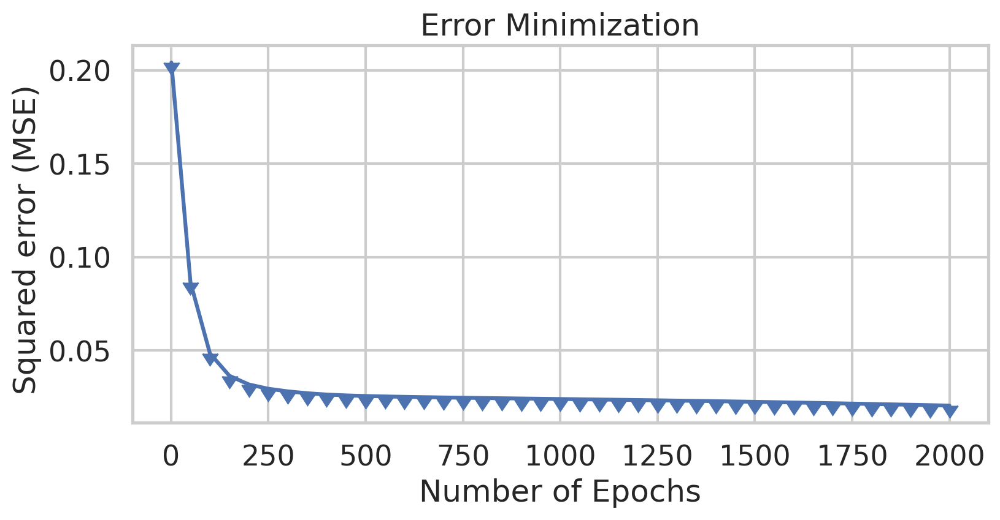

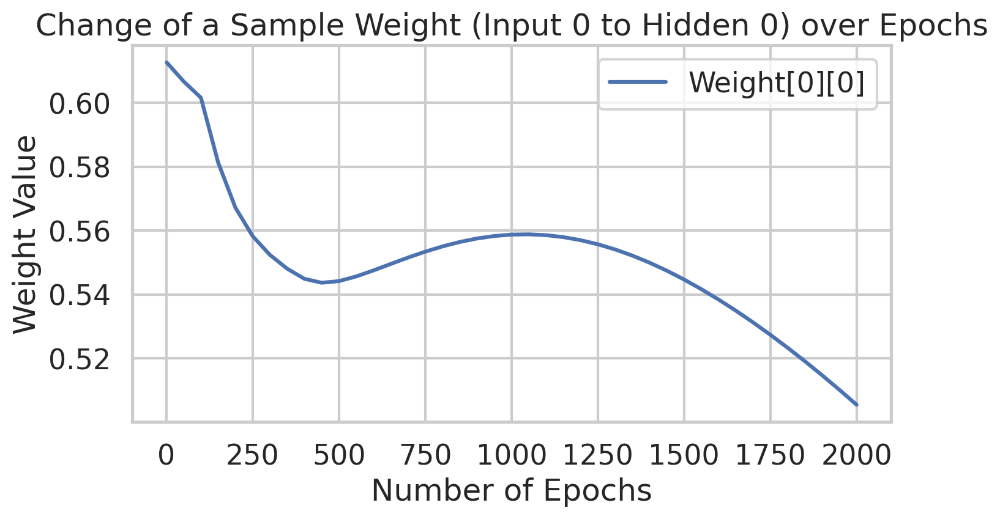

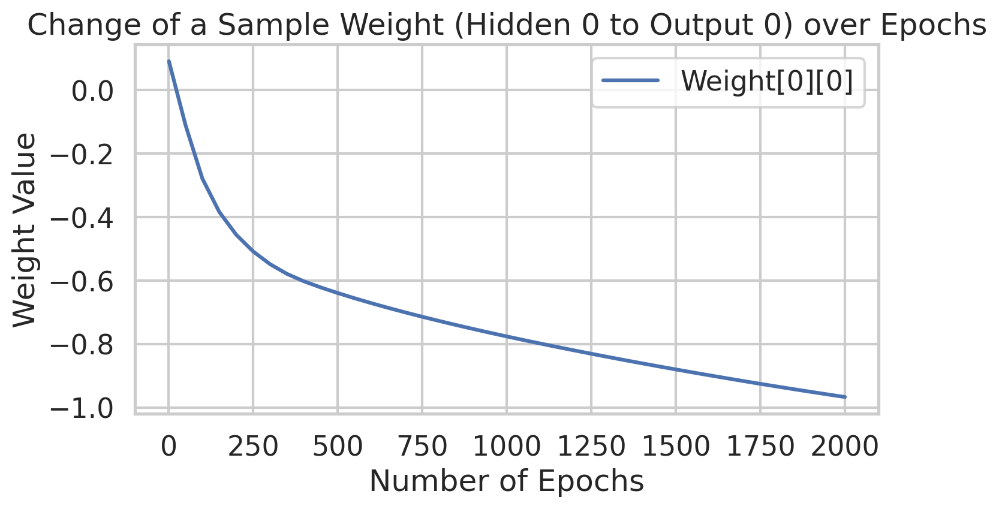

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.005
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.30791626728804034
Epoch  50 - Total Error:  0.06173932721530227
Epoch  100 - Total Error:  0.04120760367532919
Epoch  150 - Total Error:  0.03418726955697211
Epoch  200 - Total Error:  0.03105944113810629
Epoch  250 - Total Error:  0.02937

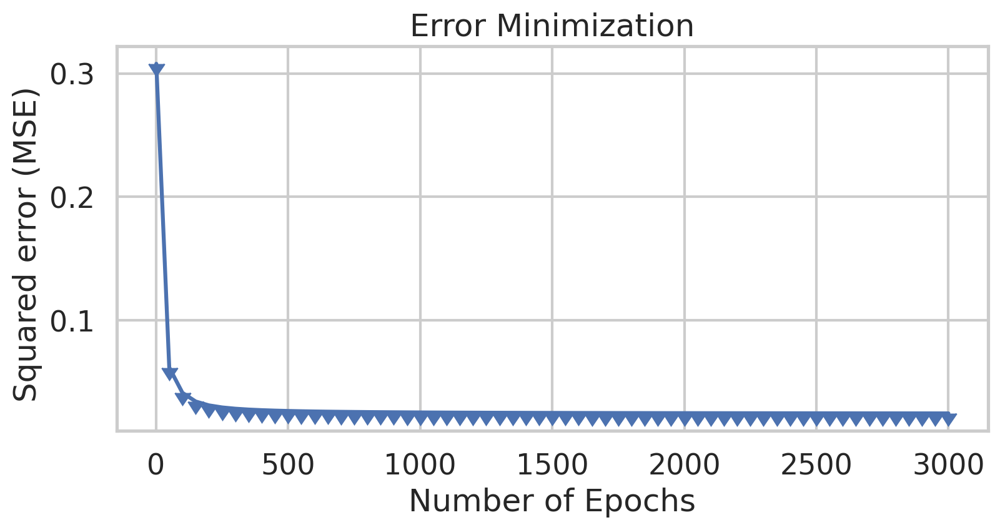

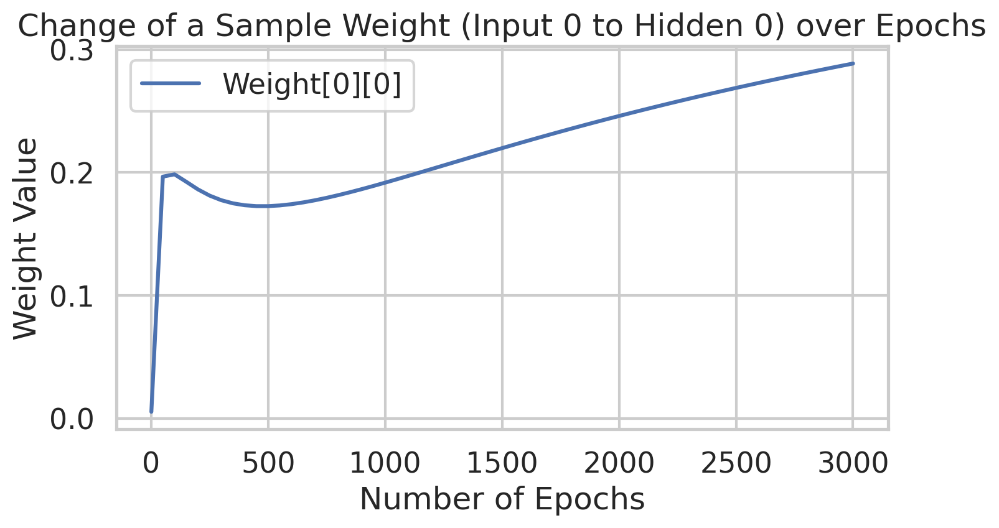

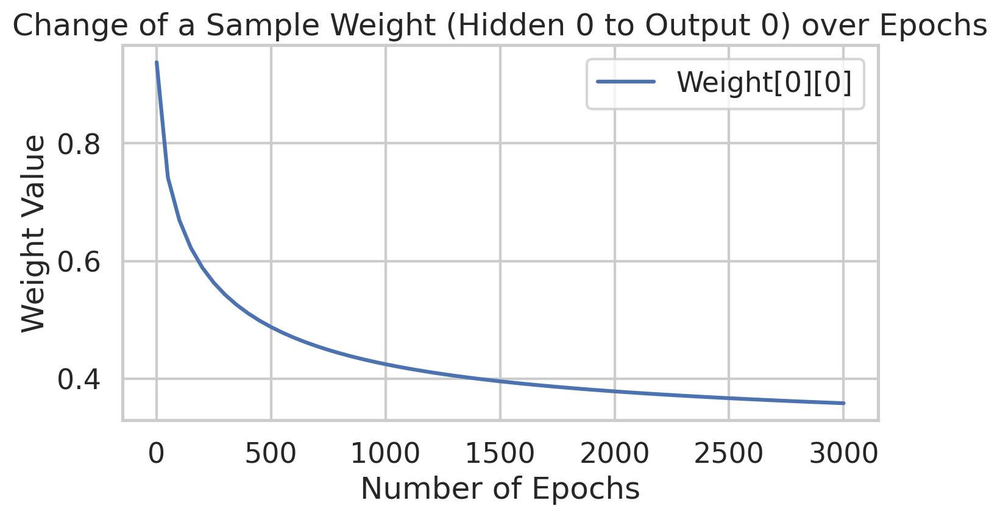

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.005
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.3403544177763384
Epoch  50 - Total Error:  0.06969344238420495
Epoch  100 - Total Error:  0.04186639246497934
Epoch  150 - Total Error:  0.03350582037345349
Epoch  200 - Total Error:  0.030064369197379103
Epoch  250 - Total Error:  0.02827

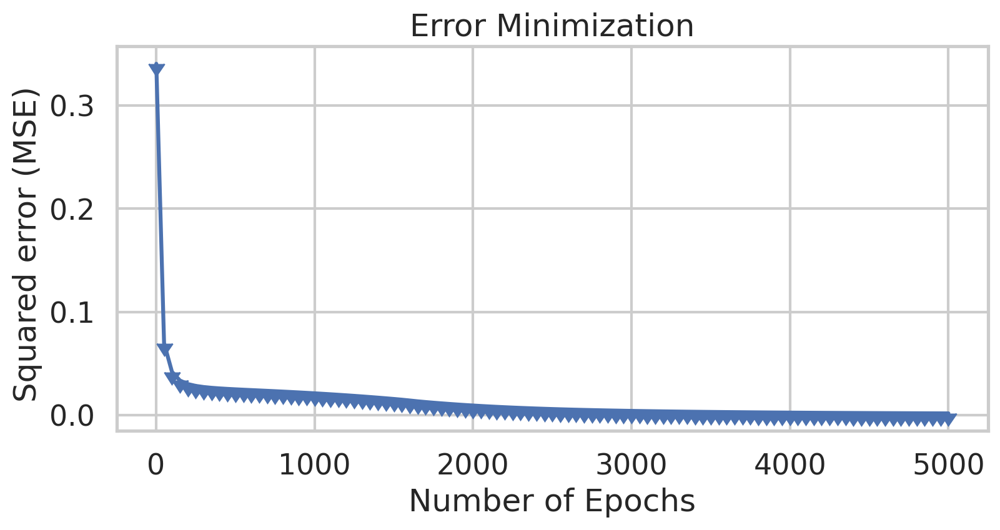

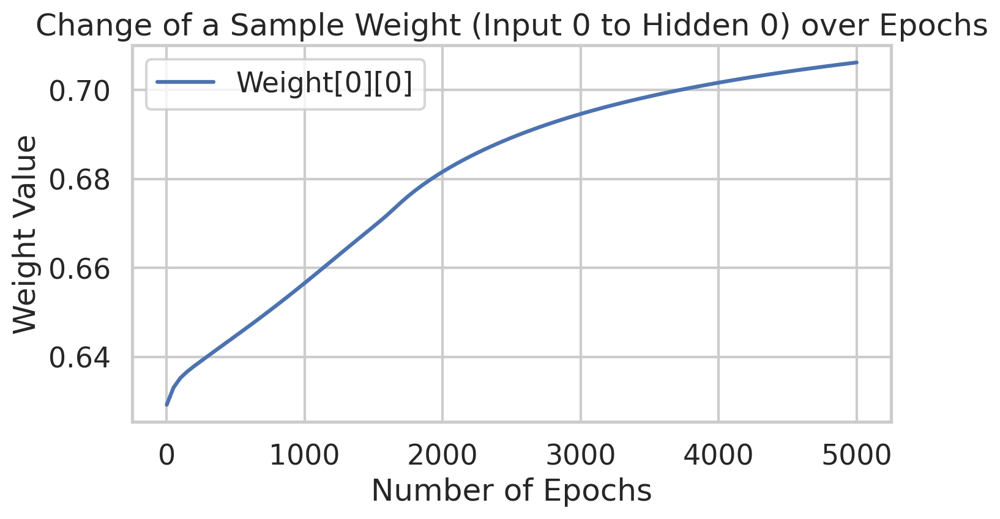

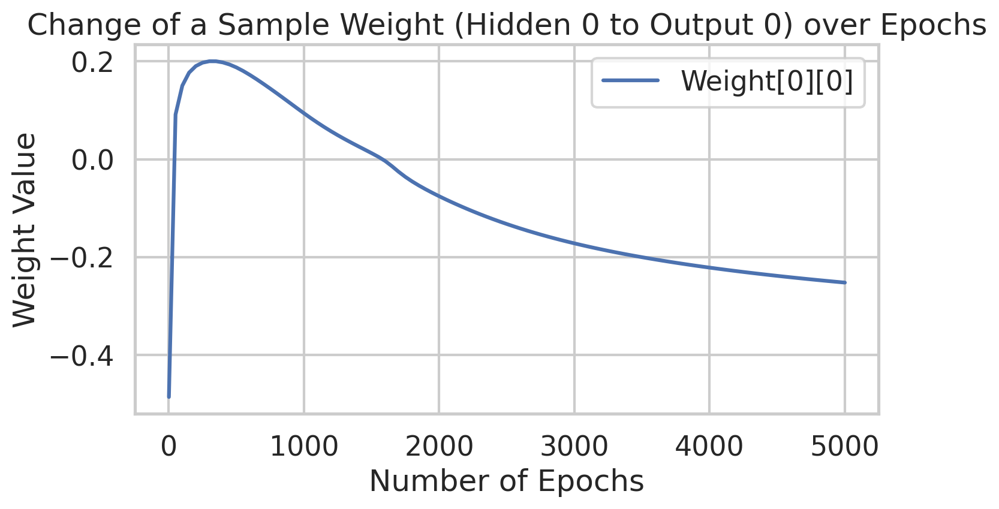

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.01
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.19328358686676494
Epoch  50 - Total Error:  0.05246897863233912
Epoch  100 - Total Error:  0.03402628225983589
Epoch  150 - Total Error:  0.029923764131336173
Epoch  200 - Total Error:  0.028251358715138186
Epoch  250 - Total Error:  0.02729

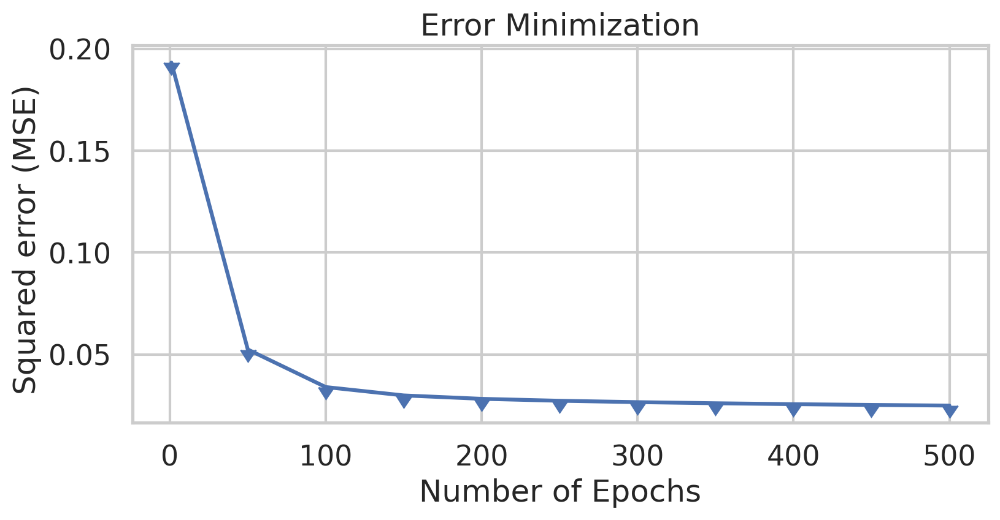

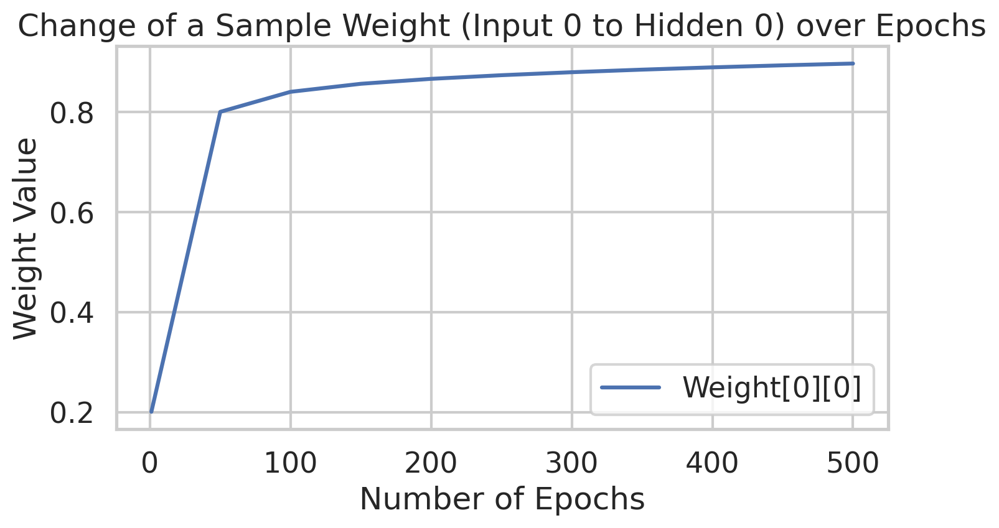

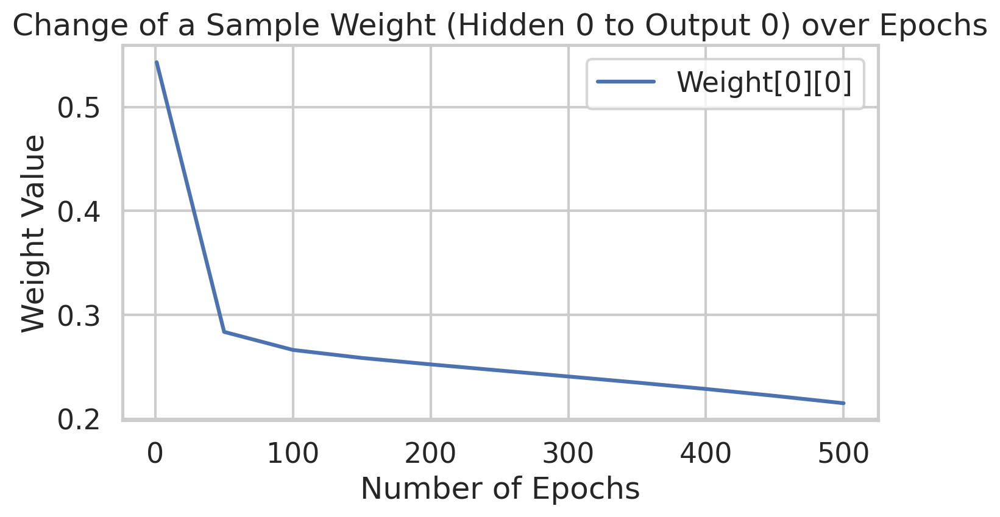

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.01
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.1604531803852467
Epoch  50 - Total Error:  0.0409269489497025
Epoch  100 - Total Error:  0.03024156842237241
Epoch  150 - Total Error:  0.027729710511330576
Epoch  200 - Total Error:  0.026658425569036814
Epoch  250 - Total Error:  0.026069

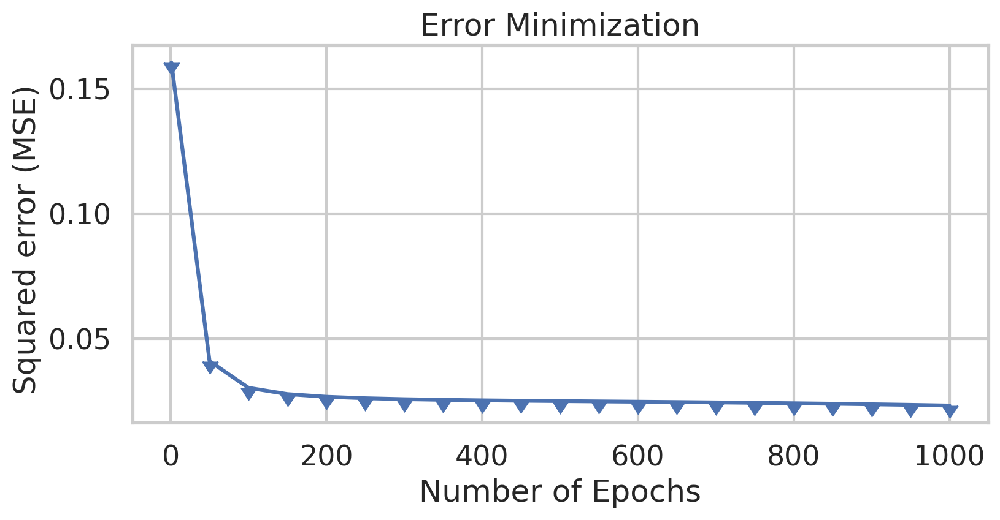

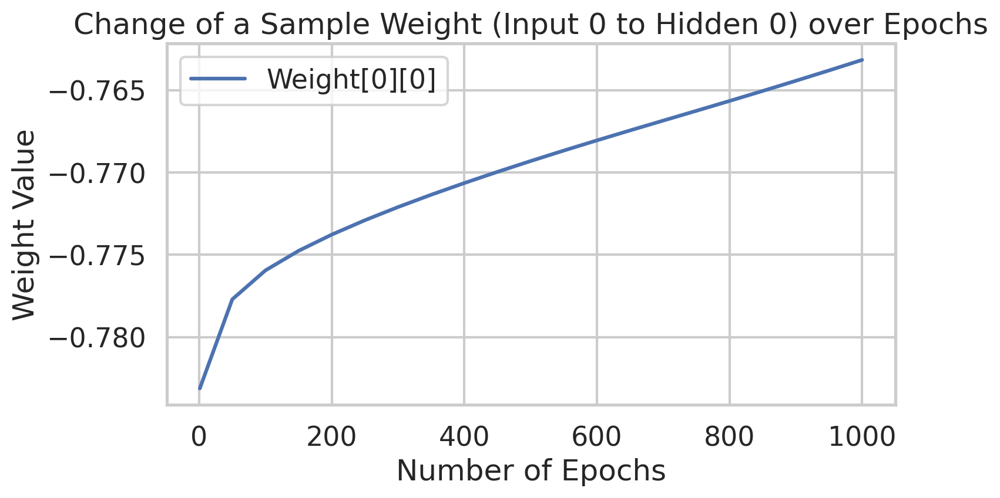

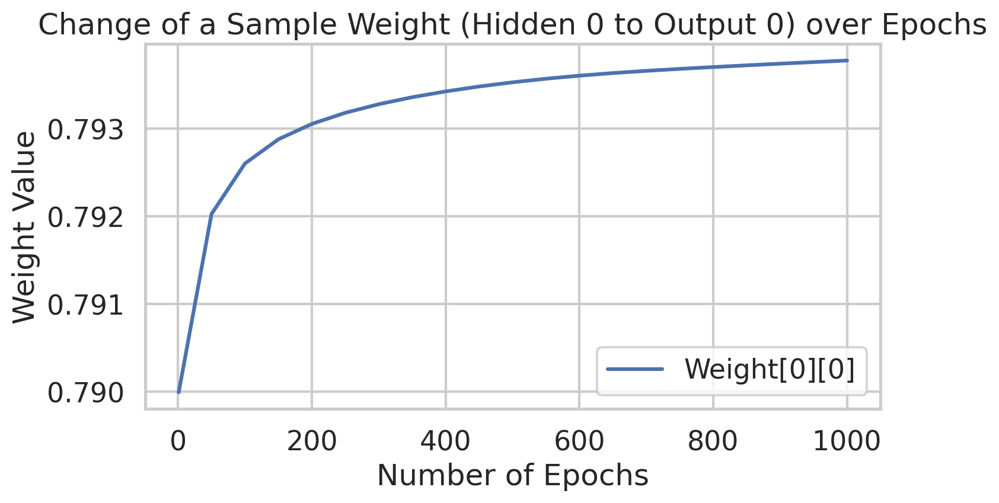

Overall accuracy: 96.67%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 96.67% hits and 3.33% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 95.83%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 95.83% hits and 4.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.01
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.20776839090657395
Epoch  50 - Total Error:  0.04351186536355793
Epoch  100 - Total Error:  0.031155191360114888
Epoch  150 - Total Error:  0.028284827706577167
Epoch  200 - Total Error:  0.027075401700465355
Epoch  250 - Total Error:  0.026

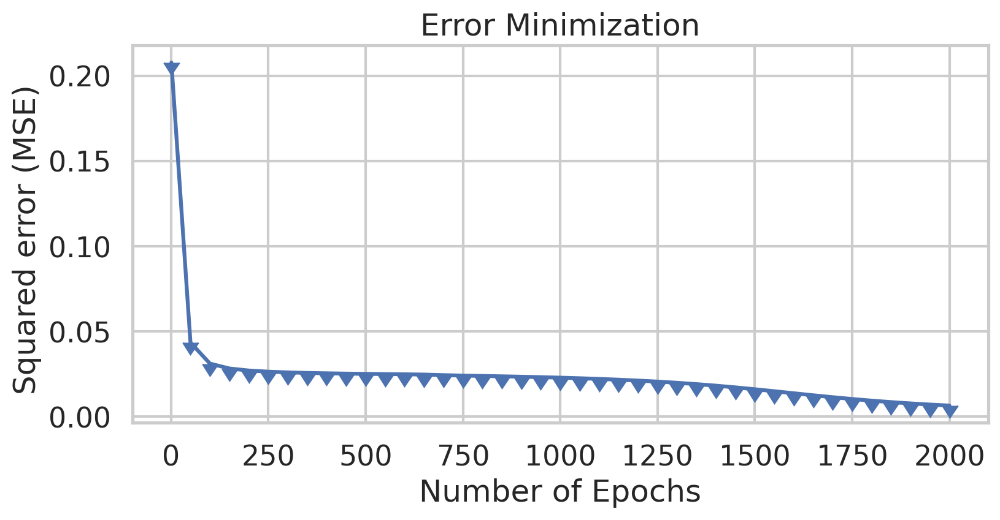

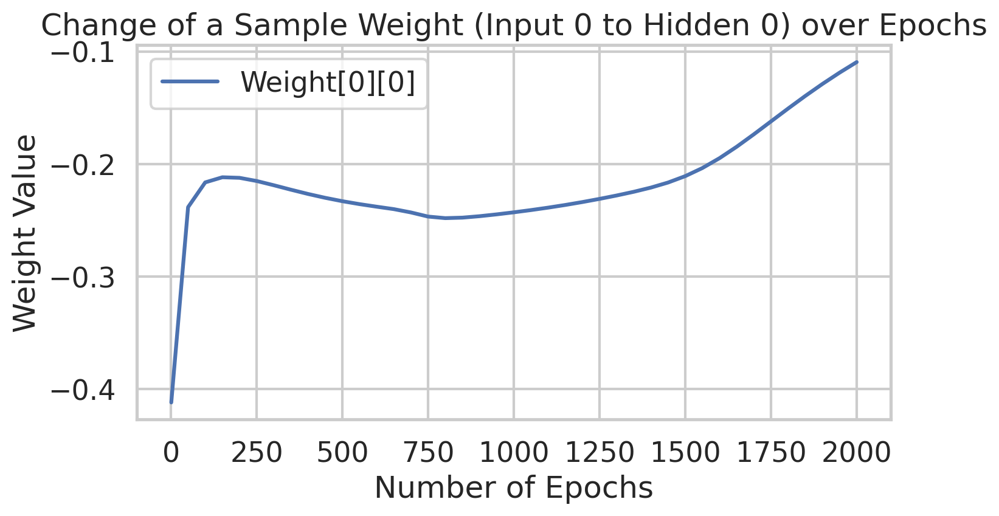

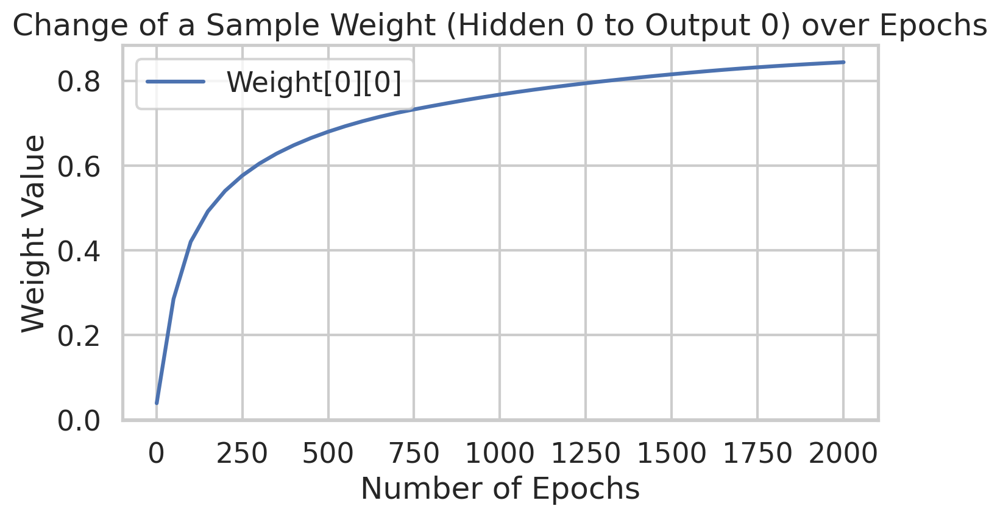

Overall accuracy: 43.33%
 - Accuracy Setosa: 20.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 43.33% hits and 56.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 4 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 37.50%
 - Accuracy Setosa: 14.63%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 37.50% hits and 62.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 12 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.01
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.22312301880556334
Epoch  50 - Total Error:  0.04150466354964748
Epoch  100 - Total Error:  0.030676378972919284
Epoch  150 - Total Error:  0.026947403729126282
Epoch  200 - Total Error:  0.025211227114835665
Epoch  250 - Total Error:  0.0239

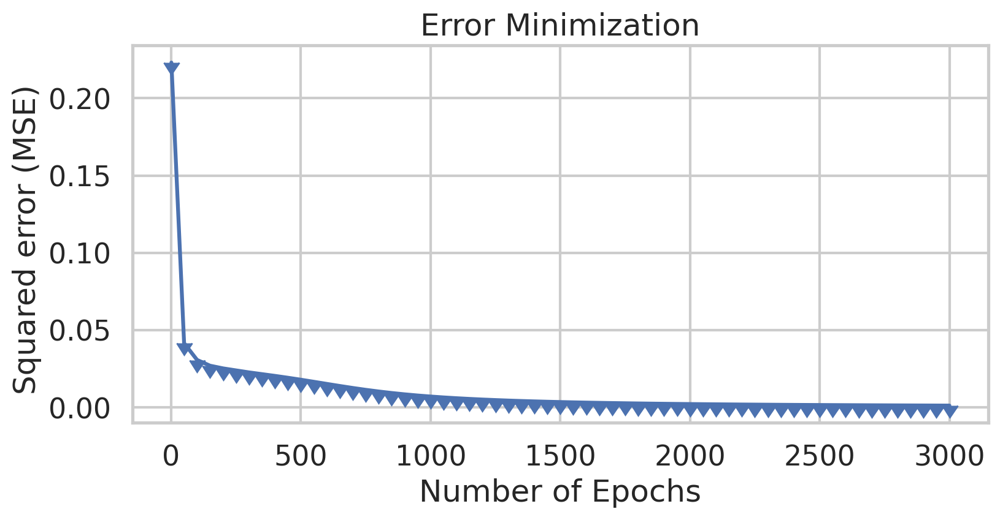

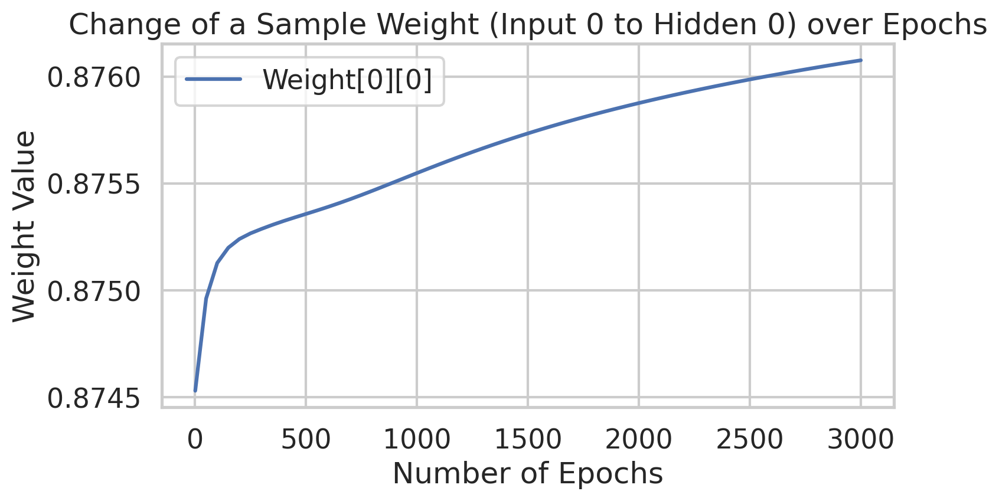

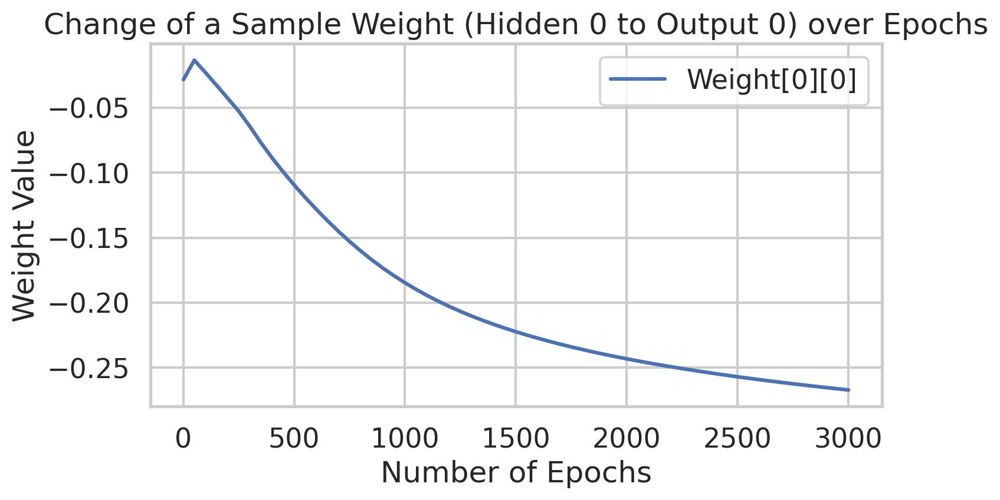

Overall accuracy: 33.33%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 33.33% hits and 66.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 29.17%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 40.00%

=== Train Results ===
Porcents : 29.17% hits and 70.83% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 2 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.01
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.18330196966460308
Epoch  50 - Total Error:  0.04001236932847671
Epoch  100 - Total Error:  0.03134854427728991
Epoch  150 - Total Error:  0.029119153591956683
Epoch  200 - Total Error:  0.028149123798175118
Epoch  250 - Total Error:  0.02760

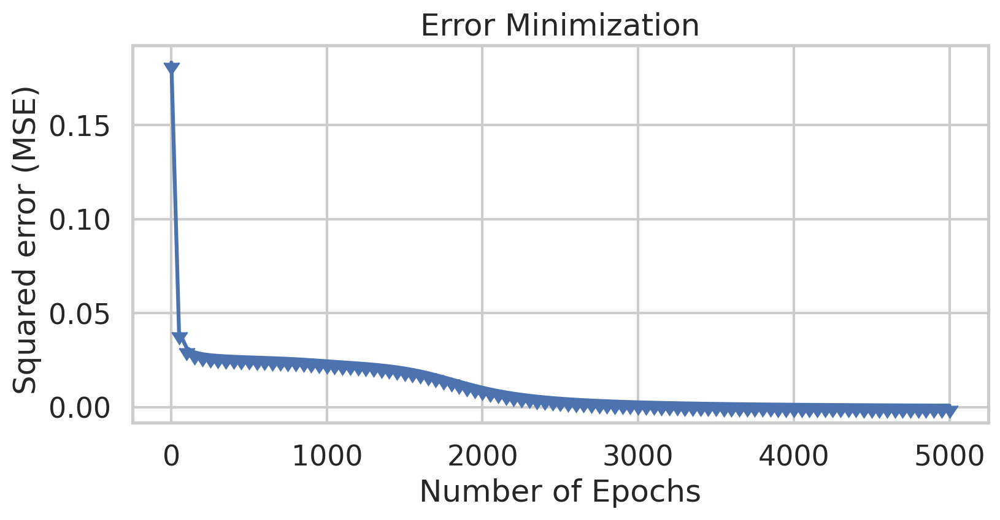

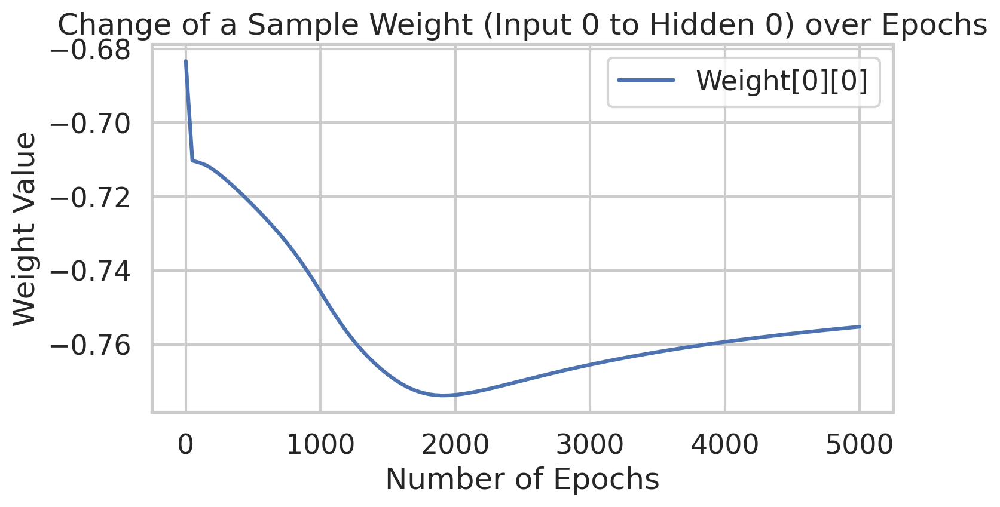

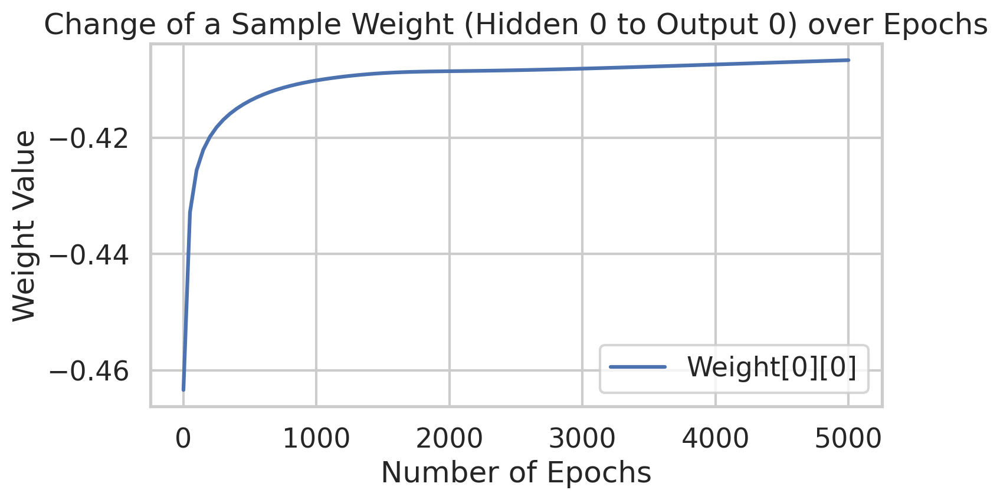

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 27.50%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 27.50% hits and 72.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.05
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.16214680875881227
Epoch  50 - Total Error:  0.026691837714815963
Epoch  100 - Total Error:  0.025303622237224748
Epoch  150 - Total Error:  0.024712606679634277
Epoch  200 - Total Error:  0.023389631228631566
Epoch  250 - Total Error:  0.0211745

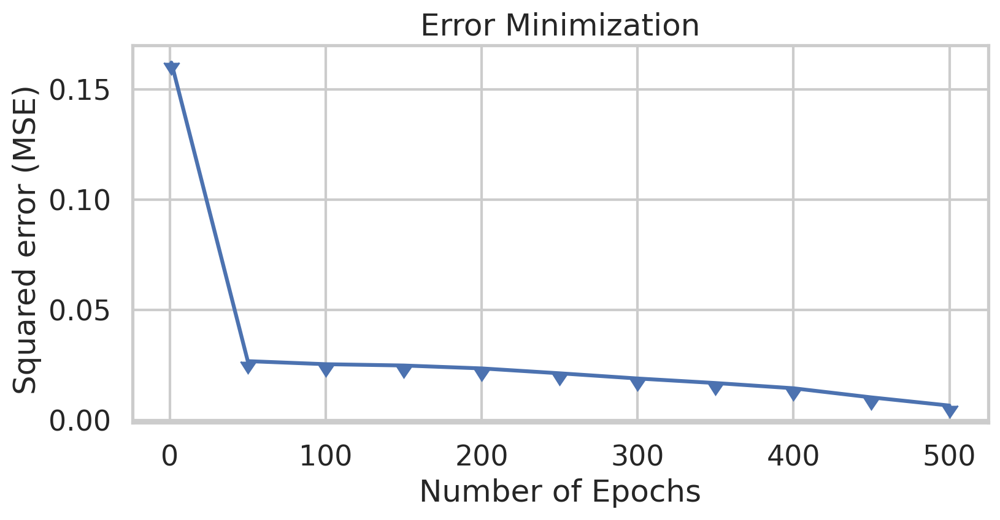

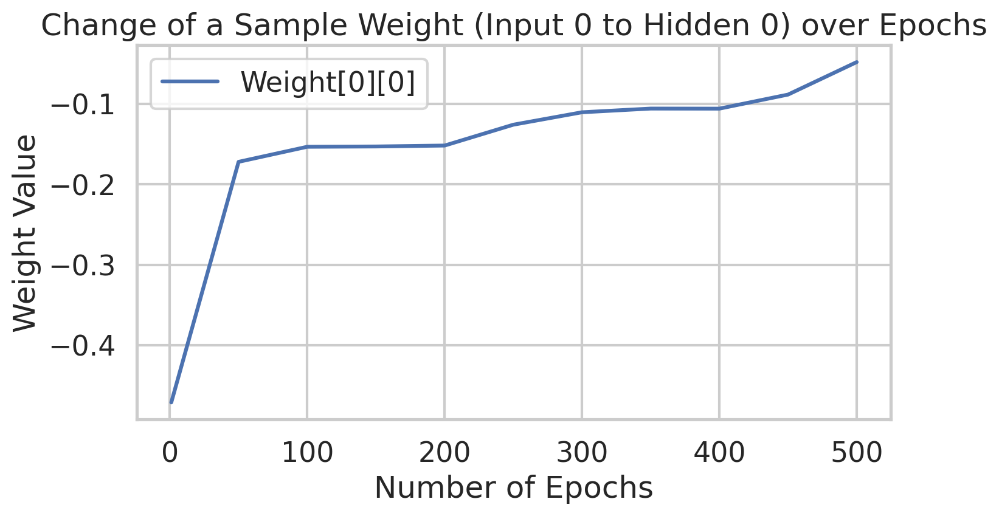

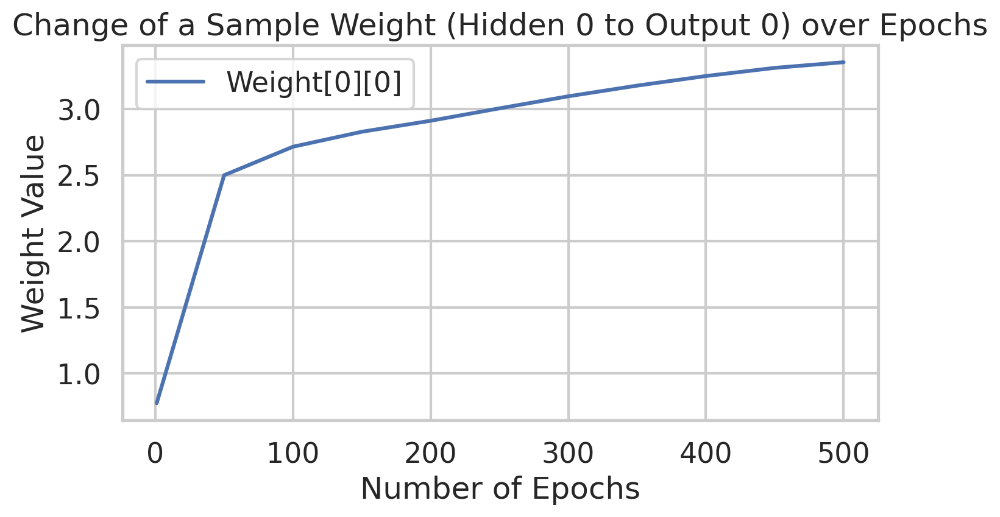

Overall accuracy: 100.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 100.00% hits and 0.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 100.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 100.00% hits and 0.00% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.05
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.24641485471424487
Epoch  50 - Total Error:  0.02563565424238421
Epoch  100 - Total Error:  0.02390666248062524
Epoch  150 - Total Error:  0.021822672555307294
Epoch  200 - Total Error:  0.01961651384611404
Epoch  250 - Total Error: 

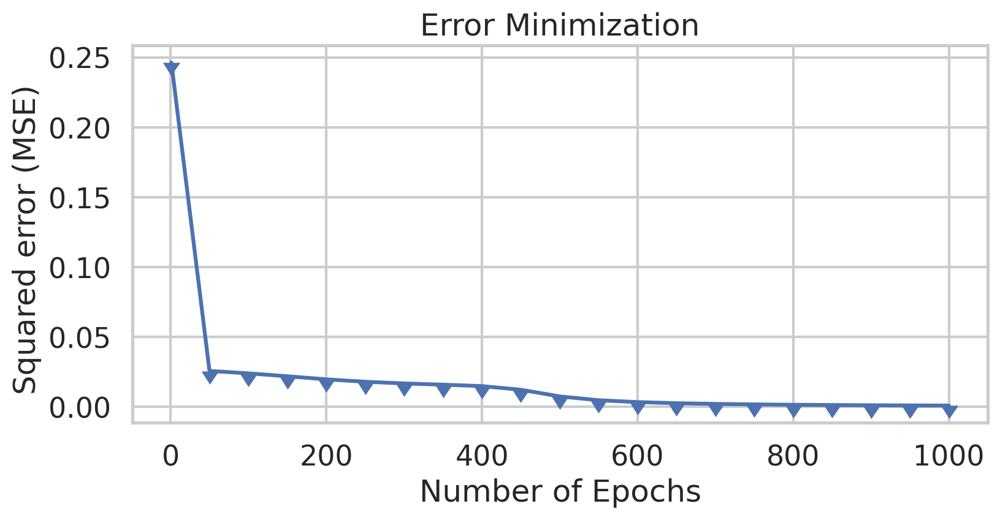

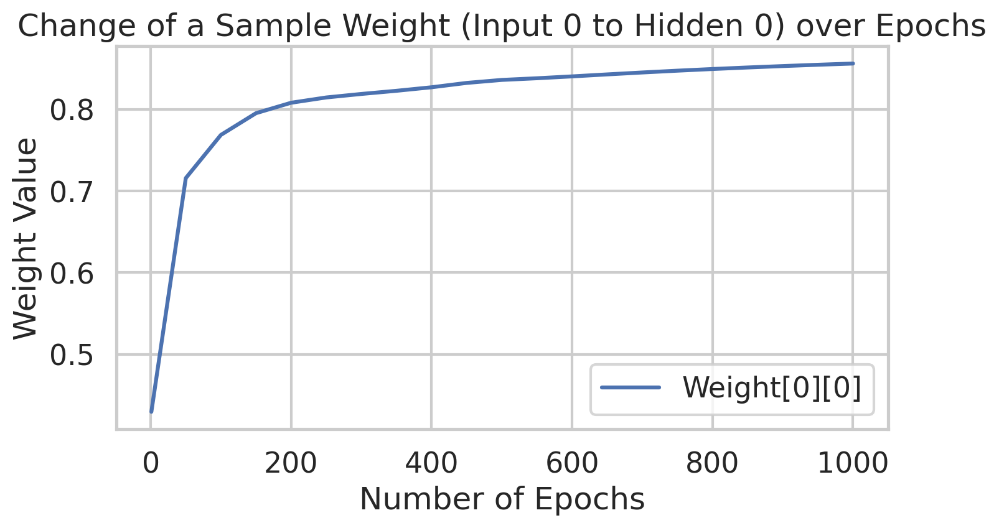

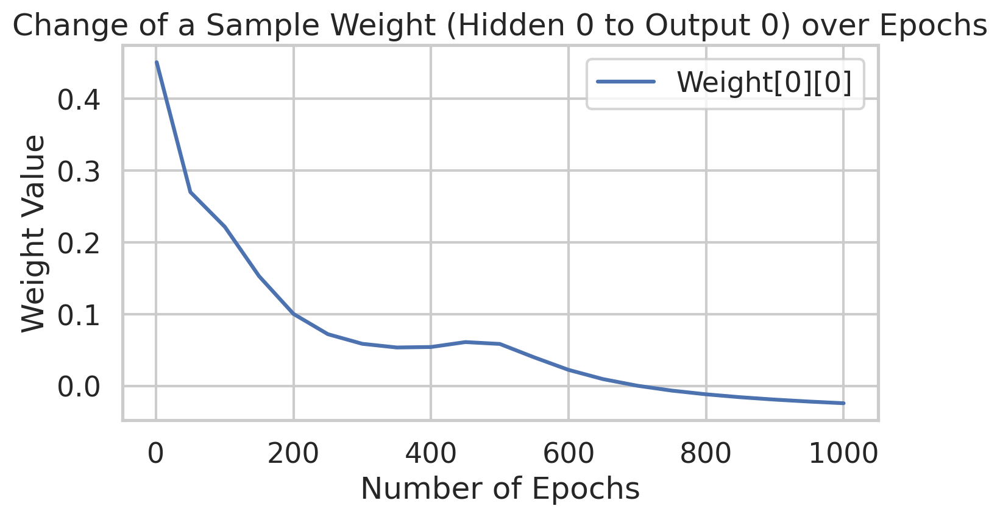

Overall accuracy: 100.00%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 100.00% hits and 0.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 20 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 98.33%
 - Accuracy Setosa: 100.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 60.00%

=== Train Results ===
Porcents : 98.33% hits and 1.67% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 82 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 3 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.05
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.18300567997417022
Epoch  50 - Total Error:  0.027869666569516
Epoch  100 - Total Error:  0.024981262267621436
Epoch  150 - Total Error:  0.02375354889138838
Epoch  200 - Total Error:  0.0219243383053799
Epoch  250 - Total Error:  0.019

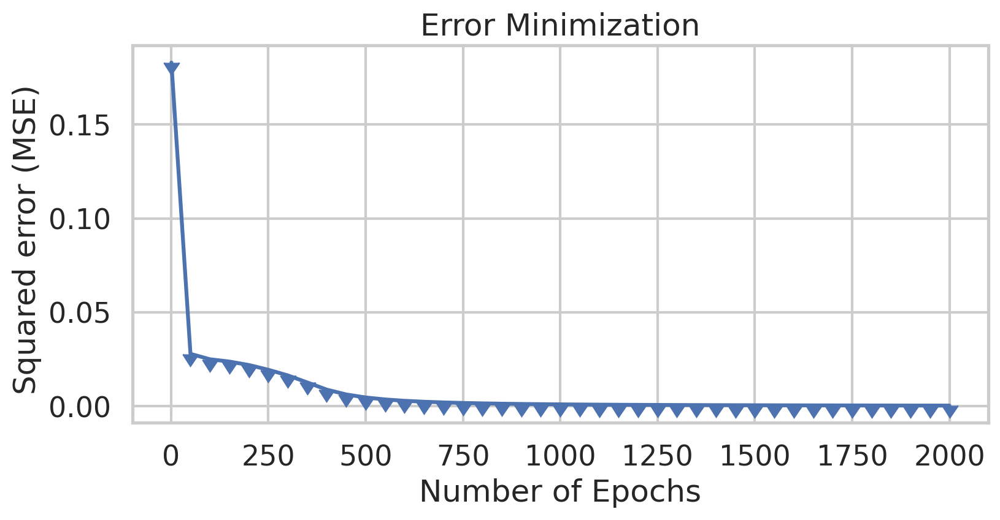

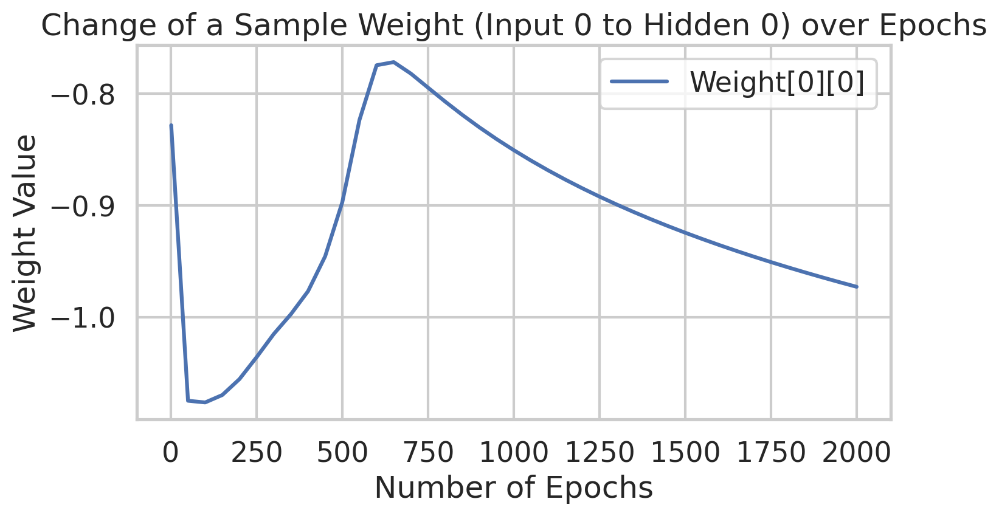

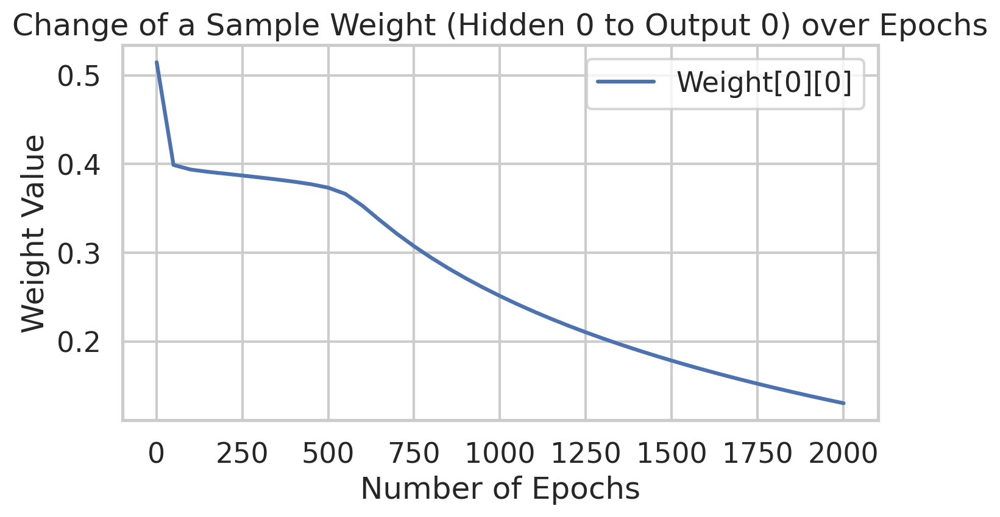

Overall accuracy: 33.33%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 33.33% hits and 66.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 31.67%
 - Accuracy Setosa: 3.66%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 40.00%

=== Train Results ===
Porcents : 31.67% hits and 68.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 3 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 2 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.05
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.1764312503312872
Epoch  50 - Total Error:  0.026269537682340853
Epoch  100 - Total Error:  0.02528580959884861
Epoch  150 - Total Error:  0.024961160178780285
Epoch  200 - Total Error:  0.024778528007414216
Epoch  250 - Total Error:  0.02463

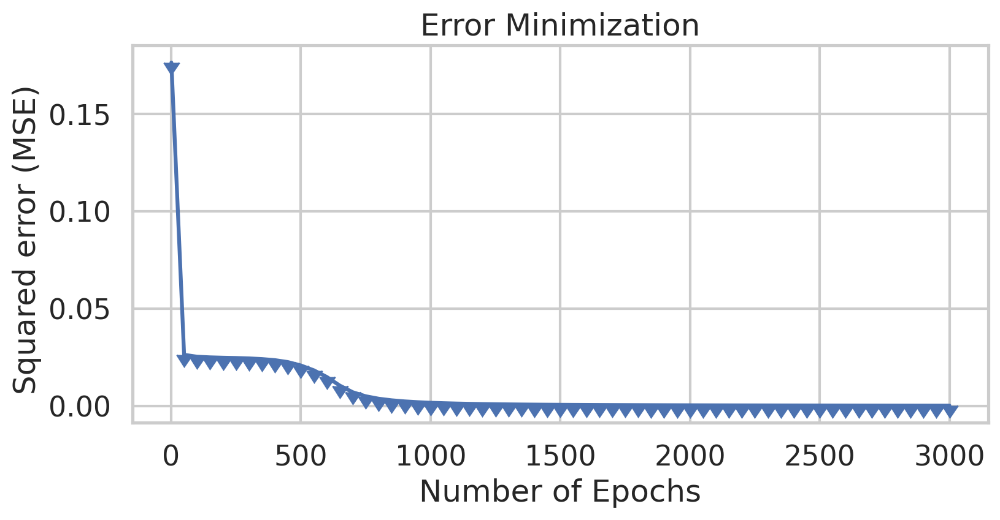

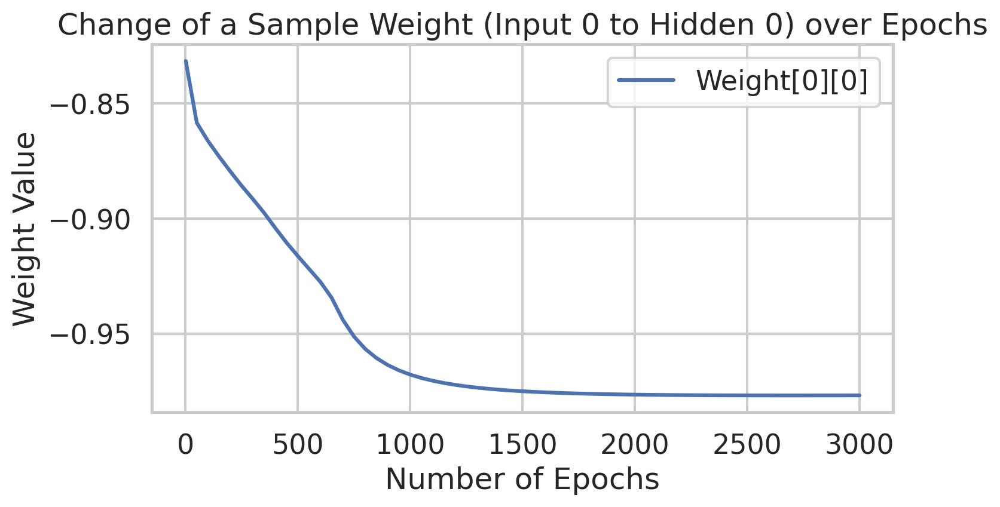

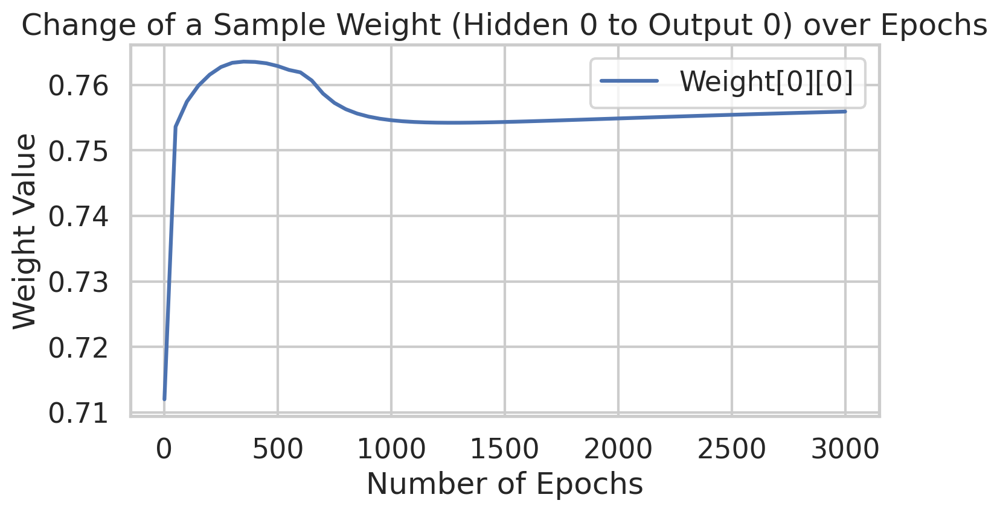

Overall accuracy: 33.33%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 33.33% hits and 66.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 30.83%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 80.00%

=== Train Results ===
Porcents : 30.83% hits and 69.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 4 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.05
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.16608147325767728
Epoch  50 - Total Error:  0.023961882354404475
Epoch  100 - Total Error:  0.02126904999593999
Epoch  150 - Total Error:  0.01924883386175792
Epoch  200 - Total Error:  0.01756660408413465
Epoch  250 - Total Error:  0.016165

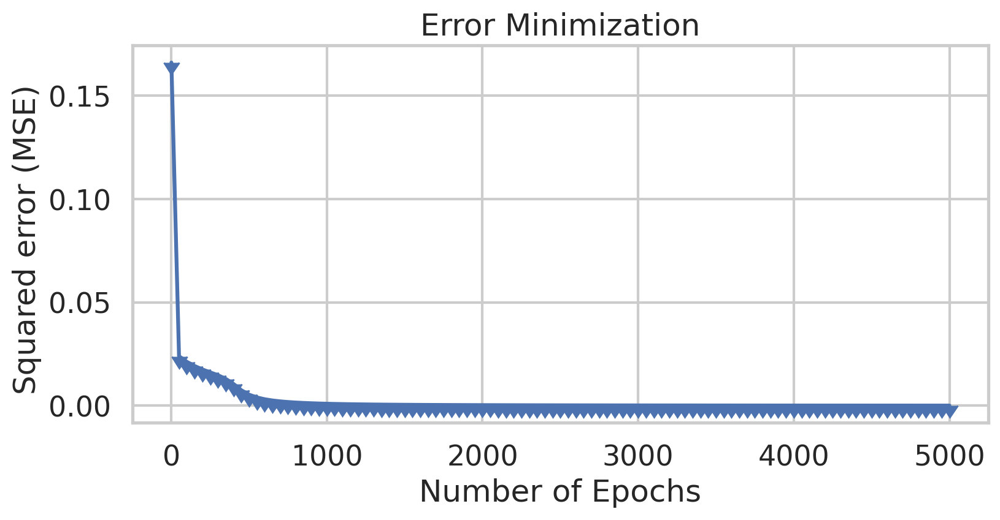

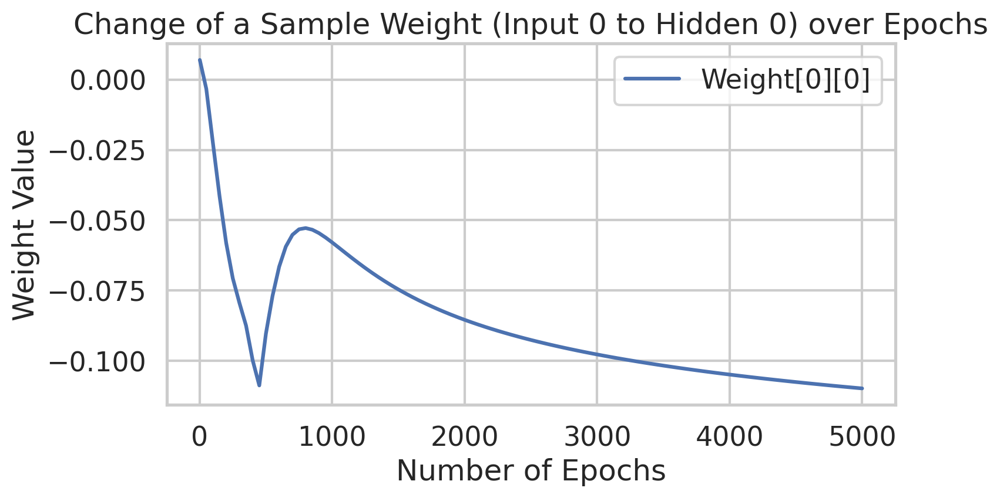

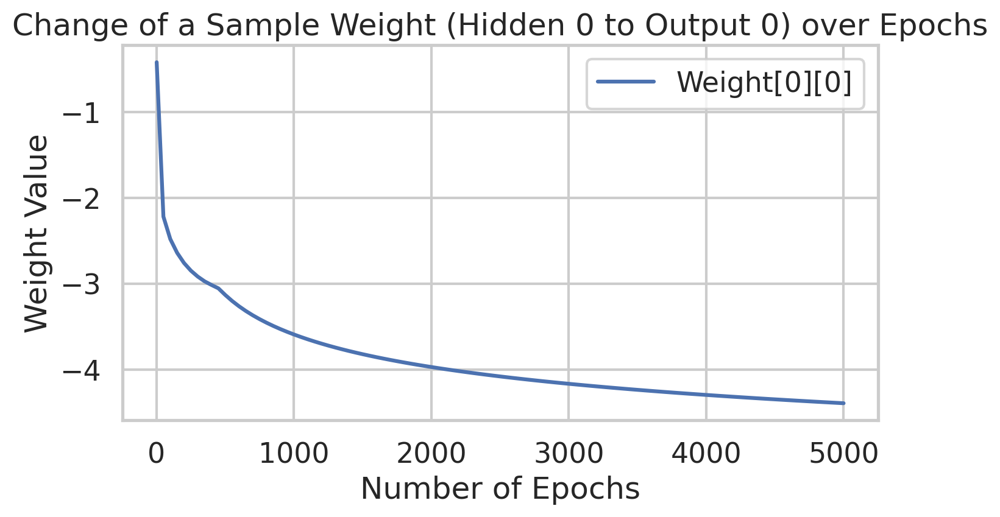

Overall accuracy: 33.33%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 33.33% hits and 66.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 30.83%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 80.00%

=== Train Results ===
Porcents : 30.83% hits and 69.17% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 4 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.1
 - Epochs: 500
 - Activation: sigmoid
Epoch  1 - Total Error:  0.16868722535203276
Epoch  50 - Total Error:  0.025260020799940573
Epoch  100 - Total Error:  0.023892644421542524
Epoch  150 - Total Error:  0.020039252327377556
Epoch  200 - Total Error:  0.010863577245172748
Epoch  250 - Total Error:  0.00534

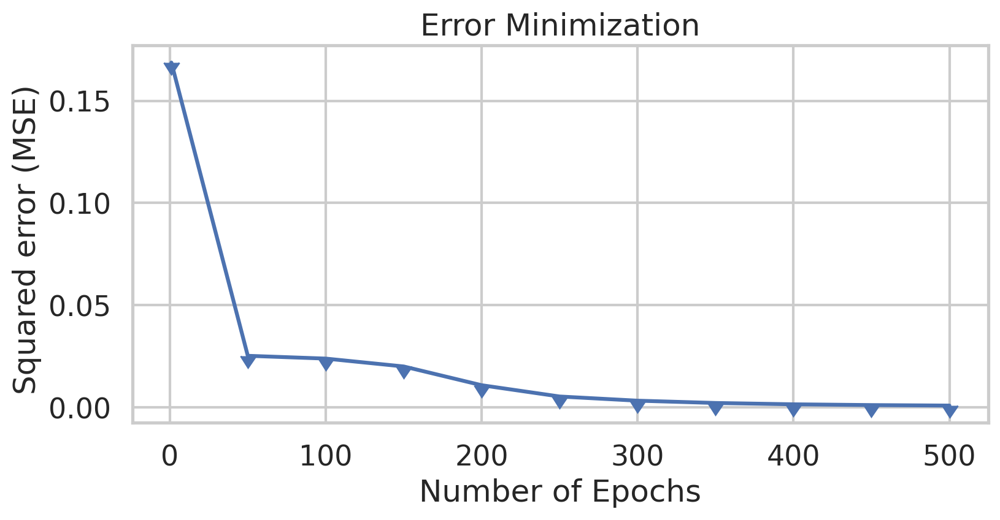

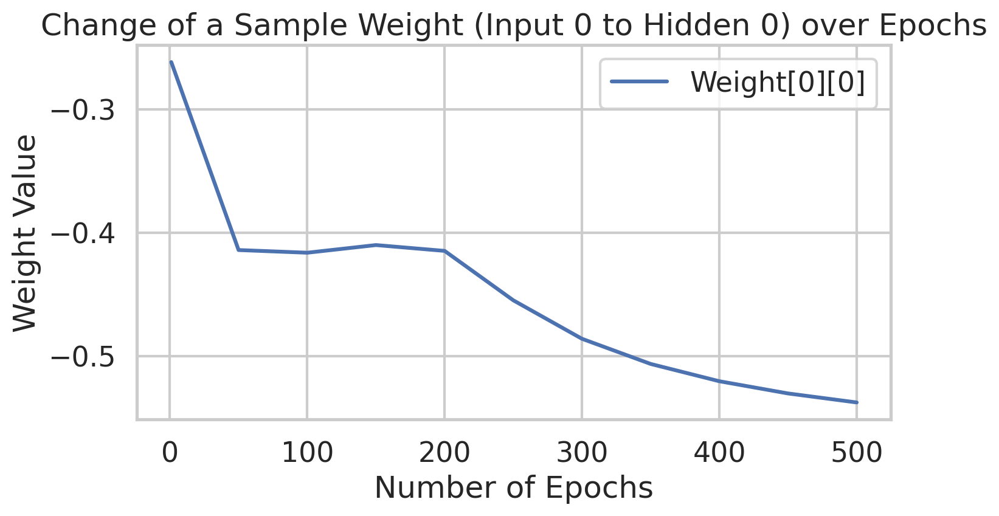

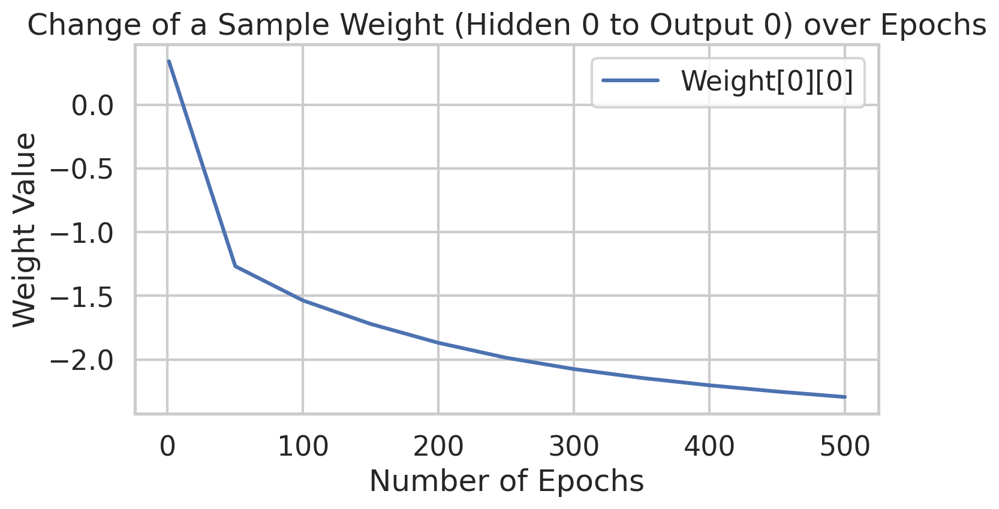

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 0 hits
Overall accuracy: 27.50%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 0.00%

=== Train Results ===
Porcents : 27.50% hits and 72.50% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 0 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.1
 - Epochs: 1000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.16285331559494642
Epoch  50 - Total Error:  0.02513873897117538
Epoch  100 - Total Error:  0.024512581720178526
Epoch  150 - Total Error:  0.023214717231699936
Epoch  200 - Total Error:  0.016758281742632476
Epoch  250 - Total Error:  0.00834445

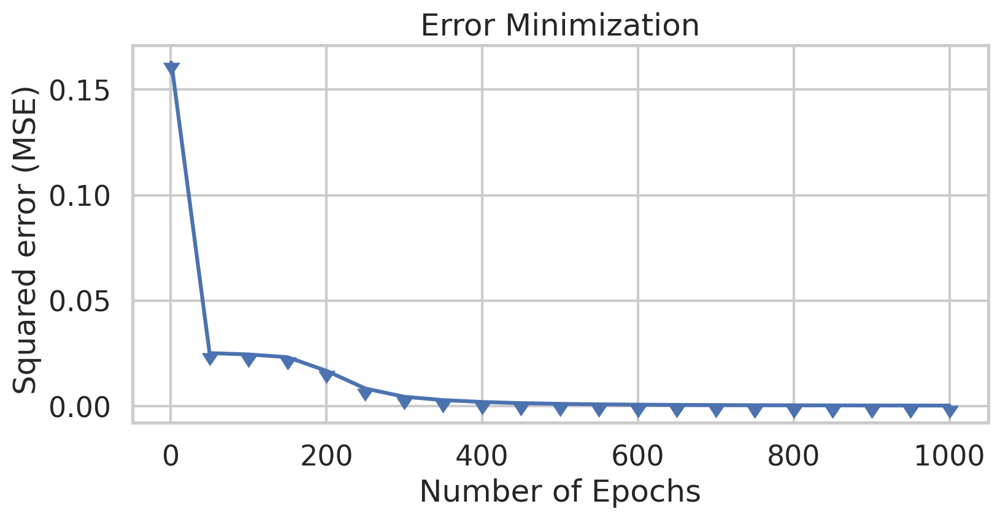

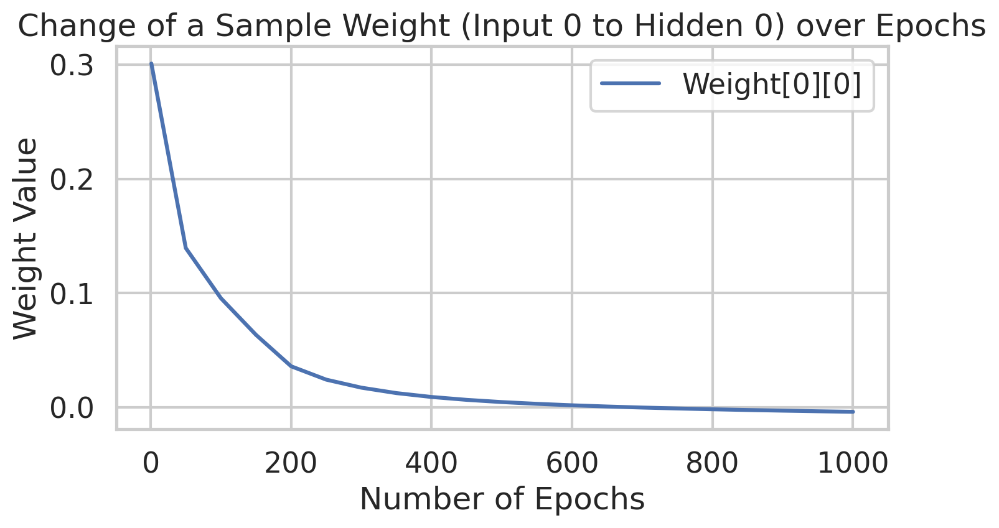

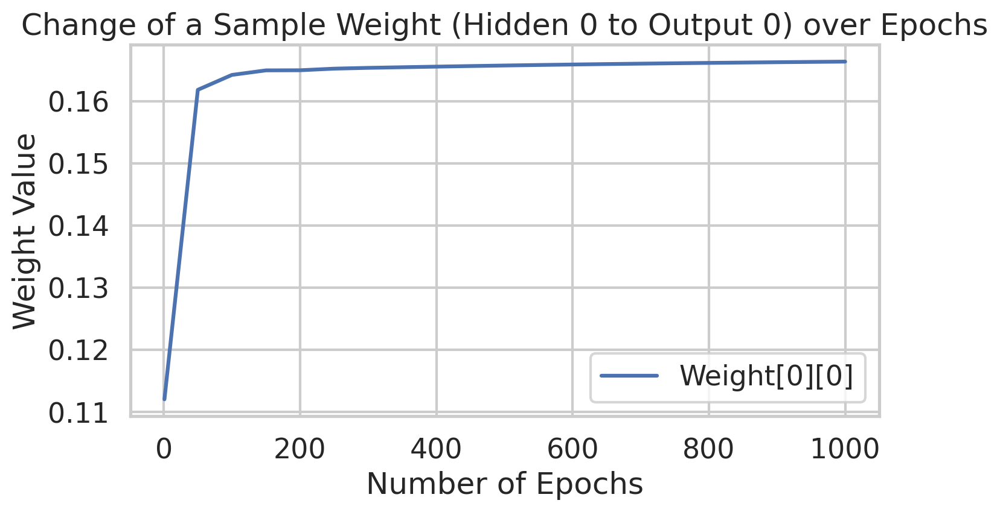

Overall accuracy: 33.33%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 33.33% hits and 66.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 31.67%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 31.67% hits and 68.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.1
 - Epochs: 2000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.13336171205786743
Epoch  50 - Total Error:  0.024362402961482694
Epoch  100 - Total Error:  0.02036325189430875
Epoch  150 - Total Error:  0.012804306096823748
Epoch  200 - Total Error:  0.006502001527249119
Epoch  250 - Total Error:  0.0038

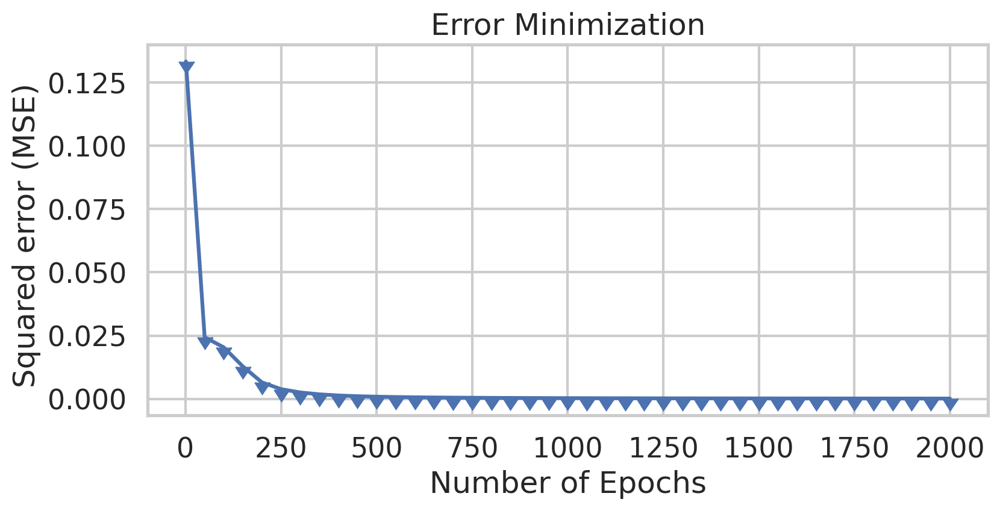

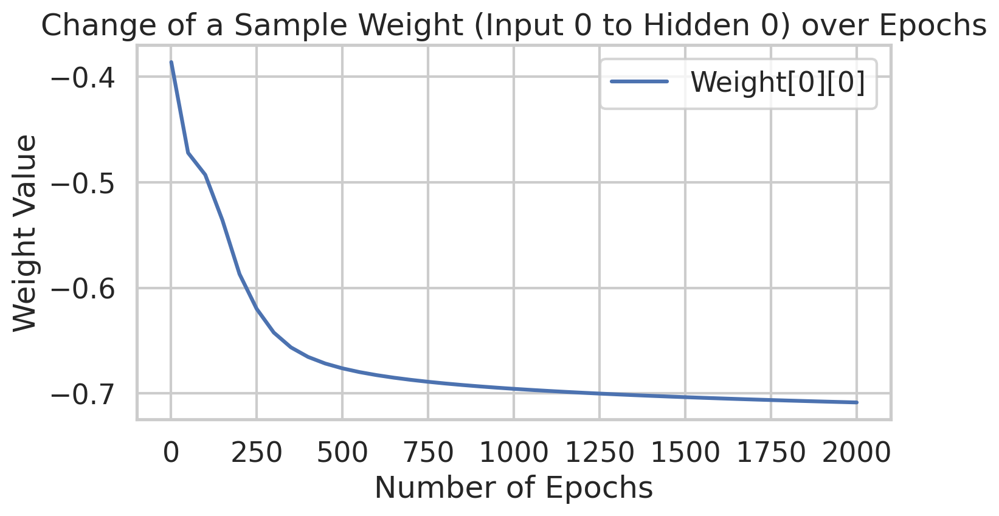

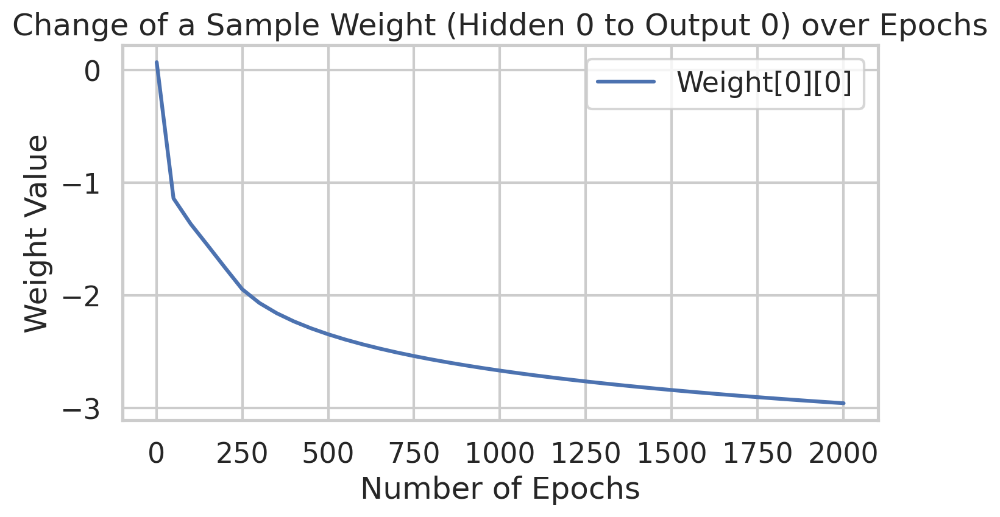

Overall accuracy: 33.33%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 33.33% hits and 66.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 31.67%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 31.67% hits and 68.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.1
 - Epochs: 3000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.13542558316691153
Epoch  50 - Total Error:  0.025237641429297228
Epoch  100 - Total Error:  0.022930031817018984
Epoch  150 - Total Error:  0.018923539005653762
Epoch  200 - Total Error:  0.01541863986370625
Epoch  250 - Total Error:  0.0091

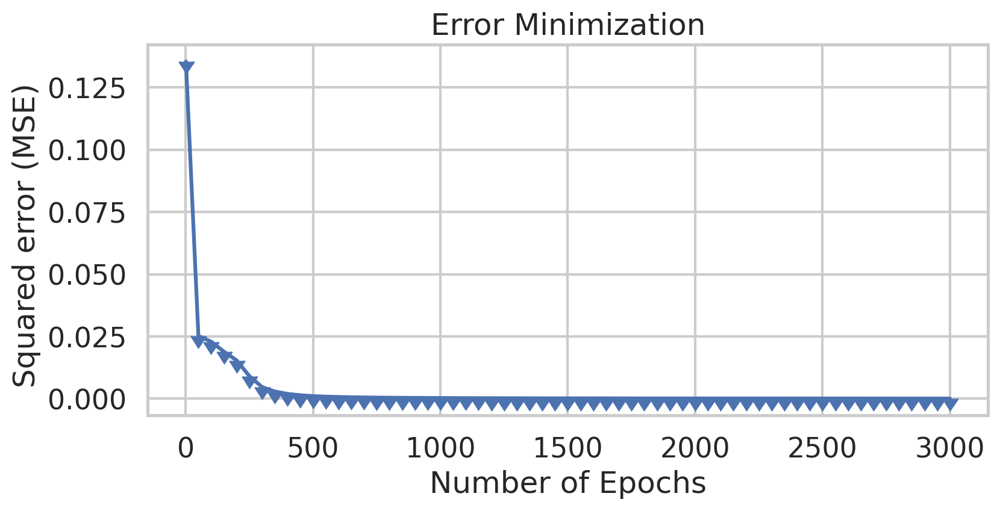

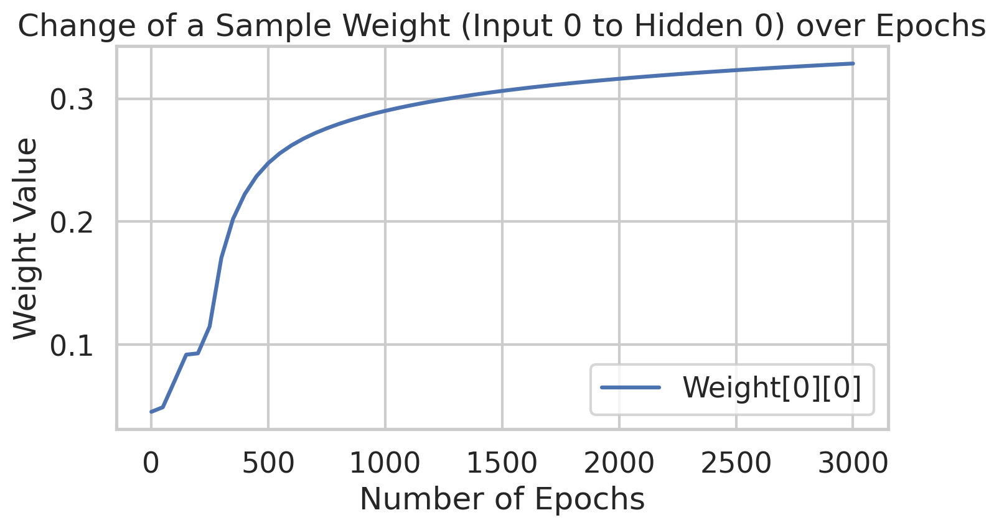

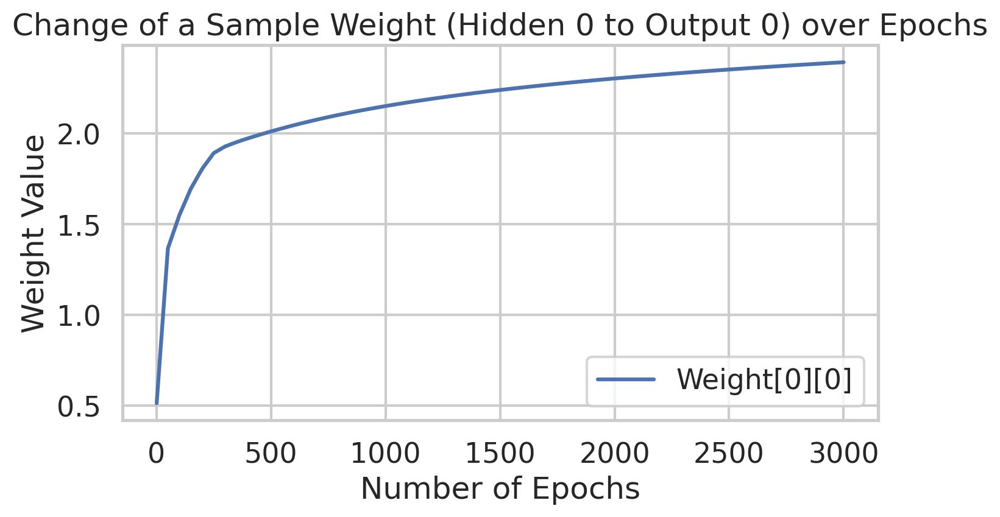

Overall accuracy: 33.33%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 33.33% hits and 66.67% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 9 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 31.67%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 31.67% hits and 68.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 5 hits

 Running experiment:
 - Hidden Neurons: 12
 - Learning Rate: 0.1
 - Epochs: 5000
 - Activation: sigmoid
Epoch  1 - Total Error:  0.18528369302938386
Epoch  50 - Total Error:  0.02635071539404635
Epoch  100 - Total Error:  0.024999755753058177
Epoch  150 - Total Error:  0.024716489873015123
Epoch  200 - Total Error:  0.024582117869808833
Epoch  250 - Total Error:  0.0244

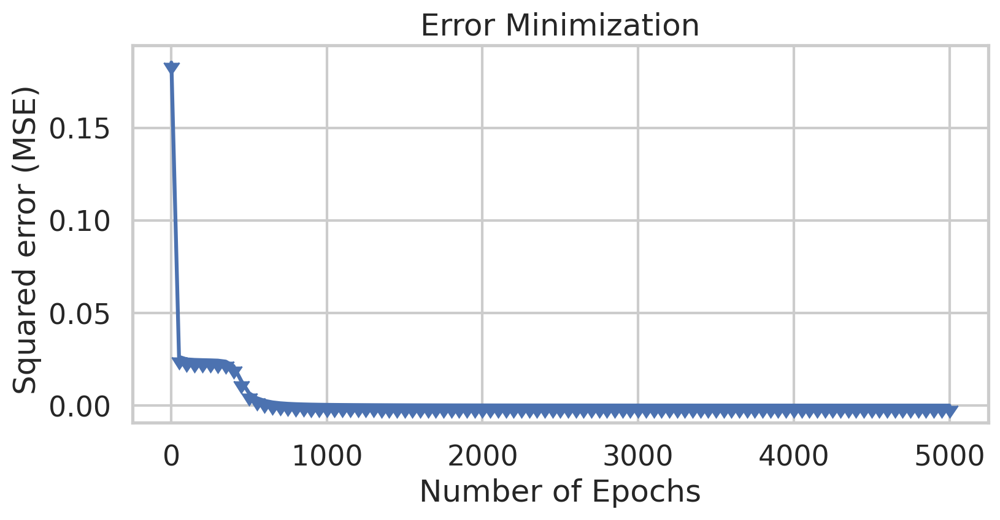

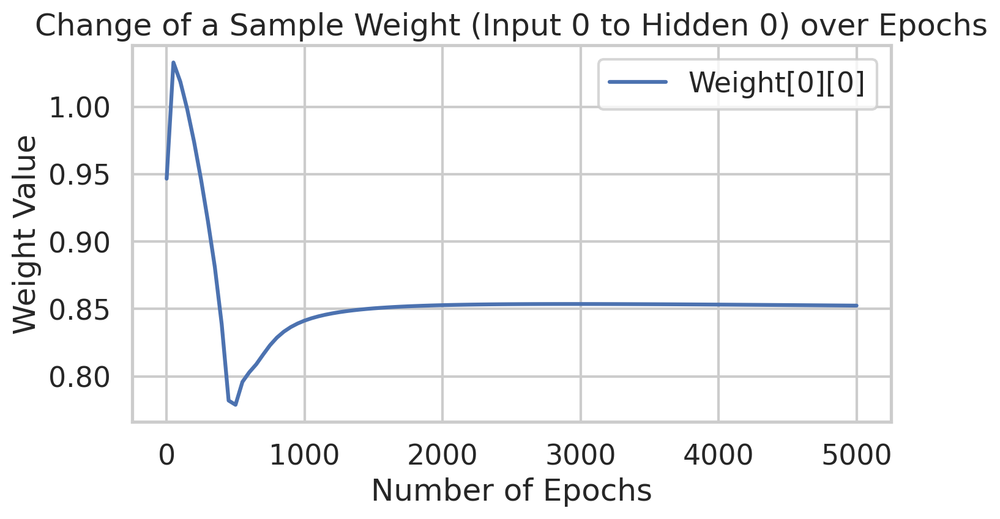

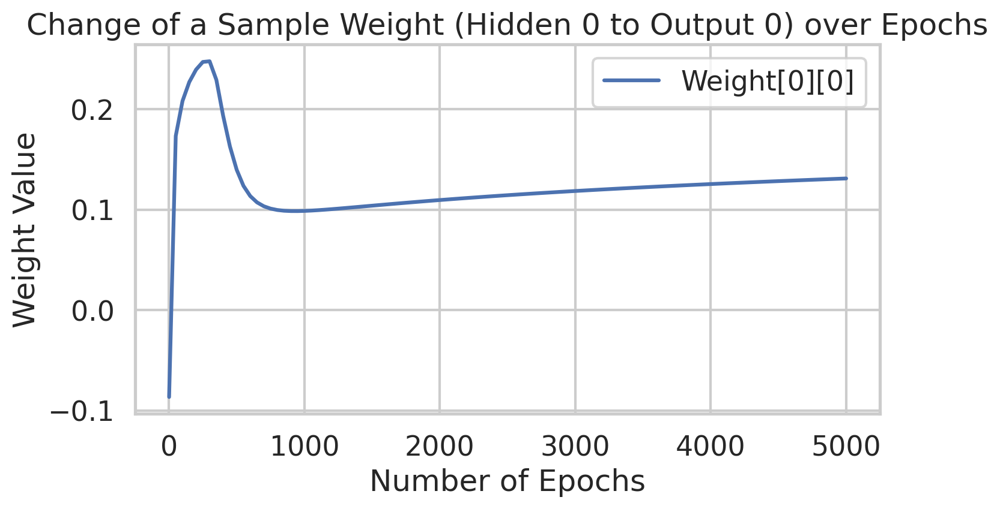

Overall accuracy: 30.00%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 88.89%
 - Accuracy Virginica: 100.00%

=== Test Results ===
Porcents : 30.00% hits and 70.00% faults
Total samples of test 30
* Iris-Setosa: 20 samples, 0 hits
* Iris-Versicolour: 9 samples, 8 hits
* Iris-Virginica: 1 samples, 1 hits
Overall accuracy: 31.67%
 - Accuracy Setosa: 0.00%
 - Accuracy Versicolour: 100.00%
 - Accuracy Virginica: 100.00%

=== Train Results ===
Porcents : 31.67% hits and 68.33% faults
Total samples of train 120
* Iris-Setosa: 82 samples, 0 hits
* Iris-Versicolour: 33 samples, 33 hits
* Iris-Virginica: 5 samples, 5 hits

 All experiments completed.


In [21]:
results = []

hidden_neurons_list = [3, 5, 7, 9, 12]
epochs_list = [500, 1000, 2000, 3000, 5000]
learning_rates = [0.001, 0.005, 0.01, 0.05, 0.1]
activation = 'sigmoid'  # you can also test 'tanh', etc.

for neurons in hidden_neurons_list:
    for lr in learning_rates:
        for ep in epochs_list:
            print("\n Running experiment:")
            print(f" - Hidden Neurons: {neurons}")
            print(f" - Learning Rate: {lr}")
            print(f" - Epochs: {ep}")
            print(f" - Activation: {activation}")

            result = run_experiment(
                train_X, train_y,
                test_X, test_y,
                n_hidden=neurons,
                learning_rate=lr,
                epochs=ep,
                activation=activation,
                show_plot=False  # Avoid plotting every time
            )

            if result:  # Ensure experiment was not skipped
                results.append(result)

print("\n All experiments completed.")


In [29]:
# Sort by overall test accuracy
sorted_results = sorted(results, key=lambda x: x['accuracy_test_total'], reverse=True)

print("\n Top 10 Results by Test Accuracy:")
for i, res in enumerate(sorted_results[:10]):
    print(f"{i+1}. Accuracy: {res['accuracy_test_total']:.2f}% | "
          f"Neurons: {res['neurons']} | LR: {res['learning_rate']} | Epochs: {res['epochs']} | "
        f"Train Acc: {res['accuracy_train_total']:.2f}%" if 'accuracy_train_total' in res else "Train Acc: N/A")




 Top 10 Results by Test Accuracy:
1. Accuracy: 100.00% | Neurons: 7 | LR: 0.005 | Epochs: 5000 | Train Acc: 100.00%
2. Accuracy: 100.00% | Neurons: 9 | LR: 0.005 | Epochs: 3000 | Train Acc: 98.33%
3. Accuracy: 100.00% | Neurons: 12 | LR: 0.05 | Epochs: 500 | Train Acc: 100.00%
4. Accuracy: 100.00% | Neurons: 12 | LR: 0.05 | Epochs: 1000 | Train Acc: 98.33%
5. Accuracy: 96.67% | Neurons: 3 | LR: 0.001 | Epochs: 500 | Train Acc: 95.83%
6. Accuracy: 96.67% | Neurons: 3 | LR: 0.001 | Epochs: 2000 | Train Acc: 95.83%
7. Accuracy: 96.67% | Neurons: 3 | LR: 0.001 | Epochs: 5000 | Train Acc: 95.00%
8. Accuracy: 96.67% | Neurons: 3 | LR: 0.005 | Epochs: 500 | Train Acc: 95.83%
9. Accuracy: 96.67% | Neurons: 3 | LR: 0.005 | Epochs: 1000 | Train Acc: 95.83%
10. Accuracy: 96.67% | Neurons: 3 | LR: 0.005 | Epochs: 3000 | Train Acc: 95.83%


In [32]:
df_results = pd.DataFrame(sorted_results)
df_results.to_csv("mlp_experiment_results.csv", index=False)
df_results.head(10)


,neurons,epochs,learning_rate,activation,accuracy_test_total,accuracy_test_per_class,accuracy_train_total,accuracy_train_per_class
0,7,5000,0.005,sigmoid,100.000000,"[100.0, 100.0, 100.0]",100.000000,"[100.0, 100.0, 100.0]"
1,9,3000,0.005,sigmoid,100.000000,"[100.0, 100.0, 100.0]",98.333333,"[100.0, 100.0, 60.0]"
2,12,500,0.050,sigmoid,100.000000,"[100.0, 100.0, 100.0]",100.000000,"[100.0, 100.0, 100.0]"
3,12,1000,0.050,sigmoid,100.000000,"[100.0, 100.0, 100.0]",98.333333,"[100.0, 100.0, 60.0]"
4,3,500,0.001,sigmoid,96.666667,"[100.0, 100.0, 0.0]",95.833333,"[100.0, 100.0, 0.0]"
5,3,2000,0.001,sigmoid,96.666667,"[100.0, 100.0, 0.0]",95.833333,"[100.0, 100.0, 0.0]"
6,3,5000,0.001,sigmoid,96.666667,"[100.0, 100.0, 0.0]",95.000000,"[100.0, 96.96969696969697, 0.0]"
7,3,500,0.005,sigmoid,96.666667,"[100.0, 100.0, 0.0]",95.833333,"[100.0, 100.0, 0.0]"
8,3,1000,0.005,sigmoid,96.666667,"[100.0, 100.0, 0.0]",95.833333,"[100.0, 100.0, 0.0]"
9,3,3000,0.005,sigmoid,96.666667,"[100.0, 100.0, 0.0]",95.833333,"[100.0, 100.0, 0.0]"


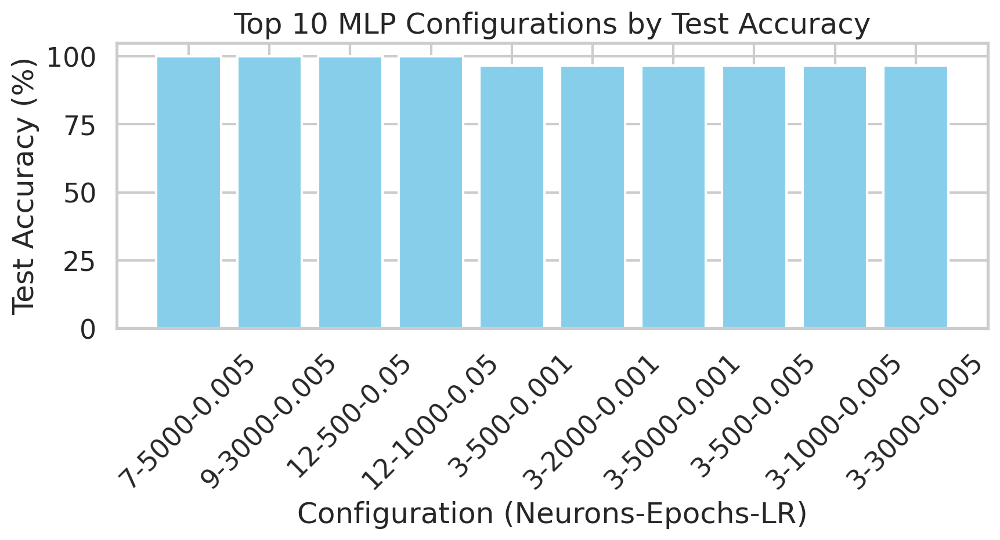

In [40]:
import pandas as pd
import matplotlib.pyplot as plt

df = pd.read_csv("mlp_experiment_results.csv")  
top = df.sort_values(by="accuracy_test_total", ascending=False).head(10)

labels = [f"{row['neurons']}-{row['epochs']}-{row['learning_rate']}" for _, row in top.iterrows()]
plt.figure(figsize=(9, 5))
plt.bar(labels, top["accuracy_test_total"], color='skyblue')
plt.ylabel("Test Accuracy (%)")
plt.xlabel("Configuration (Neurons-Epochs-LR)")
plt.title("Top 10 MLP Configurations by Test Accuracy")
plt.xticks(rotation=45)
plt.tight_layout()
# Save plot
plt.savefig("test_accuracy_plot.png", dpi=300)
plt.show()


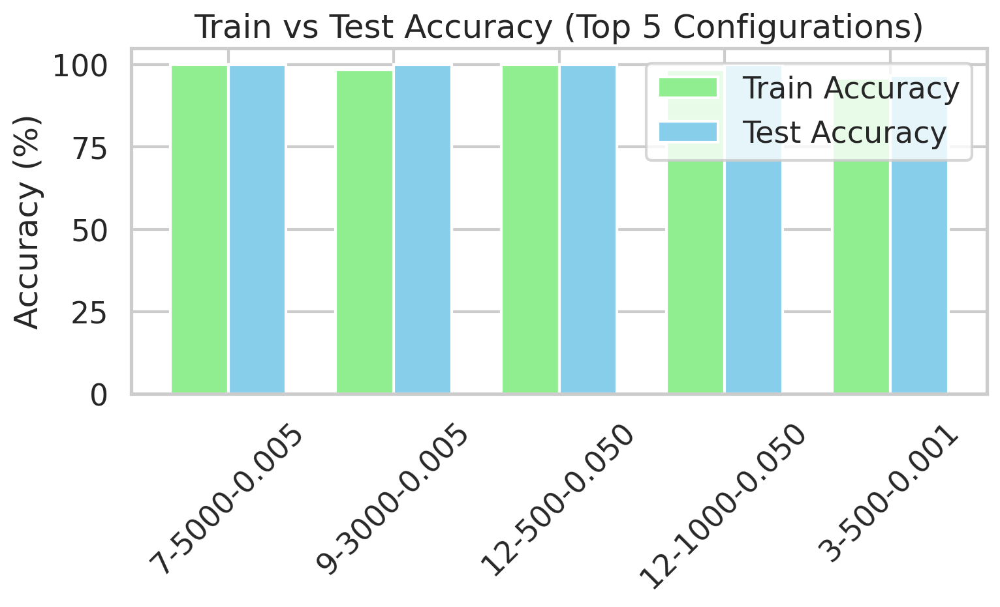

In [41]:
# Top 5 entries
train_acc = [100, 98.33, 100, 98.33, 95.83]
test_acc = [100, 100, 100, 100, 96.67]
labels = ['7-5000-0.005', '9-3000-0.005', '12-500-0.050', '12-1000-0.050', '3-500-0.001']

x = range(len(labels))
width = 0.35

plt.figure(figsize=(8,5))
plt.bar([p - width/2 for p in x], train_acc, width=width, label='Train Accuracy', color='lightgreen')
plt.bar([p + width/2 for p in x], test_acc, width=width, label='Test Accuracy', color='skyblue')
plt.xticks(x, labels, rotation=45)
plt.ylabel("Accuracy (%)")
plt.title("Train vs Test Accuracy (Top 5 Configurations)")
plt.legend()
plt.tight_layout()
# Save plot
plt.savefig("train_vs_test_plot.png", dpi=300)
plt.show()
